In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperature
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperature
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperature
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)

#Since the NaN values of GHI are gone which is used in data preparation, simulate these in solar activity instead
df['solar_activity'].loc[df['Year'] > 2020] = np.nan
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['GHI'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)     

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

C:\Users\User\AppData\Local\Temp\ipykernel_302040\1215133952.py:375: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['solar_activity'].loc[df['Year'] > 2020] = np.nan


Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.38166311 0.62313675 0.34639831 ... 0.51507767 0.37861712 0.40511727]
 [0.39415169 0.71548931 0.32450565 ... 0.45933597 0.43070362 0.37892172]
 [0.45872677 0.53175632 0.4180791  ... 0.49558331 0.47822114 0.3898873 ]
 ...
 [0.54249162 0.47861309 0.465

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-21 15:52:07,154] A new study created in memory with name: no-name-0c3df7c6-ac59-44b0-85ad-80a675d7c80e
[I 2025-05-21 15:56:43,960] Trial 0 finished with value: 1.1480051517486571 and parameters: {'lr': 0.06962469892775902, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.25007511911436386}. Best is trial 0 with value: 1.1480051517486571.


Cross Validation Accuracies:
[1.19260573387146, 1.07308828830719, 1.2474666833877563, 1.2031846046447754, 1.0236804485321045]
Mean Cross Validation Accuracy:
1.1480051517486571
Standard Deviation of Cross Validation Accuracy:
0.08484780313171895


[I 2025-05-21 15:58:58,402] Trial 1 finished with value: 0.05154601410031319 and parameters: {'lr': 0.01960649107047573, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.12719077795492728}. Best is trial 1 with value: 0.05154601410031319.


Cross Validation Accuracies:
[0.04340372607111931, 0.04632166400551796, 0.05643007531762123, 0.06270739436149597, 0.04886721074581146]
Mean Cross Validation Accuracy:
0.05154601410031319
Standard Deviation of Cross Validation Accuracy:
0.007059704512011303


[I 2025-05-21 16:04:12,326] Trial 2 finished with value: 0.09834710508584976 and parameters: {'lr': 0.16568475193704602, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3544597192384503}. Best is trial 1 with value: 0.05154601410031319.


Cross Validation Accuracies:
[0.08421659469604492, 0.08839219063520432, 0.11022066324949265, 0.11172599345445633, 0.0971800833940506]
Mean Cross Validation Accuracy:
0.09834710508584976
Standard Deviation of Cross Validation Accuracy:
0.011136513122788735


[I 2025-05-21 16:06:25,343] Trial 3 finished with value: 0.06252214461565017 and parameters: {'lr': 0.07041257525107923, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3016898238154838}. Best is trial 1 with value: 0.05154601410031319.


Cross Validation Accuracies:
[0.05545346811413765, 0.0550285205245018, 0.07135213166475296, 0.07258706539869308, 0.05818953737616539]
Mean Cross Validation Accuracy:
0.06252214461565017
Standard Deviation of Cross Validation Accuracy:
0.007799530455743636


[I 2025-05-21 16:08:20,223] Trial 4 finished with value: 0.051268558204174045 and parameters: {'lr': 0.04404314946523343, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.14706867212790786}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[0.04250030219554901, 0.04429548233747482, 0.057526614516973495, 0.06265982240438461, 0.049360569566488266]
Mean Cross Validation Accuracy:
0.051268558204174045
Standard Deviation of Cross Validation Accuracy:
0.007721019233368586


[I 2025-05-21 16:10:57,422] Trial 5 finished with value: 0.06594503819942474 and parameters: {'lr': 0.004730086684991941, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.34713577488408487}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[0.06062525138258934, 0.07974521070718765, 0.05977782979607582, 0.06441226601600647, 0.06516463309526443]
Mean Cross Validation Accuracy:
0.06594503819942474
Standard Deviation of Cross Validation Accuracy:
0.007207465229937482


[I 2025-05-21 16:13:30,745] Trial 6 finished with value: 0.42377511858940126 and parameters: {'lr': 0.0018439461331151614, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2576270167908939}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[0.42567193508148193, 0.45053136348724365, 0.43390801548957825, 0.39775383472442627, 0.4110104441642761]
Mean Cross Validation Accuracy:
0.42377511858940126
Standard Deviation of Cross Validation Accuracy:
0.018233015551951982


[I 2025-05-21 16:17:05,366] Trial 7 finished with value: 0.07897173017263412 and parameters: {'lr': 0.12243663182603526, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.11386891811962752}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[0.07772336155176163, 0.07355476915836334, 0.08753938972949982, 0.0878356322646141, 0.06820549815893173]
Mean Cross Validation Accuracy:
0.07897173017263412
Standard Deviation of Cross Validation Accuracy:
0.007730293567454447


[I 2025-05-21 16:23:53,375] Trial 8 finished with value: 9.482014656066895 and parameters: {'lr': 0.8586672727452536, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3727690395129205}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[11.118611335754395, 7.489669322967529, 10.774754524230957, 7.5198750495910645, 10.507163047790527]
Mean Cross Validation Accuracy:
9.482014656066895
Standard Deviation of Cross Validation Accuracy:
1.6260372717365665


[I 2025-05-21 16:27:41,686] Trial 9 finished with value: 0.05092313140630722 and parameters: {'lr': 0.006569826232453569, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20229333686739817}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04317121207714081, 0.04265908524394035, 0.0571393221616745, 0.06375440955162048, 0.04789162799715996]
Mean Cross Validation Accuracy:
0.05092313140630722
Standard Deviation of Cross Validation Accuracy:
0.008256627053813357


[I 2025-05-21 16:31:23,771] Trial 10 finished with value: 0.07843896299600601 and parameters: {'lr': 0.010369322030605711, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.47998043760091125}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.08417278528213501, 0.07591689378023148, 0.06949924677610397, 0.08991196751594543, 0.07269392162561417]
Mean Cross Validation Accuracy:
0.07843896299600601
Standard Deviation of Cross Validation Accuracy:
0.007533809266135041


[I 2025-05-21 16:33:47,297] Trial 11 finished with value: 0.5934521198272705 and parameters: {'lr': 0.0010318275159282798, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.18234977314457862}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.6181175112724304, 0.5986921787261963, 0.5749569535255432, 0.5681692361831665, 0.6073247194290161]
Mean Cross Validation Accuracy:
0.5934521198272705
Standard Deviation of Cross Validation Accuracy:
0.01902411182687582


[I 2025-05-21 16:36:15,797] Trial 12 finished with value: 0.05123655945062637 and parameters: {'lr': 0.0071120776868642335, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.18724062245015125}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.042498879134655, 0.045446015894412994, 0.056626614183187485, 0.06282596290111542, 0.04878532513976097]
Mean Cross Validation Accuracy:
0.05123655945062637
Standard Deviation of Cross Validation Accuracy:
0.00747332541758344


[I 2025-05-21 16:38:53,980] Trial 13 finished with value: 0.05308636799454689 and parameters: {'lr': 0.0045580669257116865, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20160756760917323}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04718557745218277, 0.046424493193626404, 0.056237075477838516, 0.06419501453638077, 0.051389679312705994]
Mean Cross Validation Accuracy:
0.05308636799454689
Standard Deviation of Cross Validation Accuracy:
0.006563652078039296


[I 2025-05-21 16:41:10,128] Trial 14 finished with value: 0.051038334518671034 and parameters: {'lr': 0.008720791843927479, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2092258972892235}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04264460876584053, 0.04538048431277275, 0.05633033812046051, 0.06256678700447083, 0.04826945438981056]
Mean Cross Validation Accuracy:
0.051038334518671034
Standard Deviation of Cross Validation Accuracy:
0.0073626505685494515


[I 2025-05-21 16:44:07,650] Trial 15 finished with value: 0.05188039988279343 and parameters: {'lr': 0.002516647030631103, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24328136200219852}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04388494789600372, 0.04522215574979782, 0.058025941252708435, 0.0633302628993988, 0.04893869161605835]
Mean Cross Validation Accuracy:
0.05188039988279343
Standard Deviation of Cross Validation Accuracy:
0.007560160802027583


[I 2025-05-21 16:46:41,628] Trial 16 finished with value: 0.05110272988677025 and parameters: {'lr': 0.01494683942023324, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.30193783429240717}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04248330369591713, 0.0455571748316288, 0.056293681263923645, 0.06236879527568817, 0.0488106943666935]
Mean Cross Validation Accuracy:
0.05110272988677025
Standard Deviation of Cross Validation Accuracy:
0.007268718196515919


[I 2025-05-21 16:49:08,136] Trial 17 finished with value: 0.15497599989175798 and parameters: {'lr': 0.02576765013607674, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.42537539714725636}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.22707439959049225, 0.13609224557876587, 0.1271691769361496, 0.19764722883701324, 0.08689694851636887]
Mean Cross Validation Accuracy:
0.15497599989175798
Standard Deviation of Cross Validation Accuracy:
0.05056399081328076


[I 2025-05-21 16:51:20,290] Trial 18 finished with value: 0.3184600383043289 and parameters: {'lr': 0.0025055883993926015, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2231507804740854}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.30610033869743347, 0.22479428350925446, 0.3853738605976105, 0.35998496413230896, 0.31604674458503723]
Mean Cross Validation Accuracy:
0.3184600383043289
Standard Deviation of Cross Validation Accuracy:
0.05501570477817291


[I 2025-05-21 16:53:51,823] Trial 19 finished with value: 0.8115534305572509 and parameters: {'lr': 0.5082026335508305, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.16425374661549458}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.7971842288970947, 0.6235707402229309, 1.0646356344223022, 0.8999459743499756, 0.6724305748939514]
Mean Cross Validation Accuracy:
0.8115534305572509
Standard Deviation of Cross Validation Accuracy:
0.15922498453504744


[I 2025-05-21 16:57:21,097] Trial 20 finished with value: 0.055158762633800505 and parameters: {'lr': 0.008588227270095929, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2998528225878343}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04775729030370712, 0.05154440551996231, 0.06196816265583038, 0.06477310508489609, 0.04975084960460663]
Mean Cross Validation Accuracy:
0.055158762633800505
Standard Deviation of Cross Validation Accuracy:
0.006868688415669687


[I 2025-05-21 16:59:54,506] Trial 21 finished with value: 0.0512289471924305 and parameters: {'lr': 0.016181086679595082, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.26070187140021983}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04311651363968849, 0.045055851340293884, 0.05658302083611488, 0.062496744096279144, 0.04889260604977608]
Mean Cross Validation Accuracy:
0.0512289471924305
Standard Deviation of Cross Validation Accuracy:
0.007280199614441313


[I 2025-05-21 17:02:09,957] Trial 22 finished with value: 0.051128553599119185 and parameters: {'lr': 0.012678656839271137, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2997245852530448}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04262535646557808, 0.045217208564281464, 0.056237999349832535, 0.06253468990325928, 0.04902751371264458]
Mean Cross Validation Accuracy:
0.051128553599119185
Standard Deviation of Cross Validation Accuracy:
0.0073194140678803634


[I 2025-05-21 17:04:10,978] Trial 23 finished with value: 0.05113477781414986 and parameters: {'lr': 0.005190143541846126, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20899320636930346}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04257176071405411, 0.04532705247402191, 0.056764159351587296, 0.0624845065176487, 0.04852641001343727]
Mean Cross Validation Accuracy:
0.05113477781414986
Standard Deviation of Cross Validation Accuracy:
0.00740762844915642


[I 2025-05-21 17:06:19,553] Trial 24 finished with value: 0.05145974531769752 and parameters: {'lr': 0.037613393323762845, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.328626166426669}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04240008816123009, 0.04518766328692436, 0.056584205478429794, 0.06314656138420105, 0.04998020827770233]
Mean Cross Validation Accuracy:
0.05145974531769752
Standard Deviation of Cross Validation Accuracy:
0.007568978694083028


[I 2025-05-21 17:08:41,728] Trial 25 finished with value: 0.0523715004324913 and parameters: {'lr': 0.0034072758153175023, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.27778003562061654}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.0424894317984581, 0.0465664379298687, 0.05768667161464691, 0.06474217772483826, 0.050372783094644547]
Mean Cross Validation Accuracy:
0.0523715004324913
Standard Deviation of Cross Validation Accuracy:
0.007957808787734387


[I 2025-05-21 17:10:57,592] Trial 26 finished with value: 0.05130780264735222 and parameters: {'lr': 0.012841972340546305, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4170934615377757}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.042767055332660675, 0.04546710103750229, 0.05628199875354767, 0.06314323097467422, 0.048879627138376236]
Mean Cross Validation Accuracy:
0.05130780264735222
Standard Deviation of Cross Validation Accuracy:
0.007453511747963792


[I 2025-05-21 17:13:20,719] Trial 27 finished with value: 0.05208871141076088 and parameters: {'lr': 0.001208898540103002, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2282547053980748}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.0445035882294178, 0.046117667108774185, 0.056729674339294434, 0.06443139165639877, 0.048661235719919205]
Mean Cross Validation Accuracy:
0.05208871141076088
Standard Deviation of Cross Validation Accuracy:
0.007467467387191311


[I 2025-05-21 17:16:39,866] Trial 28 finished with value: 0.05689621046185493 and parameters: {'lr': 0.025570090996474257, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.15345251506423416}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.05150991305708885, 0.0505143441259861, 0.06135900318622589, 0.06664180755615234, 0.05445598438382149]
Mean Cross Validation Accuracy:
0.05689621046185493
Standard Deviation of Cross Validation Accuracy:
0.006173950155264889


[I 2025-05-21 17:19:25,960] Trial 29 finished with value: 0.10528233796358108 and parameters: {'lr': 0.061754858658317174, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.393437647453006}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.06990538537502289, 0.13143618404865265, 0.11056738346815109, 0.11786501109600067, 0.09663772583007812]
Mean Cross Validation Accuracy:
0.10528233796358108
Standard Deviation of Cross Validation Accuracy:
0.020959661865479148


[I 2025-05-21 17:23:59,783] Trial 30 finished with value: 0.051055004447698595 and parameters: {'lr': 0.0067357587711661905, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.10239496857330553}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.0424313023686409, 0.04517797753214836, 0.0564965158700943, 0.0625912994146347, 0.0485779270529747]
Mean Cross Validation Accuracy:
0.051055004447698595
Standard Deviation of Cross Validation Accuracy:
0.007453049623585185


[I 2025-05-21 17:28:23,805] Trial 31 finished with value: 0.05115182027220726 and parameters: {'lr': 0.007640654118131668, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11158029934610506}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04276866093277931, 0.0450437031686306, 0.056752558797597885, 0.06261128187179565, 0.04858289659023285]
Mean Cross Validation Accuracy:
0.05115182027220726
Standard Deviation of Cross Validation Accuracy:
0.007441415942242289


[I 2025-05-21 17:33:04,089] Trial 32 finished with value: 0.051031287759542465 and parameters: {'lr': 0.019332970053167146, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13913201207812997}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.042435016483068466, 0.045063089579343796, 0.05698223412036896, 0.06228954717516899, 0.048386551439762115]
Mean Cross Validation Accuracy:
0.051031287759542465
Standard Deviation of Cross Validation Accuracy:
0.007465548435808334


[I 2025-05-21 17:37:35,101] Trial 33 finished with value: 0.05130046904087067 and parameters: {'lr': 0.00603272701450227, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.10136704533259033}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04273056238889694, 0.04546114429831505, 0.056870851665735245, 0.06266617774963379, 0.04877360910177231]
Mean Cross Validation Accuracy:
0.05130046904087067
Standard Deviation of Cross Validation Accuracy:
0.007404519318149328


[I 2025-05-21 17:42:07,733] Trial 34 finished with value: 0.05261595919728279 and parameters: {'lr': 0.020967007269432365, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.13545322270185048}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04431988671422005, 0.046415600925683975, 0.058707162737846375, 0.0649963840842247, 0.04864076152443886]
Mean Cross Validation Accuracy:
0.05261595919728279
Standard Deviation of Cross Validation Accuracy:
0.007917690810234806


[I 2025-05-21 17:45:48,922] Trial 35 finished with value: 0.05083597525954246 and parameters: {'lr': 0.049784509261696225, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1726097624786438}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04041643440723419, 0.04416409134864807, 0.05620400607585907, 0.06402703374624252, 0.04936831071972847]
Mean Cross Validation Accuracy:
0.05083597525954246
Standard Deviation of Cross Validation Accuracy:
0.00846232455699102


[I 2025-05-21 17:51:14,988] Trial 36 finished with value: 0.07267263233661651 and parameters: {'lr': 0.09453433368287284, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.1700033196803912}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.06713267415761948, 0.0746227502822876, 0.07233615219593048, 0.07568452507257462, 0.07358705997467041]
Mean Cross Validation Accuracy:
0.07267263233661651
Standard Deviation of Cross Validation Accuracy:
0.0029837892442427863


[I 2025-05-21 17:55:31,400] Trial 37 finished with value: 0.09182165265083313 and parameters: {'lr': 0.047560337023109904, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.14012130681191662}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.06326884776353836, 0.06321103125810623, 0.13238699734210968, 0.1079586073756218, 0.09228277951478958]
Mean Cross Validation Accuracy:
0.09182165265083313
Standard Deviation of Cross Validation Accuracy:
0.02660823729263743


[I 2025-05-21 17:58:08,830] Trial 38 finished with value: 0.05199314132332802 and parameters: {'lr': 0.03664458647107269, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20115795642908493}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.043889518827199936, 0.04612026363611221, 0.05833512917160988, 0.06326998025178909, 0.04835081472992897]
Mean Cross Validation Accuracy:
0.05199314132332802
Standard Deviation of Cross Validation Accuracy:
0.007494182263435314


[I 2025-05-21 18:04:47,242] Trial 39 finished with value: 0.12439501881599427 and parameters: {'lr': 0.23183462541247277, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.17715234752065137}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.11667049676179886, 0.11438848823308945, 0.12833857536315918, 0.13173511624336243, 0.1308424174785614]
Mean Cross Validation Accuracy:
0.12439501881599427
Standard Deviation of Cross Validation Accuracy:
0.007359300418794943


[I 2025-05-21 18:07:59,277] Trial 40 finished with value: 0.054763832688331605 and parameters: {'lr': 0.16567253109912217, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.12534397640204759}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04938163608312607, 0.0450517013669014, 0.06517468392848969, 0.06677486002445221, 0.04743628203868866]
Mean Cross Validation Accuracy:
0.054763832688331605
Standard Deviation of Cross Validation Accuracy:
0.009269704793990063


[I 2025-05-21 18:12:28,511] Trial 41 finished with value: 0.09940932244062424 and parameters: {'lr': 0.0036640699006655624, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15158971685702752}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.08996440470218658, 0.05115540325641632, 0.06608417630195618, 0.17274245619773865, 0.11710017174482346]
Mean Cross Validation Accuracy:
0.09940932244062424
Standard Deviation of Cross Validation Accuracy:
0.042939322790719985


[I 2025-05-21 18:16:51,578] Trial 42 finished with value: 0.05101174712181091 and parameters: {'lr': 0.00988473318171864, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.12497890085477163}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04236892610788345, 0.045222457498311996, 0.05626584589481354, 0.06261889636516571, 0.04858260974287987]
Mean Cross Validation Accuracy:
0.05101174712181091
Standard Deviation of Cross Validation Accuracy:
0.007435676234253854


[I 2025-05-21 18:21:32,594] Trial 43 finished with value: 0.05108311027288437 and parameters: {'lr': 0.009938595538618623, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1268491922968082}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042330771684646606, 0.04537595808506012, 0.05638205632567406, 0.06264124810695648, 0.04868551716208458]
Mean Cross Validation Accuracy:
0.05108311027288437
Standard Deviation of Cross Validation Accuracy:
0.007437645447920762


[I 2025-05-21 18:26:03,543] Trial 44 finished with value: 0.05099505484104157 and parameters: {'lr': 0.020287858599899865, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1885320637910165}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042297255247831345, 0.04502440616488457, 0.056375350803136826, 0.06244349852204323, 0.04883476346731186]
Mean Cross Validation Accuracy:
0.05099505484104157
Standard Deviation of Cross Validation Accuracy:
0.00742942352479598


[I 2025-05-21 18:32:32,335] Trial 45 finished with value: 1.4936979770660401 and parameters: {'lr': 0.02040175635668826, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.1564238536543666}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[1.5345263481140137, 1.5490937232971191, 1.4816887378692627, 1.5665584802627563, 1.3366225957870483]
Mean Cross Validation Accuracy:
1.4936979770660401
Standard Deviation of Cross Validation Accuracy:
0.083499933819176


[I 2025-05-21 18:37:04,123] Trial 46 finished with value: 0.05115922391414642 and parameters: {'lr': 0.05627678569081594, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1807240869536066}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.041940443217754364, 0.046389903873205185, 0.05662807449698448, 0.061649106442928314, 0.04918859153985977]
Mean Cross Validation Accuracy:
0.05115922391414642
Standard Deviation of Cross Validation Accuracy:
0.007093118993795789


[I 2025-05-21 18:41:54,392] Trial 47 finished with value: 0.05125905647873878 and parameters: {'lr': 0.02869442546056393, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.19483417007704285}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04209962859749794, 0.043853916227817535, 0.0577428974211216, 0.06420659273862839, 0.048392247408628464]
Mean Cross Validation Accuracy:
0.05125905647873878
Standard Deviation of Cross Validation Accuracy:
0.008445456814870451


[I 2025-05-21 18:46:09,254] Trial 48 finished with value: 0.051280627399683 and parameters: {'lr': 0.016163942061183705, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.22432209890598703}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04263581708073616, 0.04553654044866562, 0.05663670599460602, 0.06270584464073181, 0.048888228833675385]
Mean Cross Validation Accuracy:
0.051280627399683
Standard Deviation of Cross Validation Accuracy:
0.0073847683534448766


[I 2025-05-21 18:50:24,281] Trial 49 finished with value: 0.05120841860771179 and parameters: {'lr': 0.02067727542592337, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.12386765343564174}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042529113590717316, 0.045799482613801956, 0.0565614216029644, 0.06256335973739624, 0.04858871549367905]
Mean Cross Validation Accuracy:
0.05120841860771179
Standard Deviation of Cross Validation Accuracy:
0.007335381349264599


[I 2025-05-21 18:53:33,745] Trial 50 finished with value: 0.06821621358394622 and parameters: {'lr': 0.011831797743455847, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24163094877318617}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.059614215046167374, 0.05810339376330376, 0.07104688882827759, 0.07316820323467255, 0.07914836704730988]
Mean Cross Validation Accuracy:
0.06821621358394622
Standard Deviation of Cross Validation Accuracy:
0.008103214260465208


[I 2025-05-21 18:57:41,512] Trial 51 finished with value: 0.05132779702544212 and parameters: {'lr': 0.010512356956540814, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.21221059380078805}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042717739939689636, 0.045464083552360535, 0.057287633419036865, 0.0626506358385086, 0.048518892377614975]
Mean Cross Validation Accuracy:
0.05132779702544212
Standard Deviation of Cross Validation Accuracy:
0.007485085071794459


[I 2025-05-21 19:01:30,467] Trial 52 finished with value: 0.05279250517487526 and parameters: {'lr': 0.09866410518959672, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1687049203979604}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.044610001146793365, 0.04820235073566437, 0.059015821665525436, 0.06419700384140015, 0.04793734848499298]
Mean Cross Validation Accuracy:
0.05279250517487526
Standard Deviation of Cross Validation Accuracy:
0.0074884937658551715


[I 2025-05-21 19:05:12,277] Trial 53 finished with value: 0.05123051479458809 and parameters: {'lr': 0.008607305352667797, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18852700720985885}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04262515902519226, 0.045402854681015015, 0.05668308958411217, 0.06271379441022873, 0.04872767627239227]
Mean Cross Validation Accuracy:
0.05123051479458809
Standard Deviation of Cross Validation Accuracy:
0.00742797756528294


[I 2025-05-21 19:08:59,216] Trial 54 finished with value: 0.053383293002843855 and parameters: {'lr': 0.0042577085005222216, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1451099705408389}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04250948503613472, 0.047532472759485245, 0.06401215493679047, 0.06292000412940979, 0.04994234815239906]
Mean Cross Validation Accuracy:
0.053383293002843855
Standard Deviation of Cross Validation Accuracy:
0.00858176513082513


[I 2025-05-21 19:11:23,947] Trial 55 finished with value: 0.25015705823898315 and parameters: {'lr': 0.0337259599799017, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2563802662026317}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.24974416196346283, 0.3023383617401123, 0.19122964143753052, 0.24254797399044037, 0.26492515206336975]
Mean Cross Validation Accuracy:
0.25015705823898315
Standard Deviation of Cross Validation Accuracy:
0.035976364818059985


[I 2025-05-21 19:15:31,339] Trial 56 finished with value: 0.2810696214437485 and parameters: {'lr': 0.0027590446569794305, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.21529679098469884}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.350800096988678, 0.230262890458107, 0.31435665488243103, 0.21174898743629456, 0.2981794774532318]
Mean Cross Validation Accuracy:
0.2810696214437485
Standard Deviation of Cross Validation Accuracy:
0.052248994631816516


[I 2025-05-21 19:18:43,796] Trial 57 finished with value: 0.051129893958568574 and parameters: {'lr': 0.016030441426171636, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.27924549940358195}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04229220375418663, 0.045454420149326324, 0.056564148515462875, 0.062434520572423935, 0.0489041768014431]
Mean Cross Validation Accuracy:
0.051129893958568574
Standard Deviation of Cross Validation Accuracy:
0.0073837022345075555


[I 2025-05-21 19:21:39,195] Trial 58 finished with value: 0.05216369554400444 and parameters: {'lr': 0.005630539684617704, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1661357790910607}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04575088992714882, 0.04497084766626358, 0.0579761303961277, 0.06412304937839508, 0.04799756035208702]
Mean Cross Validation Accuracy:
0.05216369554400444
Standard Deviation of Cross Validation Accuracy:
0.007576653112761073


[I 2025-05-21 19:25:26,304] Trial 59 finished with value: 0.3846854567527771 and parameters: {'lr': 0.0017293285547400497, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4827615494102607}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.3137849271297455, 0.3709496259689331, 0.465798944234848, 0.36524543166160583, 0.40764835476875305]
Mean Cross Validation Accuracy:
0.3846854567527771
Standard Deviation of Cross Validation Accuracy:
0.05039874058047549


[I 2025-05-21 19:28:11,344] Trial 60 finished with value: 0.051818028837442395 and parameters: {'lr': 0.0714800439589938, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2424308012399157}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.046135660260915756, 0.048147283494472504, 0.05448112264275551, 0.06253260374069214, 0.04779347404837608]
Mean Cross Validation Accuracy:
0.051818028837442395
Standard Deviation of Cross Validation Accuracy:
0.0060639081331411255


[I 2025-05-21 19:31:46,702] Trial 61 finished with value: 0.05120396092534065 and parameters: {'lr': 0.006627258180609126, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11202553304937002}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042563050985336304, 0.045385293662548065, 0.0567333921790123, 0.06270204484462738, 0.048636022955179214]
Mean Cross Validation Accuracy:
0.05120396092534065
Standard Deviation of Cross Validation Accuracy:
0.00745516012610055


[I 2025-05-21 19:35:23,233] Trial 62 finished with value: 0.05130116194486618 and parameters: {'lr': 0.008906571331747694, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.14177266138253422}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04279646277427673, 0.04563390836119652, 0.05674022063612938, 0.06257669627666473, 0.04875852167606354]
Mean Cross Validation Accuracy:
0.05130116194486618
Standard Deviation of Cross Validation Accuracy:
0.007316197436031259


[I 2025-05-21 19:39:07,339] Trial 63 finished with value: 0.0512084886431694 and parameters: {'lr': 0.013932026823547694, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1024772216122164}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042681075632572174, 0.04572689160704613, 0.05640807002782822, 0.06250375509262085, 0.04872265085577965]
Mean Cross Validation Accuracy:
0.0512084886431694
Standard Deviation of Cross Validation Accuracy:
0.007260341024562788


[I 2025-05-21 19:42:53,142] Trial 64 finished with value: 0.05095141604542732 and parameters: {'lr': 0.025209867093881008, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11897794639117121}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04293038696050644, 0.044747669249773026, 0.05661459267139435, 0.062171295285224915, 0.048293136060237885]
Mean Cross Validation Accuracy:
0.05095141604542732
Standard Deviation of Cross Validation Accuracy:
0.007319113252545512


[I 2025-05-21 19:47:23,099] Trial 65 finished with value: 0.05453687906265259 and parameters: {'lr': 0.02634204761371968, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.1603282298697631}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04544343799352646, 0.047388140112161636, 0.061632368713617325, 0.06529364734888077, 0.05292680114507675]
Mean Cross Validation Accuracy:
0.05453687906265259
Standard Deviation of Cross Validation Accuracy:
0.007777422803360424


[I 2025-05-21 19:50:48,105] Trial 66 finished with value: 0.07473359256982803 and parameters: {'lr': 0.04291046847407642, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1318125843842375}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.06375562399625778, 0.06523988395929337, 0.07939385622739792, 0.07920526713132858, 0.08607333153486252]
Mean Cross Validation Accuracy:
0.07473359256982803
Standard Deviation of Cross Validation Accuracy:
0.008728687274970908


[I 2025-05-21 19:55:26,815] Trial 67 finished with value: 0.05118318721652031 and parameters: {'lr': 0.023220901574103177, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.19269722887873908}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04272757098078728, 0.045272890478372574, 0.05704699456691742, 0.0626785159111023, 0.04818996414542198]
Mean Cross Validation Accuracy:
0.05118318721652031
Standard Deviation of Cross Validation Accuracy:
0.007508864844320455


[I 2025-05-21 19:58:35,327] Trial 68 finished with value: 0.051680883020162584 and parameters: {'lr': 0.018911922144966623, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.117935490805978}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04292215034365654, 0.04613896459341049, 0.057126376777887344, 0.06286989152431488, 0.049347031861543655]
Mean Cross Validation Accuracy:
0.051680883020162584
Standard Deviation of Cross Validation Accuracy:
0.007317409825194537


[I 2025-05-21 20:03:21,405] Trial 69 finished with value: 0.05127786323428154 and parameters: {'lr': 0.033183069975454664, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.17576047710572024}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.043171580880880356, 0.044518694281578064, 0.05633736029267311, 0.06269783526659012, 0.04966384544968605]
Mean Cross Validation Accuracy:
0.05127786323428154
Standard Deviation of Cross Validation Accuracy:
0.007348707418802679


[I 2025-05-21 20:07:03,792] Trial 70 finished with value: 0.07731516659259796 and parameters: {'lr': 0.011883533487331122, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.14860397527705915}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.07288607954978943, 0.06458673626184464, 0.08835391700267792, 0.08143620938062668, 0.07931289076805115]
Mean Cross Validation Accuracy:
0.07731516659259796
Standard Deviation of Cross Validation Accuracy:
0.008055528001014082


[I 2025-05-21 20:11:15,439] Trial 71 finished with value: 0.05106640011072159 and parameters: {'lr': 0.007028599776517682, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13524273988906094}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042621709406375885, 0.04516158625483513, 0.05635620281100273, 0.06257768720388412, 0.04861481487751007]
Mean Cross Validation Accuracy:
0.05106640011072159
Standard Deviation of Cross Validation Accuracy:
0.007384871577347087


[I 2025-05-21 20:15:48,798] Trial 72 finished with value: 0.0511288620531559 and parameters: {'lr': 0.005287926854199421, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1020011472204535}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042748868465423584, 0.04527034983038902, 0.05628233775496483, 0.06268461048603058, 0.04865814372897148]
Mean Cross Validation Accuracy:
0.0511288620531559
Standard Deviation of Cross Validation Accuracy:
0.0073585941685246495


[I 2025-05-21 20:20:57,449] Trial 73 finished with value: 0.051085667312145235 and parameters: {'lr': 0.016860165033379098, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11981666301673582}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04257148504257202, 0.045840319246053696, 0.05567781627178192, 0.06295979768037796, 0.04837891831994057]
Mean Cross Validation Accuracy:
0.051085667312145235
Standard Deviation of Cross Validation Accuracy:
0.007340494128191167


[I 2025-05-21 20:26:03,062] Trial 74 finished with value: 0.05182523354887962 and parameters: {'lr': 0.04697878363329862, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20101771271220711}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04386772960424423, 0.04503532499074936, 0.057133421301841736, 0.06213421747088432, 0.05095547437667847]
Mean Cross Validation Accuracy:
0.05182523354887962
Standard Deviation of Cross Validation Accuracy:
0.006994758251707272


[I 2025-05-21 20:31:36,898] Trial 75 finished with value: 0.05194230154156685 and parameters: {'lr': 0.004317988656746112, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15707436726178742}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04516066238284111, 0.04450966790318489, 0.05693770945072174, 0.06352614611387253, 0.049577321857213974]
Mean Cross Validation Accuracy:
0.05194230154156685
Standard Deviation of Cross Validation Accuracy:
0.007293385450435952


[I 2025-05-21 20:34:28,432] Trial 76 finished with value: 0.05117524936795235 and parameters: {'lr': 0.0095605226252187, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1108897477527729}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042849913239479065, 0.0453917533159256, 0.05630095303058624, 0.06257648766040802, 0.04875713959336281]
Mean Cross Validation Accuracy:
0.05117524936795235
Standard Deviation of Cross Validation Accuracy:
0.007278301666684792


[I 2025-05-21 20:39:04,810] Trial 77 finished with value: 0.19706901460886 and parameters: {'lr': 0.003079326330055393, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13569757810432104}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.2475278228521347, 0.2623031735420227, 0.10537412017583847, 0.21768441796302795, 0.15245553851127625]
Mean Cross Validation Accuracy:
0.19706901460886
Standard Deviation of Cross Validation Accuracy:
0.05937153794722919


[I 2025-05-21 20:43:41,623] Trial 78 finished with value: 0.28028940558433535 and parameters: {'lr': 0.007428659886623854, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4543528117597736}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.34497666358947754, 0.20621730387210846, 0.22199927270412445, 0.28842562437057495, 0.33982816338539124]
Mean Cross Validation Accuracy:
0.28028940558433535
Standard Deviation of Cross Validation Accuracy:
0.057757975948111814


[I 2025-05-21 20:47:22,484] Trial 79 finished with value: 0.09069606065750122 and parameters: {'lr': 0.01371845133794715, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.23211913527994885}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.08161207288503647, 0.10104352980852127, 0.07675722241401672, 0.09922481328248978, 0.09484266489744186]
Mean Cross Validation Accuracy:
0.09069606065750122
Standard Deviation of Cross Validation Accuracy:
0.009734619780151351


[I 2025-05-21 20:51:50,768] Trial 80 finished with value: 0.051144114881753924 and parameters: {'lr': 0.011096647390233267, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18027310668788502}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042590025812387466, 0.04531049728393555, 0.056620631366968155, 0.06275364756584167, 0.048445772379636765]
Mean Cross Validation Accuracy:
0.051144114881753924
Standard Deviation of Cross Validation Accuracy:
0.007473393717698644


[I 2025-05-21 20:56:33,224] Trial 81 finished with value: 0.05127672627568245 and parameters: {'lr': 0.006246910370186428, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13286305139248997}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04287174344062805, 0.04558586701750755, 0.05676965415477753, 0.06249810382723808, 0.04865826293826103]
Mean Cross Validation Accuracy:
0.05127672627568245
Standard Deviation of Cross Validation Accuracy:
0.0072935250276232105


[I 2025-05-21 21:01:04,069] Trial 82 finished with value: 0.051146098971366884 and parameters: {'lr': 0.007038116535886544, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.14018667379798533}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04246208816766739, 0.04502866417169571, 0.05658233165740967, 0.06281724572181702, 0.04884016513824463]
Mean Cross Validation Accuracy:
0.051146098971366884
Standard Deviation of Cross Validation Accuracy:
0.007535524869537331


[I 2025-05-21 21:04:55,046] Trial 83 finished with value: 0.051204927265644073 and parameters: {'lr': 0.00764582754471477, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3309795634856794}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042707543820142746, 0.045206468552351, 0.0567624606192112, 0.06246351823210716, 0.048884645104408264]
Mean Cross Validation Accuracy:
0.051204927265644073
Standard Deviation of Cross Validation Accuracy:
0.007364954707109149


[I 2025-05-21 21:08:50,698] Trial 84 finished with value: 0.06020434647798538 and parameters: {'lr': 0.003806132127764439, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.12635181911216556}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04415407404303551, 0.046859417110681534, 0.06960932165384293, 0.06303559988737106, 0.07736331969499588]
Mean Cross Validation Accuracy:
0.06020434647798538
Standard Deviation of Cross Validation Accuracy:
0.012857669313240085


[I 2025-05-21 21:12:41,417] Trial 85 finished with value: 0.05128372460603714 and parameters: {'lr': 0.005132881383804461, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1467545688643665}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04271790757775307, 0.04578806087374687, 0.05647994577884674, 0.0626235380768776, 0.048809170722961426]
Mean Cross Validation Accuracy:
0.05128372460603714
Standard Deviation of Cross Validation Accuracy:
0.007284106563895211


[I 2025-05-21 21:18:26,887] Trial 86 finished with value: 0.10495755225419998 and parameters: {'lr': 0.017863941121068778, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.16818197337662166}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.1030220314860344, 0.09243880957365036, 0.1074017807841301, 0.10754182934761047, 0.11438331007957458]
Mean Cross Validation Accuracy:
0.10495755225419998
Standard Deviation of Cross Validation Accuracy:
0.0072382706599087064


[I 2025-05-21 21:20:45,273] Trial 87 finished with value: 0.05151045098900795 and parameters: {'lr': 0.028231692112306257, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11037175538925409}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.043589841574430466, 0.04536266624927521, 0.05807007849216461, 0.062084995210170746, 0.04844467341899872]
Mean Cross Validation Accuracy:
0.05151045098900795
Standard Deviation of Cross Validation Accuracy:
0.007277087346990591


[I 2025-05-21 21:23:18,608] Trial 88 finished with value: 0.05098611786961556 and parameters: {'lr': 0.02399945873141771, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20482305296668635}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042261481285095215, 0.04494665190577507, 0.0568801611661911, 0.06269653886556625, 0.048145756125450134]
Mean Cross Validation Accuracy:
0.05098611786961556
Standard Deviation of Cross Validation Accuracy:
0.007648997238623726


[I 2025-05-21 21:26:06,359] Trial 89 finished with value: 0.07537486106157303 and parameters: {'lr': 0.041725058931314986, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2079249962052813}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.06625644862651825, 0.0674801915884018, 0.07765121757984161, 0.08849243819713593, 0.07699400931596756]
Mean Cross Validation Accuracy:
0.07537486106157303
Standard Deviation of Cross Validation Accuracy:
0.008066542275371754


[I 2025-05-21 21:28:48,819] Trial 90 finished with value: 0.05226555392146111 and parameters: {'lr': 0.05477292925724191, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.22002722456661047}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04190899059176445, 0.045744869858026505, 0.0602312833070755, 0.06436709314584732, 0.04907553270459175]
Mean Cross Validation Accuracy:
0.05226555392146111
Standard Deviation of Cross Validation Accuracy:
0.008600628538257223


[I 2025-05-21 21:31:26,672] Trial 91 finished with value: 0.05109056755900383 and parameters: {'lr': 0.023692362077347297, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.18641420280535906}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04232018068432808, 0.04510954022407532, 0.05623727664351463, 0.06293893605470657, 0.048846904188394547]
Mean Cross Validation Accuracy:
0.05109056755900383
Standard Deviation of Cross Validation Accuracy:
0.007544519197984824


[I 2025-05-21 21:33:57,142] Trial 92 finished with value: 0.051340886205434796 and parameters: {'lr': 0.012730374263930993, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1986543748516331}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04279790073633194, 0.04553951323032379, 0.05690079927444458, 0.06258317083120346, 0.048883046954870224]
Mean Cross Validation Accuracy:
0.051340886205434796
Standard Deviation of Cross Validation Accuracy:
0.007348212025316185


[I 2025-05-21 21:36:37,604] Trial 93 finished with value: 0.053048106282949446 and parameters: {'lr': 0.08274868174144662, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.15422851151243488}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.047793153673410416, 0.045984987169504166, 0.05727556720376015, 0.06248866021633148, 0.05169816315174103]
Mean Cross Validation Accuracy:
0.053048106282949446
Standard Deviation of Cross Validation Accuracy:
0.006104424778843468


[I 2025-05-21 21:40:28,144] Trial 94 finished with value: 0.05148201137781143 and parameters: {'lr': 0.02926556329968403, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1768562424942755}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04315526783466339, 0.04519793391227722, 0.05716945230960846, 0.06278714537620544, 0.04910025745630264]
Mean Cross Validation Accuracy:
0.05148201137781143
Standard Deviation of Cross Validation Accuracy:
0.0074114786438758545


[I 2025-05-21 21:44:02,270] Trial 95 finished with value: 0.05113530158996582 and parameters: {'lr': 0.007963123063542268, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1177029296836455}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042601533234119415, 0.045083917677402496, 0.0567636601626873, 0.06274383515119553, 0.04848356172442436]
Mean Cross Validation Accuracy:
0.05113530158996582
Standard Deviation of Cross Validation Accuracy:
0.007522135941184543


[I 2025-05-21 21:46:06,360] Trial 96 finished with value: 0.05121430605649948 and parameters: {'lr': 0.009899149922885639, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.23078235551477105}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04289916530251503, 0.04527807980775833, 0.05654891952872276, 0.06270298361778259, 0.04864238202571869]
Mean Cross Validation Accuracy:
0.05121430605649948
Standard Deviation of Cross Validation Accuracy:
0.007368079180628835


[I 2025-05-21 21:49:46,495] Trial 97 finished with value: 0.4679605782032013 and parameters: {'lr': 0.002131294167939811, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.271599021447546}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.4555276036262512, 0.4830874502658844, 0.47696807980537415, 0.454227477312088, 0.4699922800064087]
Mean Cross Validation Accuracy:
0.4679605782032013
Standard Deviation of Cross Validation Accuracy:
0.011465269928332857


[I 2025-05-21 21:52:21,601] Trial 98 finished with value: 0.054821792989969254 and parameters: {'lr': 0.022069271396835125, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1604965495018546}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.046648263931274414, 0.05156904086470604, 0.058811429888010025, 0.0648467168211937, 0.052233513444662094]
Mean Cross Validation Accuracy:
0.054821792989969254
Standard Deviation of Cross Validation Accuracy:
0.006332495006969194


[I 2025-05-21 21:57:30,565] Trial 99 finished with value: 0.06513877138495446 and parameters: {'lr': 0.036275051968080195, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20998601128579655}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.08463269472122192, 0.04527968913316727, 0.05673212185502052, 0.0902058333158493, 0.048843517899513245]
Mean Cross Validation Accuracy:
0.06513877138495446
Standard Deviation of Cross Validation Accuracy:
0.01864918674497503
Number of finished trials: 100
Best trial: {'lr': 0.049784509261696225, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1726097624786438}
Best hyperparameters:  {'lr': 0.049784509261696225, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1726097624786438}
Fold 1:
Epoch 1/100
84/84 [==============================] - 24s 124ms/step - loss: 0.1663 - val_loss: 0.2561
Epoch 2/100
84/84 [==============================] - 7s 87ms/step - loss: 0.0615 - val_loss: 0.2555
Epoch 3/100
84/84 [==============================] - 6s 71ms/step - loss: 0.0614 - val_loss: 0.2598
Epoch 4/100
84/84 [==============================] - 5s 57ms/step - loss: 0.0620 - val_los

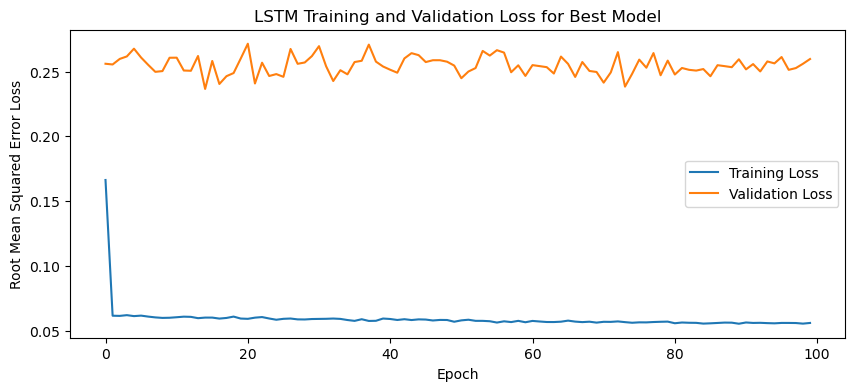

1/1 - 3s - loss: 0.0502 - 3s/epoch - 3s/step
Test Loss: 0.050219908356666565
1/1 [==============================] - 0s 74ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

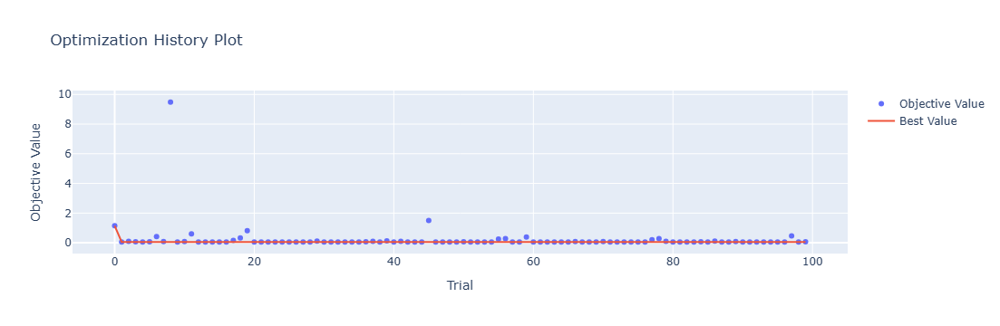

In [4]:
optuna.visualization.plot_optimization_history(study)

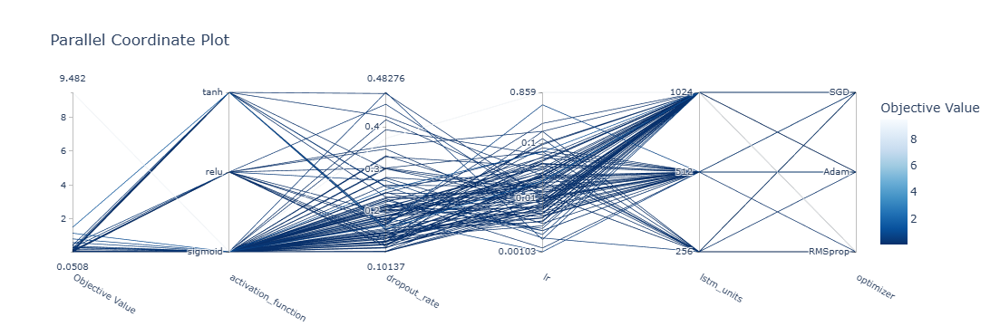

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

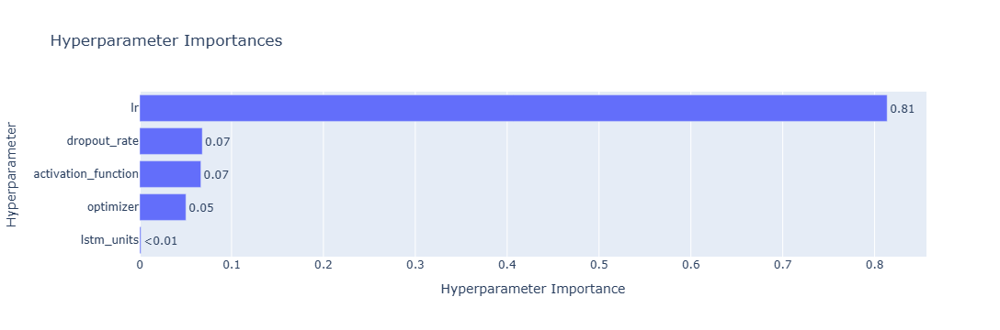

In [6]:
optuna.visualization.plot_param_importances(study)

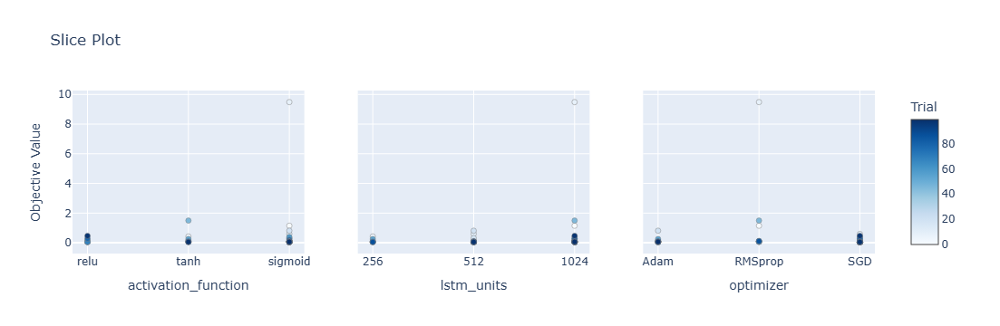

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

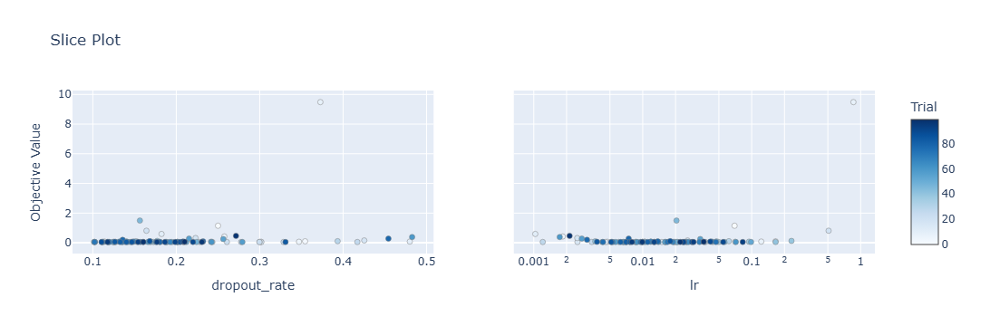

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 9s 55ms/step - loss: 0.1751 - accuracy: 0.3929 - mae: 0.1439 - rmse: 0.1751 - mape: inf - pearson: 0.6293 - val_loss: 0.0659 - val_accuracy: 0.4000 - val_mae: 0.0520 - val_rmse: 0.0659 - val_mape: 11.3312 - val_pearson: 0.8297
Epoch 2/100
84/84 [==============================] - 3s 41ms/step - loss: 0.0616 - accuracy: 0.5000 - mae: 0.0484 - rmse: 0.0616 - mape: inf - pearson: 0.8343 - val_loss: 0.0559 - val_accuracy: 0.4000 - val_mae: 0.0447 - val_rmse: 0.0559 - val_mape: 10.0203 - val_pearson: 0.8510
Epoch 3/100
84/84 [==============================] - 4s 43ms/step - loss: 0.0610 - accuracy: 0.5238 - mae: 0.0480 - rmse: 0.0610 - mape: inf - pearson: 0.8332 - val_loss: 0.0707 - val_accuracy: 0.4000 - val_mae: 0.0564 - val_rmse: 0.0707 - val_mape: 12.8294 - val_pearson: 0.7651
Epoch 4/100
84/84 [==============================] - 4s 50ms/step - loss: 0.0622 - accuracy: 0.4881 - mae: 0.0492 - rmse: 0.0622 - mape: inf - pearson: 0.8303 -

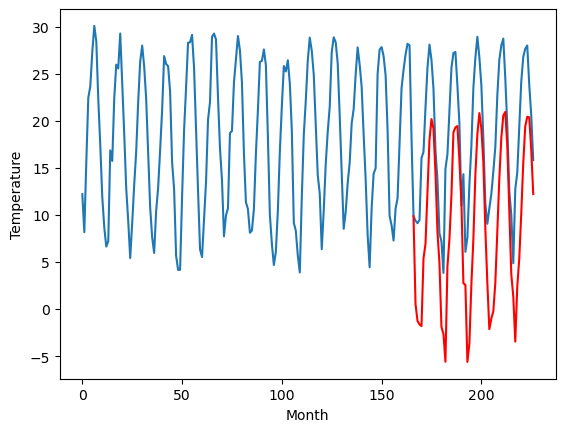

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.43		0.52
-1.85		-2.23		-0.38
-2.23		-2.60		-0.37
-1.48		-2.77		-1.29
4.35		4.42		0.07
4.84		5.97		1.13
7.61		11.51		3.90
11.36		17.02		5.66
11.84		19.21		7.37
12.47		18.22		5.75
9.49		13.48		3.99
6.86		7.23		0.37
3.44		3.89		0.45
-3.77		-2.87		0.90
-3.11		-3.62		-0.51
-3.20		-6.56		-3.36
1.86		3.56		1.70
3.26		6.47		3.21
7.28		11.10		3.82
10.76		17.81		7.05
11.98		18.33		6.35
12.32		18.47		6.15
10.19		14.81		4.62
7.56		10.39		2.83
2.05		1.77		-0.28
1.81		1.60		-0.21
-4.87		-6.57		-1.70
-2.10		-4.64		-2.54
1.76		1.69		-0.07
4.73		6.46		1.73
9.04		13.30		4.26
12.73		17.61		4.88
12.87		19.86		6.99
12.32		18.23		5.91
11.30		14.64		3.34
5.70		7.54		1.84
3.01		1.84		-1.17
-0.84		-3.08		-2.24
-0.05		-1.96		-1.91
1.05		-1.15		-2.20
2.64		1.84		-0.80
4.79		7.32		2.53
7.97		12.90		4.93
11.05		17.24		6.19
12.88		19.62		6.74
14.47		20.00		5.53
11.09		16.41		5.32
5.98		9.54		3.56
0.74		2.77		2.0

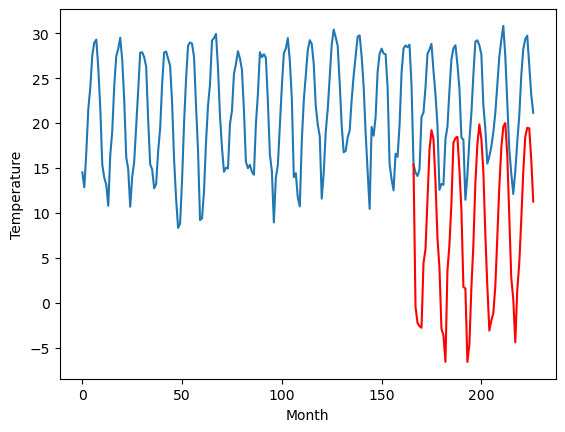

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.10		-1.81		1.29
-3.21		-3.61		-0.40
-3.83		-3.98		-0.15
-3.21		-4.16		-0.95
3.04		3.04		0.00
2.80		4.58		1.78
6.49		10.12		3.63
10.21		15.63		5.42
12.58		17.83		5.25
11.82		16.84		5.02
8.43		12.09		3.66
4.71		5.84		1.13
-0.22		2.50		2.72
-7.22		-4.26		2.96
-6.40		-5.02		1.38
-5.54		-7.96		-2.42
0.44		2.17		1.73
2.08		5.06		2.98
6.06		9.69		3.63
10.20		16.40		6.20
11.96		16.93		4.97
12.24		17.07		4.83
8.67		13.41		4.74
4.79		8.99		4.20
-3.57		0.37		3.94
-1.39		0.21		1.60
-7.40		-7.97		-0.57
-3.45		-6.03		-2.58
0.05		0.30		0.25
2.79		5.07		2.28
8.55		11.91		3.36
12.33		16.22		3.89
13.25		18.48		5.23
12.02		16.85		4.83
8.90		13.26		4.36
1.76		6.16		4.40
-0.72		0.46		1.18
-5.24		-4.47		0.77
-3.29		-3.34		-0.05
-0.51		-2.53		-2.02
-0.53		0.46		0.99
2.54		5.94		3.40
5.95		11.53		5.58
9.27		15.86		6.59
12.37		18.25		5.88
11.98		18.63		6.65
8.53		15.04		6.51
2.55		8.16		5.61
-2.54		1.39		3.93
-5.5

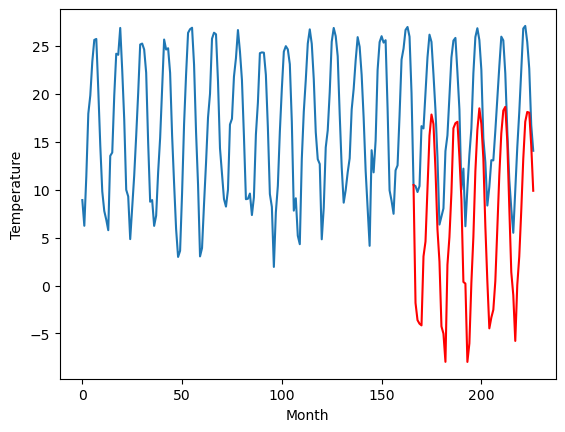

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.49		-3.01		-0.52
-2.51		-4.79		-2.28
-2.47		-5.16		-2.69
-2.47		-5.33		-2.86
4.45		1.86		-2.59
4.53		3.41		-1.12
7.42		8.95		1.53
10.33		14.46		4.13
11.30		16.66		5.36
11.64		15.67		4.03
9.31		10.92		1.61
5.25		4.68		-0.57
2.41		1.34		-1.07
-5.05		-5.43		-0.38
-4.96		-6.17		-1.21
-6.53		-9.11		-2.58
1.38		1.02		-0.36
3.17		3.91		0.74
7.14		8.54		1.40
10.42		15.24		4.82
11.05		15.77		4.72
11.10		15.92		4.82
8.59		12.25		3.66
6.28		7.83		1.55
-1.81		-0.80		1.01
0.96		-0.96		-1.92
-6.39		-9.12		-2.73
-3.95		-7.19		-3.24
-0.16		-0.87		-0.71
4.63		3.91		-0.72
9.15		10.75		1.60
11.58		15.06		3.48
11.56		17.31		5.75
10.37		15.70		5.33
9.13		12.10		2.97
3.51		5.01		1.50
-0.60		-0.70		-0.10
-2.78		-5.62		-2.84
-1.34		-4.49		-3.15
-0.93		-3.67		-2.74
2.59		-0.68		-3.27
4.01		4.79		0.78
8.44		10.38		1.94
12.19		14.72		2.53
13.31		17.10		3.79
14.84		17.48		2.64
11.40		13.88		2.48
5.15		7.01		1.86
-0.7

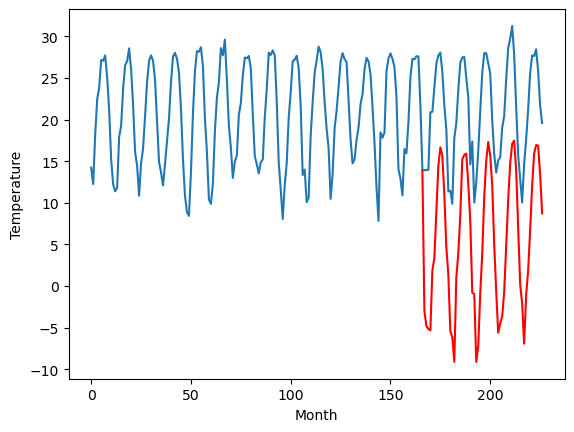

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.32		3.91		-1.41
3.27		2.12		-1.15
4.01		1.74		-2.27
3.34		1.57		-1.77
11.09		8.76		-2.33
11.34		10.30		-1.04
16.32		15.85		-0.47
20.52		21.35		0.83
22.13		23.55		1.42
22.62		22.56		-0.06
16.91		17.81		0.90
12.03		11.56		-0.47
9.51		8.22		-1.29
3.04		1.46		-1.58
2.16		0.71		-1.45
-0.93		-2.23		-1.30
8.97		7.89		-1.08
10.90		10.78		-0.12
14.76		15.41		0.65
19.96		22.11		2.15
20.39		22.64		2.25
21.15		22.78		1.63
19.14		19.12		-0.02
14.79		14.69		-0.10
7.22		6.07		-1.15
9.55		5.91		-3.64
1.10		-2.26		-3.36
0.87		-0.33		-1.20
7.36		5.99		-1.37
13.40		10.77		-2.63
18.11		17.61		-0.50
22.45		21.92		-0.53
24.81		24.17		-0.64
22.45		22.55		0.10
19.50		18.95		-0.55
13.58		11.85		-1.73
6.65		6.14		-0.51
3.92		1.22		-2.70
4.89		2.34		-2.55
5.02		3.16		-1.86
9.74		6.15		-3.59
11.24		11.62		0.38
16.77		17.21		0.44
21.32		21.55		0.23
24.31		23.93		-0.38
26.05		24.31		-1.74
21.57		20.71		-0.86
13.91		13.8

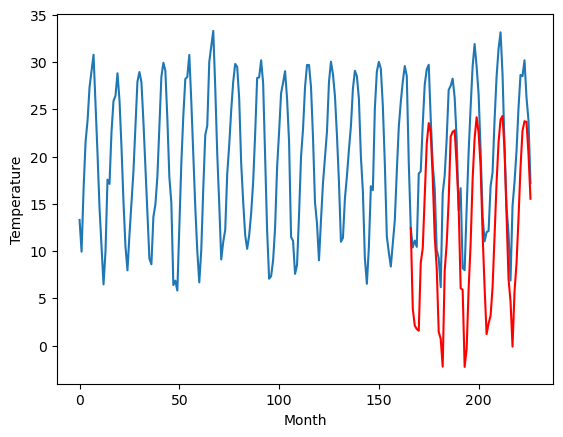

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.85		6.22		0.37
5.28		4.43		-0.85
4.75		4.07		-0.68
4.44		3.88		-0.56
8.03		11.07		3.04
10.00		12.61		2.61
13.69		18.14		4.45
18.04		23.65		5.61
21.78		25.84		4.06
20.93		24.85		3.92
17.90		20.10		2.20
13.81		13.86		0.05
9.69		10.51		0.82
2.94		3.74		0.80
1.16		2.99		1.83
1.81		0.05		-1.76
6.71		10.18		3.47
10.08		13.06		2.98
13.59		17.70		4.11
18.16		24.40		6.24
20.15		24.93		4.78
20.63		25.07		4.44
17.62		21.40		3.78
14.02		16.98		2.96
5.85		8.35		2.50
6.90		8.21		1.31
0.52		0.04		-0.48
4.13		1.97		-2.16
8.05		8.30		0.25
10.92		13.08		2.16
15.55		19.91		4.36
19.12		24.23		5.11
21.26		26.48		5.22
20.41		24.87		4.46
17.76		21.27		3.51
11.20		14.17		2.97
9.51		8.47		-1.04
2.99		3.55		0.56
4.68		4.69		0.01
6.17		5.50		-0.67
7.08		8.49		1.41
11.76		13.98		2.22
13.28		19.56		6.28
17.10		23.91		6.81
20.93		26.28		5.35
20.45		26.67		6.22
16.93		23.08		6.15
12.58		16.21		3.63
7.14		9.44		2.30
5.00	

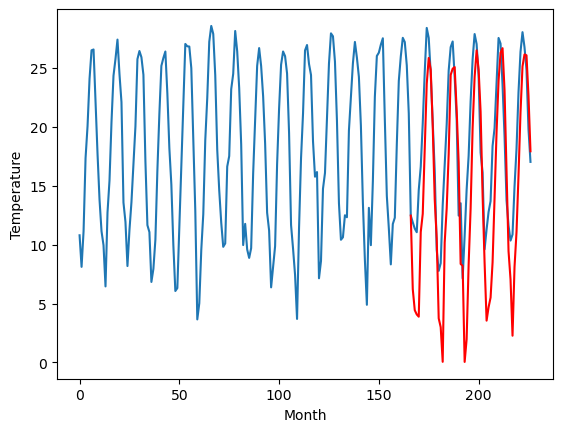

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.20		0.60		1.80
-1.56		-1.19		0.37
-2.03		-1.55		0.48
-0.92		-1.74		-0.82
4.50		5.46		0.96
5.74		7.00		1.26
8.08		12.54		4.46
13.33		18.05		4.72
16.40		20.24		3.84
15.37		19.24		3.87
11.48		14.49		3.01
7.48		8.25		0.77
3.30		4.91		1.61
-3.63		-1.86		1.77
-4.21		-2.60		1.61
-3.57		-5.54		-1.97
3.41		4.58		1.17
4.44		7.47		3.03
8.15		12.10		3.95
12.48		18.80		6.32
14.10		19.33		5.23
14.04		19.47		5.43
9.99		15.81		5.82
6.76		11.39		4.63
-1.89		2.75		4.64
0.05		2.61		2.56
-6.60		-5.56		1.04
-2.62		-3.62		-1.00
1.72		2.71		0.99
4.64		7.49		2.85
9.71		14.32		4.61
13.62		18.63		5.01
14.72		20.89		6.17
13.43		19.27		5.84
10.37		15.68		5.31
3.43		8.58		5.15
1.20		2.88		1.68
-5.31		-2.04		3.27
-2.12		-0.90		1.22
0.88		-0.08		-0.96
1.36		2.90		1.54
4.92		8.39		3.47
7.61		13.97		6.36
10.96		18.32		7.36
14.67		20.70		6.03
13.98		21.09		7.11
10.47		17.49		7.02
5.26		10.62		5.36
-0.61		3.85		4.46
-2.90		

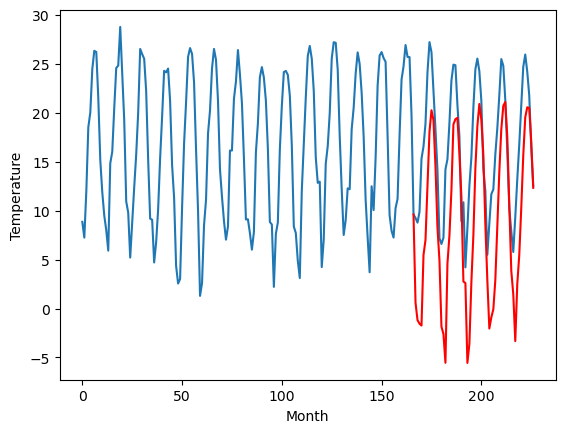

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.01		5.92		1.91
3.64		4.13		0.49
3.52		3.76		0.24
4.56		3.57		-0.99
10.14		10.77		0.63
11.04		12.31		1.27
14.16		17.85		3.69
19.68		23.36		3.68
22.94		25.55		2.61
21.57		24.55		2.98
16.70		19.79		3.09
12.86		13.56		0.70
8.63		10.22		1.59
1.70		3.45		1.75
0.76		2.69		1.93
1.38		-0.24		-1.62
7.90		9.88		1.98
11.53		12.77		1.24
14.55		17.40		2.85
19.34		24.11		4.77
21.46		24.63		3.17
21.41		24.77		3.36
16.90		21.11		4.21
13.05		16.69		3.64
3.55		8.05		4.50
5.61		7.90		2.29
-1.57		-0.26		1.31
2.67		1.68		-0.99
7.51		8.01		0.50
10.83		12.78		1.95
15.81		19.62		3.81
19.81		23.93		4.12
21.68		26.19		4.51
20.00		24.57		4.57
16.30		20.98		4.68
9.11		13.88		4.77
6.91		8.18		1.27
-0.26		3.26		3.52
2.91		4.40		1.49
5.88		5.21		-0.67
6.56		8.20		1.64
11.18		13.69		2.51
13.47		19.28		5.81
17.22		23.62		6.40
21.36		26.00		4.64
20.22		26.39		6.17
16.46		22.80		6.34
11.07		15.92		4.85
4.62		9.15		4.53
3.03		

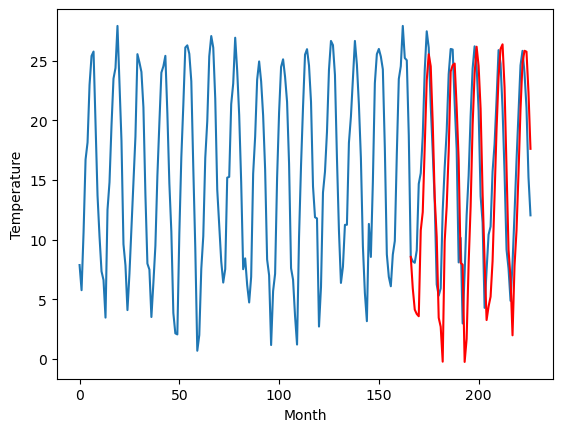

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.48		4.99		0.51
4.32		3.19		-1.13
3.13		2.83		-0.30
3.63		2.64		-0.99
10.20		9.84		-0.36
12.48		11.38		-1.10
17.36		16.92		-0.44
23.29		22.43		-0.86
26.03		24.62		-1.41
23.02		23.62		0.60
19.46		18.86		-0.60
12.20		12.61		0.41
9.34		9.28		-0.06
2.63		2.51		-0.12
1.84		1.76		-0.08
-2.43		-1.17		1.26
10.04		8.95		-1.09
12.64		11.83		-0.81
17.33		16.46		-0.87
23.52		23.17		-0.35
24.09		23.70		-0.39
24.03		23.84		-0.19
20.29		20.18		-0.11
16.33		15.75		-0.58
6.29		7.12		0.83
8.09		6.97		-1.12
-0.42		-1.20		-0.78
1.62		0.73		-0.89
8.84		7.07		-1.77
12.79		11.84		-0.95
19.63		18.68		-0.95
24.15		22.98		-1.17
26.48		25.24		-1.24
23.60		23.63		0.03
19.96		20.04		0.08
13.40		12.94		-0.46
7.43		7.23		-0.20
2.14		2.31		0.17
4.70		3.44		-1.26
6.31		4.25		-2.06
8.13		7.23		-0.90
13.91		12.73		-1.18
19.50		18.31		-1.19
23.37		22.65		-0.72
24.86		25.03		0.17
23.60		25.41		1.81
20.43		21.82		1.39
14.83		14.

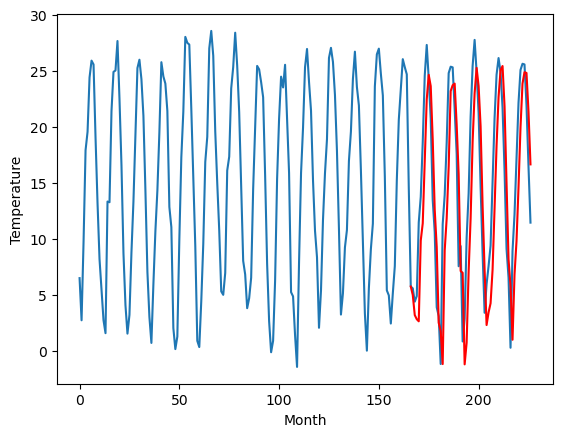

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.26		2.48		2.74
-0.08		0.69		0.77
-1.36		0.32		1.68
-2.23		0.13		2.36
4.96		7.33		2.37
6.62		8.88		2.26
11.71		14.41		2.70
18.69		19.93		1.24
21.32		22.12		0.80
18.94		21.12		2.18
15.27		16.37		1.10
8.88		10.13		1.25
5.20		6.79		1.59
-2.31		0.03		2.34
-3.90		-0.72		3.18
-6.07		-3.66		2.41
4.68		6.47		1.79
7.74		9.35		1.61
12.21		13.98		1.77
18.69		20.69		2.00
19.70		21.21		1.51
20.30		21.36		1.06
16.44		17.69		1.25
11.97		13.27		1.30
1.31		4.63		3.32
2.54		4.49		1.95
-6.43		-3.68		2.75
-2.85		-1.74		1.11
4.13		4.59		0.46
6.86		9.37		2.51
15.03		16.21		1.18
18.93		20.51		1.58
20.96		22.76		1.80
19.05		21.15		2.10
15.32		17.56		2.24
8.28		10.46		2.18
3.26		4.75		1.49
-2.45		-0.18		2.27
-0.56		0.95		1.51
1.48		1.75		0.27
1.82		4.74		2.92
8.10		10.24		2.14
13.06		15.83		2.77
16.90		20.17		3.27
19.73		22.55		2.82
18.93		22.93		4.00
16.32		19.34		3.02
9.74		12.47		2.73
3.24		5.69		2.45
0.81		3.3

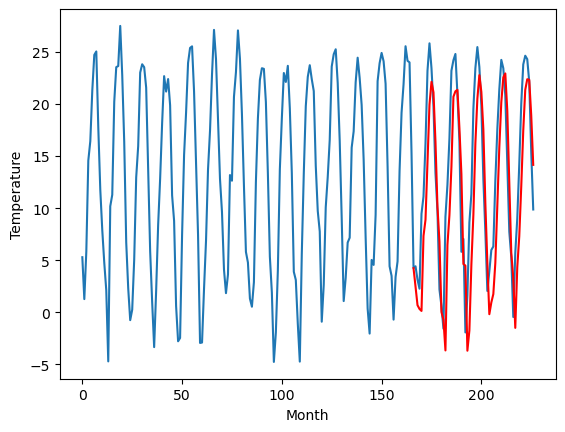

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.50		0.54		2.04
-2.17		-1.26		0.91
-3.20		-1.61		1.59
-4.66		-1.81		2.85
1.48		5.39		3.91
4.13		6.94		2.81
10.56		12.47		1.91
18.52		17.99		-0.53
21.68		20.18		-1.50
18.99		19.18		0.19
14.16		14.43		0.27
7.41		8.19		0.78
3.93		4.85		0.92
-3.10		-1.91		1.19
-4.71		-2.66		2.05
-9.02		-5.60		3.42
2.71		4.54		1.83
6.68		7.42		0.74
11.83		12.05		0.22
19.14		18.77		-0.37
19.73		19.29		-0.44
20.44		19.44		-1.00
16.39		15.78		-0.61
12.04		11.35		-0.69
1.18		2.72		1.54
0.28		2.57		2.29
-8.67		-5.61		3.06
-5.43		-3.66		1.77
1.48		2.67		1.19
5.09		7.46		2.37
14.41		14.30		-0.11
19.17		18.60		-0.57
20.28		20.85		0.57
19.16		19.24		0.08
15.32		15.66		0.34
8.08		8.55		0.47
3.05		2.84		-0.21
-3.13		-2.08		1.05
-2.00		-0.96		1.04
-1.59		-0.16		1.43
0.27		2.83		2.56
7.12		8.33		1.21
12.14		13.93		1.79
17.65		18.27		0.62
20.11		20.65		0.54
18.30		21.03		2.73
15.92		17.45		1.53
9.96		10.58		0.62
2.32		3.81		

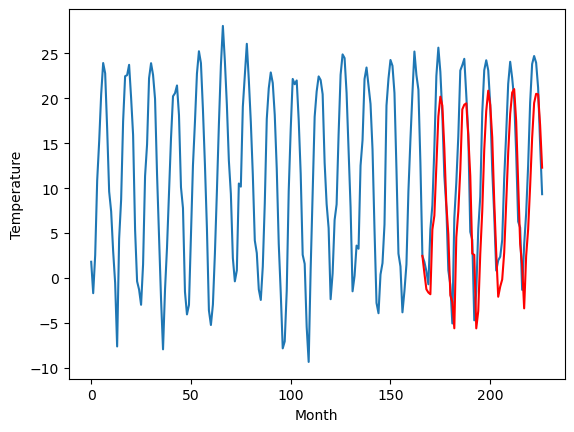

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[0.5451417922973629, -0.4341048049926757, -1.8144128417968748, -3.0068931198120117, 3.911184272766114, 6.219623107910156, 0.6033536529541017, 5.918552856445313, 4.986488151550294, 2.4768476867675773, 0.5367151260375973]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   0.545142
1                 1   -0.95  -0.434105
2                 2   -3.10  -1.814413
3                 3   -2.49  -3.006893
4                 4    5.32   3.911184
5                 5    5.85   6.219623
6                 6   -1.20   0.603354
7                 7    4.01   5.918553
8                 8    4.48   4.986488
9                 9   -0.26   2.476848
10               10   -1.50   0.536715


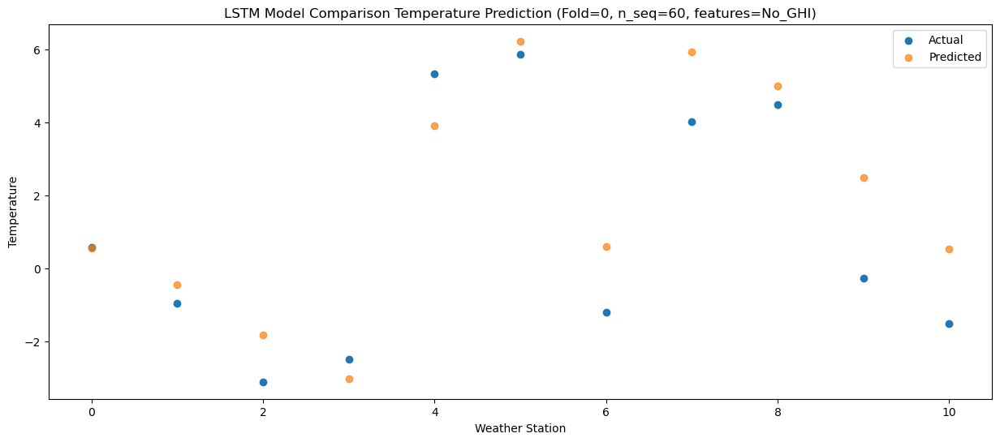

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11  -1.259483
1                 1   -1.85  -2.230250
2                 2   -3.21  -3.609222
3                 3   -2.51  -4.793359
4                 4    3.27   2.115670
5                 5    5.28   4.432518
6                 6   -1.56  -1.185039
7                 7    3.64   4.128361
8                 8    4.32   3.194219
9                 9   -0.08   0.685561
10               10   -2.17  -1.255964


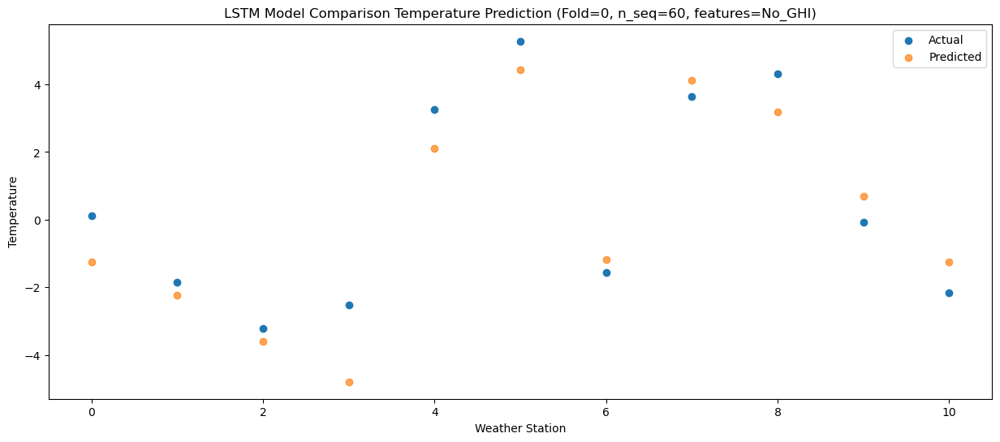

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -1.632362
1                 1   -2.23  -2.597457
2                 2   -3.83  -3.980368
3                 3   -2.47  -5.160300
4                 4    4.01   1.744274
5                 5    4.75   4.068992
6                 6   -2.03  -1.551797
7                 7    3.52   3.764439
8                 8    3.13   2.826662
9                 9   -1.36   0.321996
10               10   -3.20  -1.614226


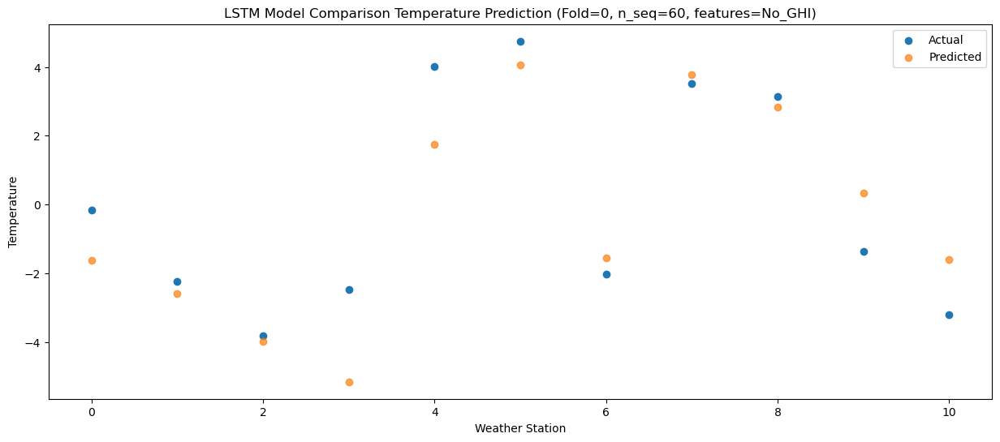

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -1.809155
1                 1   -1.48  -2.771985
2                 2   -3.21  -4.155783
3                 3   -2.47  -5.332577
4                 4    3.34   1.566347
5                 5    4.44   3.880962
6                 6   -0.92  -1.737836
7                 7    4.56   3.574366
8                 8    3.63   2.637641
9                 9   -2.23   0.133316
10               10   -4.66  -1.806708


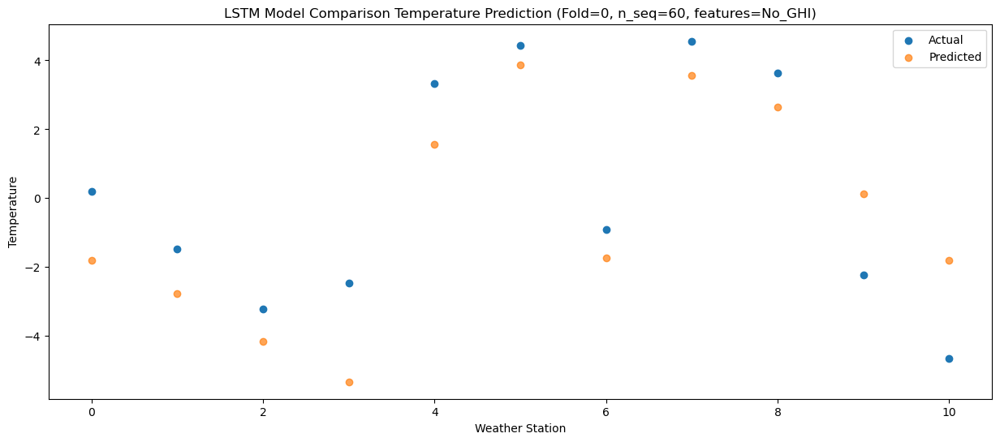

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   5.384181
1                 1    4.35   4.419018
2                 2    3.04   3.040191
3                 3    4.45   1.857569
4                 4   11.09   8.756819
5                 5    8.03  11.066854
6                 6    4.50   5.456150
7                 7   10.14  10.773289
8                 8   10.20   9.839678
9                 9    4.96   7.333766
10               10    1.48   5.394607


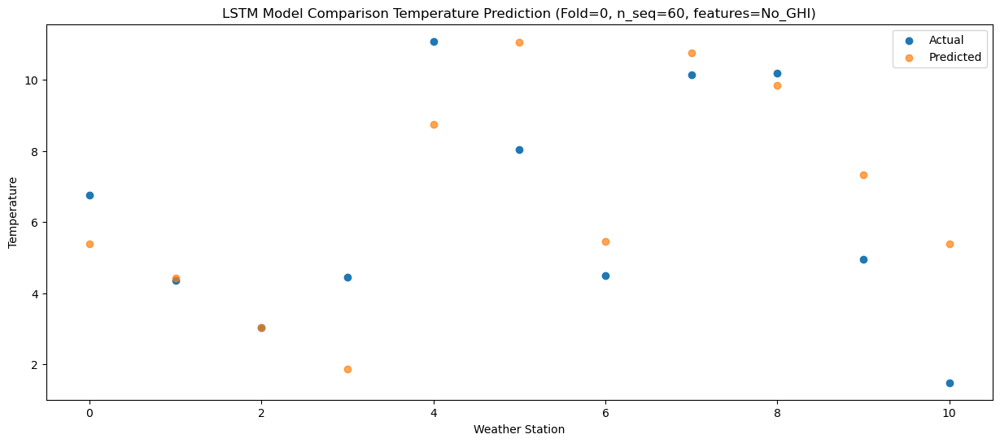

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   6.928027
1                 1    4.84   5.966160
2                 2    2.80   4.583850
3                 3    4.53   3.405087
4                 4   11.34  10.301109
5                 5   10.00  12.609092
6                 6    5.74   6.997242
7                 7   11.04  12.311662
8                 8   12.48  11.380470
9                 9    6.62   8.876883
10               10    4.13   6.939174


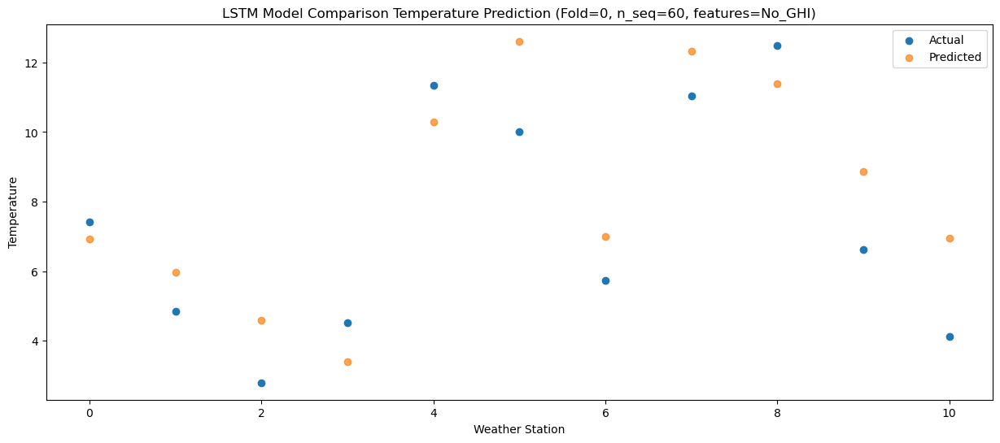

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  12.468087
1                 1    7.61  11.505582
2                 2    6.49  10.123553
3                 3    7.42   8.953030
4                 4   16.32  15.845259
5                 5   13.69  18.144365
6                 6    8.08  12.535818
7                 7   14.16  17.847570
8                 8   17.36  16.915786
9                 9   11.71  14.411353
10               10   10.56  12.472532


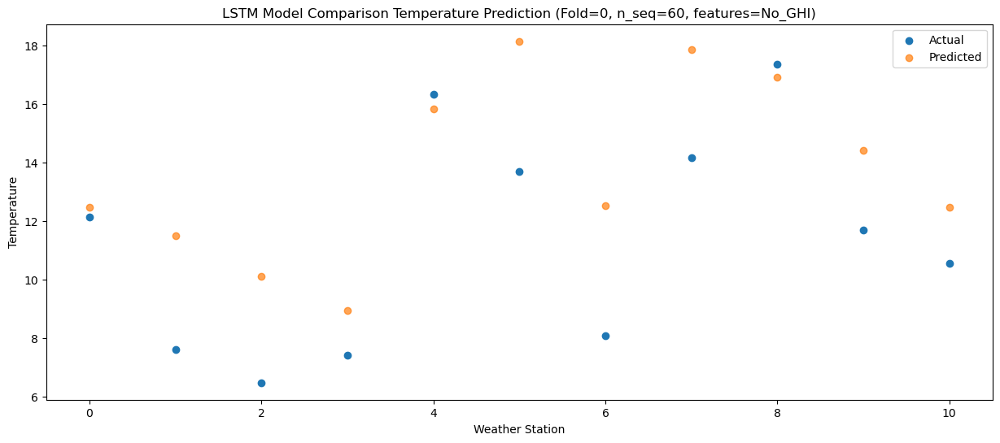

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  17.981136
1                 1   11.36  17.019469
2                 2   10.21  15.634773
3                 3   10.33  14.462431
4                 4   20.52  21.350653
5                 5   18.04  23.648293
6                 6   13.33  18.045299
7                 7   19.68  23.358705
8                 8   23.29  22.428233
9                 9   18.69  19.931101
10               10   18.52  17.993123


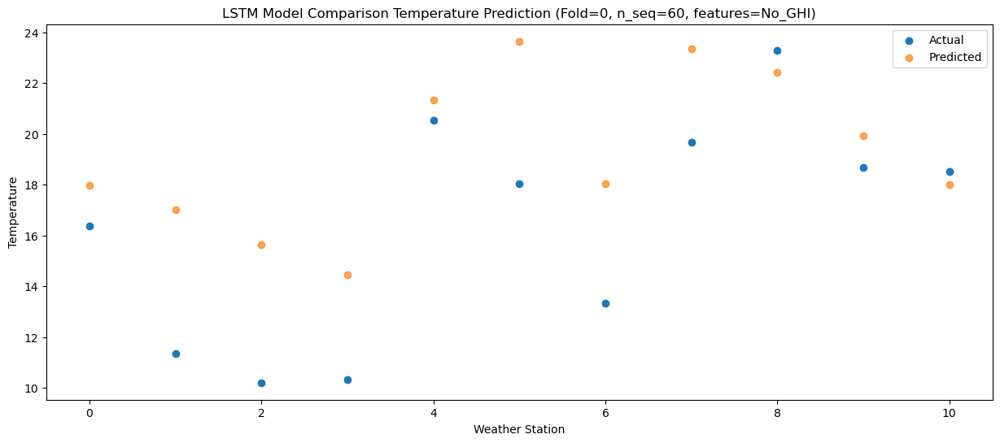

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  20.180104
1                 1   11.84  19.211911
2                 2   12.58  17.829593
3                 3   11.30  16.660180
4                 4   22.13  23.547300
5                 5   21.78  25.842232
6                 6   16.40  20.239759
7                 7   22.94  25.551883
8                 8   26.03  24.618800
9                 9   21.32  22.122744
10               10   21.68  20.184478


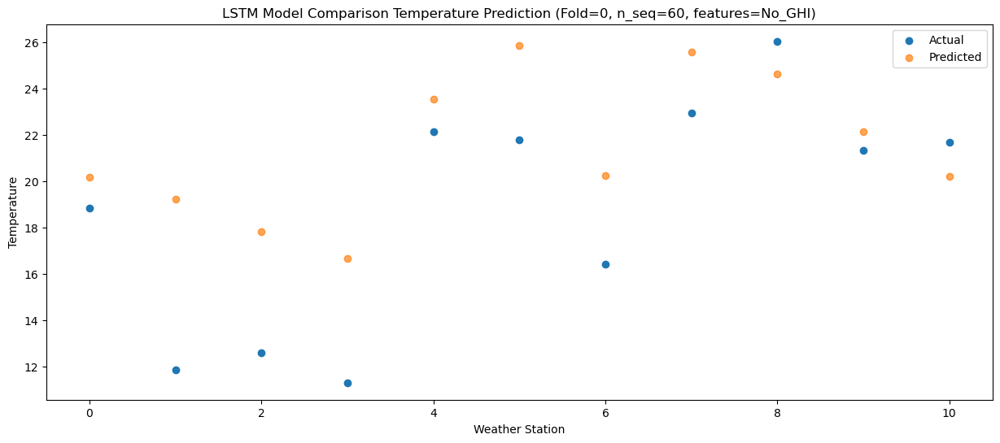

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  19.192209
1                 1   12.47  18.222606
2                 2   11.82  16.835646
3                 3   11.64  15.670966
4                 4   22.62  22.558806
5                 5   20.93  24.847739
6                 6   15.37  19.240454
7                 7   21.57  24.547329
8                 8   23.02  23.616245
9                 9   18.94  21.122620
10               10   18.99  19.183601


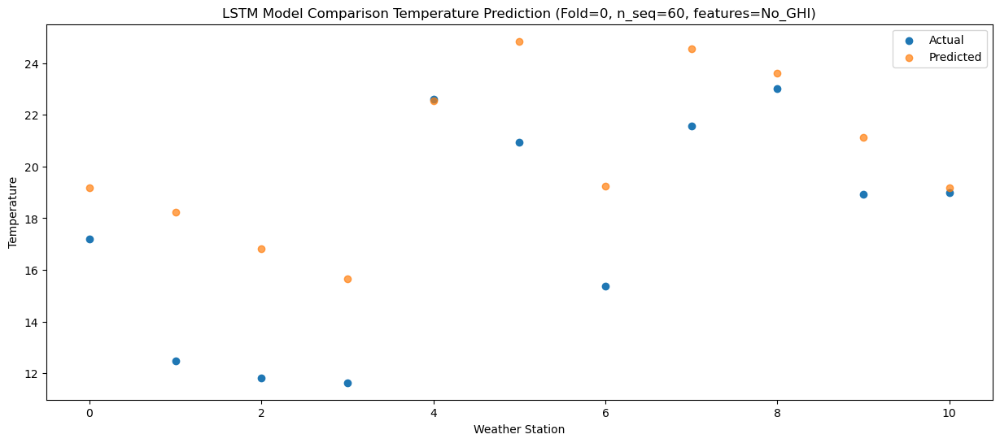

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  14.454908
1                 1    9.49  13.481862
2                 2    8.43  12.092512
3                 3    9.31  10.924523
4                 4   16.91  17.810988
5                 5   17.90  20.095278
6                 6   11.48  14.492242
7                 7   16.70  19.794762
8                 8   19.46  18.861068
9                 9   15.27  16.371639
10               10   14.16  14.432593


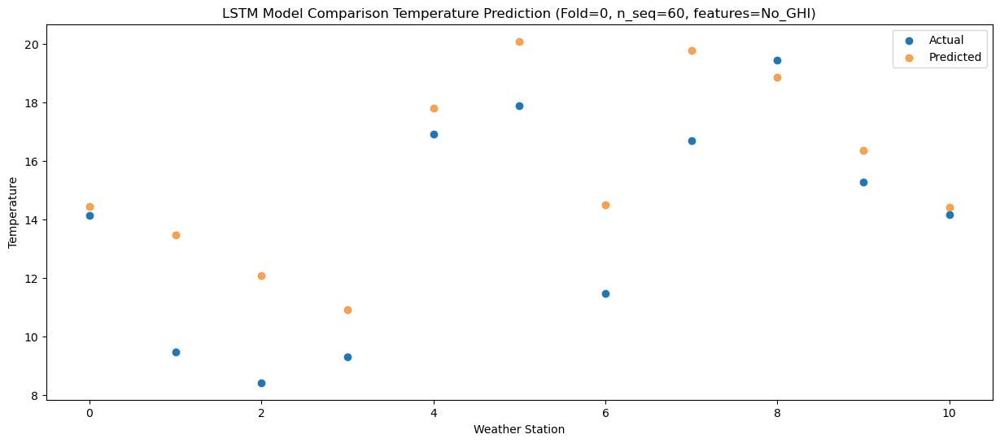

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   8.201467
1                 1    6.86   7.228267
2                 2    4.71   5.842128
3                 3    5.25   4.675679
4                 4   12.03  11.564619
5                 5   13.81  13.855381
6                 6    7.48   8.253351
7                 7   12.86  13.555781
8                 8   12.20  12.612952
9                 9    8.88  10.126039
10               10    7.41   8.187760


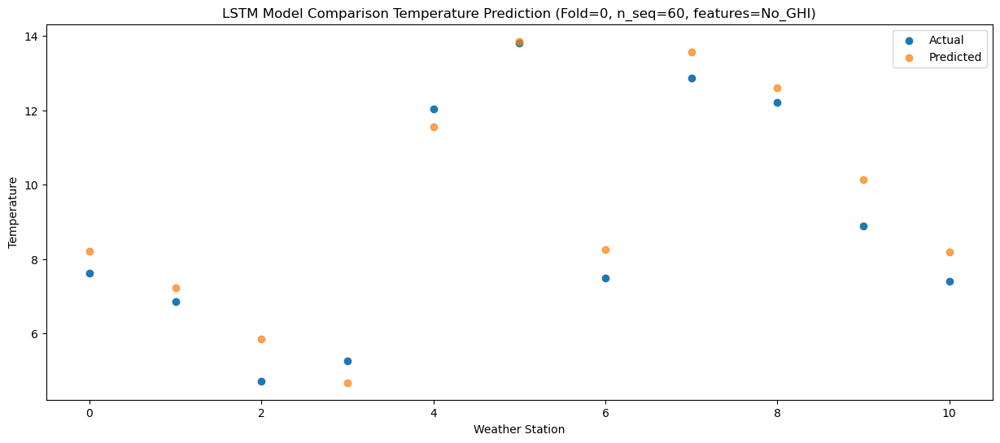

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   4.865571
1                 1    3.44   3.893068
2                 2   -0.22   2.503564
3                 3    2.41   1.337410
4                 4    9.51   8.221106
5                 5    9.69  10.510122
6                 6    3.30   4.914152
7                 7    8.63  10.219293
8                 8    9.34   9.276772
9                 9    5.20   6.791244
10               10    3.93   4.847862


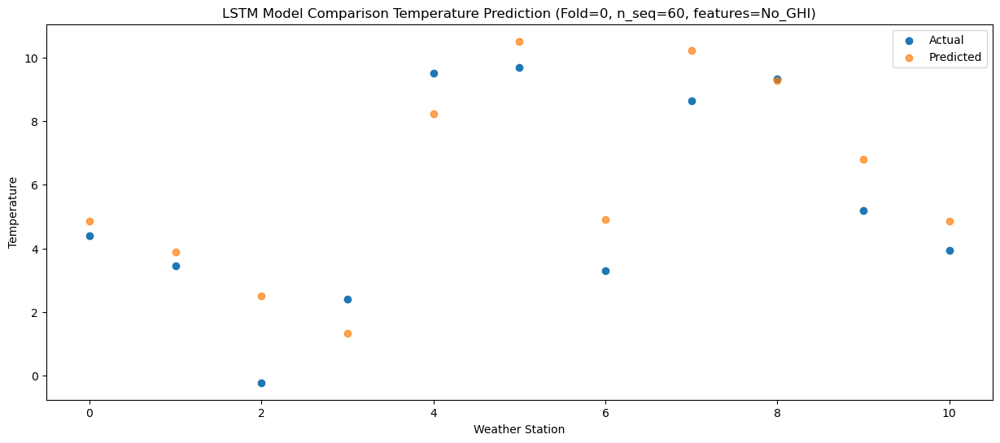

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -1.895033
1                 1   -3.77  -2.872448
2                 2   -7.22  -4.262932
3                 3   -5.05  -5.427014
4                 4    3.04   1.457430
5                 5    2.94   3.740810
6                 6   -3.63  -1.856155
7                 7    1.70   3.445960
8                 8    2.63   2.511117
9                 9   -2.31   0.027975
10               10   -3.10  -1.913652


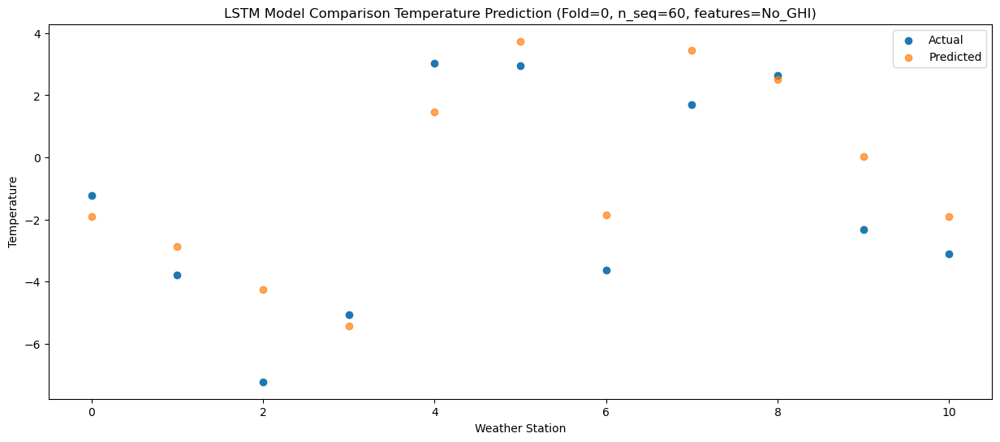

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -2.649083
1                 1   -3.11  -3.623426
2                 2   -6.40  -5.015449
3                 3   -4.96  -6.171060
4                 4    2.16   0.711216
5                 5    1.16   2.991764
6                 6   -4.21  -2.603555
7                 7    0.76   2.694029
8                 8    1.84   1.761898
9                 9   -3.90  -0.720218
10               10   -4.71  -2.662228


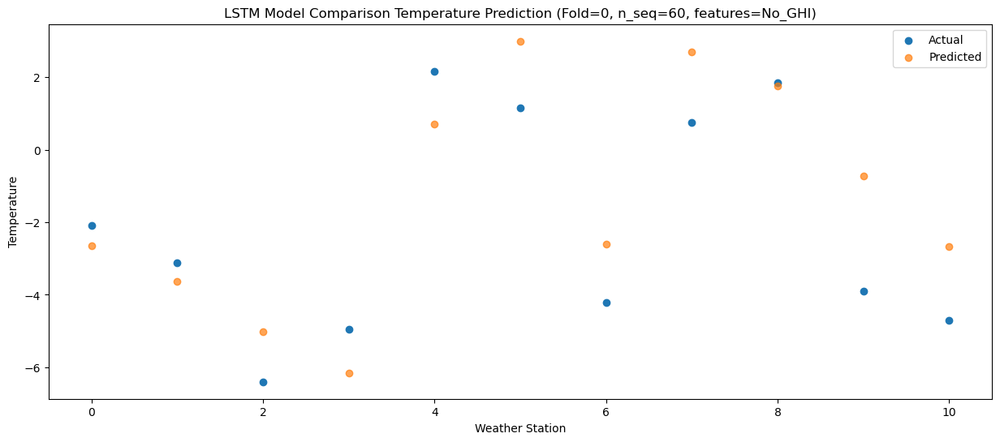

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -5.593357
1                 1   -3.20  -6.564923
2                 2   -5.54  -7.957752
3                 3   -6.53  -9.112573
4                 4   -0.93  -2.234090
5                 5    1.81   0.050177
6                 6   -3.57  -5.541259
7                 7    1.38  -0.237043
8                 8   -2.43  -1.174754
9                 9   -6.07  -3.657809
10               10   -9.02  -5.597988


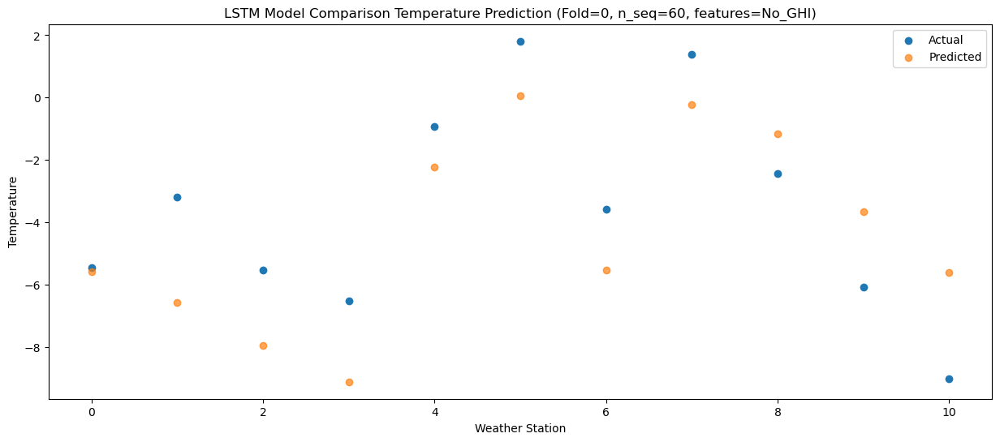

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   4.533970
1                 1    1.86   3.563885
2                 2    0.44   2.168784
3                 3    1.38   1.020121
4                 4    8.97   7.894083
5                 5    6.71  10.177084
6                 6    3.41   4.579778
7                 7    7.90   9.882139
8                 8   10.04   8.952355
9                 9    4.68   6.473766
10               10    2.71   4.540352


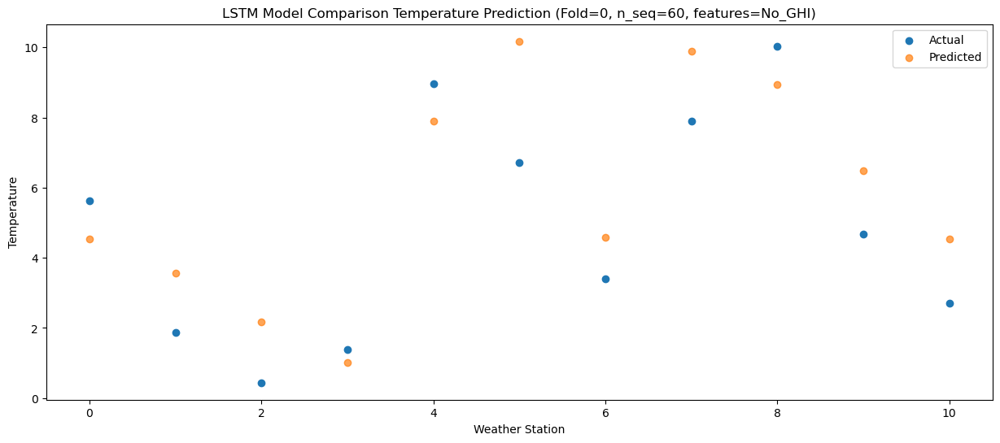

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   7.436149
1                 1    3.26   6.465364
2                 2    2.08   5.063315
3                 3    3.17   3.908659
4                 4   10.90  10.776911
5                 5   10.08  13.062132
6                 6    4.44   7.466931
7                 7   11.53  12.767450
8                 8   12.64  11.830825
9                 9    7.74   9.345863
10               10    6.68   7.416629


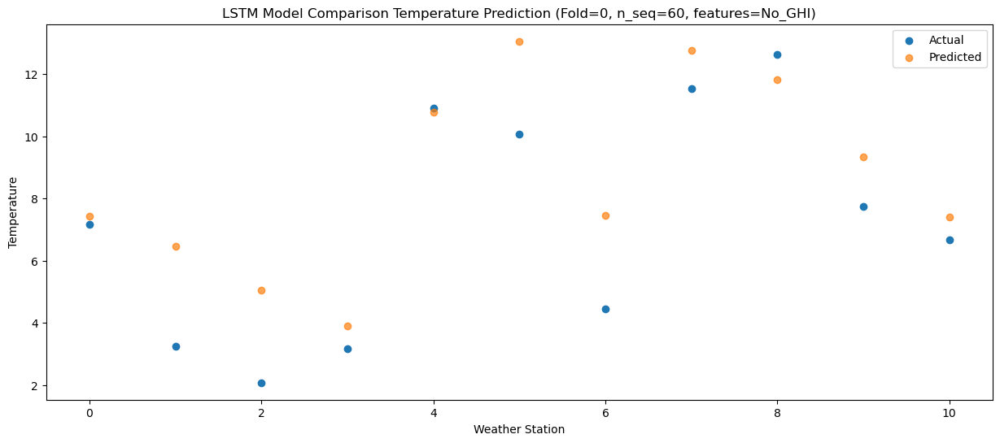

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  12.070223
1                 1    7.28  11.098493
2                 2    6.06   9.694017
3                 3    7.14   8.536399
4                 4   14.76  15.408013
5                 5   13.59  17.695097
6                 6    8.15  12.099237
7                 7   14.55  17.397713
8                 8   17.33  16.460644
9                 9   12.21  13.976205
10               10   11.83  12.046710


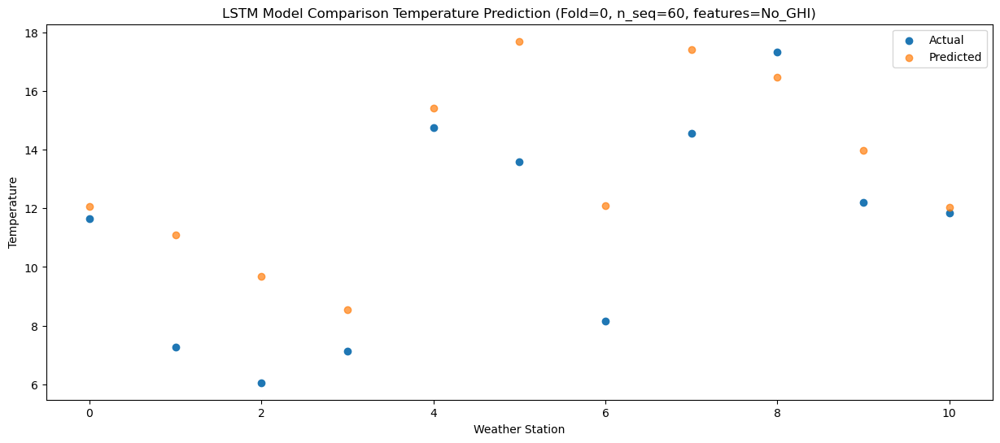

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  18.782214
1                 1   10.76  17.809407
2                 2   10.20  16.401409
3                 3   10.42  15.239983
4                 4   19.96  22.114984
5                 5   18.16  24.402593
6                 6   12.48  18.803368
7                 7   19.34  24.105407
8                 8   23.52  23.174209
9                 9   18.69  20.691018
10               10   19.14  18.768838


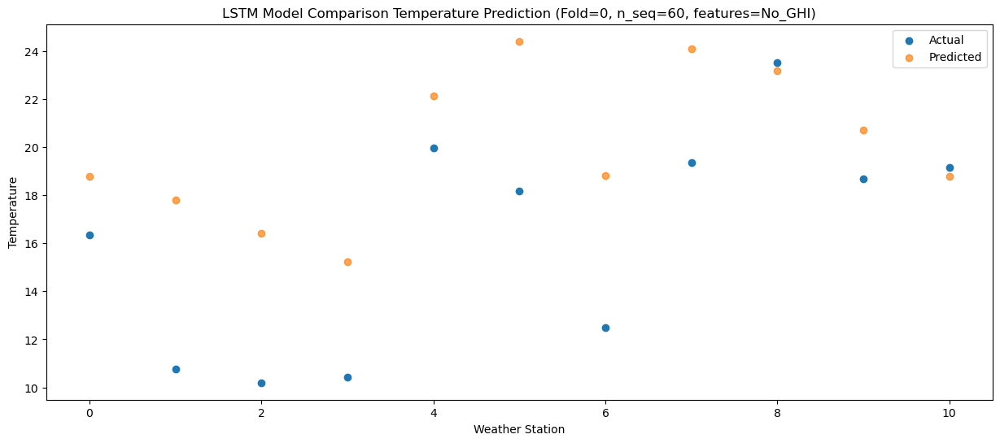

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  19.302229
1                 1   11.98  18.328732
2                 2   11.96  16.927029
3                 3   11.05  15.766407
4                 4   20.39  22.638325
5                 5   20.15  24.929665
6                 6   14.10  19.331123
7                 7   21.46  24.629999
8                 8   24.09  23.698273
9                 9   19.70  21.213913
10               10   19.73  19.293084


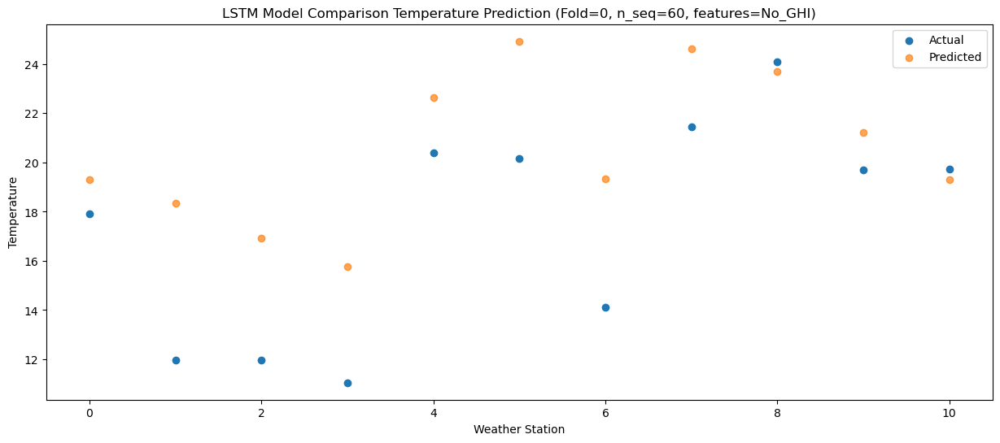

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  19.441289
1                 1   12.32  18.471872
2                 2   12.24  17.074895
3                 3   11.10  15.915385
4                 4   21.15  22.784769
5                 5   20.63  25.066753
6                 6   14.04  19.472666
7                 7   21.41  24.772546
8                 8   24.03  23.841713
9                 9   20.30  21.356948
10               10   20.44  19.440649


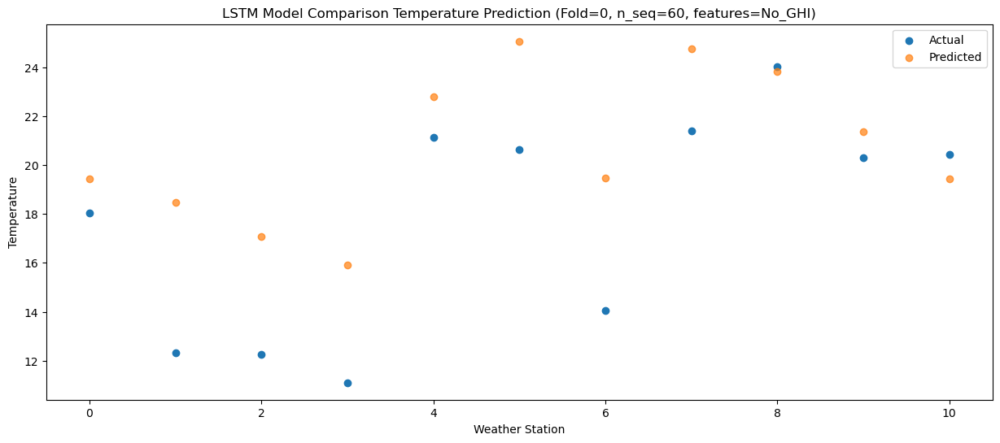

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  15.784082
1                 1   10.19  14.811290
2                 2    8.67  13.414401
3                 3    8.59  12.251392
4                 4   19.14  19.119460
5                 5   17.62  21.401870
6                 6    9.99  15.807104
7                 7   16.90  21.105001
8                 8   20.29  20.177484
9                 9   16.44  17.690940
10               10   16.39  15.780473


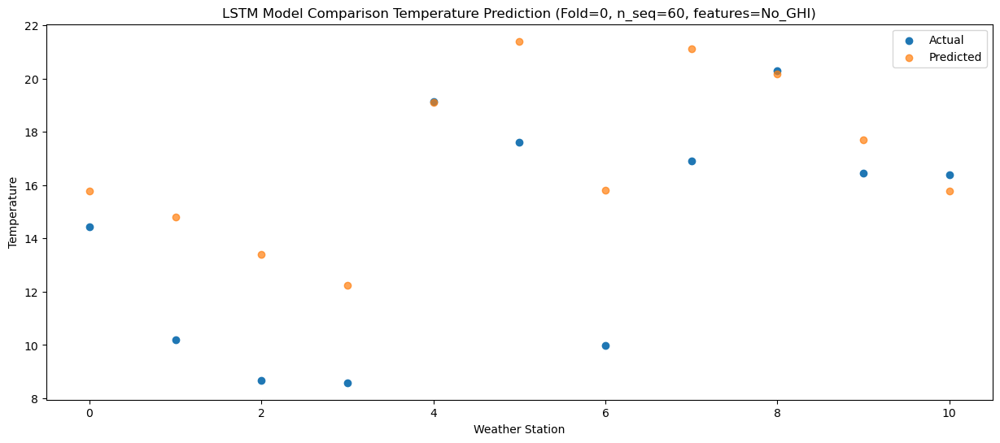

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43  11.354952
1                 1    7.56  10.387816
2                 2    4.79   8.994218
3                 3    6.28   7.830332
4                 4   14.79  14.693843
5                 5   14.02  16.980201
6                 6    6.76  11.387194
7                 7   13.05  16.685276
8                 8   16.33  15.752728
9                 9   11.97  13.268784
10               10   12.04  11.353178


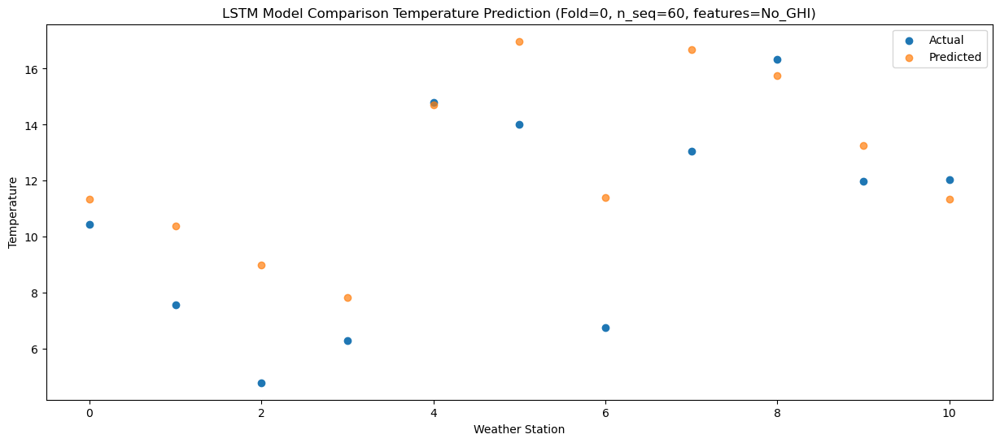

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   2.744304
1                 1    2.05   1.773242
2                 2   -3.57   0.370523
3                 3   -1.81  -0.797396
4                 4    7.22   6.069336
5                 5    5.85   8.352541
6                 6   -1.89   2.752999
7                 7    3.55   8.046883
8                 8    6.29   7.116619
9                 9    1.31   4.633761
10               10    1.18   2.721453


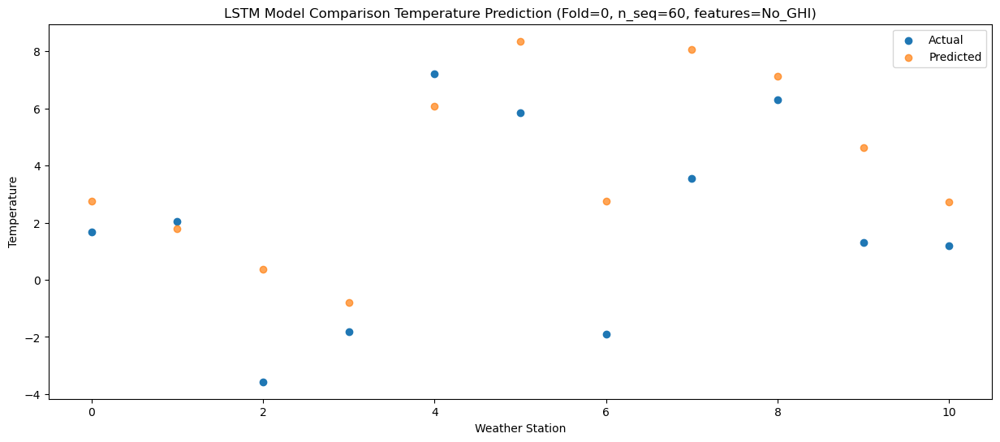

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    5.05   2.570021
1                 1    1.81   1.601400
2                 2   -1.39   0.207552
3                 3    0.96  -0.958328
4                 4    9.55   5.907486
5                 5    6.90   8.205797
6                 6    0.05   2.605354
7                 7    5.61   7.902879
8                 8    8.09   6.967746
9                 9    2.54   4.487829
10               10    0.28   2.571619


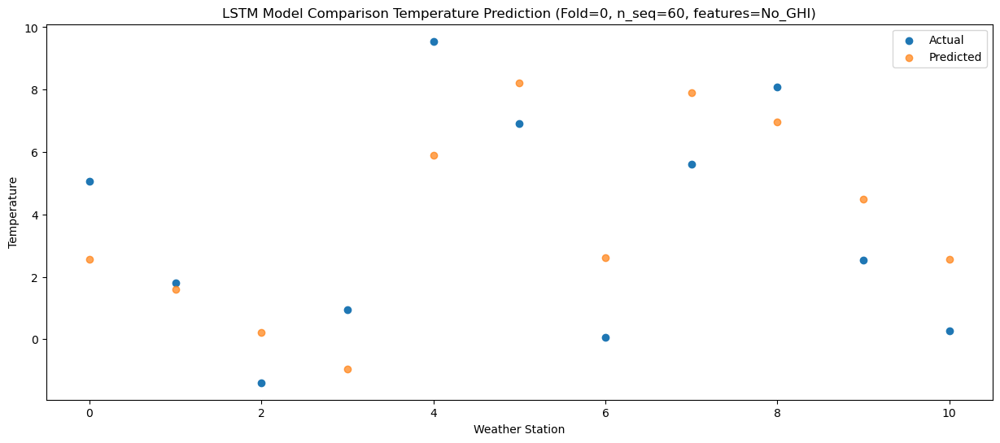

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -5.613776
1                 1   -4.87  -6.572889
2                 2   -7.40  -7.965845
3                 3   -6.39  -9.123185
4                 4    1.10  -2.262838
5                 5    0.52   0.041690
6                 6   -6.60  -5.555004
7                 7   -1.57  -0.257608
8                 8   -0.42  -1.202440
9                 9   -6.43  -3.683918
10               10   -8.67  -5.605688


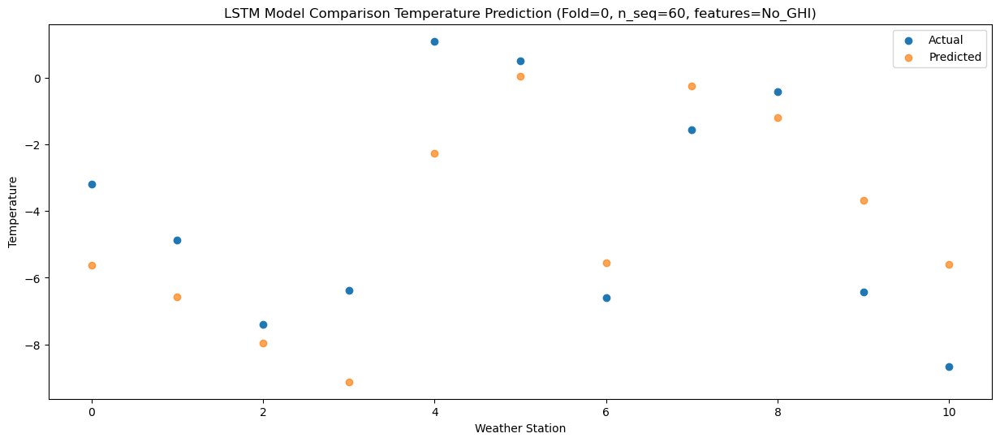

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -3.683106
1                 1   -2.10  -4.640118
2                 2   -3.45  -6.028358
3                 3   -3.95  -7.187919
4                 4    0.87  -0.330705
5                 5    4.13   1.972794
6                 6   -2.62  -3.621663
7                 7    2.67   1.677367
8                 8    1.62   0.734389
9                 9   -2.85  -1.743409
10               10   -5.43  -3.664171


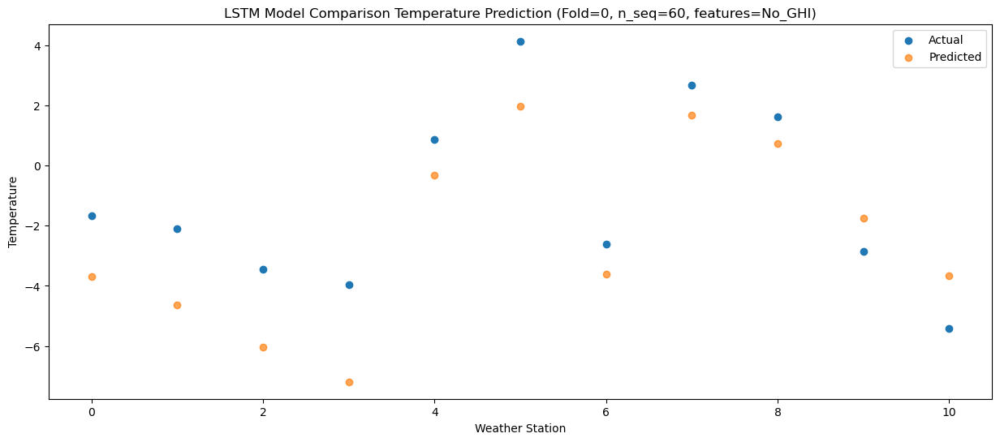

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.90   2.646648
1                 1    1.76   1.686806
2                 2    0.05   0.296702
3                 3   -0.16  -0.865082
4                 4    7.36   5.992426
5                 5    8.05   8.302798
6                 6    1.72   2.710996
7                 7    7.51   8.011347
8                 8    8.84   7.066870
9                 9    4.13   4.593667
10               10    1.48   2.672953


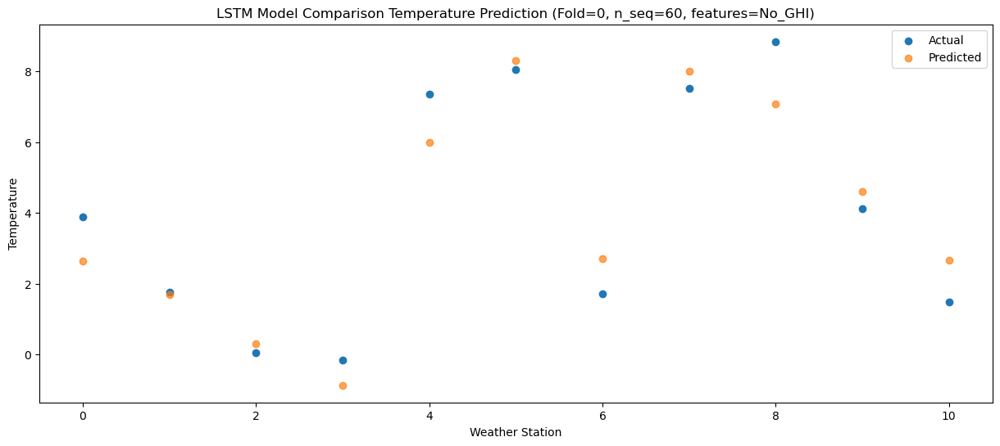

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    8.03   7.428584
1                 1    4.73   6.461897
2                 2    2.79   5.069530
3                 3    4.63   3.910215
4                 4   13.40  10.773466
5                 5   10.92  13.082857
6                 6    4.64   7.487258
7                 7   10.83  12.784837
8                 8   12.79  11.843288
9                 9    6.86   9.373092
10               10    5.09   7.455044


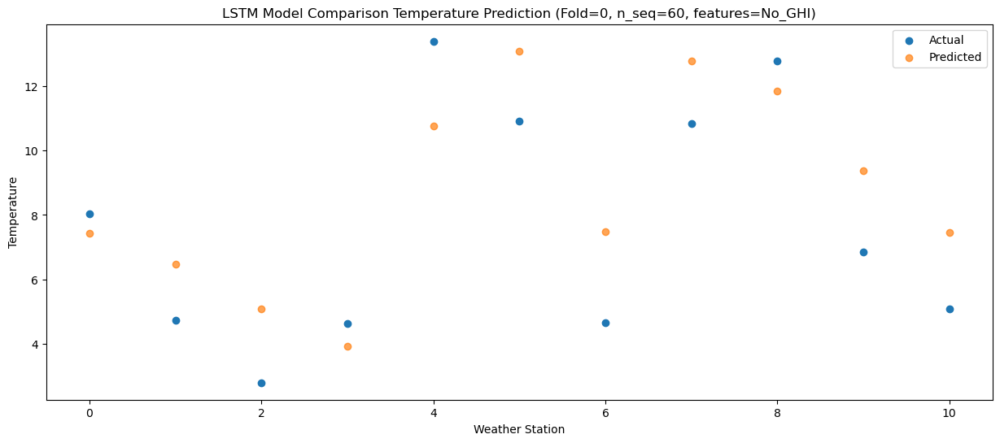

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.22  14.274561
1                 1    9.04  13.303135
2                 2    8.55  11.912739
3                 3    9.15  10.748894
4                 4   18.11  17.611355
5                 5   15.55  19.913845
6                 6    9.71  14.319357
7                 7   15.81  19.616304
8                 8   19.63  18.679177
9                 9   15.03  16.210685
10               10   14.41  14.300546


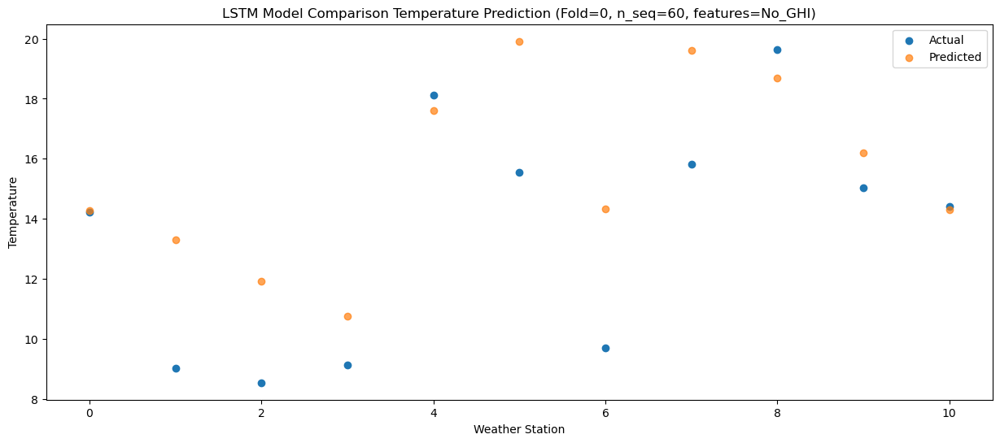

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   17.43  18.579977
1                 1   12.73  17.611930
2                 2   12.33  16.222776
3                 3   11.58  15.059084
4                 4   22.45  21.920367
5                 5   19.12  24.231705
6                 6   13.62  18.631515
7                 7   19.81  23.926235
8                 8   24.15  22.983748
9                 9   18.93  20.507650
10               10   19.17  18.596721


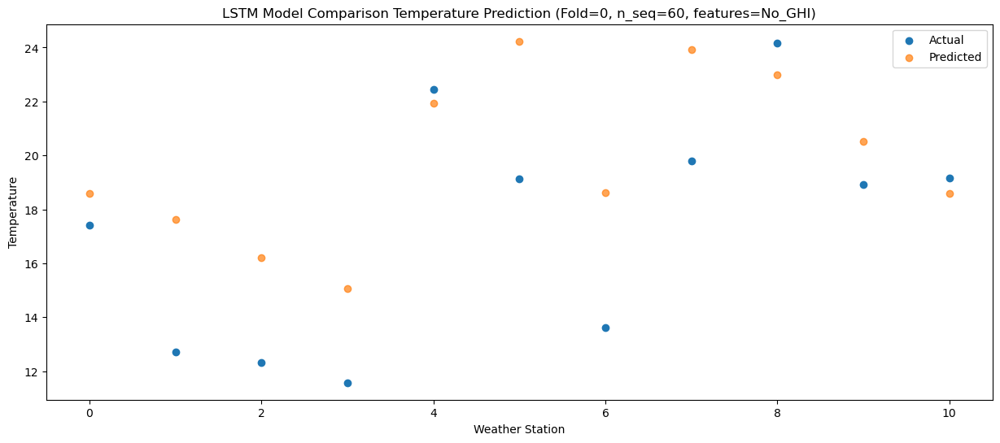

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   19.65  20.822484
1                 1   12.87  19.856222
2                 2   13.25  18.476108
3                 3   11.56  17.311360
4                 4   24.81  24.170799
5                 5   21.26  26.483395
6                 6   14.72  20.885305
7                 7   21.68  26.185758
8                 8   26.48  25.241424
9                 9   20.96  22.763727
10               10   20.28  20.853045


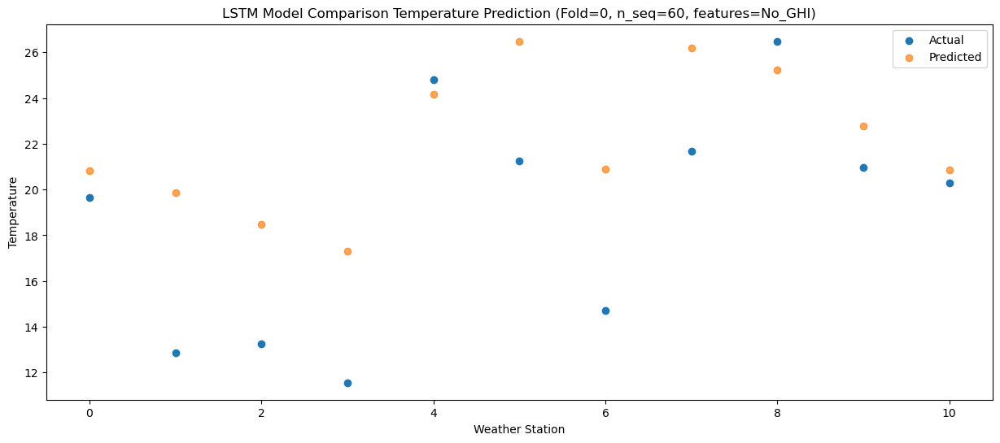

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.47  19.195871
1                 1   12.32  18.230723
2                 2   12.02  16.853682
3                 3   10.37  15.695592
4                 4   22.45  22.547726
5                 5   20.41  24.868418
6                 6   13.43  19.269616
7                 7   20.00  24.573247
8                 8   23.60  23.625407
9                 9   19.05  21.148231
10               10   19.16  19.238072


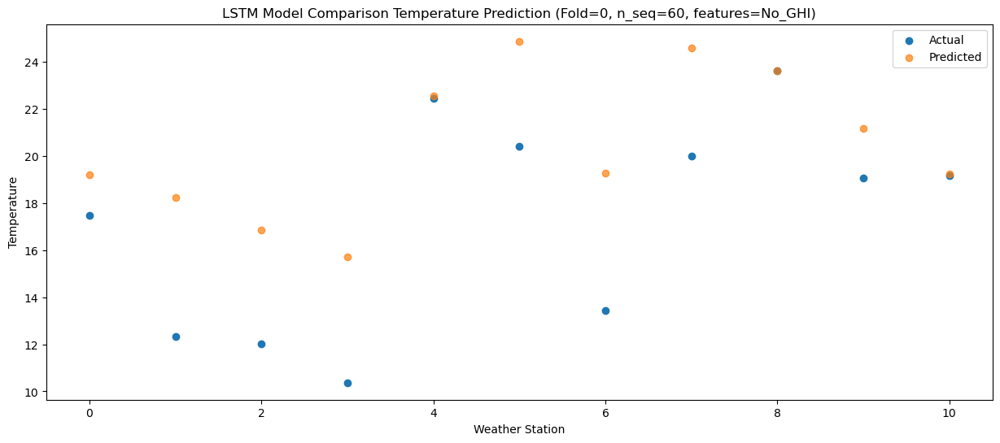

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   14.50  15.600317
1                 1   11.30  14.635829
2                 2    8.90  13.259180
3                 3    9.13  12.101371
4                 4   19.50  18.950925
5                 5   17.76  21.274846
6                 6   10.37  15.677444
7                 7   16.30  20.983767
8                 8   19.96  20.040246
9                 9   15.32  17.563576
10               10   15.32  15.657229


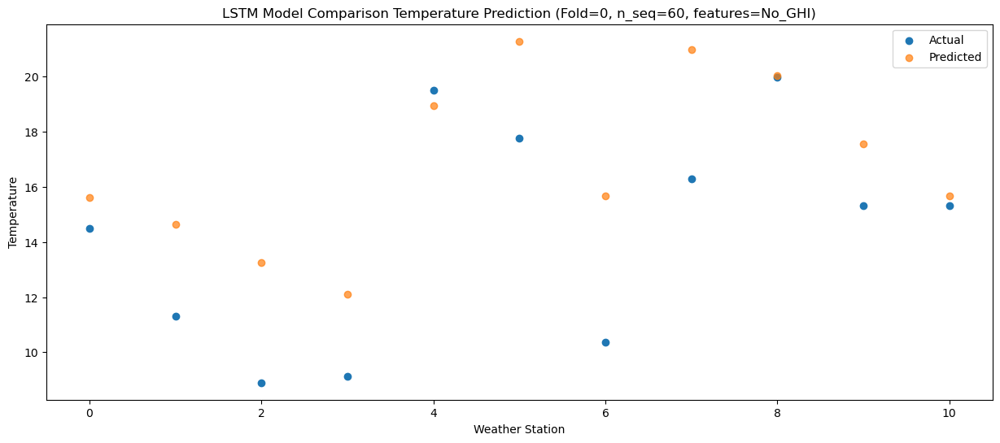

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    8.82   8.501658
1                 1    5.70   7.544379
2                 2    1.76   6.164991
3                 3    3.51   5.009430
4                 4   13.58  11.850493
5                 5   11.20  14.174069
6                 6    3.43   8.580386
7                 7    9.11  13.884602
8                 8   13.40  12.940889
9                 9    8.28  10.460249
10               10    8.08   8.553972


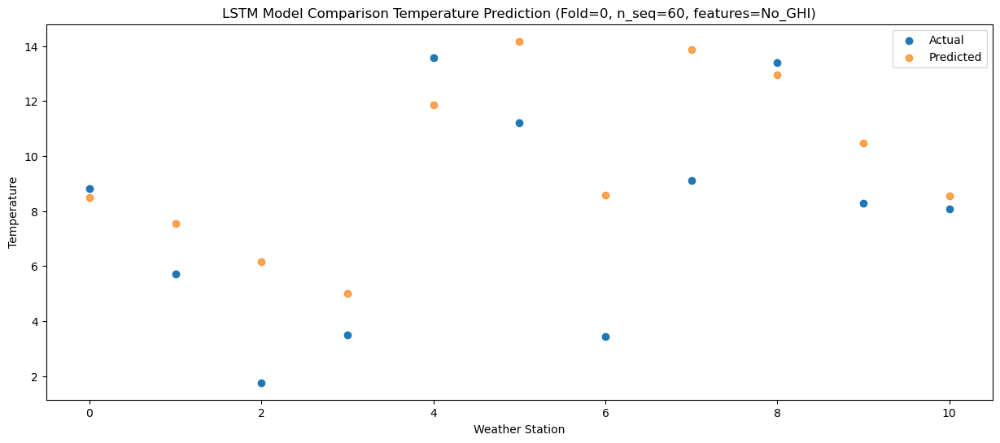

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.87   2.792235
1                 1    3.01   1.837161
2                 2   -0.72   0.458796
3                 3   -0.60  -0.695789
4                 4    6.65   6.141314
5                 5    9.51   8.469639
6                 6    1.20   2.878333
7                 7    6.91   8.179470
8                 8    7.43   7.234464
9                 9    3.26   4.750360
10               10    3.05   2.843685


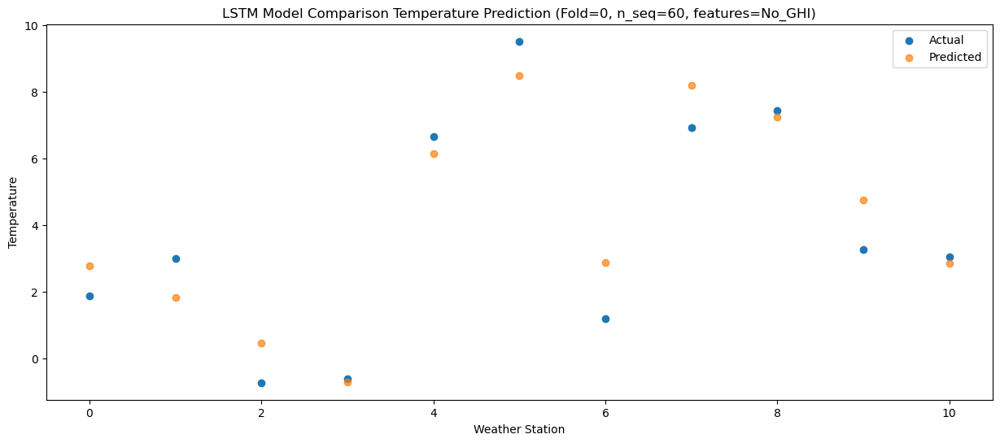

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -0.22  -2.132137
1                 1   -0.84  -3.083853
2                 2   -5.24  -4.465719
3                 3   -2.78  -5.619080
4                 4    3.92   1.216060
5                 5    2.99   3.545627
6                 6   -5.31  -2.043136
7                 7   -0.26   3.255722
8                 8    2.14   2.305697
9                 9   -2.45  -0.179571
10               10   -3.13  -2.084603


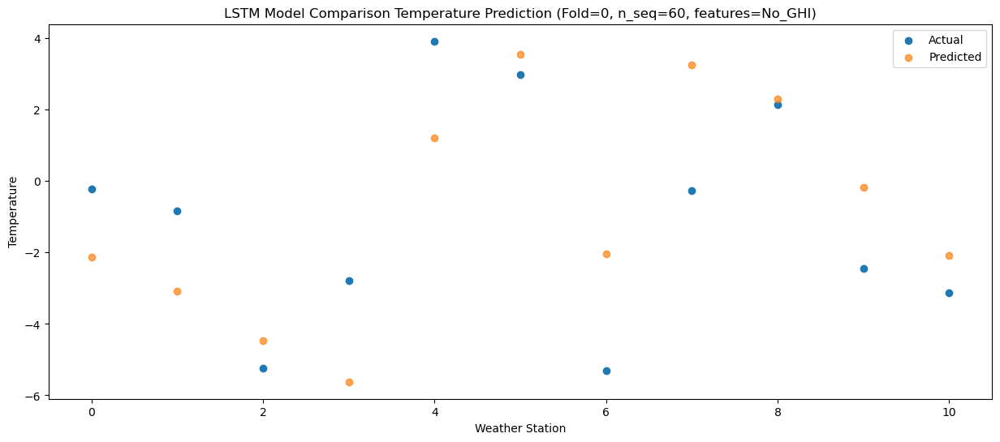

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.42  -1.014219
1                 1   -0.05  -1.959409
2                 2   -3.29  -3.339799
3                 3   -1.34  -4.492072
4                 4    4.89   2.344455
5                 5    4.68   4.688790
6                 6   -2.12  -0.900687
7                 7    2.91   4.400088
8                 8    4.70   3.437122
9                 9   -0.56   0.948766
10               10   -2.00  -0.959194


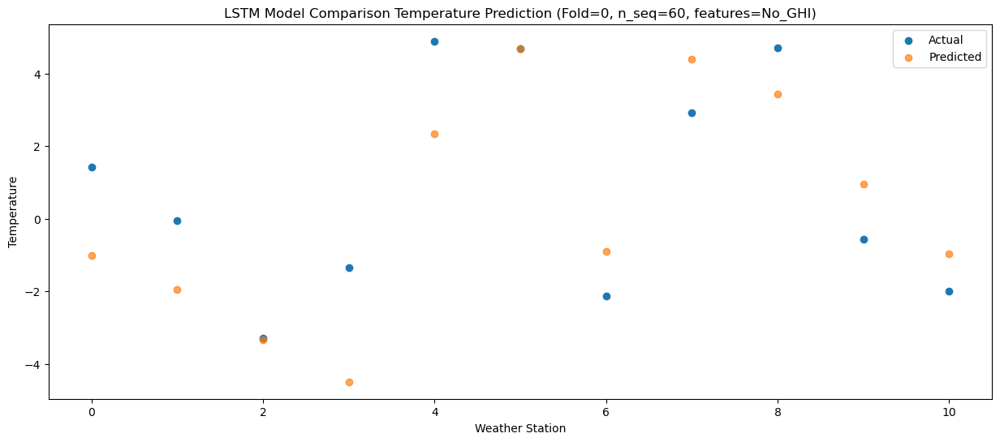

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.95  -0.212259
1                 1    1.05  -1.152552
2                 2   -0.51  -2.528357
3                 3   -0.93  -3.671266
4                 4    5.02   3.158488
5                 5    6.17   5.503872
6                 6    0.88  -0.082952
7                 7    5.88   5.214163
8                 8    6.31   4.249113
9                 9    1.48   1.753087
10               10   -1.59  -0.159050


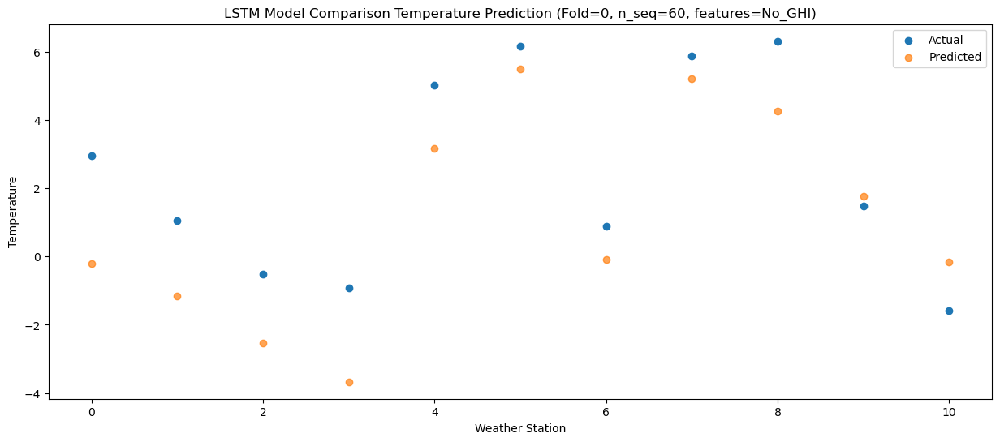

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    5.32   2.787473
1                 1    2.64   1.842350
2                 2   -0.53   0.461428
3                 3    2.59  -0.682714
4                 4    9.74   6.151553
5                 5    7.08   8.491153
6                 6    1.36   2.900978
7                 7    6.56   8.197820
8                 8    8.13   7.234132
9                 9    1.82   4.739993
10               10    0.27   2.830439


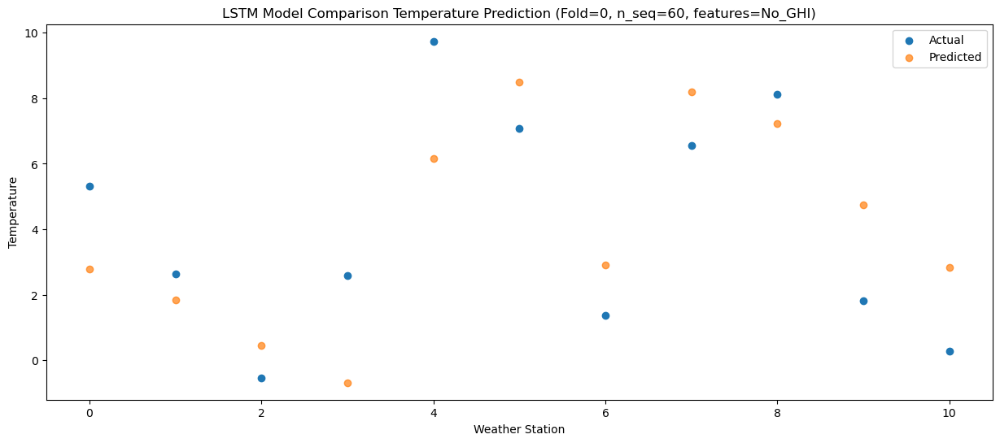

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.94   8.257124
1                 1    4.79   7.316553
2                 2    2.54   5.944461
3                 3    4.01   4.792650
4                 4   11.24  11.622684
5                 5   11.76  13.976097
6                 6    4.92   8.392341
7                 7   11.18  13.694817
8                 8   13.91  12.727236
9                 9    8.10  10.240651
10               10    7.12   8.333402


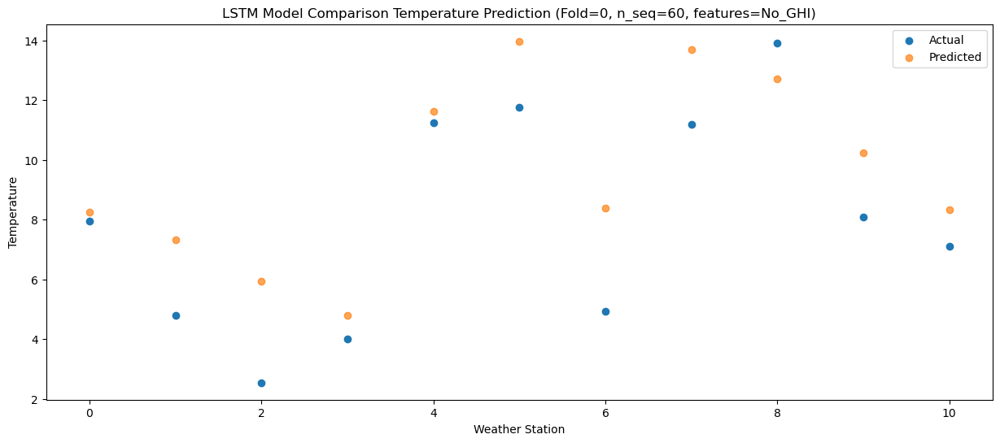

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.41  13.841722
1                 1    7.97  12.901281
2                 2    5.95  11.527458
3                 3    8.44  10.379983
4                 4   16.77  17.206489
5                 5   13.28  19.561017
6                 6    7.61  13.974616
7                 7   13.47  19.276440
8                 8   19.50  18.309314
9                 9   13.06  15.828385
10               10   12.14  13.929694


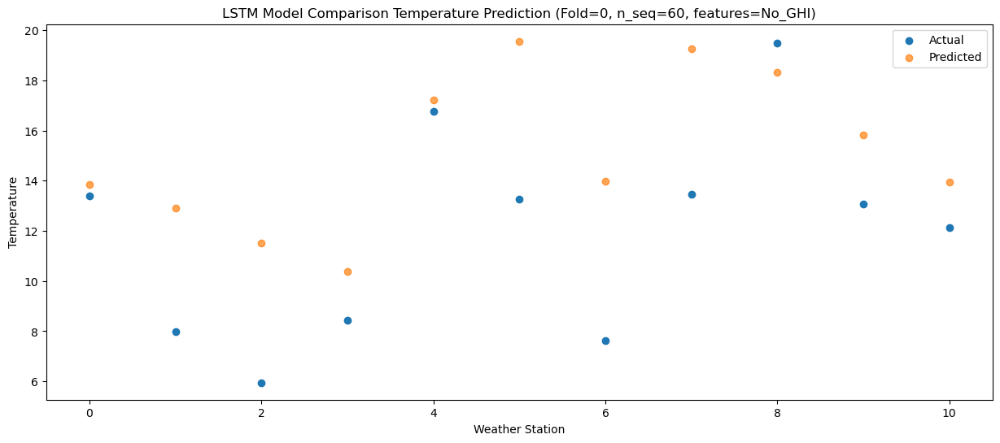

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   17.19  18.179257
1                 1   11.05  17.236899
2                 2    9.27  15.864893
3                 3   12.19  14.719074
4                 4   21.32  21.548330
5                 5   17.10  23.905761
6                 6   10.96  18.320632
7                 7   17.22  23.621039
8                 8   23.37  22.650366
9                 9   16.90  20.167423
10               10   17.65  18.266871


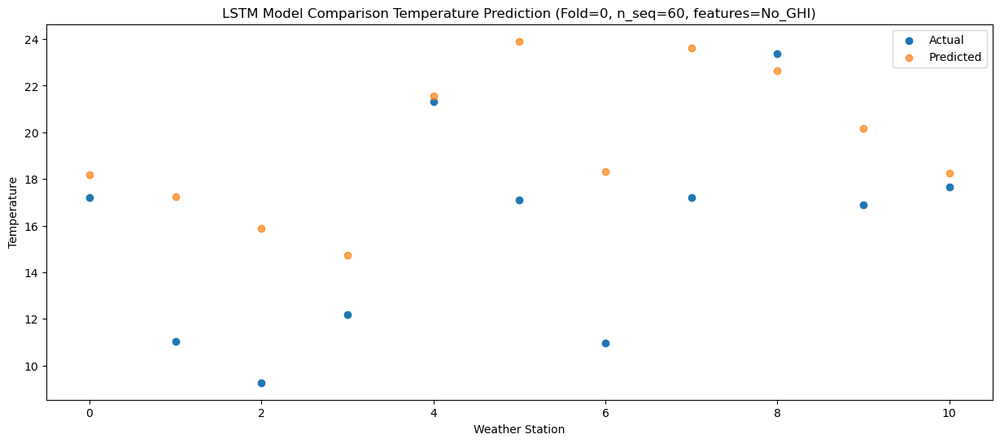

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.73  20.560292
1                 1   12.88  19.617828
2                 2   12.37  18.248404
3                 3   13.31  17.099758
4                 4   24.31  23.926090
5                 5   20.93  26.282473
6                 6   14.67  20.700305
7                 7   21.36  26.002314
8                 8   24.86  25.029599
9                 9   19.73  22.549049
10               10   20.11  20.647311


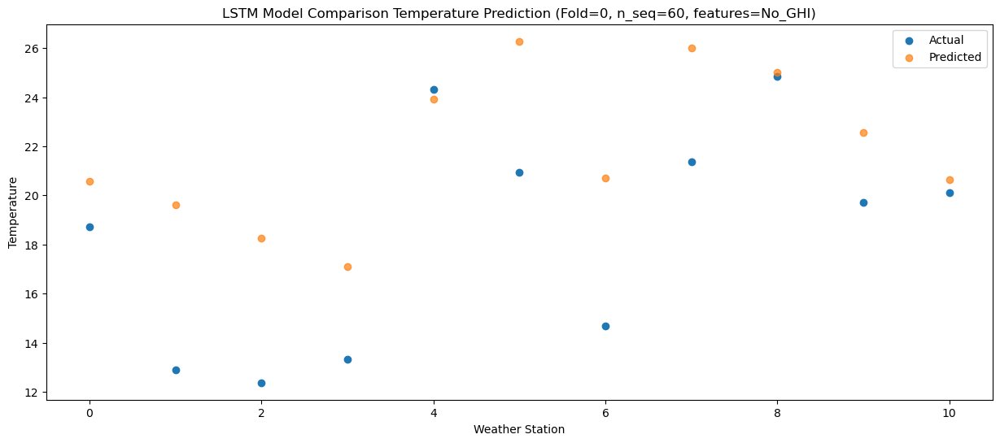

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   19.45  20.948238
1                 1   14.47  20.003515
2                 2   11.98  18.632115
3                 3   14.84  17.480800
4                 4   26.05  24.305494
5                 5   20.45  26.671842
6                 6   13.98  21.086280
7                 7   20.22  26.385887
8                 8   23.60  25.410126
9                 9   18.93  22.929552
10               10   18.30  21.031283


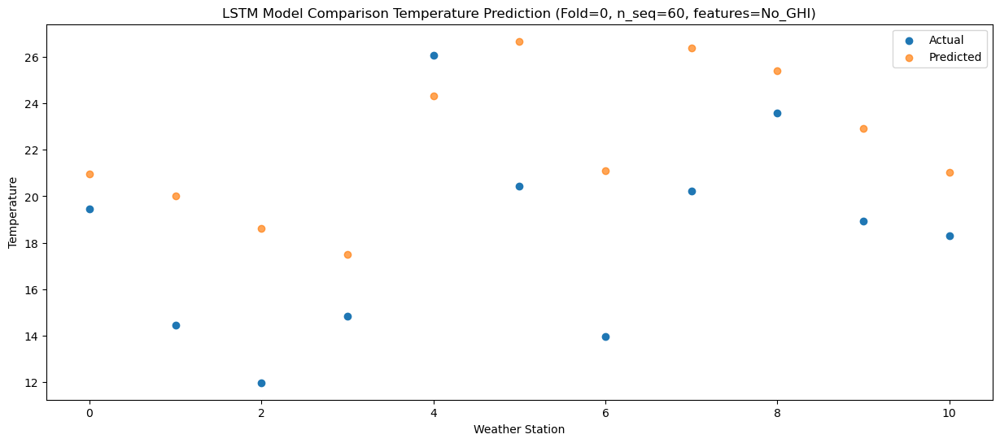

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   15.22  17.359138
1                 1   11.09  16.411834
2                 2    8.53  15.036432
3                 3   11.40  13.884550
4                 4   21.57  20.711969
5                 5   16.93  23.081320
6                 6   10.47  17.494251
7                 7   16.46  22.796429
8                 8   20.43  21.822580
9                 9   16.32  19.343672
10               10   15.92  17.451713


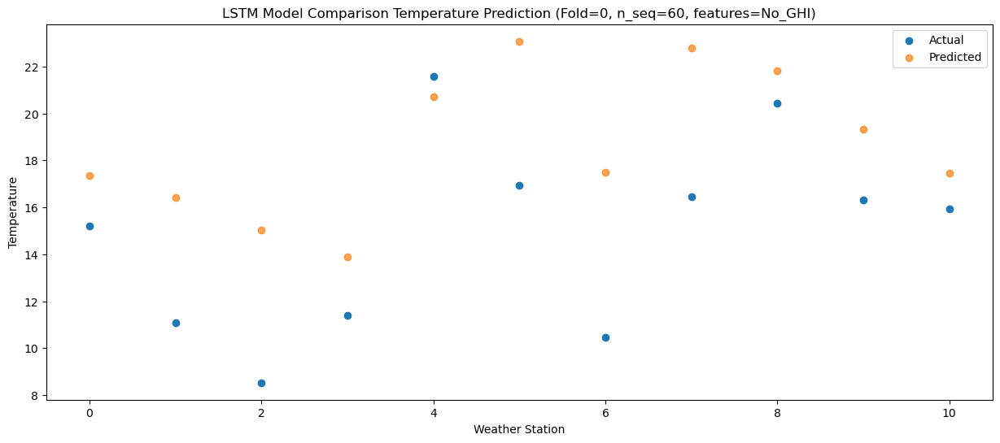

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   10.16  10.480403
1                 1    5.98   9.535888
2                 2    2.55   8.159369
3                 3    5.15   7.009351
4                 4   13.91  13.833435
5                 5   12.58  16.213159
6                 6    5.26  10.621563
7                 7   11.07  15.923167
8                 8   14.83  14.948733
9                 9    9.74  12.467274
10               10    9.96  10.581605


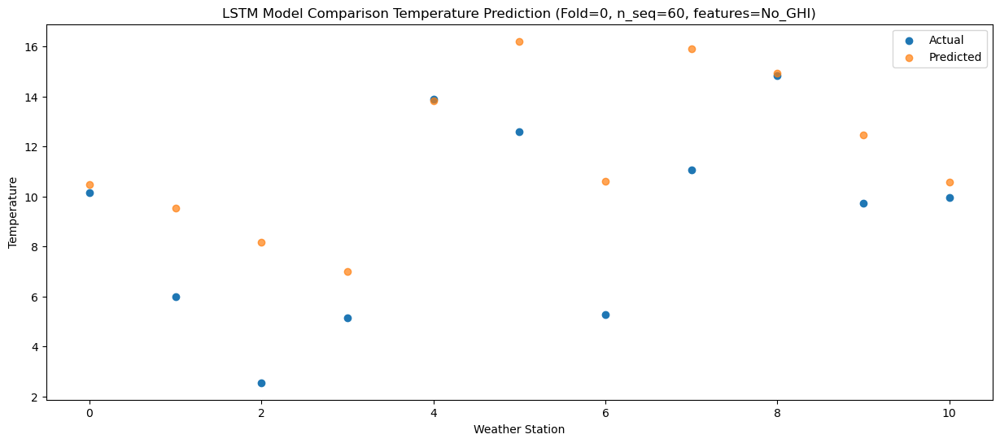

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.30   3.712785
1                 1    0.74   2.766870
2                 2   -2.54   1.390331
3                 3   -0.71   0.237112
4                 4    7.55   7.059843
5                 5    7.14   9.440817
6                 6   -0.61   3.848898
7                 7    4.62   9.152146
8                 8    7.84   8.174105
9                 9    3.24   5.694442
10               10    2.32   3.807191


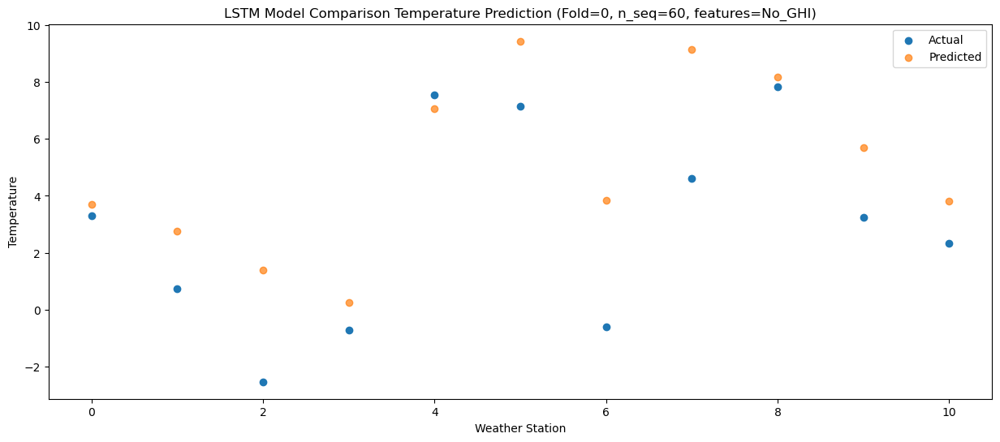

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.70   1.328396
1                 1   -1.96   0.381363
2                 2   -5.57  -0.998386
3                 3   -3.50  -2.154478
4                 4    4.76   4.664960
5                 5    5.00   7.044139
6                 6   -2.90   1.451809
7                 7    3.03   6.755808
8                 8    5.28   5.776607
9                 9    0.81   3.299215
10               10    1.64   1.419178


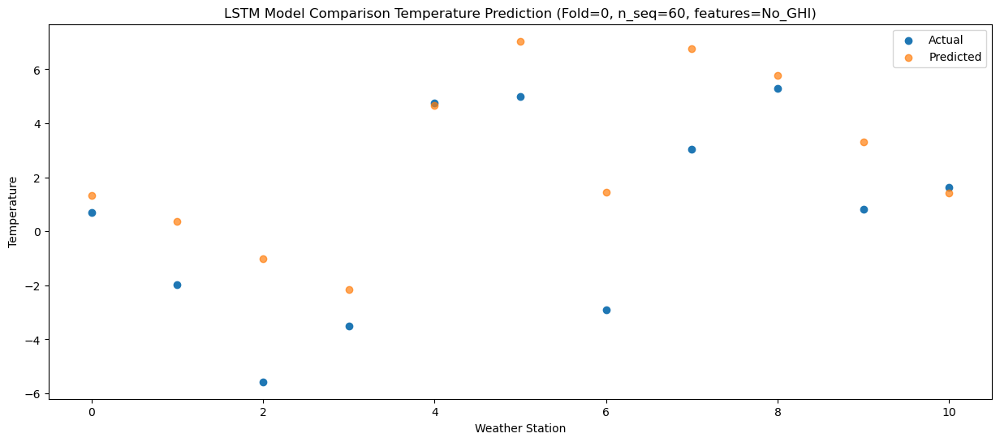

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.42  -3.451973
1                 1   -4.23  -4.395051
2                 2   -8.08  -5.776524
3                 3   -6.38  -6.929619
4                 4   -0.22  -0.112700
5                 5    3.73   2.265975
6                 6   -5.03  -3.326622
7                 7    0.33   1.974549
8                 8   -0.98   0.993052
9                 9   -4.95  -1.492160
10               10   -5.28  -3.379110


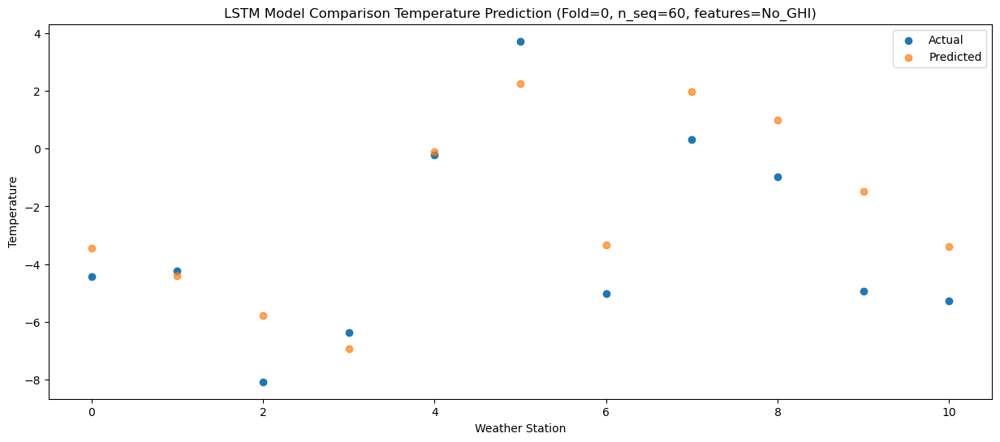

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    3.46   2.388525
1                 1   -1.73   1.443106
2                 2   -3.57   0.058039
3                 3   -1.73  -1.098148
4                 4    7.65   5.721292
5                 5    4.25   8.097642
6                 6   -1.47   2.500026
7                 7    3.47   7.798769
8                 8    7.64   6.819245
9                 9    1.19   4.332601
10               10   -0.27   2.451163


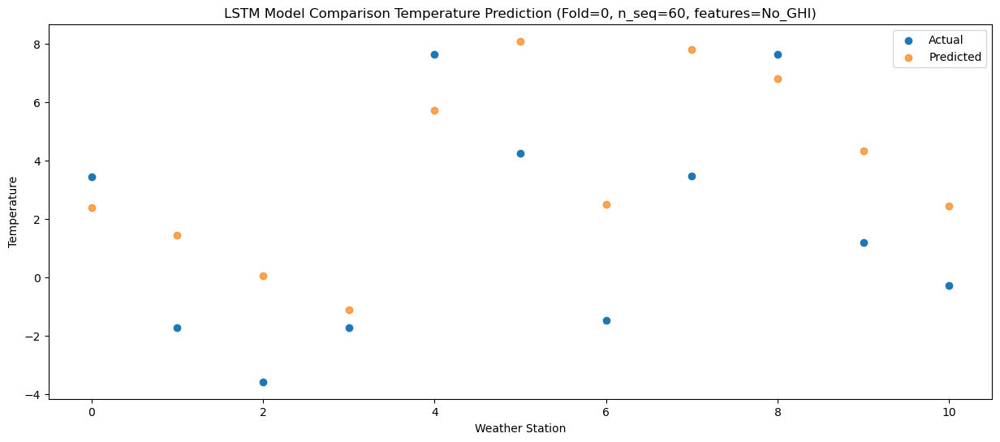

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    5.21   5.366610
1                 1    1.57   4.414898
2                 2    0.81   3.030721
3                 3    1.21   1.870689
4                 4   10.20   8.691004
5                 5    8.30  11.078416
6                 6    2.37   5.474906
7                 7    7.62  10.772678
8                 8   10.92   9.790906
9                 9    4.51   7.303848
10               10    3.23   5.425479


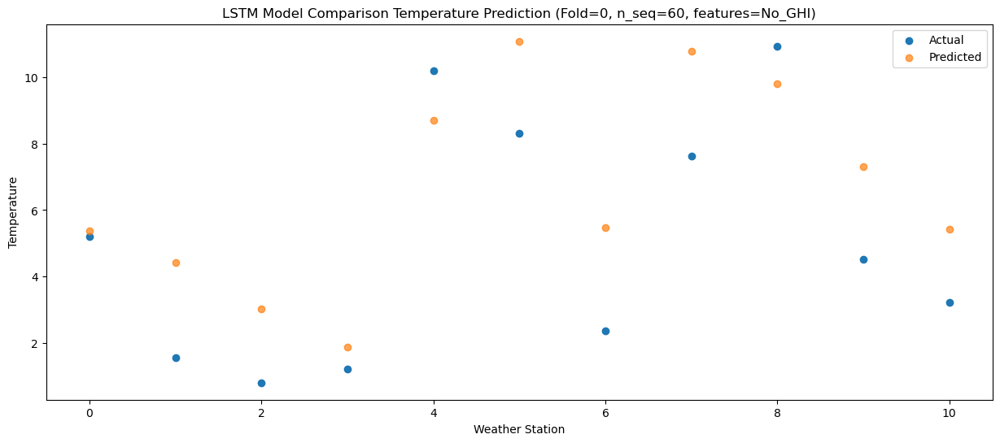

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.98  10.159188
1                 1    4.45   9.207798
2                 2    4.50   7.824178
3                 3    4.78   6.664852
4                 4   13.47  13.482194
5                 5   11.52  15.874263
6                 6    5.96  10.273727
7                 7   12.10  15.572738
8                 8   15.80  14.587202
9                 9    9.73  12.101525
10               10    8.57  10.228664


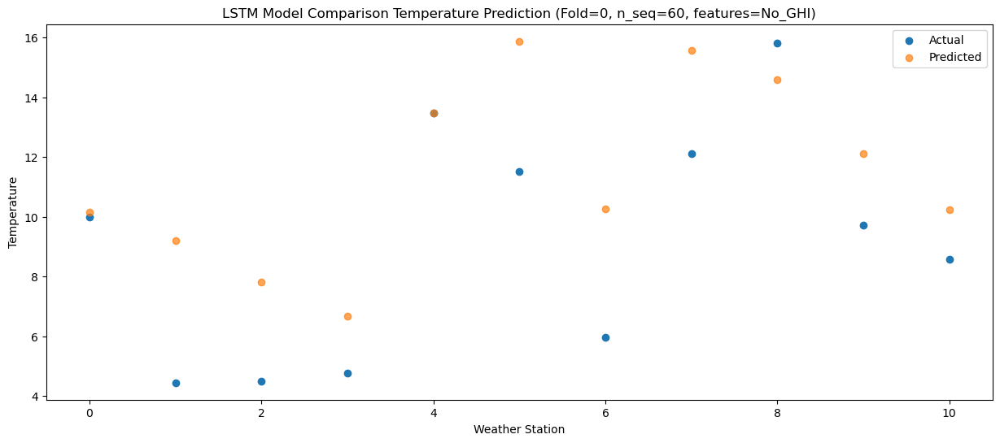

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.89  15.510972
1                 1    8.94  14.561700
2                 2    8.98  13.176799
3                 3    9.17  12.016760
4                 4   18.05  18.832812
5                 5   16.33  21.223619
6                 6    9.96  15.622534
7                 7   16.06  20.924264
8                 8   20.87  19.936405
9                 9   15.53  17.451400
10               10   15.54  15.576357


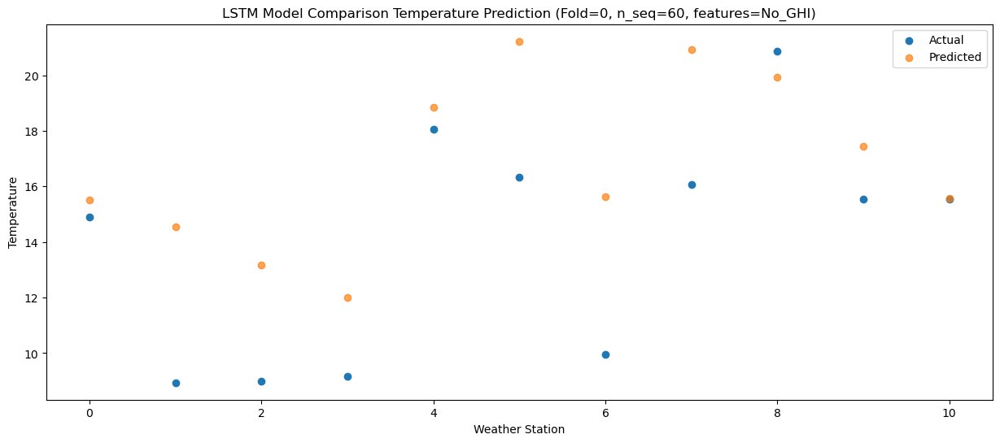

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.50  19.417406
1                 1   11.87  18.469028
2                 2   13.22  17.082812
3                 3   11.29  15.920180
4                 4   21.55  22.733378
5                 5   19.76  25.122684
6                 6   13.87  19.523818
7                 7   20.08  24.825219
8                 8   23.80  23.837479
9                 9   19.29  21.353676
10               10   19.86  19.479041


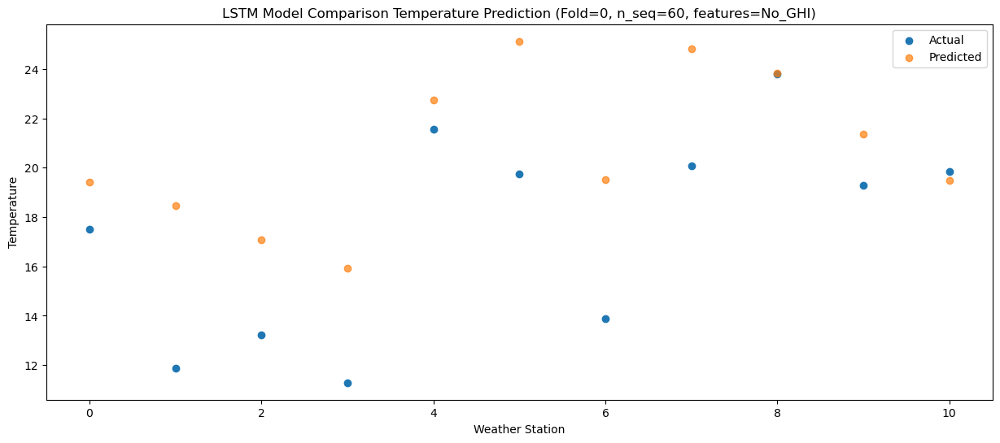

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.38  20.428353
1                 1   13.00  19.480104
2                 2   13.49  18.098402
3                 3   11.23  16.939623
4                 4   21.41  23.752906
5                 5   21.42  26.143611
6                 6   15.13  20.544990
7                 7   21.30  25.846981
8                 8   24.35  24.860509
9                 9   20.13  22.376485
10               10   20.75  20.502340


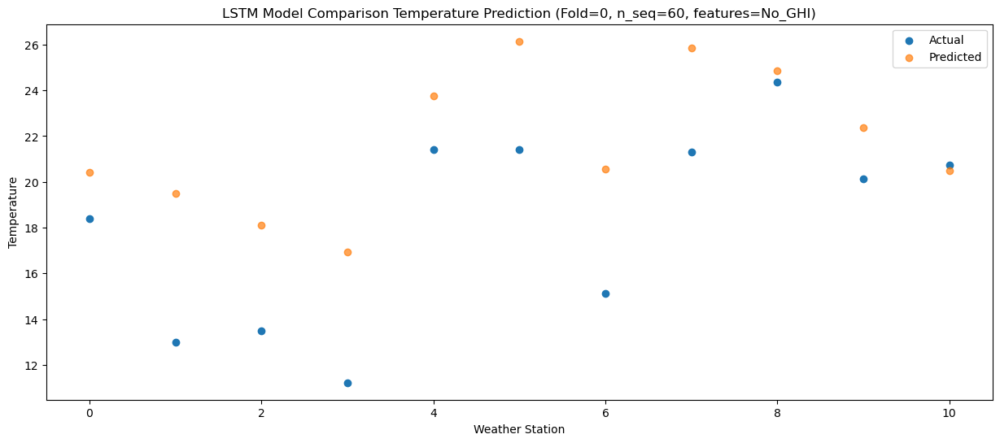

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.72  20.366305
1                 1   13.39  19.415115
2                 2   11.81  18.027236
3                 3   12.04  16.870433
4                 4   23.09  23.684043
5                 5   20.15  26.064759
6                 6   13.38  20.466309
7                 7   19.46  25.769204
8                 8   24.29  24.791031
9                 9   19.80  22.311169
10               10   20.00  20.441921


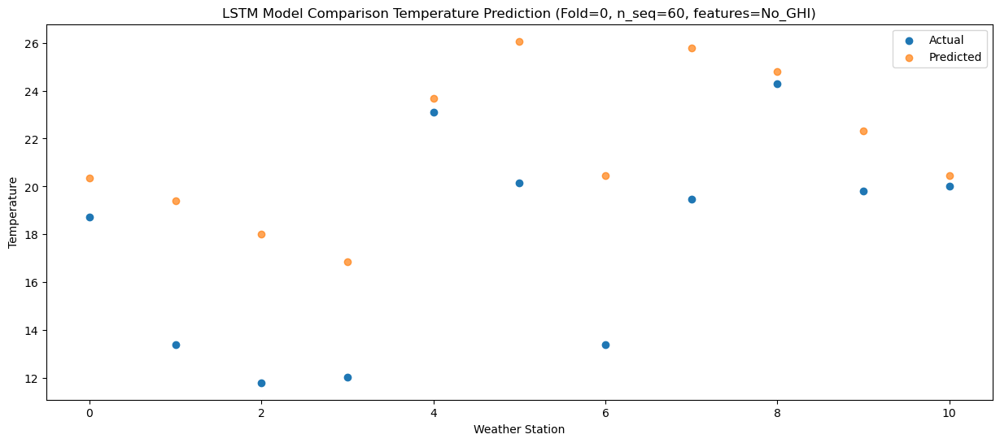

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.58  16.941069
1                 1   10.15  15.985659
2                 2    9.04  14.604516
3                 3    9.45  13.448046
4                 4   19.17  20.263773
5                 5   18.21  22.641306
6                 6   10.95  17.043945
7                 7   16.53  22.345749
8                 8   20.67  21.367320
9                 9   17.61  18.891477
10               10   17.22  17.023449


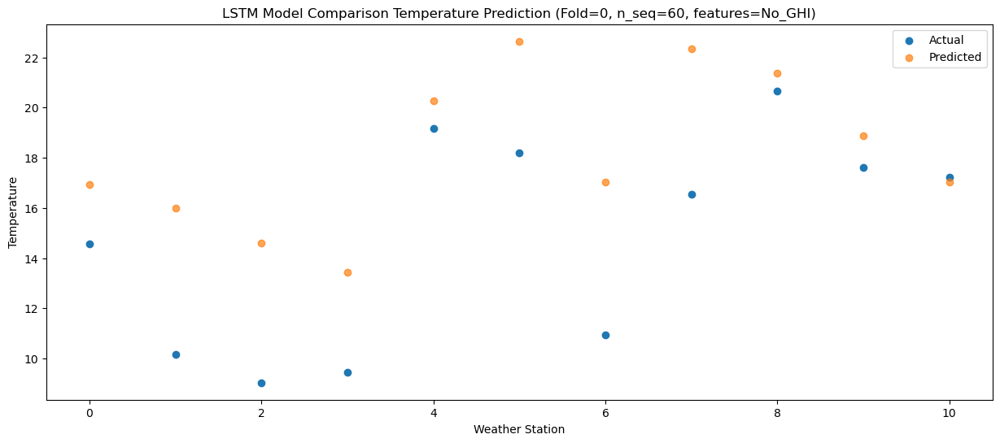

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   11.31  12.219503
1                 1    6.83  11.266134
2                 2    3.14   9.880532
3                 3    5.31   8.727488
4                 4   16.72  15.541423
5                 5   13.18  17.919538
6                 6    5.68  12.320254
7                 7   10.70  17.619035
8                 8   15.24  16.636195
9                 9   10.87  14.153428
10               10   10.99  12.282486


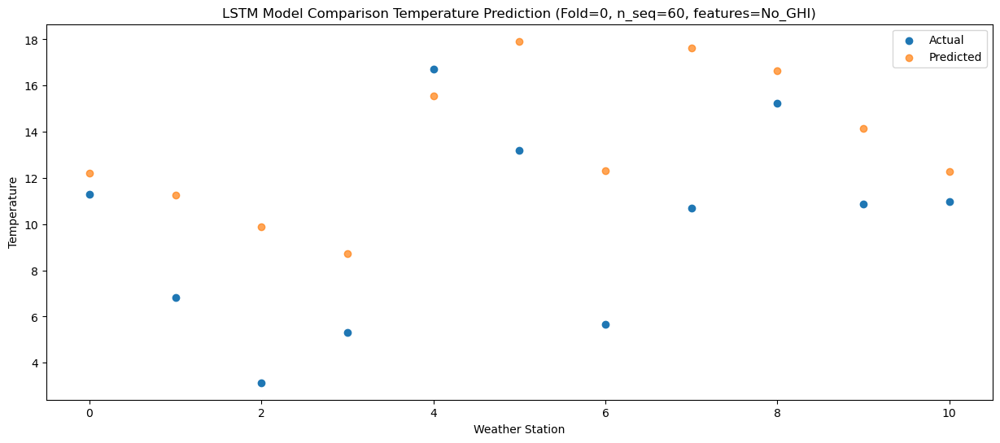

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_10 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_11 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_11 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_15 (Dense)            (1, 256)                  262400    
                                                                 
 dense_16 (Dense)            (1, 128)                  32896     
                                                                 
 dense_17 (Dense)            (1, 60)                  

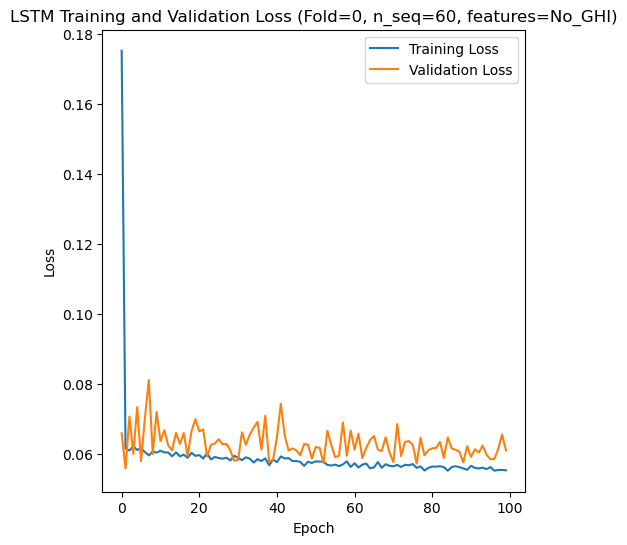

Epoch 1/100
84/84 [==============================] - 8s 50ms/step - loss: 0.1731 - accuracy: 0.3214 - mae: 0.1415 - rmse: 0.1731 - mape: inf - pearson: 0.6164 - val_loss: 0.0555 - val_accuracy: 0.6000 - val_mae: 0.0444 - val_rmse: 0.0555 - val_mape: 9.7692 - val_pearson: 0.8678
Epoch 2/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0613 - accuracy: 0.5476 - mae: 0.0480 - rmse: 0.0613 - mape: inf - pearson: 0.8344 - val_loss: 0.0612 - val_accuracy: 0.6000 - val_mae: 0.0485 - val_rmse: 0.0612 - val_mape: 10.7313 - val_pearson: 0.8440
Epoch 3/100
84/84 [==============================] - 4s 45ms/step - loss: 0.0600 - accuracy: 0.5238 - mae: 0.0472 - rmse: 0.0600 - mape: inf - pearson: 0.8318 - val_loss: 0.0568 - val_accuracy: 0.6000 - val_mae: 0.0452 - val_rmse: 0.0568 - val_mape: 10.1091 - val_pearson: 0.8577
Epoch 4/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0606 - accuracy: 0.5595 - mae: 0.0477 - rmse: 0.0606 - mape: inf - pearson: 0.8319 - 

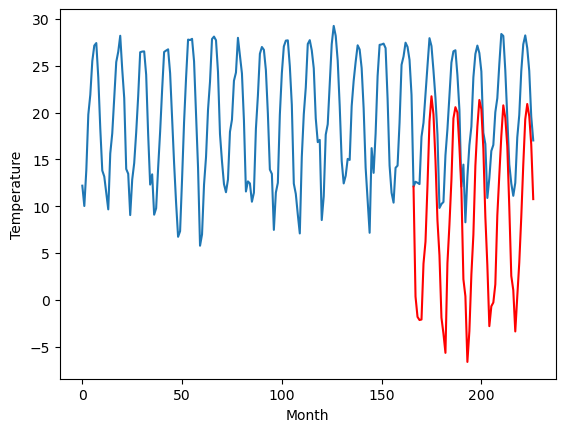

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.99		-1.07		-0.08
-1.90		-3.24		-1.34
-3.01		-3.58		-0.57
-2.92		-3.52		-0.60
3.08		2.45		-0.63
4.30		4.79		0.49
7.65		10.78		3.13
12.00		17.63		5.63
15.37		20.32		4.95
13.96		18.40		4.44
10.42		13.49		3.07
6.70		7.04		0.34
2.60		3.34		0.74
-4.29		-3.32		0.97
-4.49		-5.01		-0.52
-3.83		-7.07		-3.24
2.94		2.52		-0.42
5.08		6.61		1.53
8.81		11.41		2.60
12.95		17.96		5.01
14.33		19.16		4.83
14.60		18.59		3.99
10.86		14.91		4.05
7.08		10.34		3.26
-0.58		0.79		1.37
1.05		-1.02		-2.07
-5.68		-8.04		-2.36
-1.45		-4.74		-3.29
2.12		1.30		-0.82
5.12		5.54		0.42
11.00		12.90		1.90
14.97		17.10		2.13
15.47		19.95		4.48
14.01		18.96		4.95
10.92		14.75		3.83
4.58		7.46		2.88
1.58		2.31		0.73
-4.23		-4.21		0.02
-2.04		-2.08		-0.04
1.33		-1.68		-3.01
2.10		0.27		-1.83
5.37		7.63		2.26
8.65		11.93		3.28
11.84		16.08		4.24
15.44		19.38		3.94
14.90		18.06		3.16
11.39		15.02		3.63
6.38		8.50		2.12
0.76		1.17	

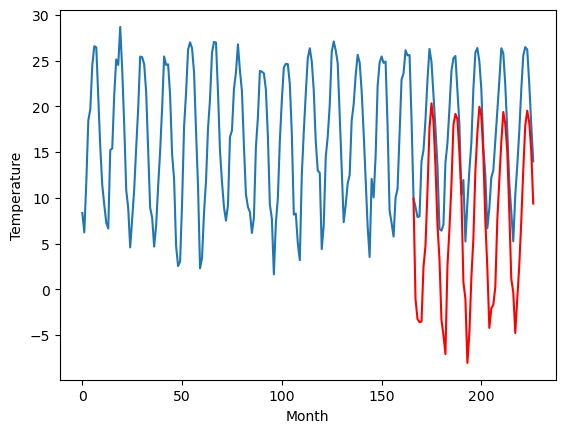

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.90		0.17		1.07
-0.47		-2.00		-1.53
-1.00		-2.34		-1.34
-0.72		-2.28		-1.56
6.38		3.68		-2.70
5.41		6.03		0.62
9.56		12.02		2.46
13.79		18.87		5.08
15.26		21.56		6.30
15.25		19.64		4.39
12.45		14.73		2.28
8.10		8.28		0.18
3.30		4.57		1.27
-3.76		-2.09		1.67
-3.34		-3.78		-0.44
-2.85		-5.84		-2.99
4.21		3.76		-0.45
5.61		7.84		2.23
9.73		12.64		2.91
13.61		19.19		5.58
14.38		20.40		6.02
15.04		19.82		4.78
12.02		16.14		4.12
8.24		11.56		3.32
0.50		2.02		1.52
3.10		0.21		-2.89
-3.79		-6.81		-3.02
-0.44		-3.51		-3.07
3.56		2.53		-1.03
7.15		6.76		-0.39
12.51		14.13		1.62
15.48		18.33		2.85
16.19		21.18		4.99
14.58		20.19		5.61
12.19		15.98		3.79
5.50		8.69		3.19
2.18		3.55		1.37
-0.98		-2.98		-2.00
0.02		-0.85		-0.87
2.61		-0.44		-3.05
4.04		1.50		-2.54
6.73		8.86		2.13
9.97		13.16		3.19
13.72		17.31		3.59
16.09		20.61		4.52
16.53		19.29		2.76
13.57		16.24		2.67
7.53		9.72		2.19
0.97		2.40		1.

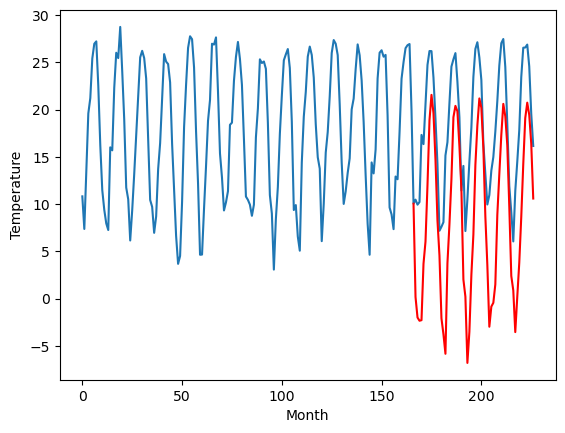

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.19		-0.79		-1.98
-0.23		-2.97		-2.74
0.52		-3.32		-3.84
-0.01		-3.25		-3.24
7.63		2.70		-4.93
7.51		5.06		-2.45
11.26		11.03		-0.23
14.04		17.88		3.84
15.69		20.57		4.88
15.93		18.64		2.71
12.52		13.74		1.22
7.98		7.29		-0.69
5.08		3.59		-1.49
-1.10		-3.07		-1.97
-1.20		-4.76		-3.56
-2.79		-6.83		-4.04
4.58		2.78		-1.80
6.92		6.87		-0.05
10.81		11.66		0.85
14.70		18.21		3.51
14.58		19.41		4.83
15.55		18.84		3.29
12.54		15.17		2.63
9.85		10.58		0.73
2.69		1.04		-1.65
6.06		-0.76		-6.82
-1.99		-7.78		-5.79
-2.46		-4.49		-2.03
3.38		1.54		-1.84
9.38		5.78		-3.60
13.81		13.15		-0.66
16.81		17.36		0.55
17.75		20.21		2.46
16.11		19.21		3.10
13.34		15.01		1.67
7.78		7.71		-0.07
2.73		2.57		-0.16
0.64		-3.96		-4.60
1.35		-1.84		-3.19
2.35		-1.42		-3.77
6.18		0.53		-5.65
7.02		7.89		0.87
11.61		12.20		0.59
15.76		16.35		0.59
17.48		19.64		2.16
19.45		18.32		-1.13
16.37		15.27		-1.10
9.11		8.75		-0.3

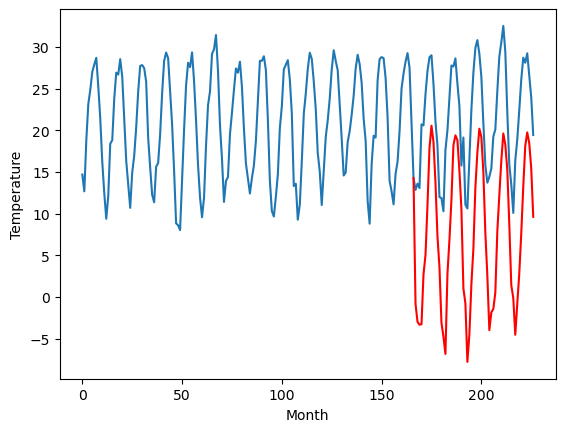

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.60		3.45		-2.15
3.71		1.26		-2.45
4.52		0.92		-3.60
4.14		0.98		-3.16
12.18		6.93		-5.25
11.92		9.29		-2.63
15.72		15.26		-0.46
18.75		22.10		3.35
20.79		24.78		3.99
21.03		22.86		1.83
17.45		17.95		0.50
12.51		11.51		-1.00
9.41		7.81		-1.60
3.05		1.15		-1.90
3.04		-0.54		-3.58
1.34		-2.61		-3.95
8.95		7.00		-1.95
11.25		11.10		-0.15
15.37		15.88		0.51
18.84		22.43		3.59
18.93		23.63		4.70
19.90		23.05		3.15
16.32		19.38		3.06
13.28		14.80		1.52
5.73		5.26		-0.47
9.61		3.45		-6.16
1.13		-3.57		-4.70
0.82		-0.28		-1.10
6.60		5.75		-0.85
12.87		9.99		-2.88
17.49		17.36		-0.13
20.86		21.56		0.70
21.95		24.41		2.46
19.94		23.42		3.48
16.76		19.21		2.45
11.37		11.91		0.54
6.37		6.76		0.39
4.35		0.24		-4.11
4.83		2.35		-2.48
6.01		2.77		-3.24
9.83		4.73		-5.10
10.79		12.08		1.29
15.43		16.39		0.96
20.32		20.55		0.23
22.27		23.84		1.57
23.70		22.52		-1.18
19.85		19.47		-0.38
12.45		12.94		0.49
6.2

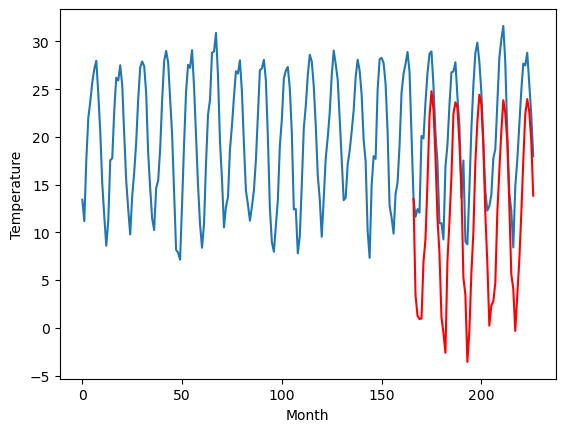

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.73		-0.40		-3.13
0.70		-2.59		-3.29
0.04		-2.93		-2.97
-0.48		-2.87		-2.39
6.87		3.08		-3.79
9.66		5.43		-4.23
14.85		11.40		-3.45
17.57		18.24		0.67
20.27		20.92		0.65
20.12		18.99		-1.13
12.59		14.08		1.49
9.75		7.64		-2.11
6.03		3.94		-2.09
-0.72		-2.73		-2.01
-2.23		-4.41		-2.18
-1.85		-6.49		-4.64
5.49		3.12		-2.37
7.76		7.22		-0.54
13.35		11.99		-1.36
17.62		18.54		0.92
16.96		19.74		2.78
16.37		19.17		2.80
16.01		15.49		-0.52
11.69		10.91		-0.78
5.22		1.37		-3.85
5.48		-0.44		-5.92
-1.84		-7.47		-5.63
-1.95		-4.18		-2.23
5.00		1.85		-3.15
11.91		6.08		-5.83
17.31		13.45		-3.86
19.37		17.66		-1.71
20.29		20.51		0.22
17.44		19.51		2.07
14.39		15.30		0.91
8.31		8.00		-0.31
1.35		2.85		1.50
0.23		-3.68		-3.91
0.69		-1.57		-2.26
0.83		-1.15		-1.98
5.89		0.81		-5.08
9.05		8.16		-0.89
13.66		12.47		-1.19
20.35		16.63		-3.72
21.45		19.92		-1.53
20.64		18.59		-2.05
18.36		15.54		-2.82
10.76		

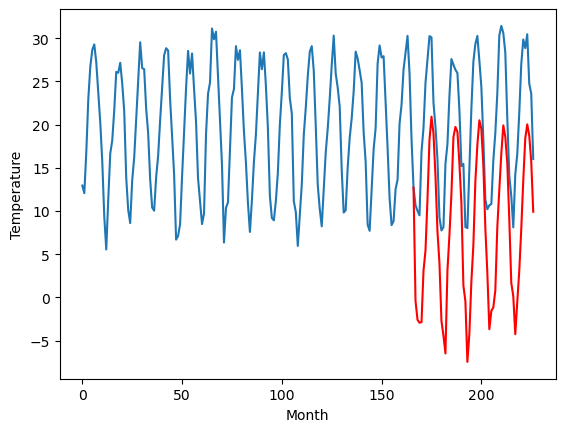

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.75		2.06		0.31
1.02		-0.12		-1.14
0.21		-0.46		-0.67
0.28		-0.40		-0.68
5.95		5.56		-0.39
7.58		7.91		0.33
10.36		13.88		3.52
15.03		20.72		5.69
18.21		23.41		5.20
16.58		21.48		4.90
13.16		16.58		3.42
9.67		10.14		0.47
5.52		6.44		0.92
-1.69		-0.23		1.46
-1.89		-1.92		-0.03
-1.11		-3.99		-2.88
5.17		5.61		0.44
7.74		9.71		1.97
11.51		14.49		2.98
15.52		21.05		5.53
16.88		22.25		5.37
17.14		21.67		4.53
13.81		17.99		4.18
9.86		13.41		3.55
2.26		3.87		1.61
3.78		2.06		-1.72
-2.61		-4.95		-2.34
1.20		-1.67		-2.87
5.04		4.37		-0.67
7.80		8.60		0.80
13.72		15.97		2.25
17.30		20.17		2.87
18.04		23.02		4.98
16.54		22.02		5.48
13.65		17.81		4.16
7.31		10.52		3.21
4.42		5.37		0.95
-1.59		-1.15		0.44
0.54		0.96		0.42
4.13		1.38		-2.75
4.80		3.34		-1.46
8.06		10.69		2.63
11.06		15.00		3.94
14.34		19.14		4.80
17.79		22.44		4.65
17.37		21.12		3.75
14.20		18.07		3.87
9.19		11.54		2.35
3.50		4.21		0.71
0

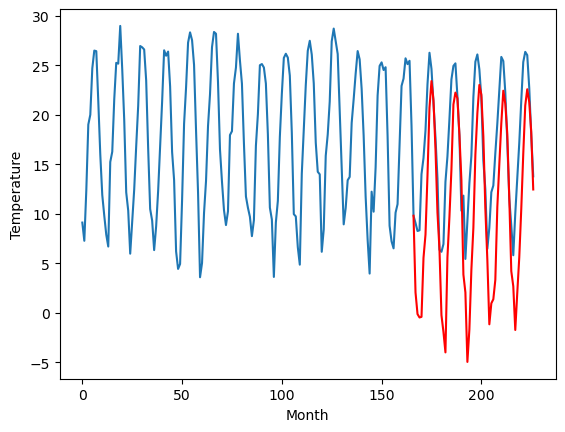

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.51		5.95		-0.56
5.89		3.77		-2.12
5.04		3.43		-1.61
5.72		3.50		-2.22
12.64		9.45		-3.19
13.78		11.80		-1.98
18.28		17.77		-0.51
23.84		24.62		0.78
26.38		27.30		0.92
24.36		25.38		1.02
21.06		20.48		-0.58
14.29		14.03		-0.26
10.62		10.33		-0.29
4.02		3.66		-0.36
3.71		1.97		-1.74
0.71		-0.11		-0.82
12.03		9.50		-2.53
13.74		13.60		-0.14
18.40		18.38		-0.02
24.48		24.93		0.45
25.47		26.13		0.66
26.69		25.56		-1.13
22.98		21.88		-1.10
17.78		17.30		-0.48
8.48		7.75		-0.73
10.89		5.95		-4.94
2.06		-1.07		-3.13
4.11		2.21		-1.90
10.06		8.24		-1.82
15.25		12.47		-2.78
20.72		19.84		-0.88
24.78		24.04		-0.74
28.91		26.88		-2.03
26.04		25.88		-0.16
22.20		21.68		-0.52
15.53		14.38		-1.15
8.93		9.23		0.30
5.19		2.71		-2.48
6.38		4.83		-1.55
7.88		5.24		-2.64
10.71		7.21		-3.50
15.11		14.56		-0.55
20.46		18.88		-1.58
24.27		23.02		-1.25
26.57		26.32		-0.25
27.07		24.99		-2.08
23.45		21.95		-1.50
17

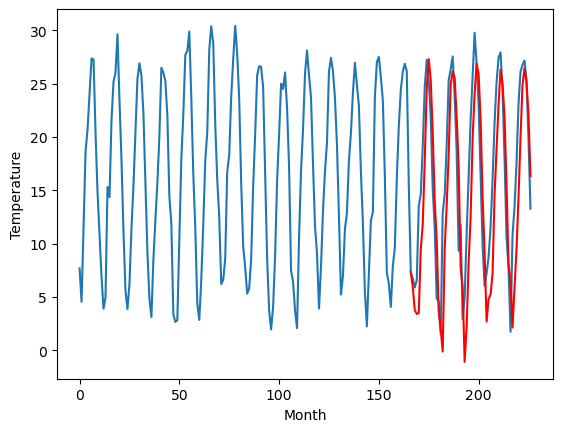

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.17		4.66		-1.51
4.32		2.48		-1.84
4.50		2.15		-2.35
3.99		2.21		-1.78
11.82		8.16		-3.66
13.20		10.50		-2.70
19.31		16.47		-2.84
24.42		23.31		-1.11
26.96		26.00		-0.96
26.03		24.07		-1.96
19.38		19.17		-0.21
13.20		12.73		-0.47
10.32		9.03		-1.29
3.64		2.36		-1.28
3.29		0.67		-2.62
-1.49		-1.42		0.07
11.07		8.19		-2.88
12.87		12.29		-0.58
17.68		17.06		-0.62
23.71		23.62		-0.09
25.22		24.81		-0.41
25.61		24.23		-1.38
23.10		20.56		-2.54
16.85		15.97		-0.88
9.10		6.42		-2.68
8.29		4.61		-3.68
0.67		-2.41		-3.08
1.65		0.87		-0.78
8.90		6.90		-2.00
16.01		11.13		-4.88
21.37		18.49		-2.88
25.66		22.69		-2.97
29.81		25.52		-4.29
27.14		24.53		-2.61
23.31		20.32		-2.99
15.08		13.02		-2.06
7.23		7.87		0.64
3.60		1.35		-2.25
4.46		3.47		-0.99
4.83		3.88		-0.95
9.26		5.85		-3.41
13.59		13.20		-0.39
19.28		17.52		-1.76
24.21		21.67		-2.54
27.09		24.96		-2.13
28.90		23.63		-5.27
24.26		20.58		-3.68
1

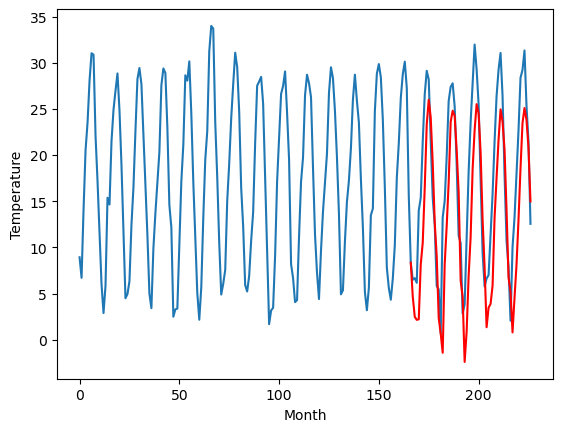

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.70		4.19		-4.51
7.34		2.01		-5.33
6.89		1.68		-5.21
5.65		1.74		-3.91
13.61		7.69		-5.92
15.92		10.04		-5.88
22.45		16.00		-6.45
28.83		22.84		-5.99
30.41		25.53		-4.88
29.18		23.60		-5.58
22.43		18.70		-3.73
15.83		12.27		-3.56
12.65		8.57		-4.08
5.38		1.89		-3.49
5.49		0.20		-5.29
1.12		-1.89		-3.01
11.83		7.73		-4.10
15.59		11.82		-3.77
20.14		16.60		-3.54
27.25		23.15		-4.10
27.92		24.35		-3.57
27.77		23.77		-4.00
25.82		20.10		-5.72
18.38		15.51		-2.87
12.13		5.96		-6.17
10.52		4.15		-6.37
3.60		-2.88		-6.48
3.66		0.40		-3.26
10.59		6.42		-4.17
17.07		10.65		-6.42
22.52		18.02		-4.50
27.09		22.22		-4.87
30.69		25.05		-5.64
27.86		24.06		-3.80
25.45		19.86		-5.59
16.91		12.56		-4.35
7.92		7.40		-0.52
5.57		0.88		-4.69
5.85		2.99		-2.86
7.00		3.41		-3.59
10.73		5.38		-5.35
16.08		12.73		-3.35
21.19		17.05		-4.14
24.42		21.20		-3.22
29.04		24.49		-4.55
29.44		23.16		-6.28
25.92		20.10		-

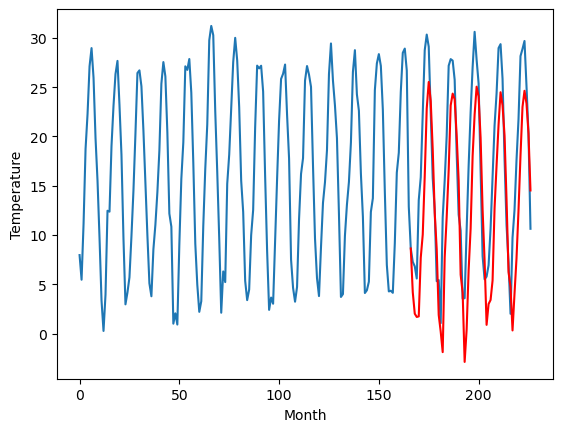

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.40		0.35		0.75
-3.21		-1.82		1.39
-2.87		-2.16		0.71
-2.13		-2.10		0.03
2.19		3.86		1.67
3.82		6.19		2.37
9.28		12.17		2.89
16.60		19.01		2.41
20.47		21.71		1.24
18.28		19.78		1.50
13.75		14.87		1.12
8.21		8.44		0.23
4.01		4.74		0.73
-3.00		-1.94		1.06
-4.84		-3.63		1.21
-5.80		-5.71		0.09
1.42		3.89		2.47
6.07		7.98		1.91
10.61		12.76		2.15
16.70		19.32		2.62
18.93		20.51		1.58
18.71		19.94		1.23
15.01		16.26		1.25
10.59		11.68		1.09
1.27		2.13		0.86
0.50		0.32		-0.18
-6.52		-6.71		-0.19
-2.62		-3.42		-0.80
1.94		2.61		0.67
5.29		6.84		1.55
12.27		14.20		1.93
16.66		18.40		1.74
20.60		21.23		0.63
20.06		20.24		0.18
15.15		16.03		0.88
7.05		8.73		1.68
3.54		3.57		0.03
-3.61		-2.95		0.66
-0.65		-0.83		-0.18
-0.97		-0.42		0.55
0.15		1.54		1.39
7.37		8.90		1.53
9.93		13.21		3.28
14.30		17.36		3.06
19.44		20.65		1.21
17.70		19.31		1.61
14.51		16.26		1.75
9.16		9.73		0.57
1.22		2.41		1.19
-0.4

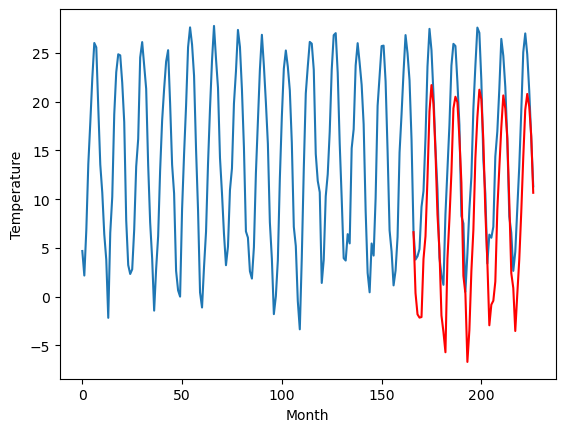

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[0.3583432388305656, -1.0715919113159176, 0.16947715759277315, -0.7932482147216797, 3.4460308074951165, -0.40158500671386754, 2.061161346435547, 5.951403579711915, 4.659933967590332, 4.192440223693847, 0.35451805114746016]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68   0.358343
1                 1   -0.99  -1.071592
2                 2   -0.90   0.169477
3                 3    1.19  -0.793248
4                 4    5.60   3.446031
5                 5    2.73  -0.401585
6                 6    1.75   2.061161
7                 7    6.51   5.951404
8                 8    6.17   4.659934
9                 9    8.70   4.192440
10               10   -0.40   0.354518


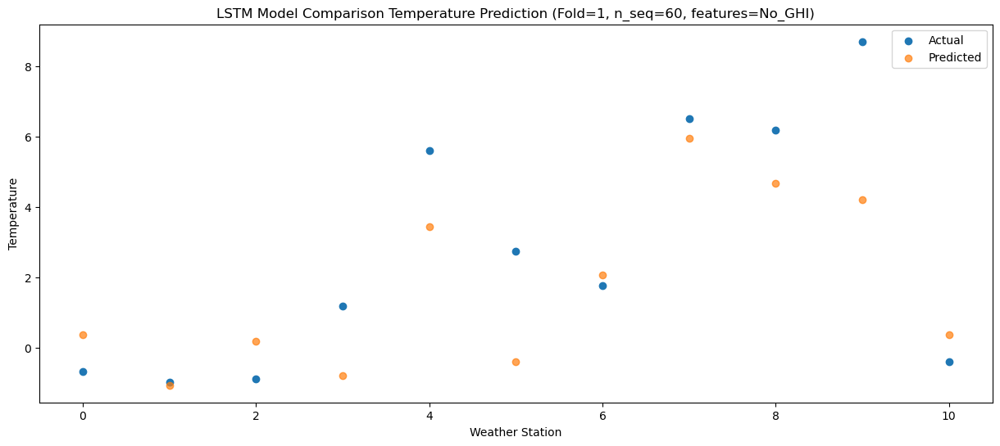

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -1.808548
1                 1   -1.90  -3.240517
2                 2   -0.47  -2.001584
3                 3   -0.23  -2.971880
4                 4    3.71   1.260631
5                 5    0.70  -2.587096
6                 6    1.02  -0.120187
7                 7    5.89   3.769607
8                 8    4.32   2.475054
9                 9    7.34   2.009553
10               10   -3.21  -1.823722


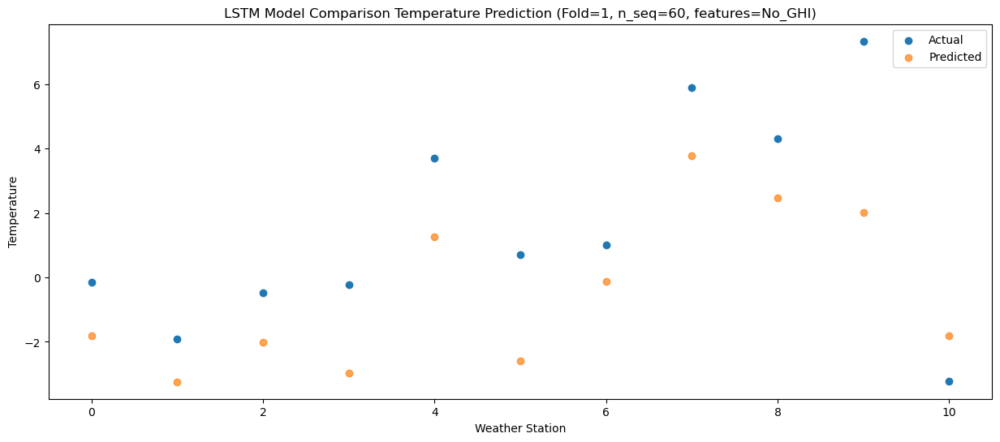

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -2.146222
1                 1   -3.01  -3.579351
2                 2   -1.00  -2.343302
3                 3    0.52  -3.317285
4                 4    4.52   0.917771
5                 5    0.04  -2.928966
6                 6    0.21  -0.464998
7                 7    5.04   3.432634
8                 8    4.50   2.145872
9                 9    6.89   1.679099
10               10   -2.87  -2.158368


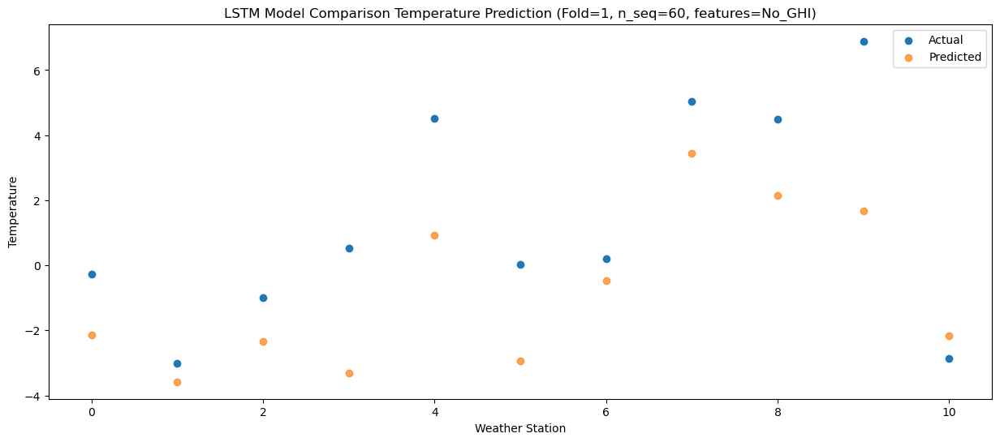

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40  -2.090510
1                 1   -2.92  -3.519742
2                 2   -0.72  -2.282954
3                 3   -0.01  -3.254401
4                 4    4.14   0.982274
5                 5   -0.48  -2.867761
6                 6    0.28  -0.400276
7                 7    5.72   3.495170
8                 8    3.99   2.206749
9                 9    5.65   1.739156
10               10   -2.13  -2.100700


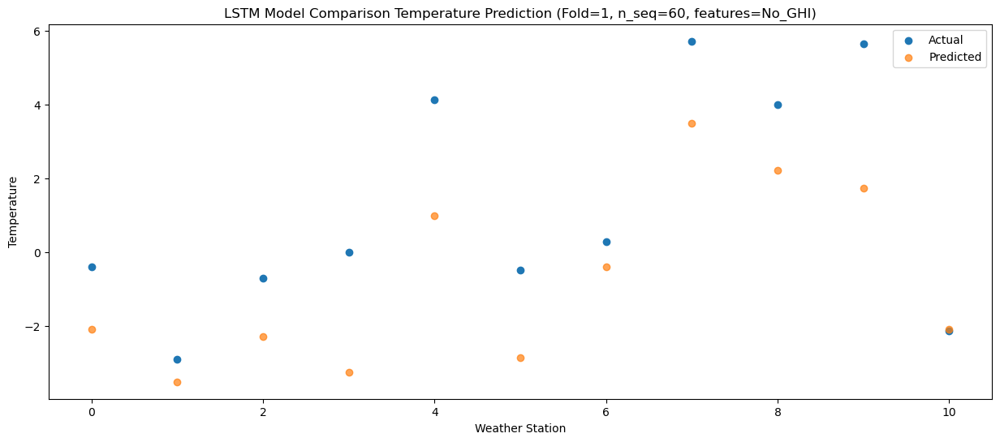

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   3.880876
1                 1    3.08   2.448201
2                 2    6.38   3.683900
3                 3    7.63   2.704458
4                 4   12.18   6.933683
5                 5    6.87   3.083325
6                 6    5.95   5.556878
7                 7   12.64   9.453754
8                 8   11.82   8.161247
9                 9   13.61   7.694281
10               10    2.19   3.855772


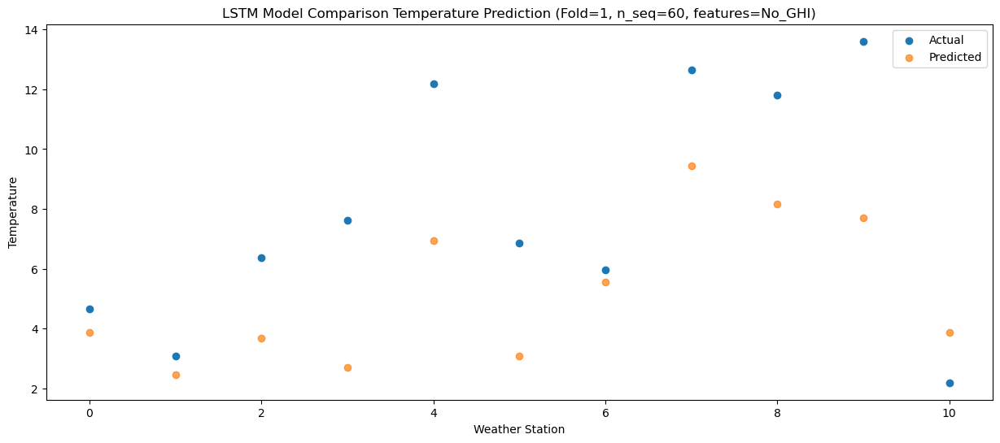

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   6.224110
1                 1    4.30   4.792222
2                 2    5.41   6.030952
3                 3    7.51   5.056360
4                 4   11.92   9.287385
5                 5    9.66   5.433615
6                 6    7.58   7.905179
7                 7   13.78  11.799711
8                 8   13.20  10.504587
9                 9   15.92  10.038642
10               10    3.82   6.193511


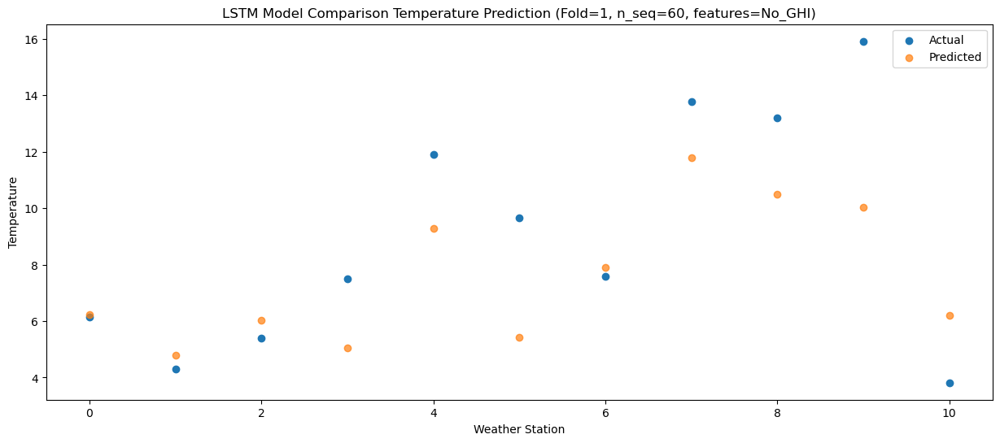

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  12.210111
1                 1    7.65  10.779630
2                 2    9.56  12.015832
3                 3   11.26  11.034092
4                 4   15.72  15.255769
5                 5   14.85  11.397608
6                 6   10.36  13.879094
7                 7   18.28  17.774199
8                 8   19.31  16.470785
9                 9   22.45  16.003347
10               10    9.28  12.166543


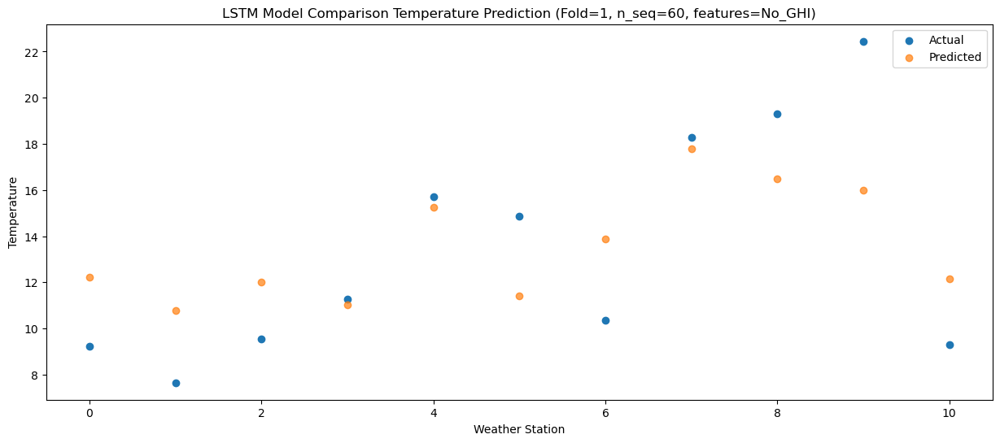

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  19.056212
1                 1   12.00  17.630923
2                 2   13.79  18.870663
3                 3   14.04  17.884583
4                 4   18.75  22.102520
5                 5   17.57  18.241431
6                 6   15.03  20.724521
7                 7   23.84  24.616707
8                 8   24.42  23.311833
9                 9   28.83  22.841166
10               10   16.60  19.010271


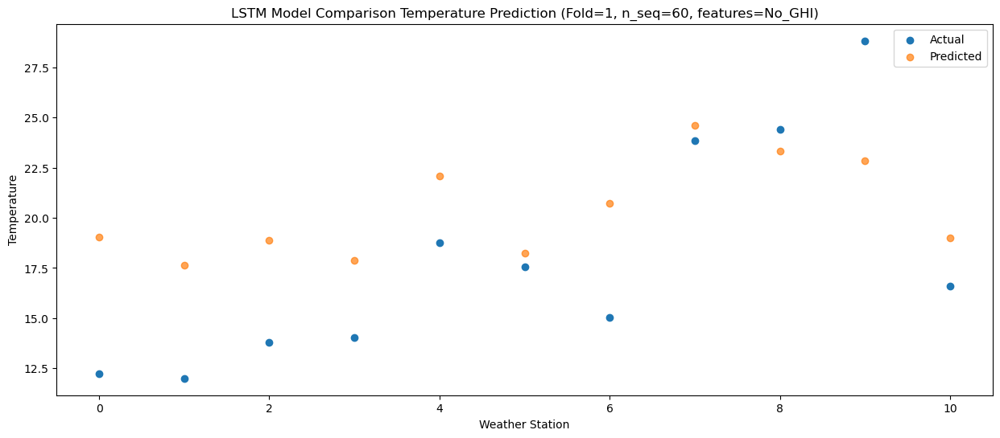

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  21.746558
1                 1   15.37  20.321316
2                 2   15.26  21.559559
3                 3   15.69  20.568849
4                 4   20.79  24.784585
5                 5   20.27  20.921811
6                 6   18.21  23.409671
7                 7   26.38  27.304775
8                 8   26.96  26.001729
9                 9   30.41  25.530082
10               10   20.47  21.707560


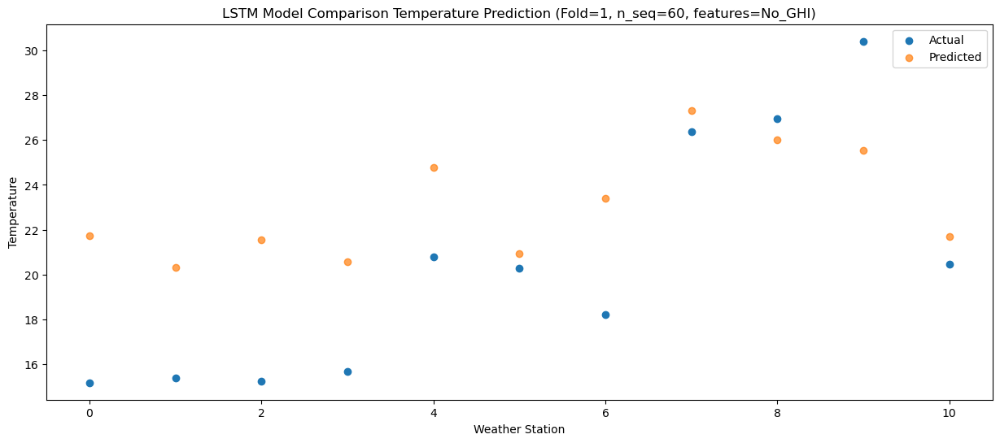

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  19.823662
1                 1   13.96  18.398462
2                 2   15.25  19.635681
3                 3   15.93  18.643747
4                 4   21.03  22.856398
5                 5   20.12  18.989493
6                 6   16.58  21.483141
7                 7   24.36  25.379947
8                 8   26.03  24.073589
9                 9   29.18  23.604386
10               10   18.28  19.783717


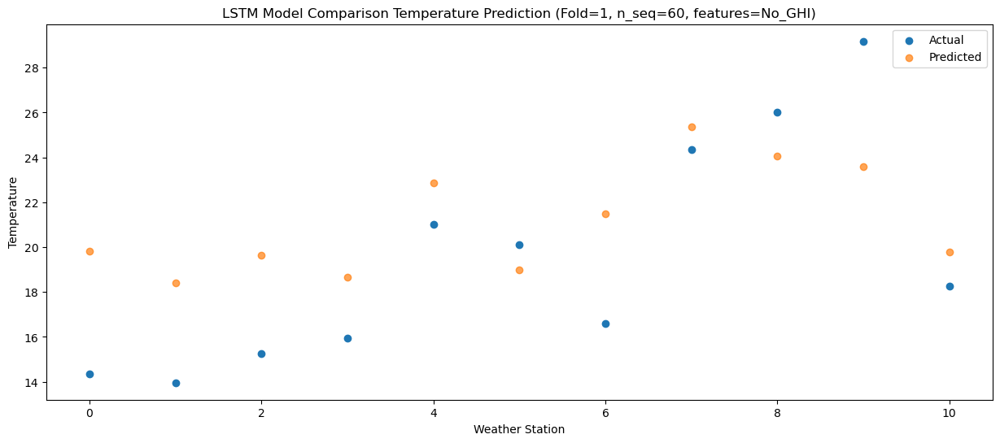

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  14.912131
1                 1   10.42  13.488512
2                 2   12.45  14.725734
3                 3   12.52  13.738066
4                 4   17.45  17.954281
5                 5   12.59  14.084303
6                 6   13.16  16.577856
7                 7   21.06  20.475314
8                 8   19.38  19.167856
9                 9   22.43  18.700146
10               10   13.75  14.874745


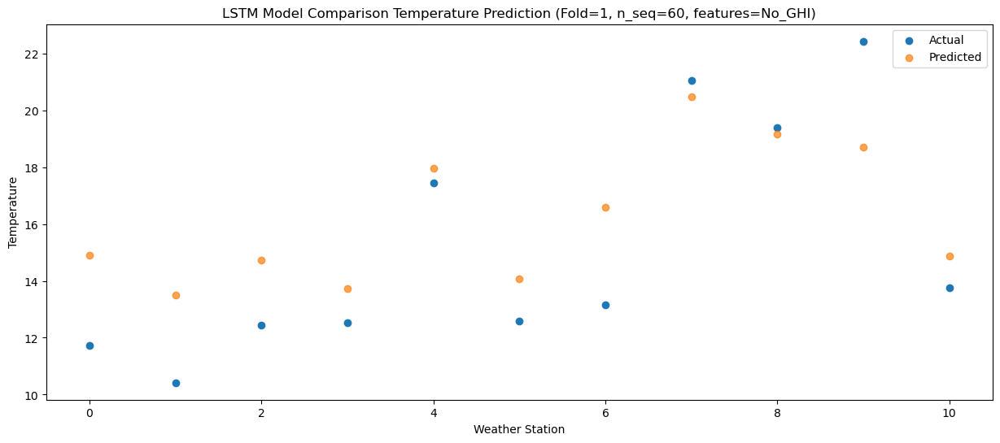

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79   8.465351
1                 1    6.70   7.040214
2                 2    8.10   8.275160
3                 3    7.98   7.290873
4                 4   12.51  11.511125
5                 5    9.75   7.643366
6                 6    9.67  10.137530
7                 7   14.29  14.032461
8                 8   13.20  12.732054
9                 9   15.83  12.267442
10               10    8.21   8.438178


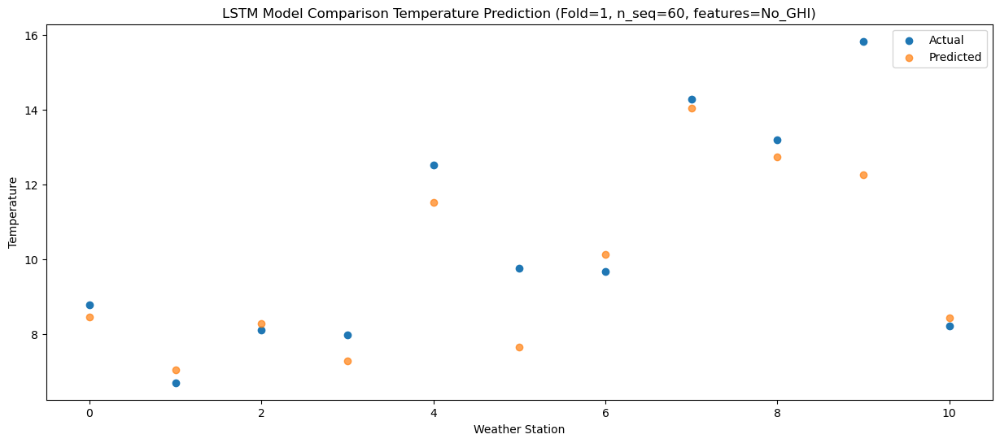

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   4.761286
1                 1    2.60   3.336378
2                 2    3.30   4.570217
3                 3    5.08   3.586452
4                 4    9.41   7.808624
5                 5    6.03   3.943285
6                 6    5.52   6.436140
7                 7   10.62  10.329793
8                 8   10.32   9.030243
9                 9   12.65   8.566695
10               10    4.01   4.737287


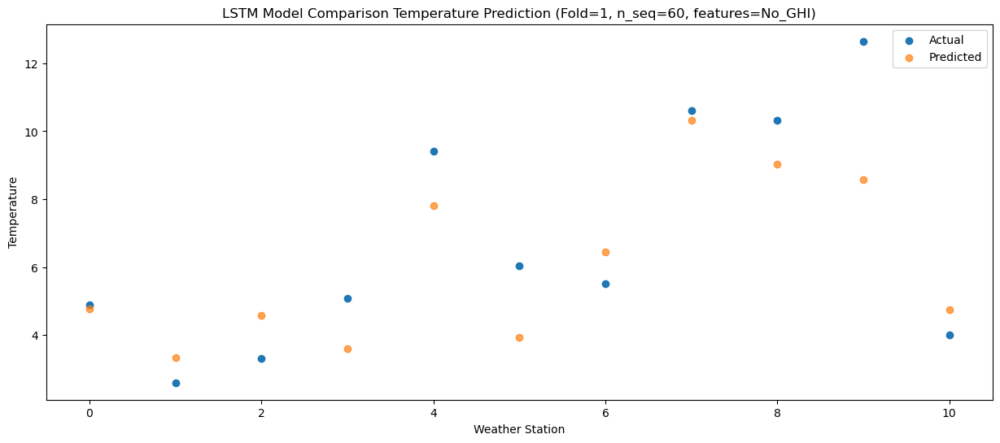

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -1.901764
1                 1   -4.29  -3.322851
2                 2   -3.76  -2.087006
3                 3   -1.10  -3.069998
4                 4    3.05   1.148049
5                 5   -0.72  -2.726336
6                 6   -1.69  -0.229528
7                 7    4.02   3.663713
8                 8    3.64   2.356376
9                 9    5.38   1.888402
10               10   -3.00  -1.940008


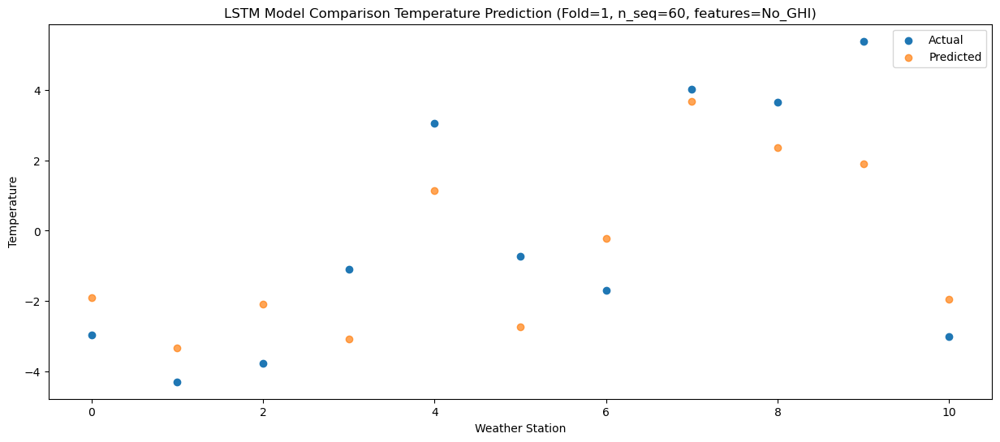

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -3.595800
1                 1   -4.49  -5.014761
2                 2   -3.34  -3.777061
3                 3   -1.20  -4.757896
4                 4    3.04  -0.538352
5                 5   -2.23  -4.414045
6                 6   -1.89  -1.920916
7                 7    3.71   1.971773
8                 8    3.29   0.665215
9                 9    5.49   0.197378
10               10   -4.84  -3.633820


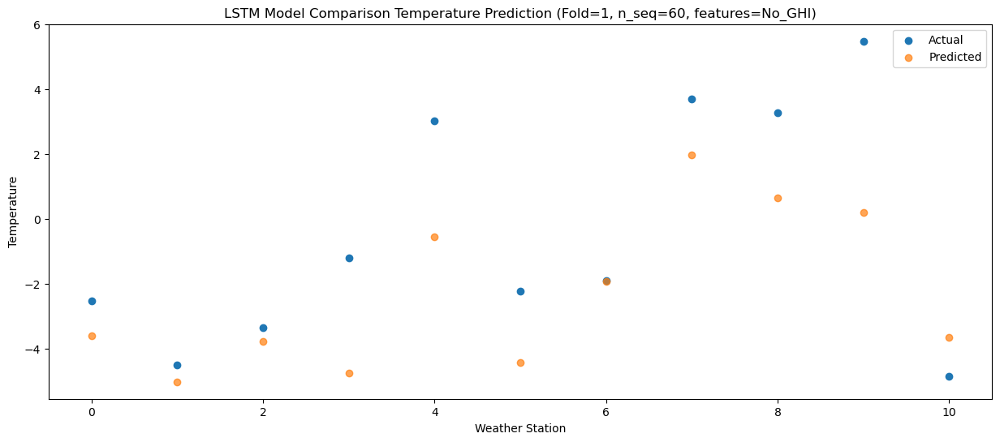

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -5.651939
1                 1   -3.83  -7.072627
2                 2   -2.85  -5.839050
3                 3   -2.79  -6.825418
4                 4    1.34  -2.609529
5                 5   -1.85  -6.489543
6                 6   -1.11  -3.989915
7                 7    0.71  -0.105934
8                 8   -1.49  -1.419573
9                 9    1.12  -1.889938
10               10   -5.80  -5.712577


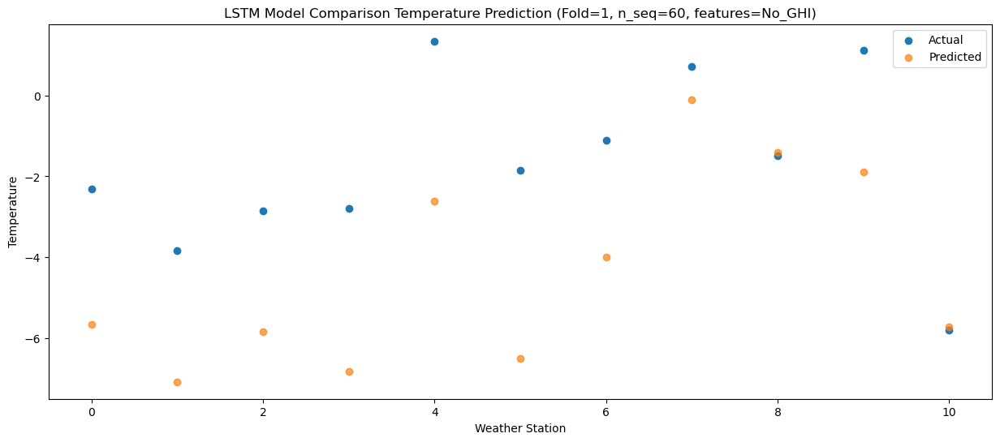

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   3.941465
1                 1    2.94   2.517664
2                 2    4.21   3.755131
3                 3    4.58   2.775644
4                 4    8.95   6.998598
5                 5    5.49   3.118540
6                 6    5.17   5.612973
7                 7   12.03   9.499972
8                 8   11.07   8.191374
9                 9   11.83   7.725410
10               10    1.42   3.891471


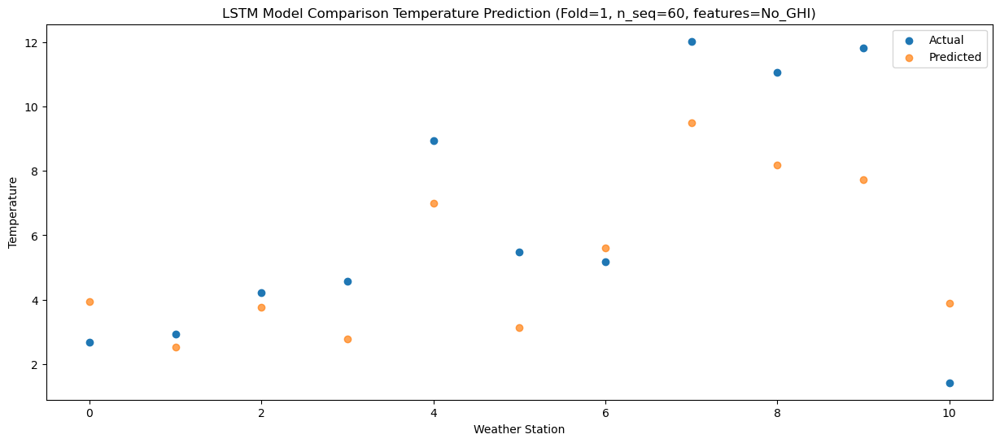

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48   8.034396
1                 1    5.08   6.609133
2                 2    5.61   7.844893
3                 3    6.92   6.871494
4                 4   11.25  11.097215
5                 5    7.76   7.216607
6                 6    7.74   9.708969
7                 7   13.74  13.597428
8                 8   12.87  12.287620
9                 9   15.59  11.824123
10               10    6.07   7.984661


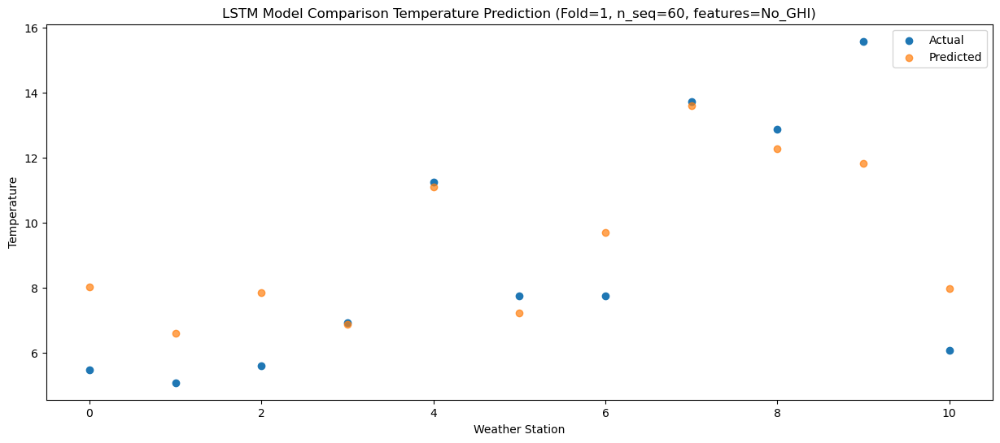

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09  12.827373
1                 1    8.81  11.405792
2                 2    9.73  12.641486
3                 3   10.81  11.660913
4                 4   15.37  15.877774
5                 5   13.35  11.989981
6                 6   11.51  14.489446
7                 7   18.40  18.378077
8                 8   17.68  17.061216
9                 9   20.14  16.595778
10               10   10.61  12.756845


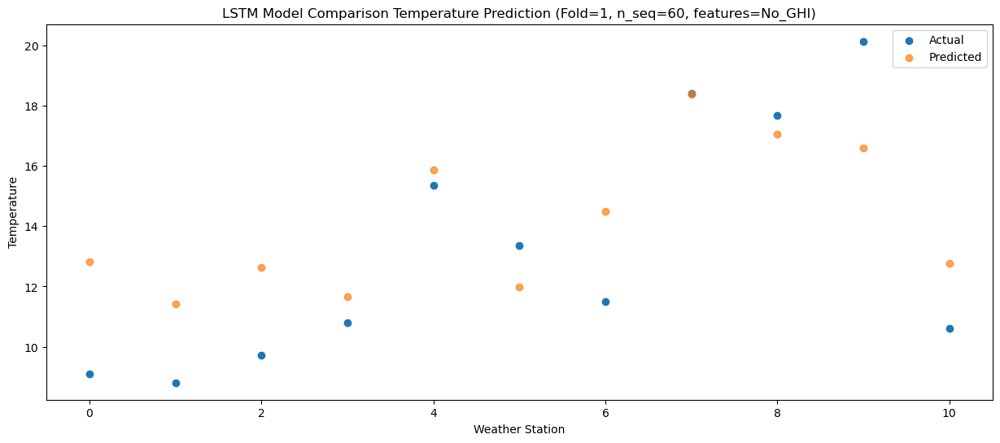

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  19.381496
1                 1   12.95  17.960019
2                 2   13.61  19.192314
3                 3   14.70  18.211751
4                 4   18.84  22.429638
5                 5   17.62  18.544035
6                 6   15.52  21.045313
7                 7   24.48  24.934077
8                 8   23.71  23.617048
9                 9   27.25  23.151921
10               10   16.70  19.317579


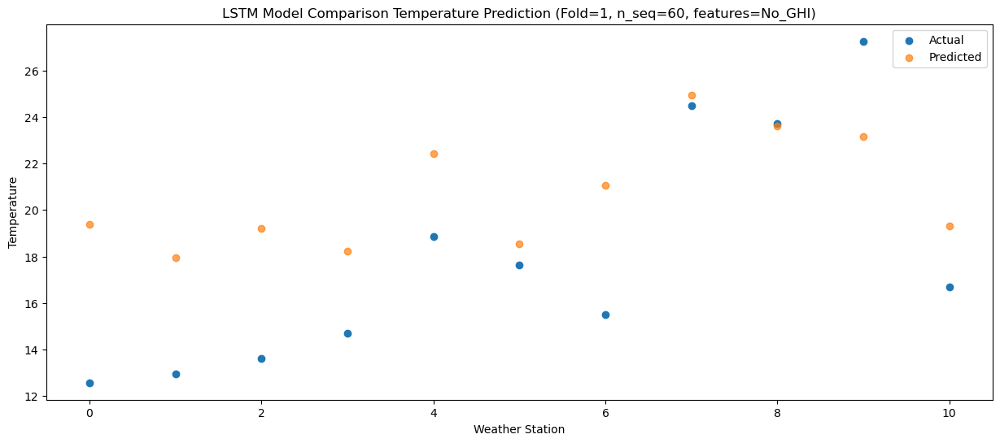

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  20.583144
1                 1   14.33  19.162865
2                 2   14.38  20.395348
3                 3   14.58  19.412898
4                 4   18.93  23.625801
5                 5   16.96  19.742688
6                 6   16.88  22.246931
7                 7   25.47  26.134966
8                 8   25.22  24.812201
9                 9   27.92  24.350303
10               10   18.93  20.512470


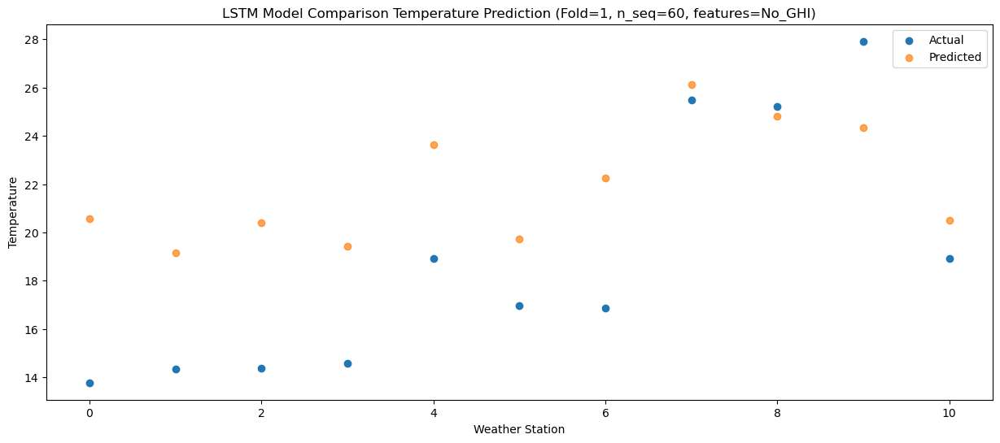

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  20.011573
1                 1   14.60  18.591988
2                 2   15.04  19.823432
3                 3   15.55  18.842306
4                 4   19.90  23.053508
5                 5   16.37  19.165491
6                 6   17.14  21.672615
7                 7   26.69  25.563720
8                 8   25.61  24.233793
9                 9   27.77  23.767011
10               10   18.71  19.939103


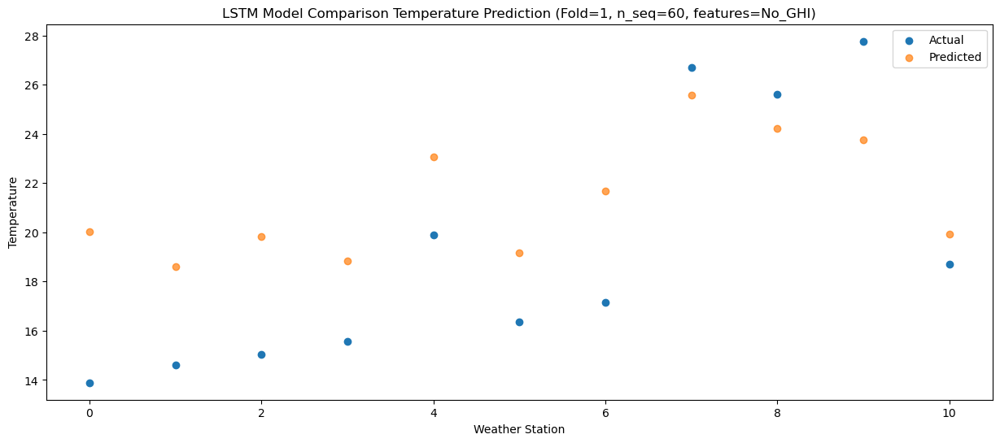

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  16.335338
1                 1   10.86  14.913256
2                 2   12.02  16.143973
3                 3   12.54  15.168044
4                 4   16.32  19.383053
5                 5   16.01  15.493678
6                 6   13.81  17.994560
7                 7   22.98  21.884507
8                 8   23.10  20.558774
9                 9   25.82  20.096693
10               10   15.01  16.262499


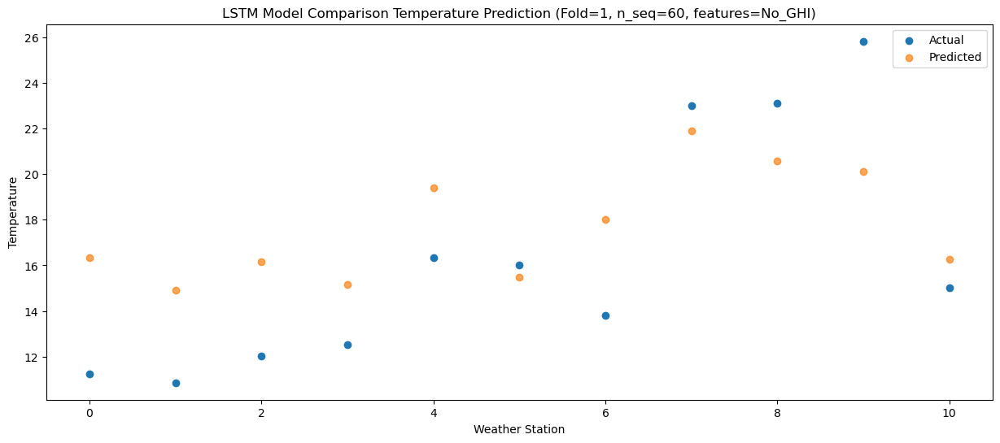

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54  11.759185
1                 1    7.08  10.335617
2                 2    8.24  11.564165
3                 3    9.85  10.584895
4                 4   13.28  14.796137
5                 5   11.69  10.906882
6                 6    9.86  13.409269
7                 7   17.78  17.297593
8                 8   16.85  15.971749
9                 9   18.38  15.510520
10               10   10.59  11.676834


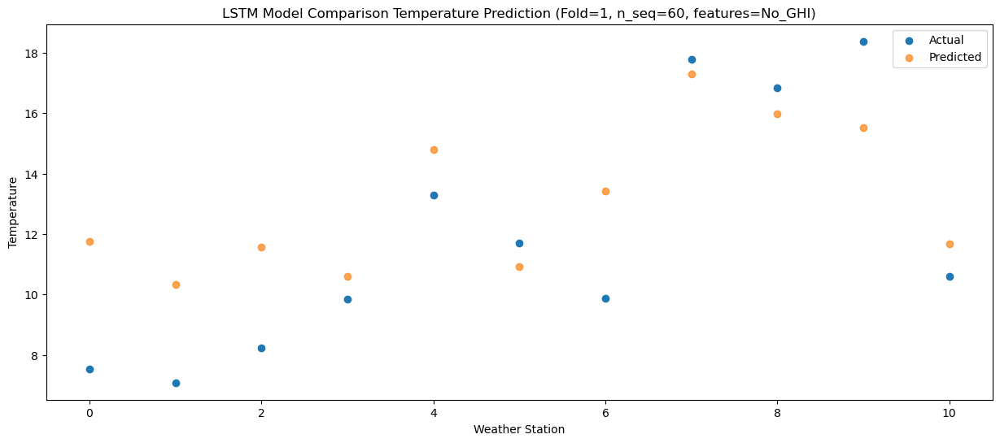

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67   2.207813
1                 1   -0.58   0.786405
2                 2    0.50   2.015516
3                 3    2.69   1.042534
4                 4    5.73   5.257104
5                 5    5.22   1.369355
6                 6    2.26   3.867798
7                 7    8.48   7.750923
8                 8    9.10   6.424669
9                 9   12.13   5.964878
10               10    1.27   2.125605


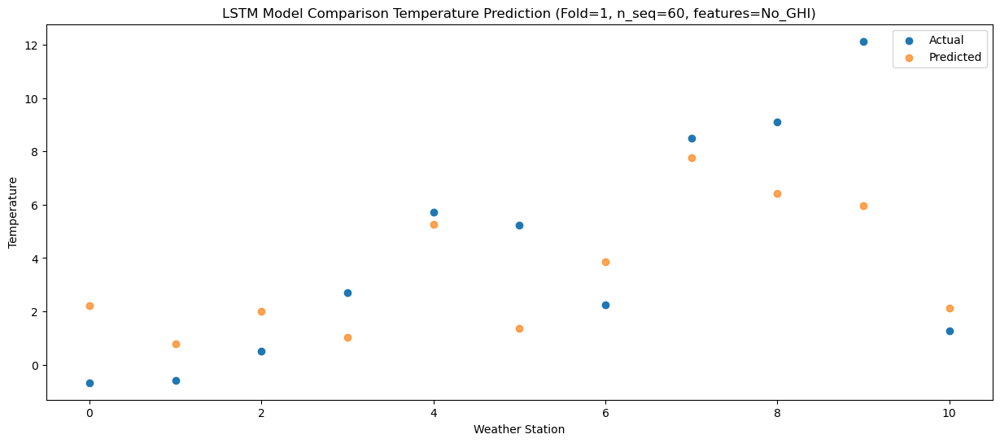

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68   0.395994
1                 1    1.05  -1.023642
2                 2    3.10   0.206976
3                 3    6.06  -0.763441
4                 4    9.61   3.452136
5                 5    5.48  -0.442212
6                 6    3.78   2.063165
7                 7   10.89   5.946242
8                 8    8.29   4.614050
9                 9   10.52   4.146992
10               10    0.50   0.316762


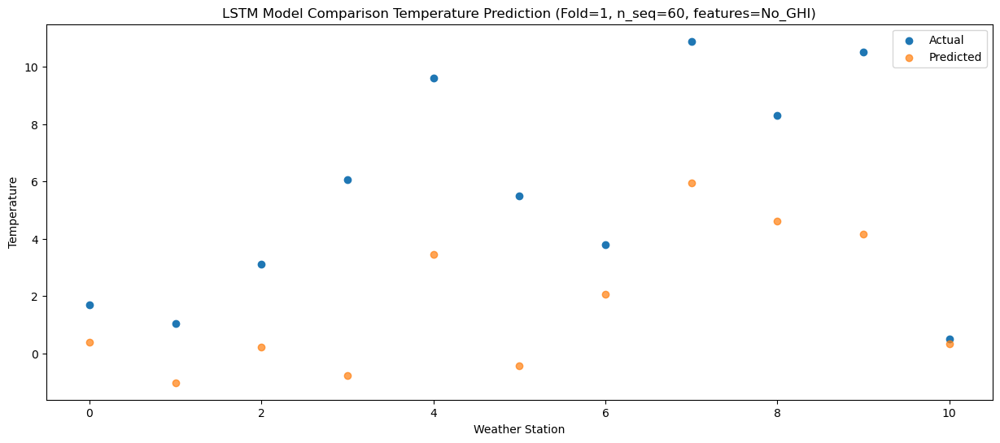

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48  -6.619819
1                 1   -5.68  -8.037379
2                 2   -3.79  -6.806227
3                 3   -1.99  -7.779320
4                 4    1.13  -3.566792
5                 5   -1.84  -7.466434
6                 6   -2.61  -4.952163
7                 7    2.06  -1.073879
8                 8    0.67  -2.411794
9                 9    3.60  -2.883686
10               10   -6.52  -6.705007


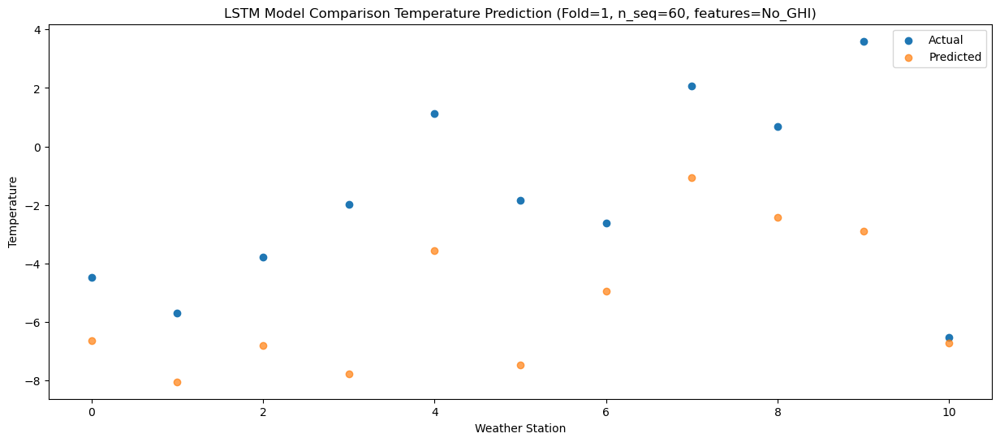

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36  -3.320957
1                 1   -1.45  -4.739788
2                 2   -0.44  -3.511706
3                 3   -2.46  -4.487494
4                 4    0.82  -0.280514
5                 5   -1.95  -4.183073
6                 6    1.20  -1.666818
7                 7    4.11   2.209494
8                 8    1.65   0.866619
9                 9    3.66   0.395095
10               10   -2.62  -3.424329


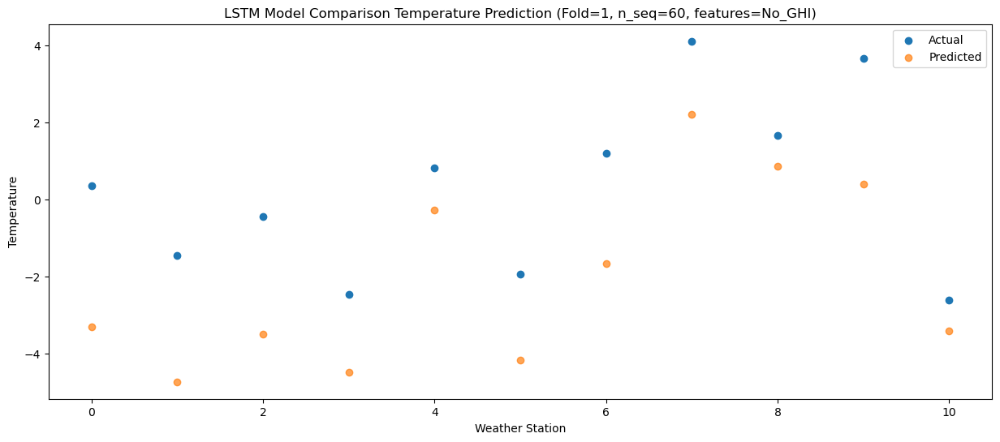

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75   2.715998
1                 1    2.12   1.299957
2                 2    3.56   2.526030
3                 3    3.38   1.544851
4                 4    6.60   5.749855
5                 5    5.00   1.845956
6                 6    5.04   4.365687
7                 7   10.06   8.243202
8                 8    8.90   6.897708
9                 9   10.59   6.423863
10               10    1.94   2.614125


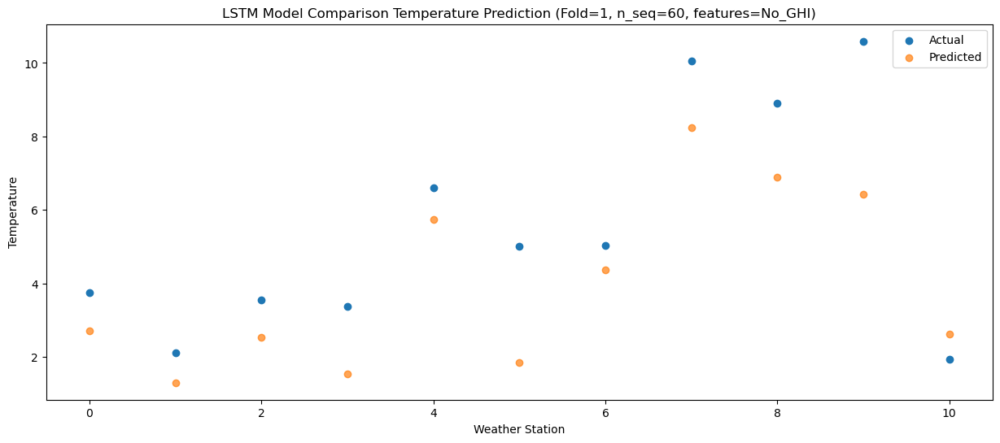

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74   6.953112
1                 1    5.12   5.537694
2                 2    7.15   6.763704
3                 3    9.38   5.783860
4                 4   12.87   9.989085
5                 5   11.91   6.081278
6                 6    7.80   8.597878
7                 7   15.25  12.470805
8                 8   16.01  11.125330
9                 9   17.07  10.651706
10               10    5.29   6.838548


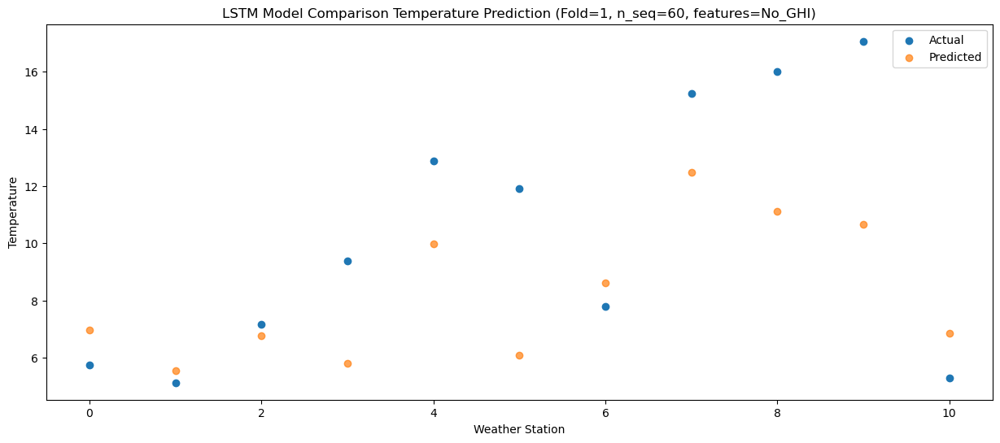

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  14.316563
1                 1   11.00  12.903463
2                 2   12.51  14.132810
3                 3   13.81  13.153537
4                 4   17.49  17.359648
5                 5   17.31  13.452703
6                 6   13.72  15.968115
7                 7   20.72  19.837877
8                 8   21.37  18.487364
9                 9   22.52  18.015922
10               10   12.27  14.199039


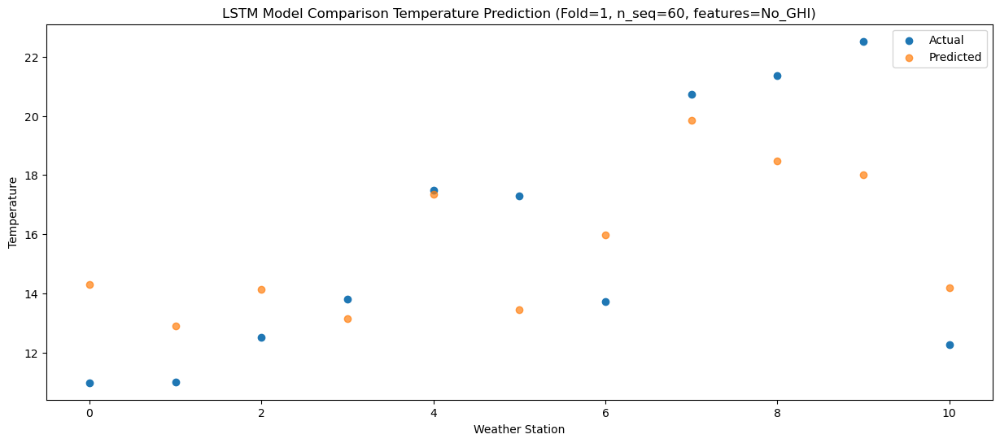

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  18.512709
1                 1   14.97  17.102612
2                 2   15.48  18.334833
3                 3   16.81  17.356691
4                 4   20.86  21.561783
5                 5   19.37  17.655701
6                 6   17.30  20.171713
7                 7   24.78  24.041301
8                 8   25.66  22.688433
9                 9   27.09  22.217270
10               10   16.66  18.402449


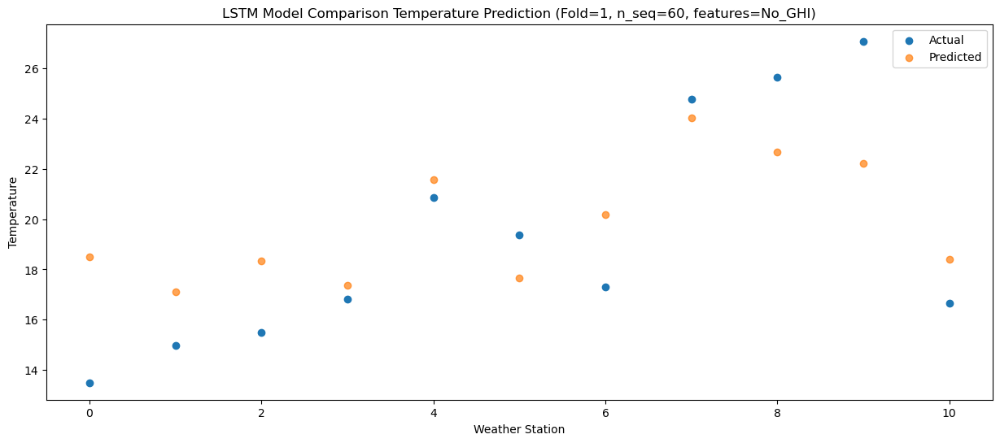

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  21.353995
1                 1   15.47  19.946737
2                 2   16.19  21.180525
3                 3   17.75  20.206091
4                 4   21.95  24.411244
5                 5   20.29  20.505316
6                 6   18.04  23.019975
7                 7   28.91  26.880563
8                 8   29.81  25.522804
9                 9   30.69  25.052694
10               10   20.60  21.233712


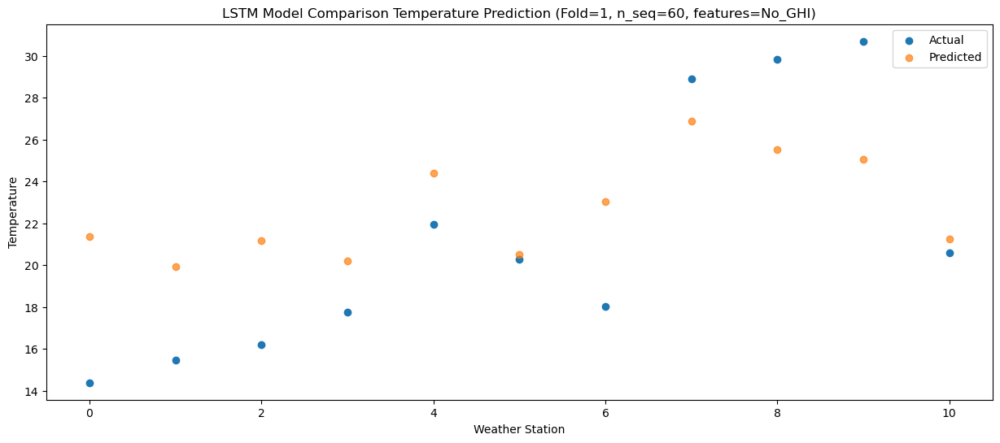

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  20.363730
1                 1   14.01  18.958346
2                 2   14.58  20.190885
3                 3   16.11  19.213726
4                 4   19.94  23.416908
5                 5   17.44  19.505816
6                 6   16.54  22.022974
7                 7   26.04  25.882995
8                 8   27.14  24.528158
9                 9   27.86  24.059816
10               10   20.06  20.240041


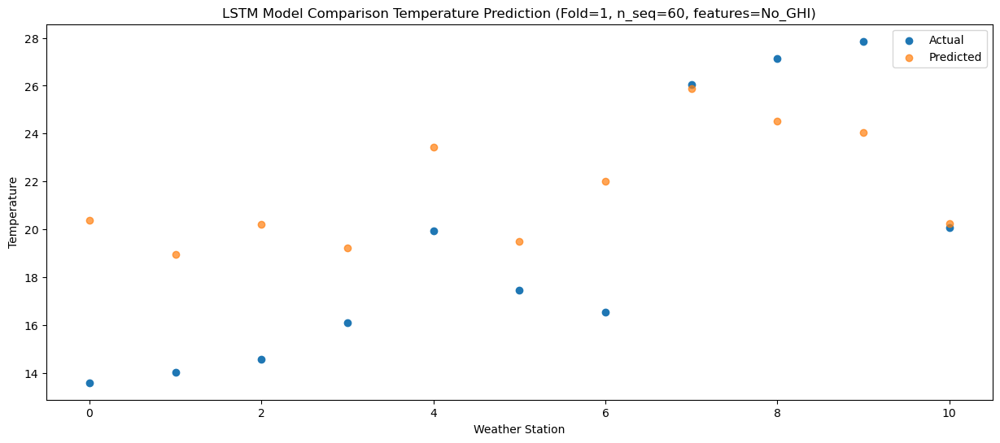

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  16.158203
1                 1   10.92  14.748994
2                 2   12.19  15.981343
3                 3   13.34  15.008894
4                 4   16.76  19.212080
5                 5   14.39  15.301681
6                 6   13.65  17.812997
7                 7   22.20  21.676629
8                 8   23.31  20.323919
9                 9   25.45  19.859653
10               10   15.15  16.028249


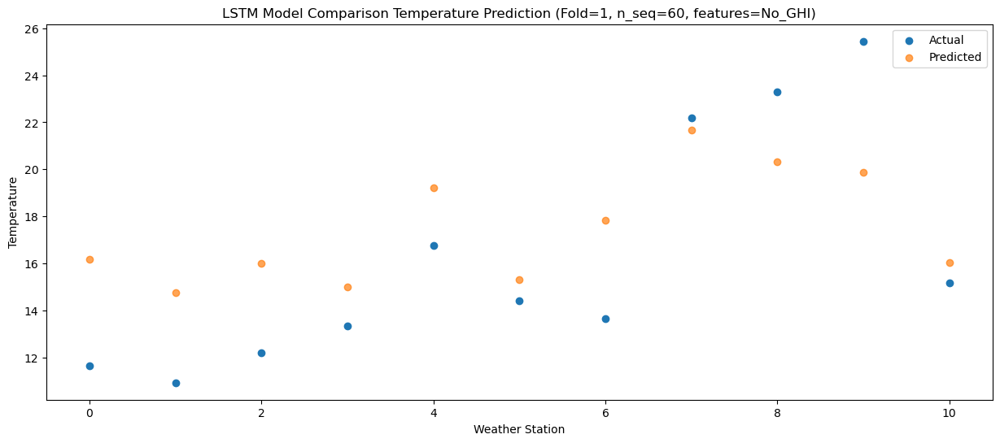

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08   8.866640
1                 1    4.58   7.459149
2                 2    5.50   8.691797
3                 3    7.78   7.713379
4                 4   11.37  11.913412
5                 5    8.31   7.999486
6                 6    7.31  10.518252
7                 7   15.53  14.379364
8                 8   15.08  13.022160
9                 9   16.91  12.555860
10               10    7.05   8.730976


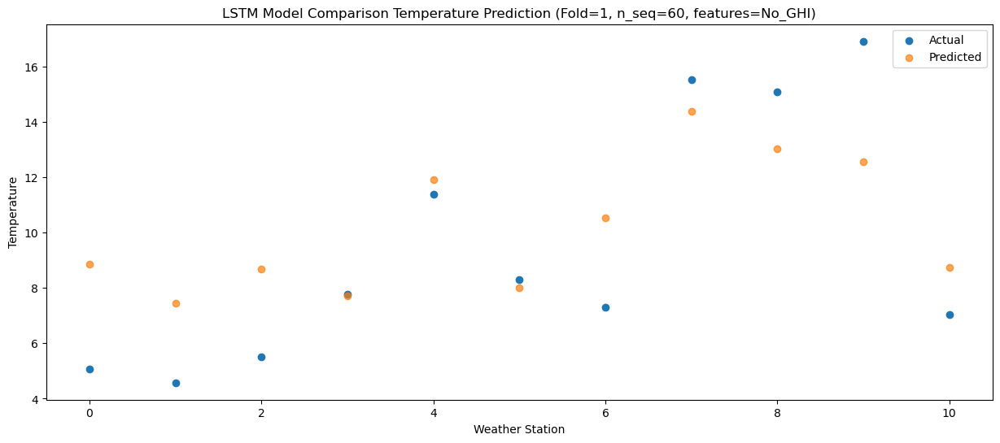

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88   3.716537
1                 1    1.58   2.311520
2                 2    2.18   3.545312
3                 3    2.73   2.565798
4                 4    6.37   6.763320
5                 5    1.35   2.846515
6                 6    4.42   5.370437
7                 7    8.93   9.229303
8                 8    7.23   7.869088
9                 9    7.92   7.401161
10               10    3.54   3.574708


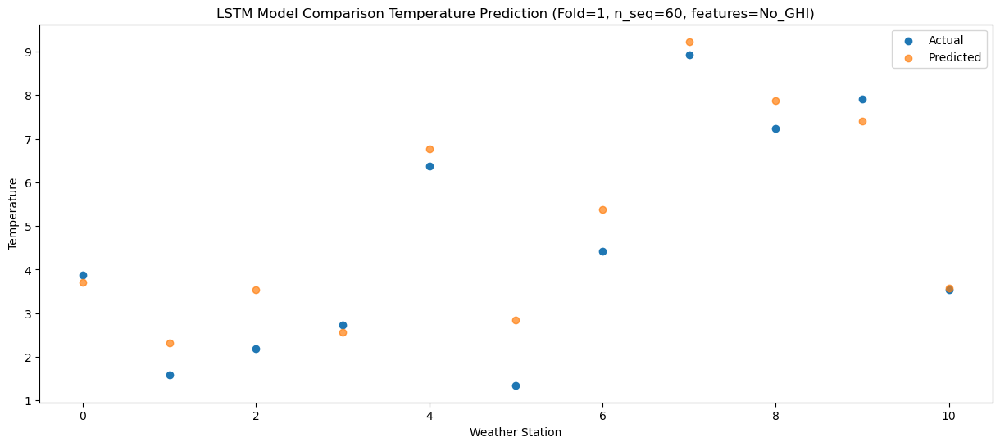

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88  -2.801002
1                 1   -4.23  -4.208163
2                 2   -0.98  -2.975522
3                 3    0.64  -3.961513
4                 4    4.35   0.236821
5                 5    0.23  -3.679593
6                 6   -1.59  -1.153957
7                 7    5.19   2.707290
8                 8    3.60   1.347370
9                 9    5.57   0.879171
10               10   -3.61  -2.945885


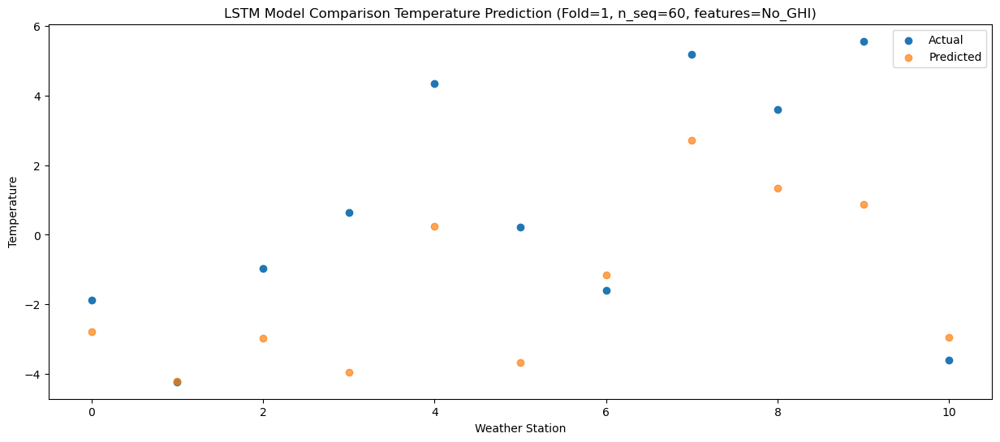

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23  -0.676944
1                 1   -2.04  -2.079448
2                 2    0.02  -0.848104
3                 3    1.35  -1.837879
4                 4    4.83   2.353697
5                 5    0.69  -1.568307
6                 6    0.54   0.964919
7                 7    6.38   4.829456
8                 8    4.46   3.465941
9                 9    5.85   2.994159
10               10   -0.65  -0.826993


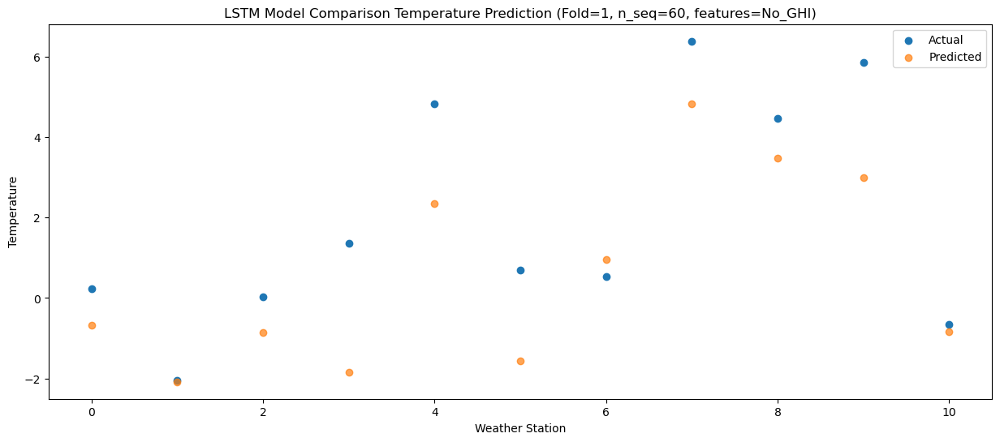

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14  -0.277710
1                 1    1.33  -1.676547
2                 2    2.61  -0.444199
3                 3    2.35  -1.422969
4                 4    6.01   2.773556
5                 5    0.83  -1.148689
6                 6    4.13   1.380182
7                 7    7.88   5.243832
8                 8    4.83   3.879078
9                 9    7.00   3.405398
10               10   -0.97  -0.424917


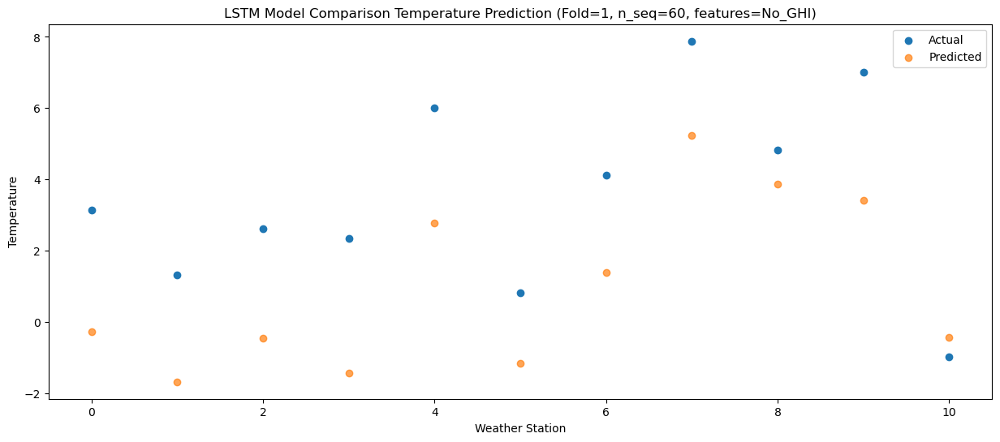

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78   1.665502
1                 1    2.10   0.266965
2                 2    4.04   1.500671
3                 3    6.18   0.530339
4                 4    9.83   4.731351
5                 5    5.89   0.814110
6                 6    4.80   3.335165
7                 7   10.71   7.207922
8                 8    9.26   5.848890
9                 9   10.73   5.379822
10               10    0.15   1.540693


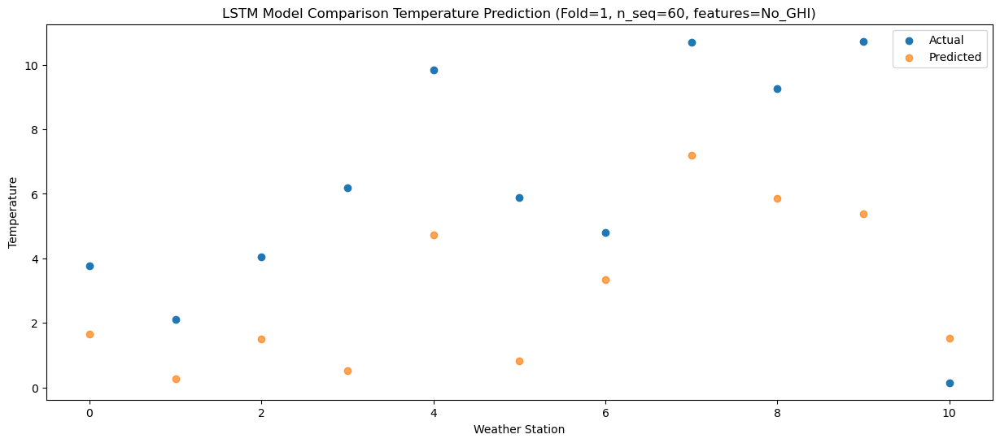

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28   9.027411
1                 1    5.37   7.630478
2                 2    6.73   8.861992
3                 3    7.02   7.887838
4                 4   10.79  12.083134
5                 5    9.05   8.160266
6                 6    8.06  10.690561
7                 7   15.11  14.564529
8                 8   13.59  13.202660
9                 9   16.08  12.728876
10               10    7.37   8.904893


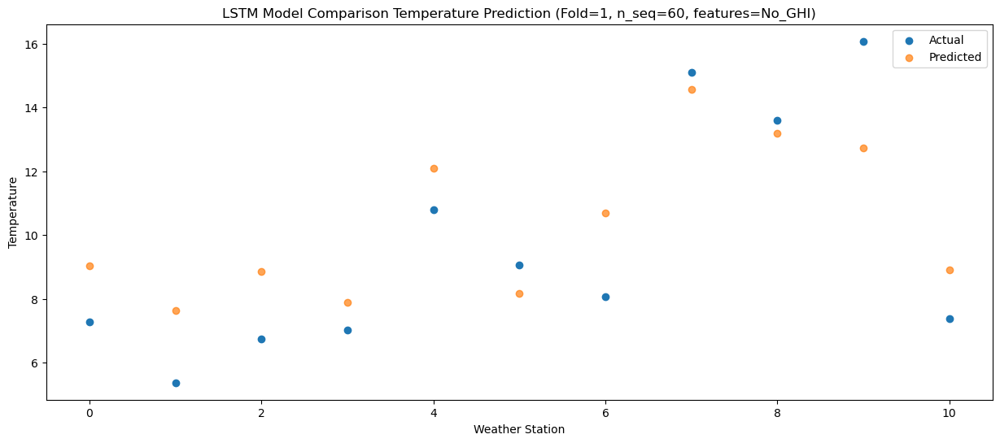

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78  13.331908
1                 1    8.65  11.934025
2                 2    9.97  13.163711
3                 3   11.61  12.195017
4                 4   15.43  16.393507
5                 5   13.66  12.474495
6                 6   11.06  14.996346
7                 7   20.46  18.875498
8                 8   19.28  17.517842
9                 9   21.19  17.047997
10               10    9.93  13.210726


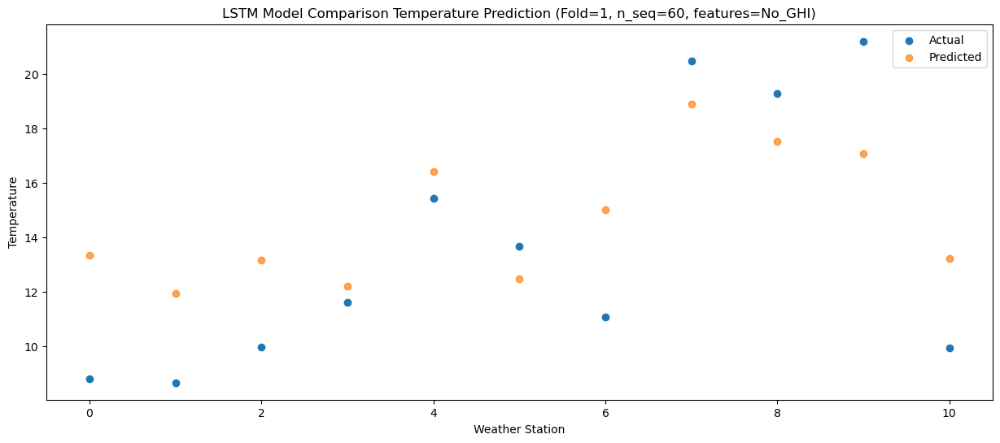

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  17.483324
1                 1   11.84  16.084555
2                 2   13.72  17.314722
3                 3   15.76  16.348787
4                 4   20.32  20.549045
5                 5   20.35  16.625627
6                 6   14.34  19.144335
7                 7   24.27  23.024429
8                 8   24.21  21.667256
9                 9   24.42  21.198123
10               10   14.30  17.359415


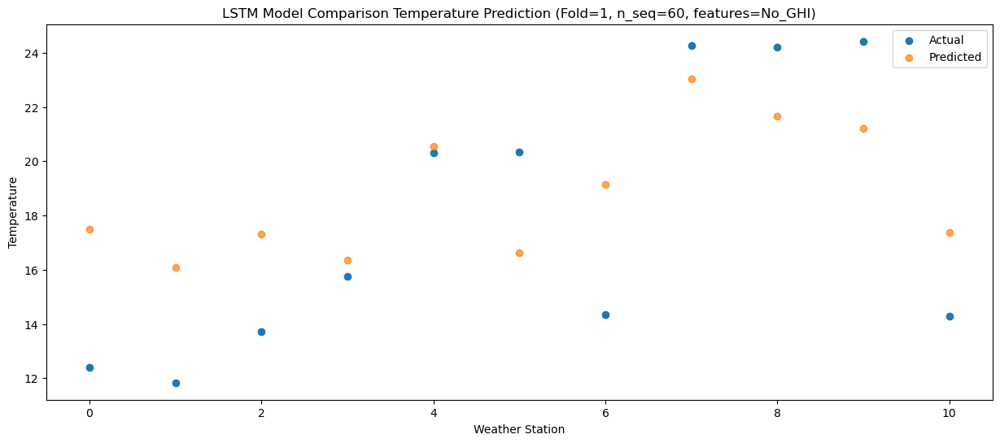

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  20.778432
1                 1   15.44  19.379259
2                 2   16.09  20.605334
3                 3   17.48  19.638528
4                 4   22.27  23.839409
5                 5   21.45  19.916423
6                 6   17.79  22.437390
7                 7   26.57  26.317656
8                 8   27.09  24.959511
9                 9   29.04  24.489158
10               10   19.44  20.646212


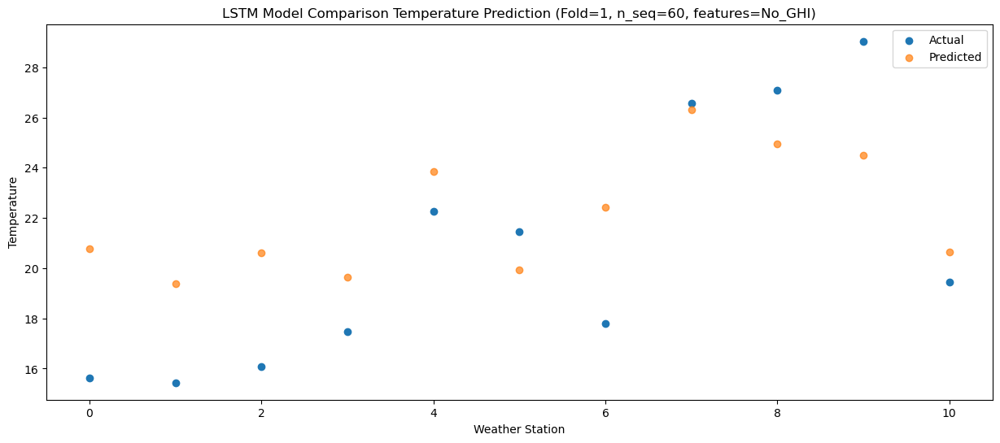

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  19.458942
1                 1   14.90  18.062343
2                 2   16.53  19.289142
3                 3   19.45  18.319797
4                 4   23.70  22.518866
5                 5   20.64  18.593282
6                 6   17.37  21.115923
7                 7   27.07  24.994335
8                 8   28.90  23.631696
9                 9   29.44  23.156866
10               10   17.70  19.310844


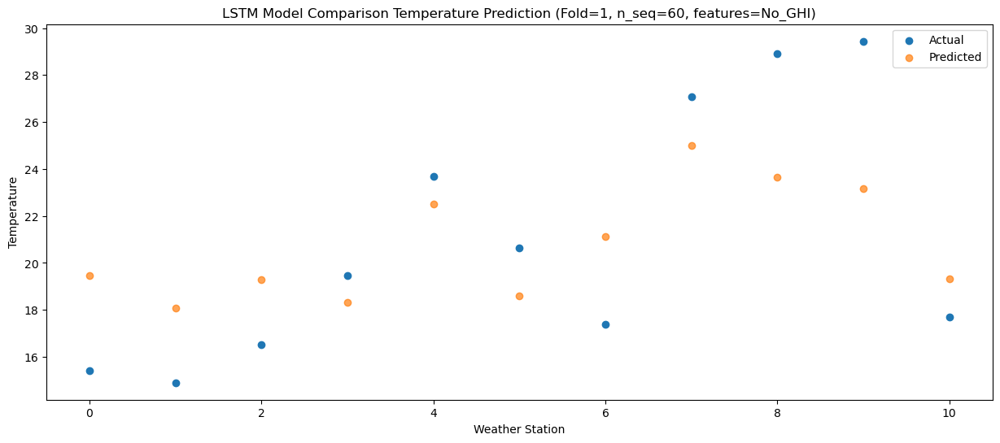

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73  16.416474
1                 1   11.39  15.019334
2                 2   13.57  16.241677
3                 3   16.37  15.271385
4                 4   19.85  19.468353
5                 5   18.36  15.541430
6                 6   14.20  18.066784
7                 7   23.45  21.945670
8                 8   24.26  20.578605
9                 9   25.92  20.102226
10               10   14.51  16.258139


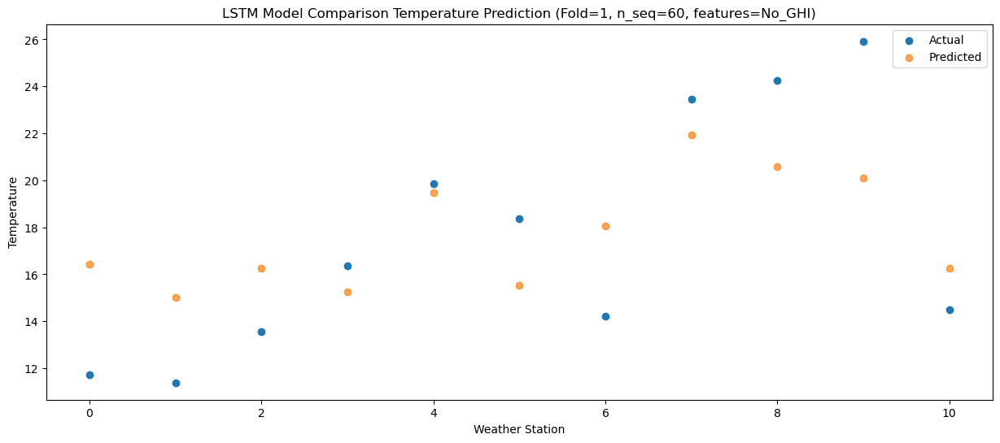

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85   9.896744
1                 1    6.38   8.501829
2                 2    7.53   9.723988
3                 3    9.11   8.747215
4                 4   12.45  12.940078
5                 5   10.76   9.003526
6                 6    9.19  11.542923
7                 7   17.14  15.417646
8                 8   15.68  14.045343
9                 9   17.82  13.566575
10               10    9.16   9.732587


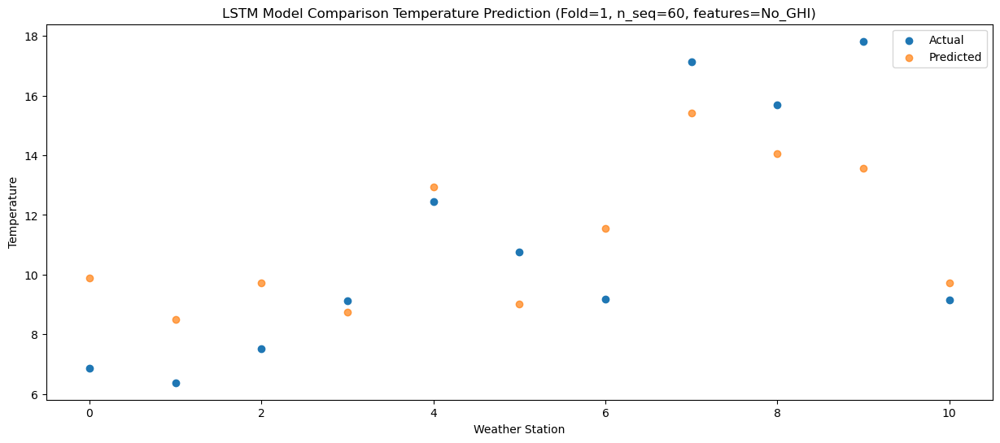

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70   2.566352
1                 1    0.76   1.171031
2                 2    0.97   2.397588
3                 3    2.83   1.420501
4                 4    6.25   5.612460
5                 5    4.10   1.678700
6                 6    3.50   4.211760
7                 7    9.74   8.089838
8                 8    8.56   6.723240
9                 9   11.07   6.246190
10               10    1.22   2.405558


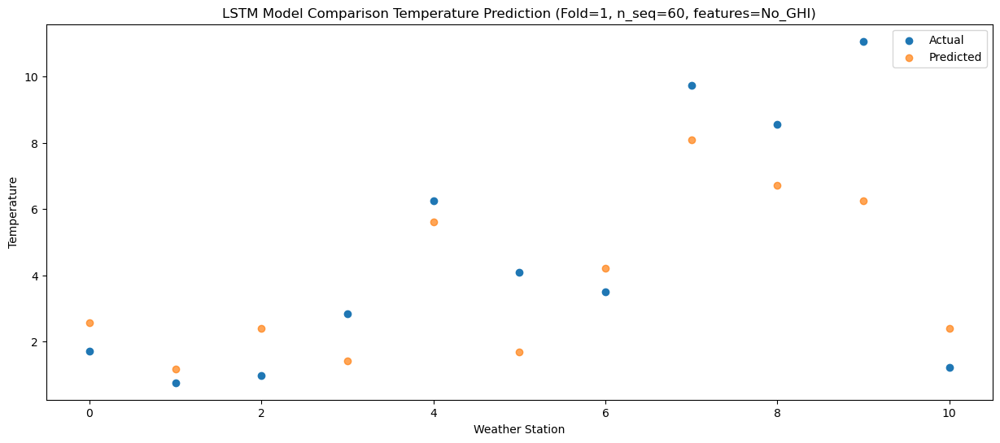

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33   1.048443
1                 1   -2.38  -0.349843
2                 2   -1.81   0.871418
3                 3    0.43  -0.108106
4                 4    4.35   4.086008
5                 5    1.74   0.152567
6                 6    0.76   2.689405
7                 7    6.82   6.563970
8                 8    5.71   5.202227
9                 9    7.24   4.726553
10               10   -0.47   0.884343


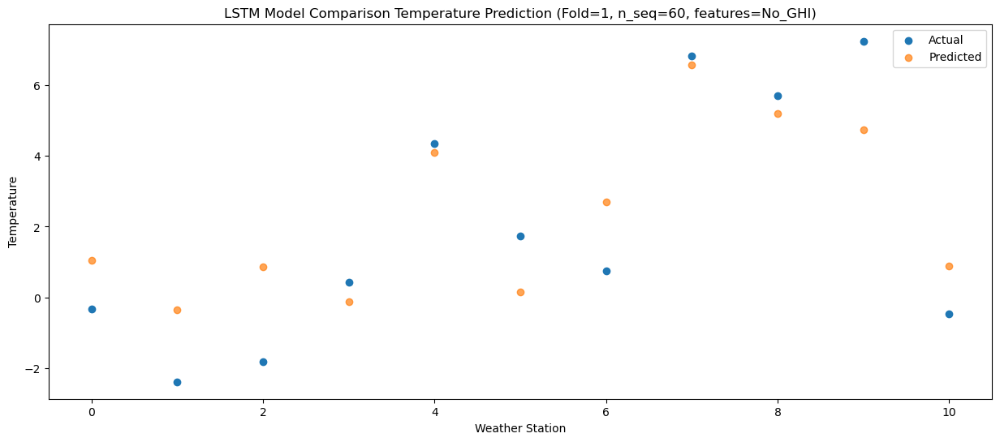

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -3.366645
1                 1   -5.66  -4.765949
2                 2   -4.89  -3.543987
3                 3   -2.99  -4.521641
4                 4    0.50  -0.326343
5                 5   -1.87  -4.258096
6                 6   -2.24  -1.726354
7                 7    0.89   2.148309
8                 8   -0.12   0.787749
9                 9    2.07   0.311540
10               10   -4.37  -3.531073


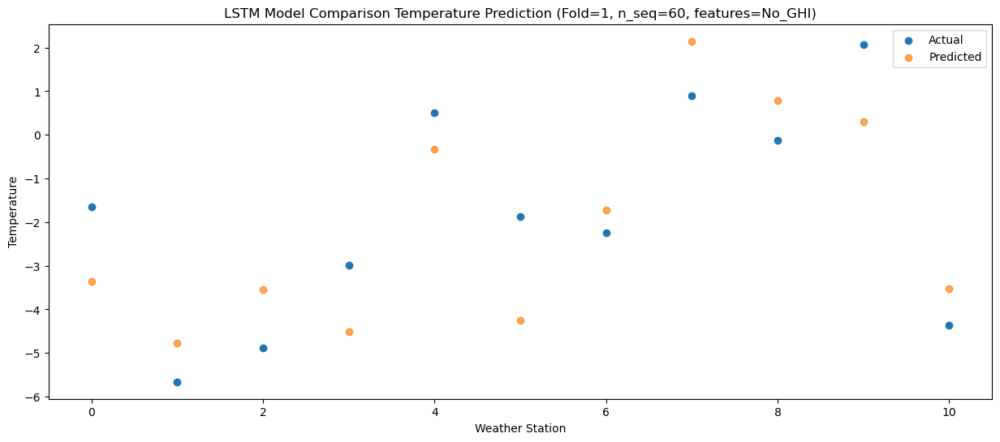

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27   0.378048
1                 1   -0.58  -1.019186
2                 2    0.45   0.199949
3                 3    3.32  -0.780823
4                 4    6.87   3.417121
5                 5    4.25  -0.513178
6                 6    1.97   2.025399
7                 7    9.89   5.901702
8                 8    7.83   4.542045
9                 9    9.78   4.062420
10               10   -2.42   0.223025


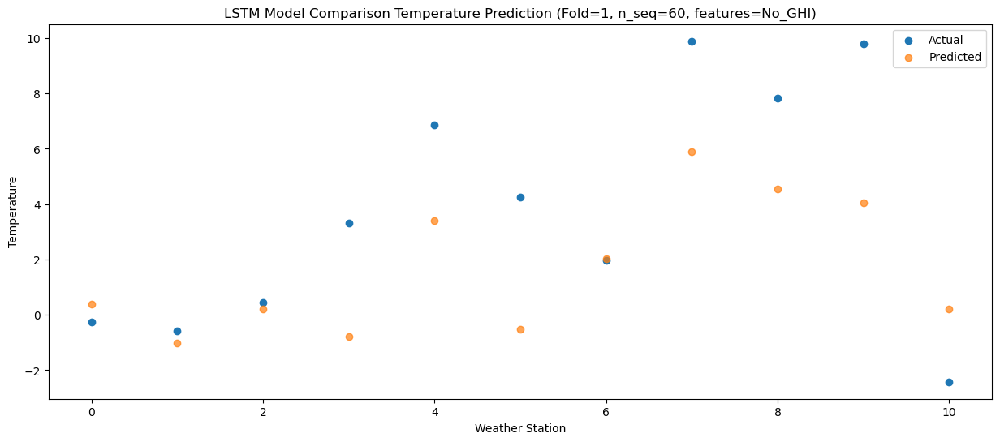

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58   3.973608
1                 1    2.64   2.574272
2                 2    3.55   3.791512
3                 3    5.83   2.806056
4                 4    9.61   7.002243
5                 5    6.60   3.064539
6                 6    5.63   5.612734
7                 7   12.61   9.480219
8                 8   11.07   8.114509
9                 9   12.61   7.634733
10               10    1.98   3.806796


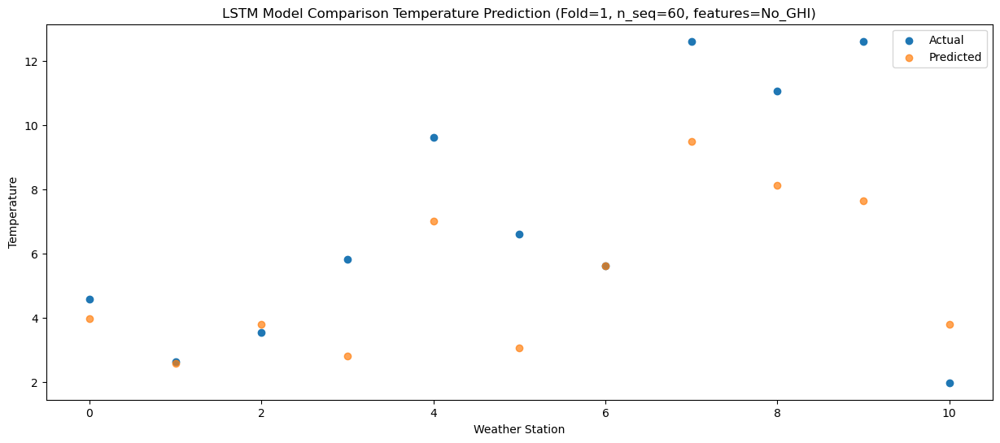

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98   8.828888
1                 1    6.31   7.428617
2                 2    6.89   8.646605
3                 3    9.31   7.668807
4                 4   13.17  11.867524
5                 5   11.40   7.931609
6                 6    9.10  10.478524
7                 7   16.65  14.347804
8                 8   15.75  12.985356
9                 9   17.68  12.508945
10               10    6.37   8.675874


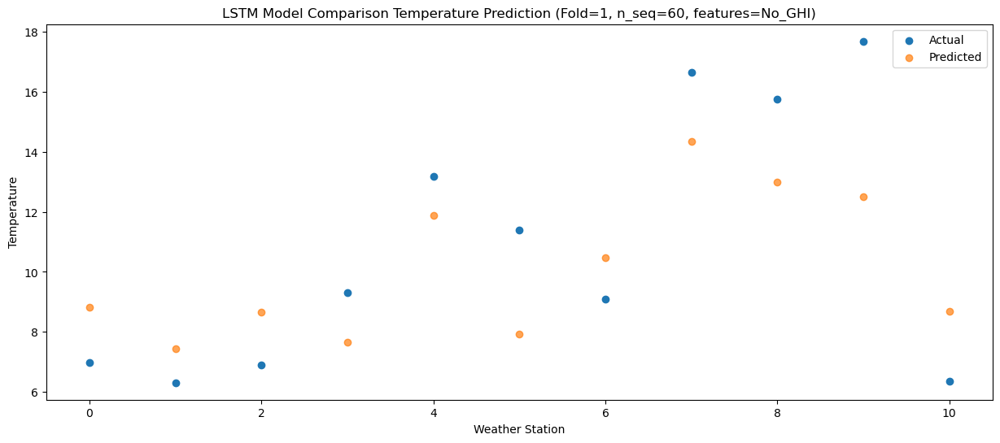

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  14.399693
1                 1   10.88  12.999211
2                 2   12.50  14.214770
3                 3   13.01  13.233095
4                 4   16.87  17.432749
5                 5   17.02  13.504275
6                 6   13.34  16.053282
7                 7   22.19  19.922885
8                 8   20.51  18.564505
9                 9   21.82  18.089621
10               10   11.96  14.263160


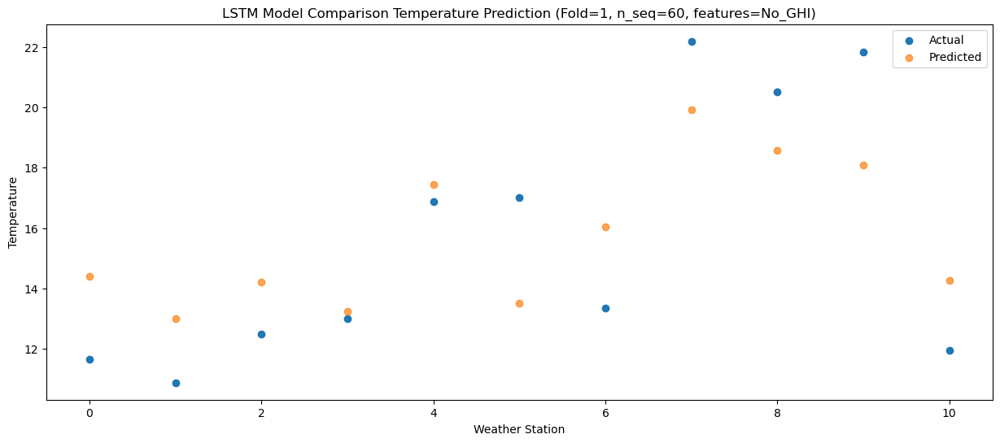

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  19.293119
1                 1   14.64  17.891917
2                 2   15.61  19.107922
3                 3   15.64  18.130609
4                 4   19.76  22.329707
5                 5   19.88  18.398009
6                 6   17.27  20.947937
7                 7   25.26  24.823657
8                 8   26.21  23.465240
9                 9   28.23  22.992808
10               10   18.07  19.163292


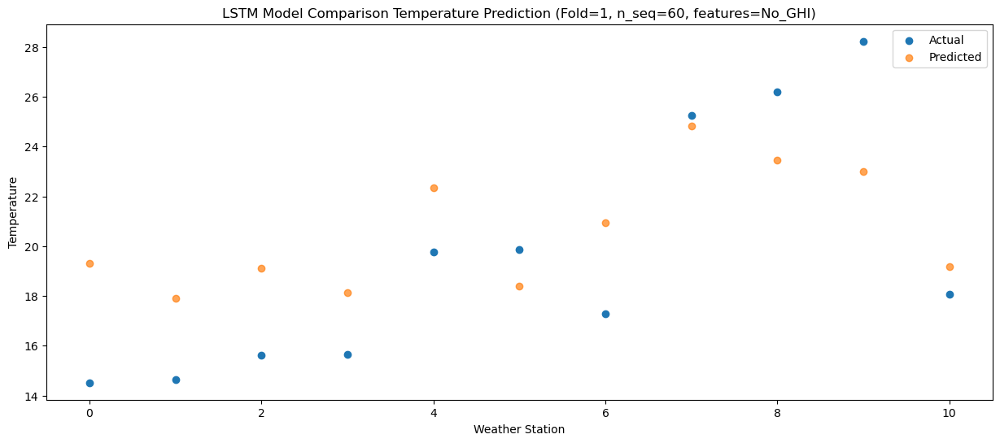

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  20.923401
1                 1   15.57  19.520672
2                 2   15.63  20.735141
3                 3   15.03  19.761679
4                 4   19.57  23.962045
5                 5   18.88  20.035167
6                 6   18.30  22.584009
7                 7   25.90  26.456629
8                 8   27.06  25.100059
9                 9   28.96  24.634570
10               10   20.00  20.797597


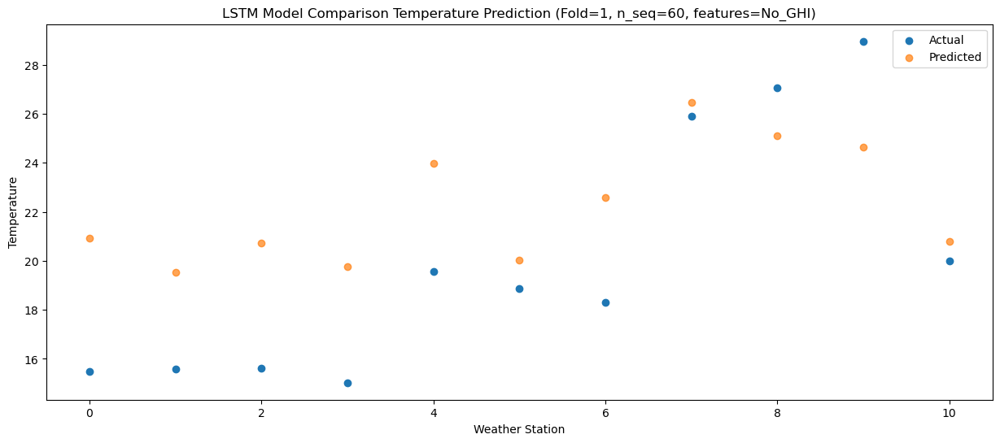

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  19.621054
1                 1   15.29  18.222770
2                 2   15.94  19.438727
3                 3   16.16  18.470802
4                 4   20.89  22.671604
5                 5   20.48  18.743899
6                 6   17.97  21.293516
7                 7   26.31  25.165223
8                 8   29.17  23.806997
9                 9   29.76  23.342887
10               10   17.85  19.495322


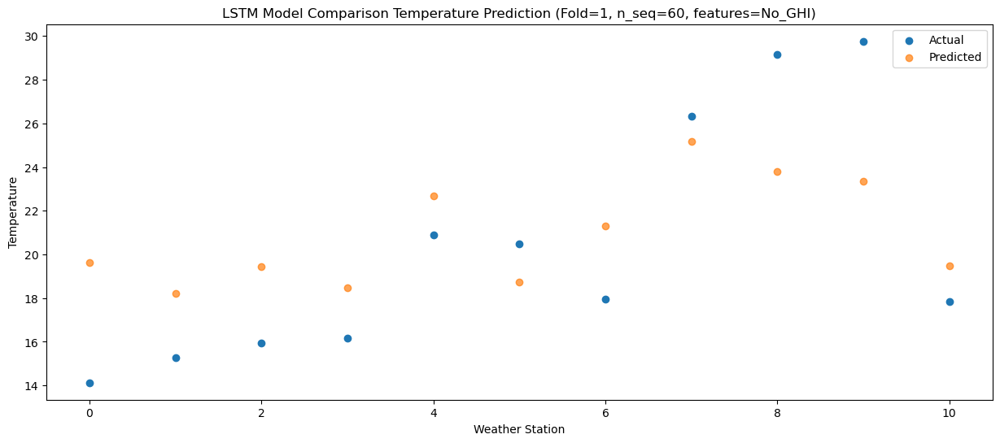

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  16.592935
1                 1   11.57  15.195956
2                 2   13.63  16.413747
3                 3   13.56  15.452486
4                 4   17.60  19.656451
5                 5   14.77  15.729480
6                 6   14.67  18.279690
7                 7   24.44  22.149661
8                 8   23.20  20.794348
9                 9   25.20  20.332640
10               10   14.12  16.473686


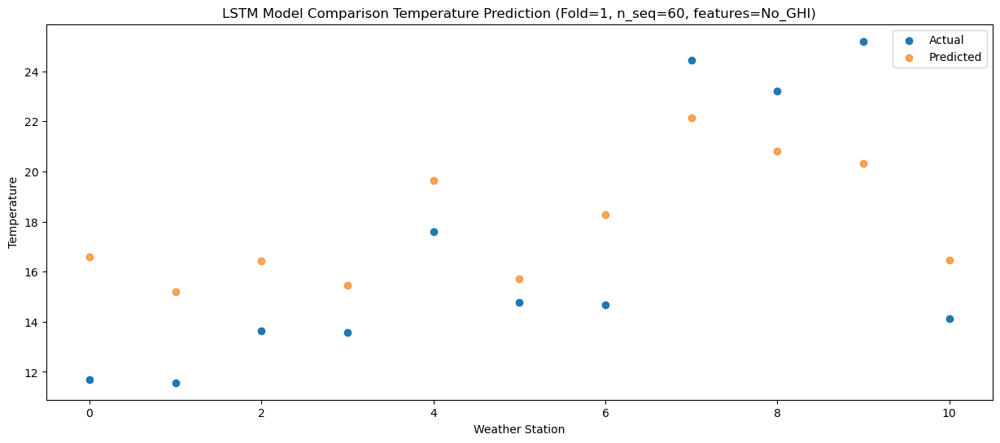

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81  10.764940
1                 1    7.12   9.367524
2                 2    8.63  10.589365
3                 3   10.87   9.634657
4                 4   14.45  13.842878
5                 5   13.62   9.916883
6                 6    9.87  12.462793
7                 7   18.97  16.338140
8                 8   19.34  14.983354
9                 9   20.35  14.521421
10               10    9.25  10.653733


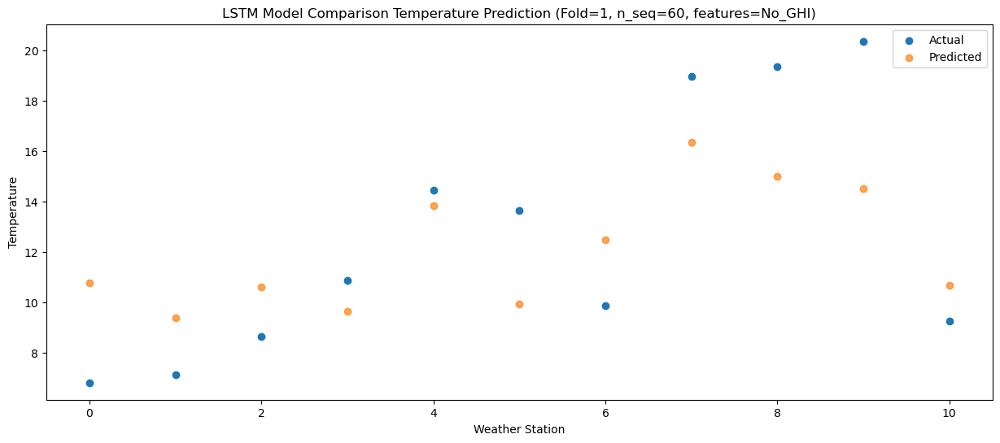

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_12 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_12 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_13 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_13 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_18 (Dense)            (1, 256)                  262400    
                                                                 
 dense_19 (Dense)            (1, 128)                  32896     
                                                                 
 dense_20 (Dense)            (1, 60)                  

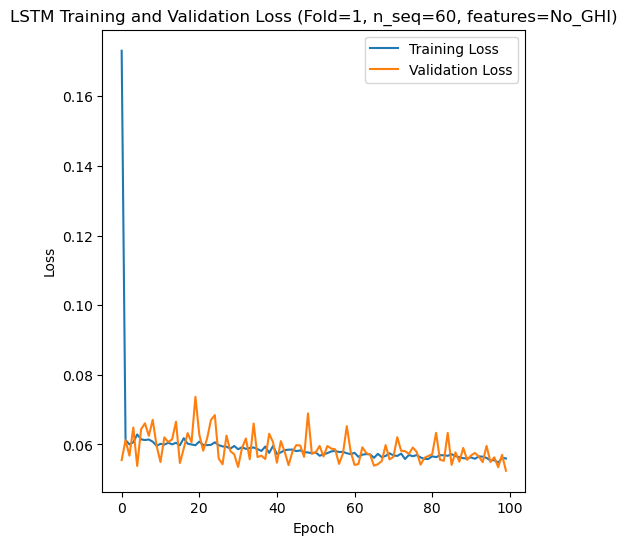

Epoch 1/100
84/84 [==============================] - 9s 54ms/step - loss: 0.1814 - accuracy: 0.3929 - mae: 0.1462 - rmse: 0.1814 - mape: inf - pearson: 0.6016 - val_loss: 0.0537 - val_accuracy: 0.6000 - val_mae: 0.0431 - val_rmse: 0.0537 - val_mape: 9.5282 - val_pearson: 0.8826
Epoch 2/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0607 - accuracy: 0.5119 - mae: 0.0479 - rmse: 0.0607 - mape: inf - pearson: 0.8368 - val_loss: 0.0529 - val_accuracy: 0.6000 - val_mae: 0.0428 - val_rmse: 0.0529 - val_mape: 10.0612 - val_pearson: 0.9208
Epoch 3/100
84/84 [==============================] - 3s 41ms/step - loss: 0.0597 - accuracy: 0.5119 - mae: 0.0470 - rmse: 0.0597 - mape: inf - pearson: 0.8433 - val_loss: 0.0421 - val_accuracy: 0.6000 - val_mae: 0.0328 - val_rmse: 0.0421 - val_mape: 7.2992 - val_pearson: 0.9242
Epoch 4/100
84/84 [==============================] - 3s 40ms/step - loss: 0.0605 - accuracy: 0.5595 - mae: 0.0477 - rmse: 0.0605 - mape: inf - pearson: 0.8402 - v

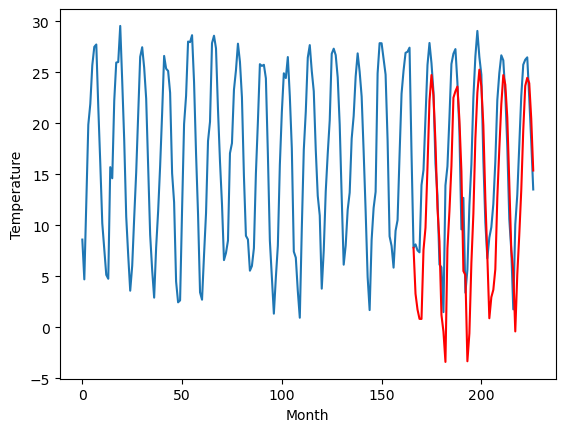

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.57		-2.07		-3.64
-0.71		-3.61		-2.90
-0.95		-4.53		-3.58
-1.68		-4.54		-2.86
6.33		2.23		-4.10
8.56		4.40		-4.16
15.36		10.34		-5.02
22.56		16.83		-5.73
22.59		19.38		-3.21
21.26		17.36		-3.90
15.13		12.77		-2.36
8.14		6.33		-1.81
5.02		3.06		-1.96
-1.61		-4.15		-2.54
-1.69		-5.77		-4.08
-5.73		-8.75		-3.02
4.46		2.38		-2.08
8.22		6.03		-2.19
13.40		10.46		-2.94
20.65		17.15		-3.50
21.34		17.79		-3.55
22.10		18.25		-3.85
19.86		14.99		-4.87
11.60		9.96		-1.64
4.89		0.17		-4.72
2.50		-0.23		-2.73
-2.19		-8.68		-6.49
-2.20		-5.95		-3.75
4.78		0.94		-3.84
11.46		5.78		-5.68
17.26		13.12		-4.14
21.06		17.62		-3.44
24.30		19.90		-4.40
21.99		18.25		-3.74
19.23		14.43		-4.80
10.85		7.21		-3.64
0.86		1.55		0.69
-1.85		-4.50		-2.65
-2.10		-2.44		-0.34
-0.50		-1.72		-1.22
3.57		0.30		-3.27
9.43		7.30		-2.13
14.92		12.09		-2.83
17.53		16.44		-1.09
21.63		19.30		-2.33
22.12		18.37		-3.75
19.25		15.13	

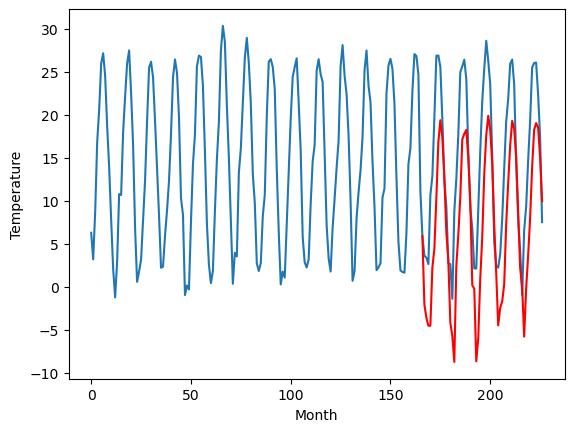

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.66		3.20		-2.46
4.54		1.66		-2.88
3.39		0.75		-2.64
4.43		0.75		-3.68
8.05		7.52		-0.53
9.44		9.68		0.24
10.75		15.63		4.88
13.34		22.12		8.78
13.98		24.67		10.69
13.67		22.65		8.98
12.41		18.05		5.64
11.14		11.62		0.48
7.72		8.36		0.64
0.73		1.15		0.42
1.39		-0.47		-1.86
4.12		-3.44		-7.56
5.93		7.69		1.76
7.74		11.34		3.60
11.32		15.77		4.45
12.54		22.46		9.92
13.33		23.09		9.76
13.38		23.56		10.18
12.10		20.29		8.19
10.96		15.27		4.31
4.11		5.49		1.38
5.01		5.09		0.08
0.75		-3.37		-4.12
3.08		-0.63		-3.71
6.55		6.27		-0.28
8.36		11.11		2.75
11.12		18.45		7.33
12.93		22.95		10.02
13.11		25.22		12.11
12.54		23.57		11.03
11.13		19.75		8.62
8.50		12.54		4.04
6.74		6.88		0.14
2.64		0.85		-1.79
2.44		2.90		0.46
5.50		3.62		-1.88
6.52		5.63		-0.89
9.06		12.63		3.57
10.04		17.41		7.37
12.45		21.75		9.30
14.36		24.62		10.26
14.54		23.68		9.14
12.59		20.44		7.85
9.01		14.08		5.07
5.03		7.49		2.46


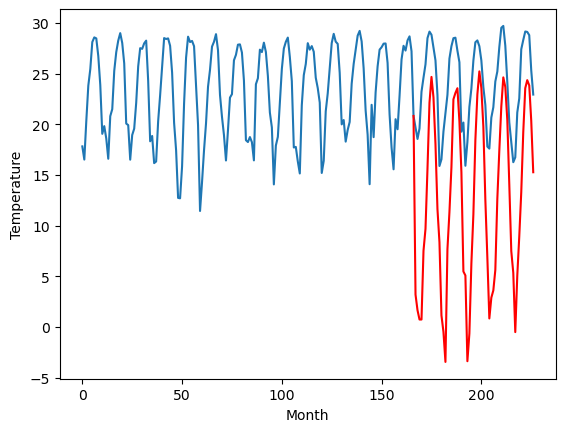

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.01		-0.26		-0.25
-3.07		-1.80		1.27
-2.80		-2.72		0.08
-2.65		-2.71		-0.06
0.90		4.06		3.16
2.13		6.23		4.10
8.02		12.19		4.17
14.08		18.68		4.60
18.36		21.24		2.88
16.51		19.21		2.70
11.93		14.62		2.69
6.71		8.19		1.48
2.75		4.94		2.19
-4.08		-2.27		1.81
-7.16		-3.89		3.27
-7.14		-6.86		0.28
-3.03		4.27		7.30
1.47		7.92		6.45
6.73		12.35		5.62
12.30		19.05		6.75
14.30		19.68		5.38
15.36		20.15		4.79
12.19		16.89		4.70
8.36		11.87		3.51
0.28		2.08		1.80
-1.64		1.69		3.33
-7.79		-6.76		1.03
-5.47		-4.02		1.45
-1.61		2.88		4.49
2.83		7.72		4.89
8.17		15.07		6.90
12.41		19.56		7.15
17.03		21.83		4.80
16.95		20.19		3.24
11.91		16.37		4.46
6.47		9.16		2.69
2.67		3.50		0.83
-3.50		-2.54		0.96
-2.21		-0.48		1.73
-4.09		0.24		4.33
-1.65		2.25		3.90
4.07		9.25		5.18
7.70		14.03		6.33
11.49		18.38		6.89
17.06		21.26		4.20
15.05		20.32		5.27
12.63		17.08		4.45
7.61		10.72		3.11
-0.37		4.13		4.50
-1.1

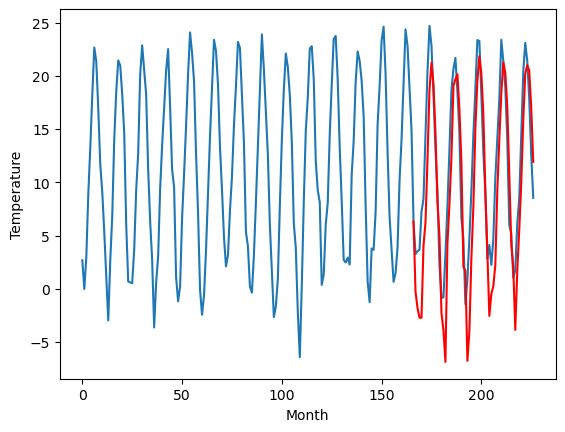

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.32		-0.23		0.09
0.03		-1.77		-1.80
0.37		-2.68		-3.05
1.01		-2.69		-3.70
7.70		4.09		-3.61
7.17		6.25		-0.92
10.14		12.20		2.06
13.18		18.69		5.51
13.92		21.24		7.32
14.29		19.22		4.93
11.94		14.63		2.69
8.25		8.20		-0.05
4.13		4.94		0.81
-2.17		-2.27		-0.10
-1.82		-3.89		-2.07
-2.56		-6.85		-4.29
4.77		4.28		-0.49
5.64		7.93		2.29
10.11		12.36		2.25
13.59		19.05		5.46
14.18		19.68		5.50
14.35		20.14		5.79
11.81		16.88		5.07
9.07		11.86		2.79
0.80		2.07		1.27
4.21		1.68		-2.53
-3.52		-6.77		-3.25
-0.38		-4.03		-3.65
3.38		2.87		-0.51
7.18		7.70		0.52
12.34		15.06		2.72
14.93		19.55		4.62
14.76		21.81		7.05
13.94		20.17		6.23
11.97		16.36		4.39
5.78		9.16		3.38
2.71		3.50		0.79
0.20		-2.54		-2.74
1.37		-0.48		-1.85
3.50		0.23		-3.27
5.33		2.24		-3.09
7.25		9.23		1.98
11.28		14.01		2.73
14.93		18.36		3.43
16.37		21.23		4.86
17.67		20.29		2.62
13.24		17.05		3.81
7.08		10.69		3.61
1.97		4.10		

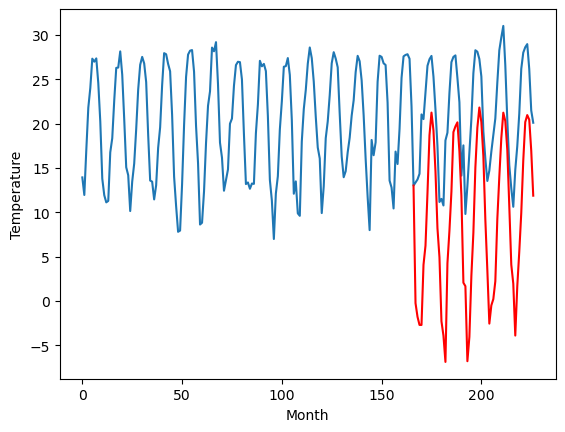

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.39		-2.55		-2.16
-1.82		-4.09		-2.27
-1.45		-5.01		-3.56
-2.21		-5.01		-2.80
5.88		1.76		-4.12
5.85		3.92		-1.93
9.69		9.87		0.18
13.30		16.35		3.05
15.00		18.91		3.91
15.30		16.89		1.59
10.90		12.29		1.39
6.43		5.86		-0.57
3.75		2.60		-1.15
-2.36		-4.62		-2.26
-2.95		-6.24		-3.29
-5.30		-9.21		-3.91
3.08		1.92		-1.16
5.20		5.57		0.37
9.24		10.00		0.76
13.79		16.68		2.89
13.87		17.33		3.46
14.98		17.78		2.80
12.24		14.52		2.28
8.94		9.49		0.55
1.30		-0.29		-1.59
4.54		-0.68		-5.22
-3.89		-9.14		-5.25
-4.27		-6.40		-2.13
1.85		0.49		-1.36
8.00		5.32		-2.68
12.60		12.67		0.07
16.32		17.16		0.84
17.68		19.43		1.75
14.96		17.79		2.83
12.30		13.98		1.68
6.73		6.78		0.05
0.85		1.12		0.27
-1.38		-4.90		-3.52
-0.62		-2.85		-2.23
0.57		-2.13		-2.70
4.37		-0.12		-4.49
5.29		6.87		1.58
10.37		11.65		1.28
15.29		16.00		0.71
17.45		18.87		1.42
19.15		17.93		-1.22
14.67		14.68		0.01
6.78		8.32		1.54
0.5

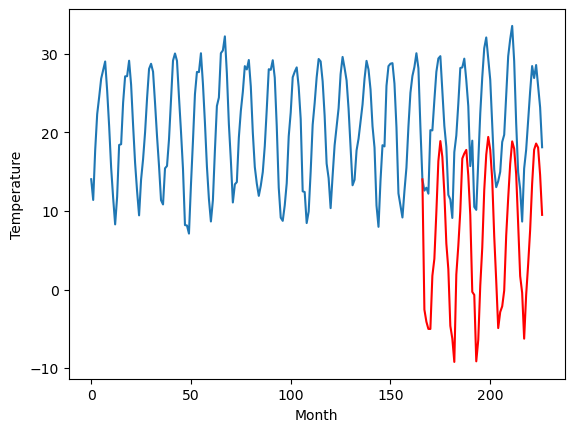

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
10.42		8.99		-1.43
8.61		7.45		-1.16
8.96		6.54		-2.42
8.40		6.53		-1.87
16.05		13.31		-2.74
16.36		15.46		-0.90
21.26		21.42		0.16
26.00		27.90		1.90
27.18		30.45		3.27
27.41		28.43		1.02
21.47		23.84		2.37
15.99		17.41		1.42
13.50		14.14		0.64
7.04		6.92		-0.12
6.34		5.30		-1.04
3.23		2.33		-0.90
13.60		13.46		-0.14
15.30		17.11		1.81
19.38		21.55		2.17
24.94		28.24		3.30
25.83		28.88		3.05
26.39		29.34		2.95
24.12		26.07		1.95
19.61		21.05		1.44
11.64		11.26		-0.38
13.93		10.87		-3.06
5.45		2.41		-3.04
5.28		5.14		-0.14
11.86		12.04		0.18
18.13		16.87		-1.26
23.15		24.22		1.07
27.86		28.71		0.85
30.65		30.99		0.34
27.84		29.34		1.50
24.01		25.53		1.52
17.63		18.33		0.70
10.96		12.67		1.71
8.34		6.65		-1.69
9.22		8.69		-0.53
9.41		9.42		0.01
14.06		11.43		-2.63
15.88		18.43		2.55
21.62		23.21		1.59
25.77		27.56		1.79
28.33		30.44		2.11
30.67		29.49		-1.18
25.89		26.25		0.36
17.17		19.88		2.

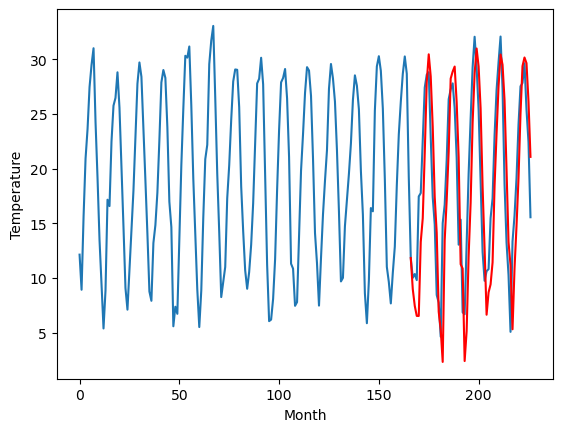

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.43		-6.15		-2.72
-7.96		-7.70		0.26
-6.71		-8.62		-1.91
-5.90		-8.63		-2.73
-1.40		-1.85		-0.45
3.58		0.31		-3.27
9.87		6.26		-3.61
13.39		12.74		-0.65
15.49		15.30		-0.19
15.93		13.28		-2.65
9.68		8.69		-0.99
4.08		2.25		-1.83
-1.48		-1.01		0.47
-9.13		-8.23		0.90
-8.59		-9.85		-1.26
-5.67		-12.82		-7.15
-2.57		-1.70		0.87
4.09		1.95		-2.14
9.10		6.39		-2.71
14.09		13.08		-1.01
12.89		13.72		0.83
12.37		14.17		1.80
10.19		10.91		0.72
3.63		5.88		2.25
-1.77		-3.90		-2.13
-5.12		-4.30		0.82
-8.12		-12.75		-4.63
-7.15		-10.02		-2.87
-2.09		-3.14		-1.05
5.10		1.70		-3.40
9.80		9.05		-0.75
13.66		13.54		-0.12
14.80		15.81		1.01
11.78		14.16		2.38
10.05		10.34		0.29
1.84		3.14		1.30
-5.05		-2.53		2.52
-7.22		-8.56		-1.34
-7.93		-6.51		1.42
-6.72		-5.79		0.93
-2.02		-3.78		-1.76
3.62		3.22		-0.40
8.27		7.99		-0.28
12.93		12.34		-0.59
17.68		15.22		-2.46
14.68		14.28		-0.40
12.02		11.03		-0.99
5.

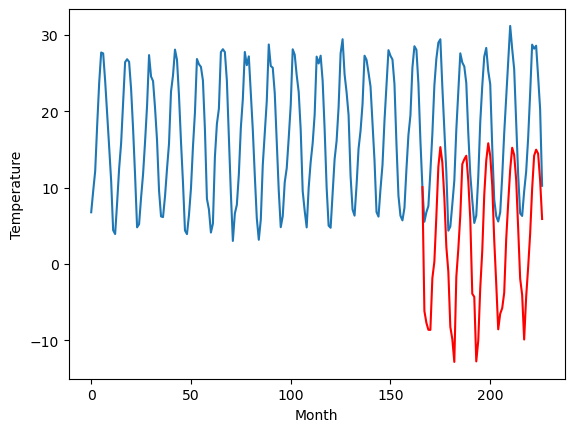

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.34		5.11		-4.23
5.80		3.56		-2.24
6.34		2.65		-3.69
8.45		2.63		-5.82
8.52		9.40		0.88
11.73		11.57		-0.16
15.78		17.52		1.74
17.07		24.01		6.94
19.48		26.57		7.09
21.88		24.55		2.67
20.28		19.95		-0.33
17.04		13.53		-3.51
10.32		10.27		-0.05
8.27		3.05		-5.22
8.21		1.43		-6.78
7.29		-1.54		-8.83
6.89		9.57		2.68
10.75		13.23		2.48
12.97		17.67		4.70
17.21		24.37		7.16
20.19		25.00		4.81
19.79		25.46		5.67
18.01		22.19		4.18
13.03		17.17		4.14
11.77		7.39		-4.38
5.26		6.99		1.73
7.67		-1.45		-9.12
8.54		1.27		-7.27
10.33		8.16		-2.17
12.45		12.99		0.54
13.41		20.33		6.92
18.33		24.82		6.49
19.14		27.09		7.95
21.18		25.44		4.26
20.77		21.61		0.84
14.50		14.41		-0.09
8.27		8.73		0.46
5.57		2.71		-2.86
5.23		4.75		-0.48
4.91		5.47		0.56
5.92		7.49		1.57
9.76		14.48		4.72
10.97		19.26		8.29
12.93		23.60		10.67
19.85		26.48		6.63
19.48		25.53		6.05
15.98		22.29		6.31
14.39		15.93		1.54
10.00		9.

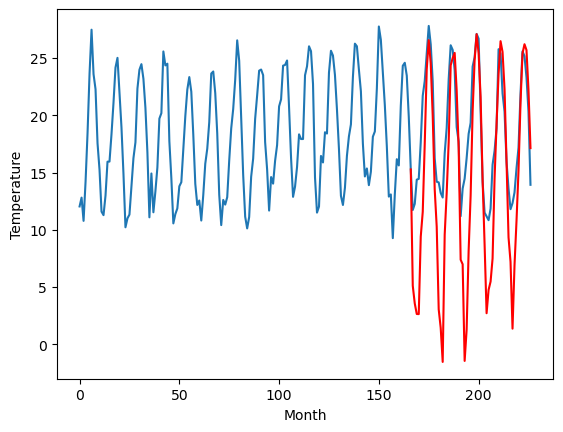

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		5.22		1.17
3.64		3.68		0.04
3.35		2.77		-0.58
4.39		2.76		-1.63
9.62		9.53		-0.09
10.92		11.70		0.78
13.52		17.65		4.13
18.81		24.14		5.33
21.80		26.69		4.89
20.80		24.67		3.87
16.77		20.08		3.31
12.85		13.65		0.80
8.24		10.39		2.15
1.24		3.17		1.93
0.83		1.56		0.73
1.33		-1.41		-2.74
8.21		9.71		1.50
11.00		13.37		2.37
15.02		17.80		2.78
19.31		24.50		5.19
20.88		25.14		4.26
20.97		25.59		4.62
16.86		22.33		5.47
13.58		17.31		3.73
4.67		7.52		2.85
6.59		7.13		0.54
0.11		-1.33		-1.44
4.13		1.41		-2.72
8.24		8.30		0.06
11.53		13.13		1.60
16.38		20.48		4.10
20.14		24.97		4.83
21.58		27.24		5.66
20.20		25.60		5.40
16.89		21.78		4.89
9.58		14.58		5.00
7.46		8.91		1.45
0.93		2.88		1.95
4.13		4.93		0.80
7.15		5.65		-1.50
7.60		7.66		0.06
11.12		14.66		3.54
13.90		19.44		5.54
17.56		23.79		6.23
21.15		26.67		5.52
20.60		25.72		5.12
16.64		22.48		5.84
11.35		16.12		4.77
5.45		9.54		4.09
2.98		

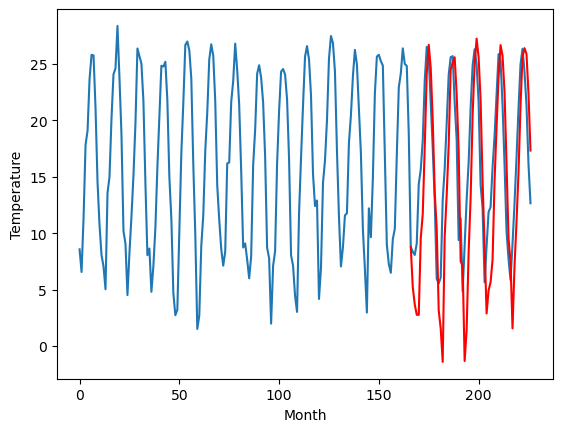

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		3.31		1.66
2.25		1.77		-0.48
1.81		0.86		-0.95
1.61		0.85		-0.76
7.65		7.62		-0.03
8.08		9.78		1.70
12.12		15.74		3.62
17.49		22.22		4.73
20.78		24.78		4.00
19.52		22.75		3.23
15.57		18.16		2.59
10.91		11.73		0.82
5.86		8.47		2.61
-1.20		1.26		2.46
-0.87		-0.36		0.51
0.48		-3.32		-3.80
6.69		7.81		1.12
8.66		11.46		2.80
13.57		15.89		2.32
18.98		22.59		3.61
20.29		23.22		2.93
20.37		23.68		3.31
15.88		20.42		4.54
12.12		15.40		3.28
1.90		5.61		3.71
4.00		5.22		1.22
-2.87		-3.24		-0.37
1.72		-0.50		-2.22
6.27		6.39		0.12
9.43		11.22		1.79
15.67		18.57		2.90
19.32		23.06		3.74
20.67		25.33		4.66
19.42		23.69		4.27
15.27		19.87		4.60
7.99		12.66		4.67
5.54		7.00		1.46
0.08		0.97		0.89
2.00		3.02		1.02
4.79		3.74		-1.05
5.32		5.75		0.43
10.21		12.75		2.54
13.56		17.52		3.96
16.47		21.88		5.41
20.02		24.76		4.74
19.31		23.82		4.51
16.53		20.58		4.05
10.48		14.22		3.74
4.27		7.64		3.37
1.42	

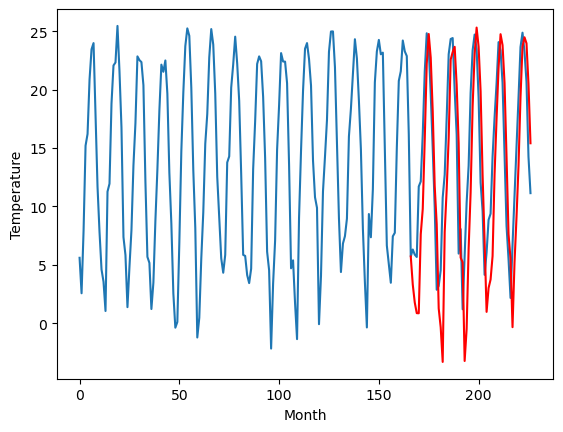

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[3.2977339172363287, -2.0684771347045903, 3.2041311645507804, -0.2623669433593747, -0.2296816253662115, -2.5535447311401365, 8.99061996459961, -6.153611488342285, 5.1104969406127925, 5.222327041625977, 3.3074709320068365]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   3.297734
1                 1    1.57  -2.068477
2                 2    5.66   3.204131
3                 3   -0.01  -0.262367
4                 4   -0.32  -0.229682
5                 5   -0.39  -2.553545
6                 6   10.42   8.990620
7                 7   -3.43  -6.153611
8                 8    9.34   5.110497
9                 9    4.05   5.222327
10               10    1.65   3.307471


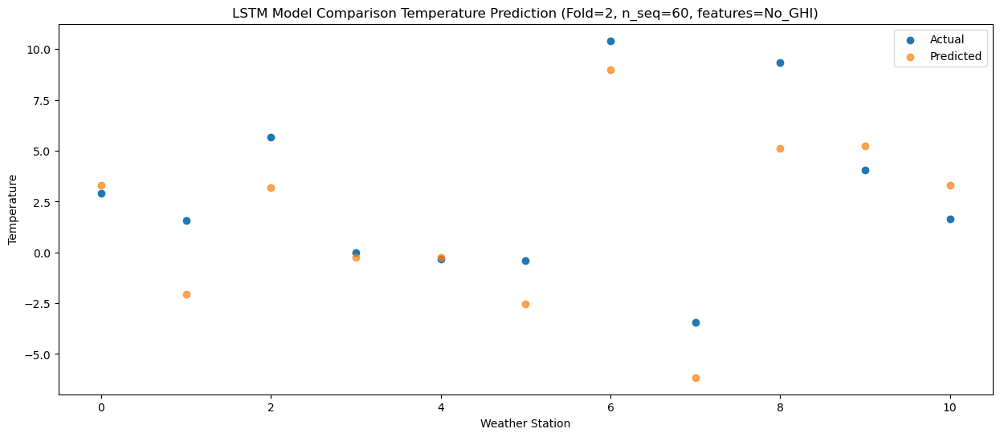

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   1.754232
1                 1   -0.71  -3.611357
2                 2    4.54   1.662724
3                 3   -3.07  -1.797067
4                 4    0.03  -1.768751
5                 5   -1.82  -4.091910
6                 6    8.61   7.454029
7                 7   -7.96  -7.699591
8                 8    5.80   3.564031
9                 9    3.64   3.681133
10               10    2.25   1.766755


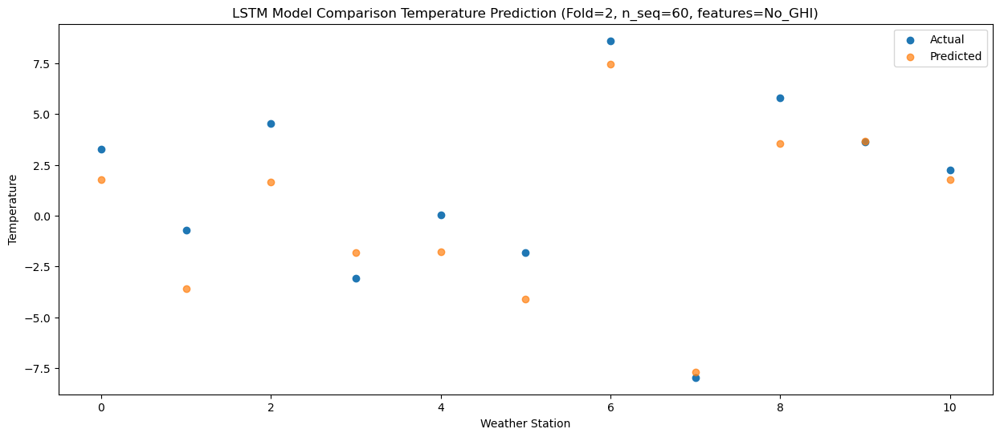

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67   0.839219
1                 1   -0.95  -4.529884
2                 2    3.39   0.746458
3                 3   -2.80  -2.715368
4                 4    0.37  -2.683627
5                 5   -1.45  -5.008844
6                 6    8.96   6.539367
7                 7   -6.71  -8.616280
8                 8    6.34   2.646124
9                 9    3.35   2.767635
10               10    1.81   0.855444


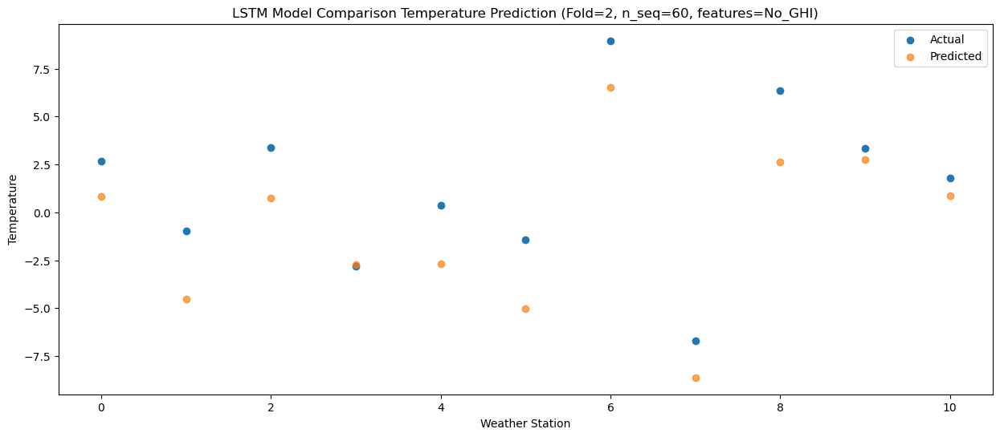

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48   0.831082
1                 1   -1.68  -4.538029
2                 2    4.43   0.745391
3                 3   -2.65  -2.712346
4                 4    1.01  -2.686977
5                 5   -2.21  -5.014556
6                 6    8.40   6.533019
7                 7   -5.90  -8.627260
8                 8    8.45   2.634341
9                 9    4.39   2.762021
10               10    1.61   0.845867


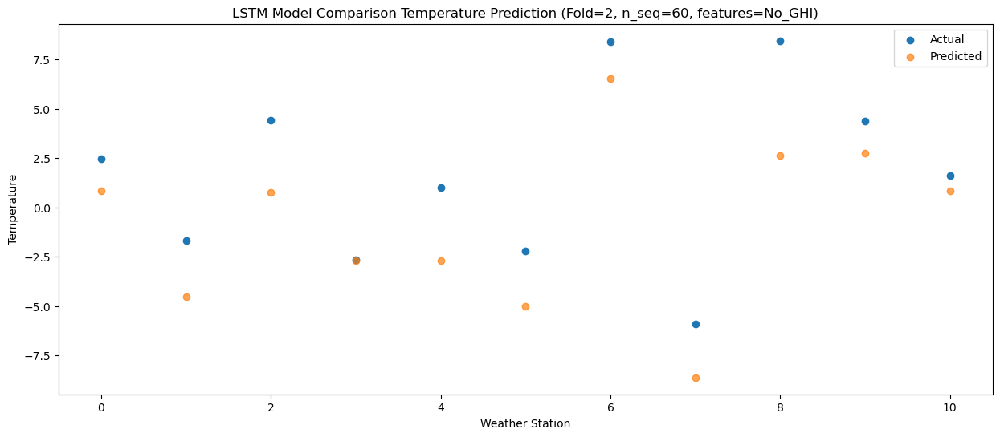

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   7.600671
1                 1    6.33   2.232261
2                 2    8.05   7.522152
3                 3    0.90   4.060339
4                 4    7.70   4.086582
5                 5    5.88   1.758746
6                 6   16.05  13.306913
7                 7   -1.40  -1.854508
8                 8    8.52   9.401395
9                 9    9.62   9.533768
10               10    7.65   7.616761


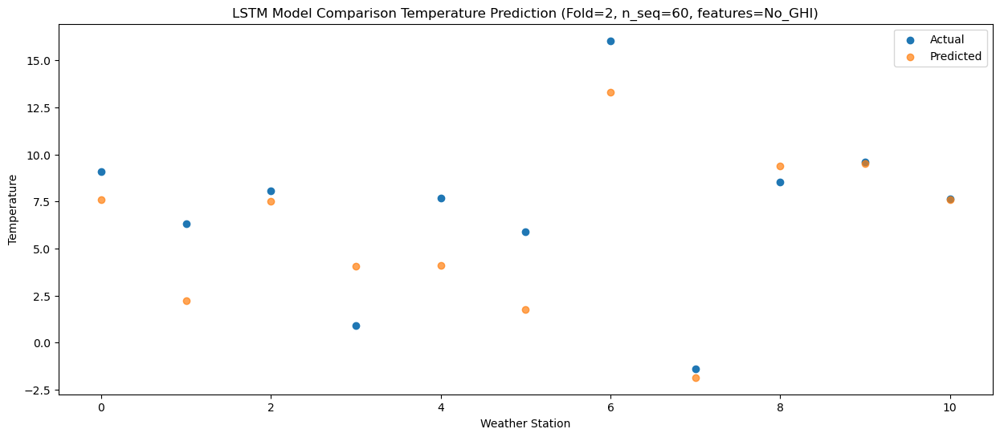

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55   9.764412
1                 1    8.56   4.397785
2                 2    9.44   9.684366
3                 3    2.13   6.225836
4                 4    7.17   6.246801
5                 5    5.85   3.916866
6                 6   16.36  15.463874
7                 7    3.58   0.307558
8                 8   11.73  11.568825
9                 9   10.92  11.695974
10               10    8.08   9.781671


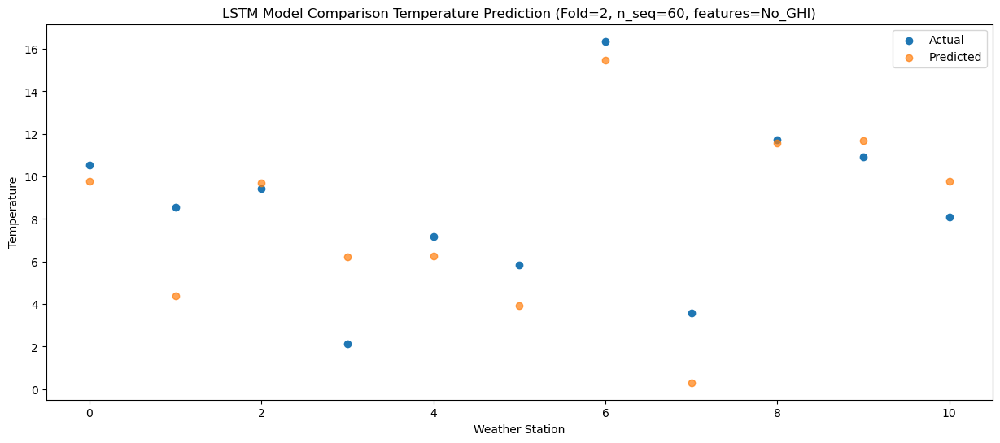

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  15.707764
1                 1   15.36  10.342868
2                 2   10.75  15.634219
3                 3    8.02  12.187103
4                 4   10.14  12.202391
5                 5    9.69   9.873026
6                 6   21.26  21.418320
7                 7    9.87   6.262095
8                 8   15.78  17.524676
9                 9   13.52  17.653390
10               10   12.12  15.736105


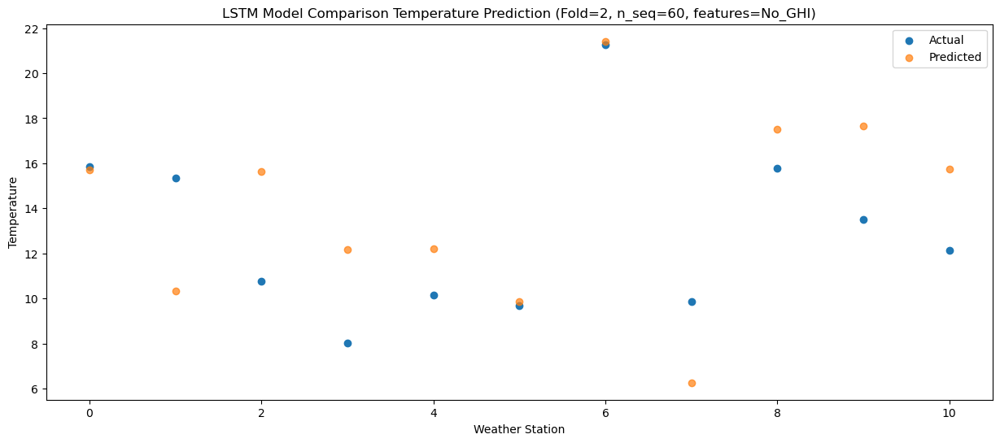

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  22.199564
1                 1   22.56  16.832315
2                 2   13.34  22.122295
3                 3   14.08  18.680128
4                 4   13.18  18.687561
5                 5   13.30  16.354460
6                 6   26.00  27.900014
7                 7   13.39  12.743176
8                 8   17.07  24.008716
9                 9   18.81  24.135897
10               10   17.49  22.219972


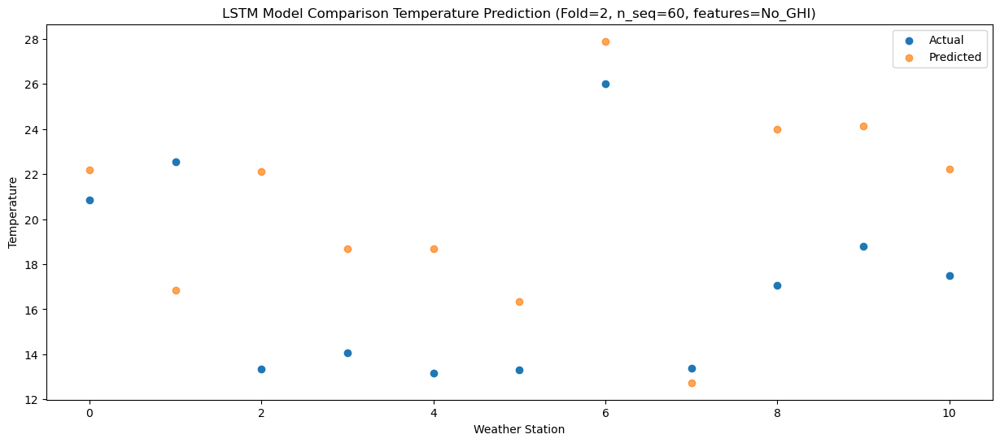

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  24.738787
1                 1   22.59  19.377322
2                 2   13.98  24.671416
3                 3   18.36  21.236878
4                 4   13.92  21.244092
5                 5   15.00  18.907039
6                 6   27.18  30.453754
7                 7   15.49  15.302006
8                 8   19.48  26.571202
9                 9   21.80  26.694070
10               10   20.78  24.777590


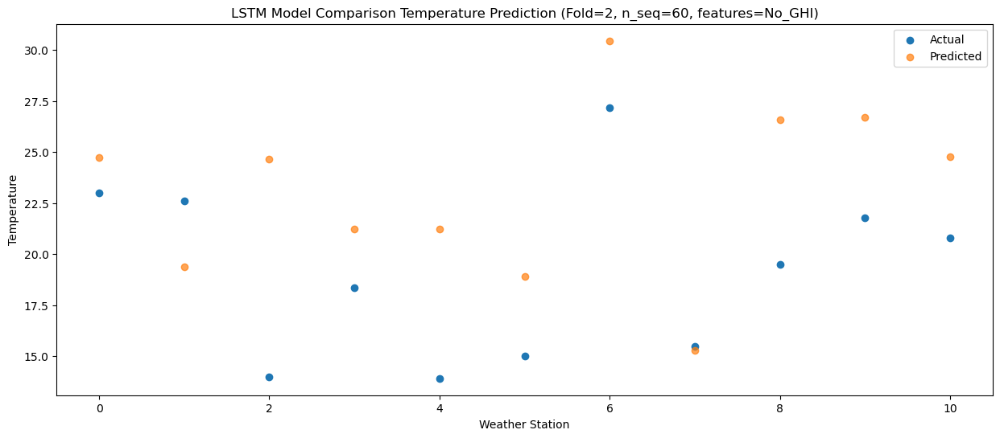

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  22.722936
1                 1   21.26  17.363767
2                 2   13.67  22.648779
3                 3   16.51  19.210693
4                 4   14.29  19.221533
5                 5   15.30  16.885486
6                 6   27.41  28.432188
7                 7   15.93  13.281060
8                 8   21.88  24.546314
9                 9   20.80  24.669213
10               10   19.52  22.753482


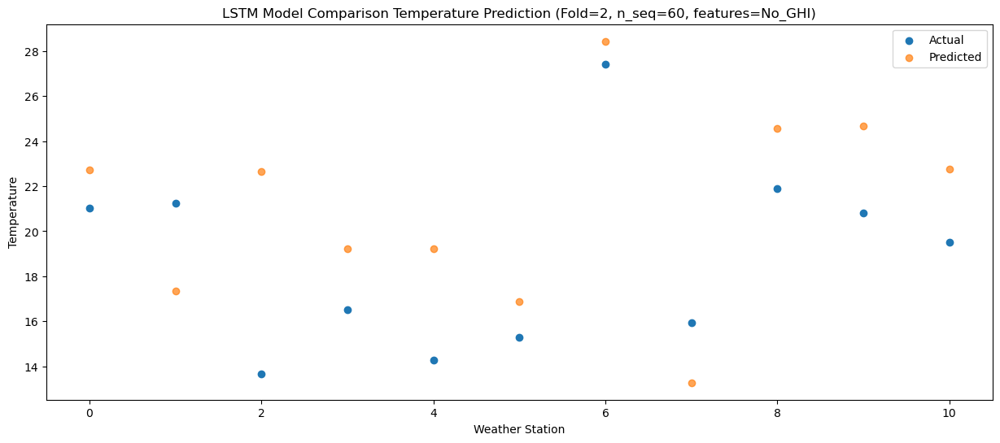

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  18.126928
1                 1   15.13  12.766484
2                 2   12.41  18.052119
3                 3   11.93  14.623208
4                 4   11.94  14.631800
5                 5   10.90  12.293269
6                 6   21.47  23.839884
7                 7    9.68   8.685766
8                 8   20.28  19.952693
9                 9   16.77  20.078850
10               10   15.57  18.161204


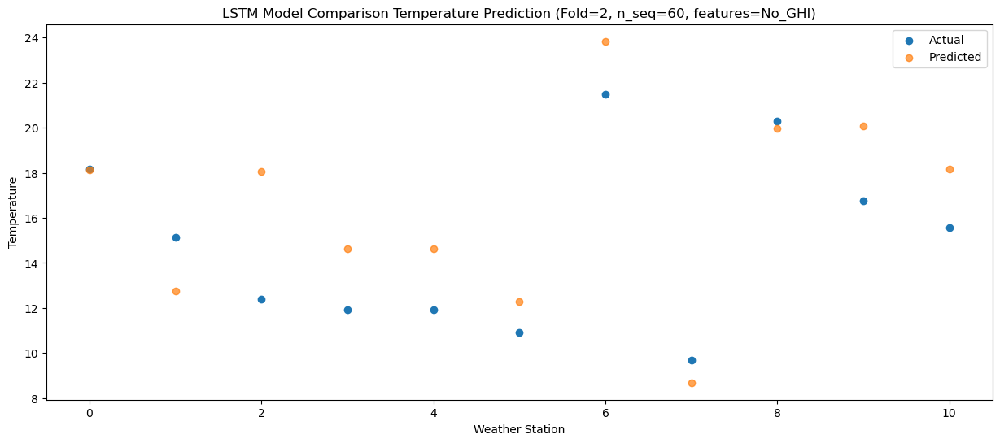

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17  11.688222
1                 1    8.14   6.327525
2                 2   11.14  11.623923
3                 3    6.71   8.194000
4                 4    8.25   8.204886
5                 5    6.43   5.860382
6                 6   15.99  17.406899
7                 7    4.08   2.254298
8                 8   17.04  13.526129
9                 9   12.85  13.649918
10               10   10.91  11.732252


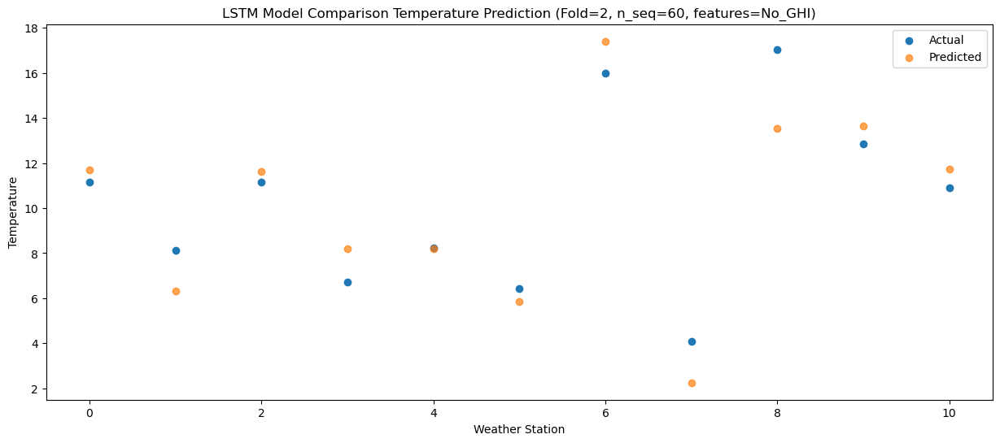

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04   8.430682
1                 1    5.02   3.064291
2                 2    7.72   8.364544
3                 3    2.75   4.937100
4                 4    4.13   4.944708
5                 5    3.75   2.597413
6                 6   13.50  14.144385
7                 7   -1.48  -1.010056
8                 8   10.32  10.265816
9                 9    8.24  10.392265
10               10    5.86   8.474980


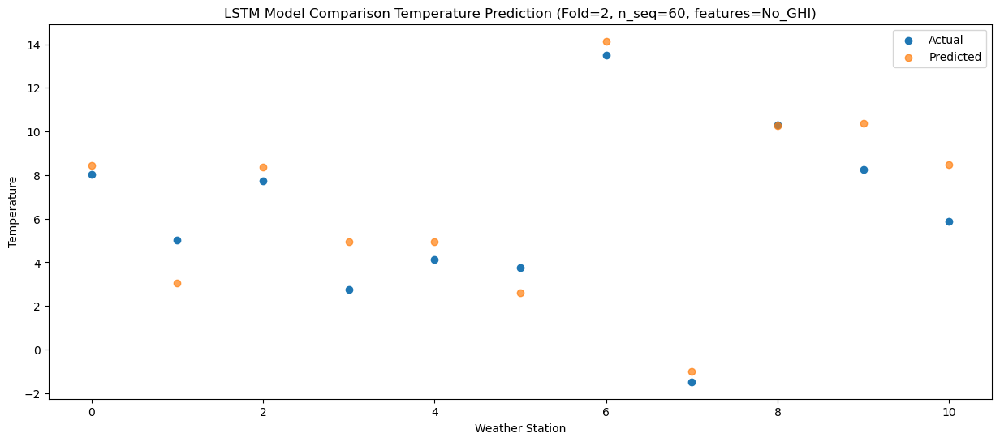

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28   1.218491
1                 1   -1.61  -4.146913
2                 2    0.73   1.148882
3                 3   -4.08  -2.273704
4                 4   -2.17  -2.269761
5                 5   -2.36  -4.622275
6                 6    7.04   6.921710
7                 7   -9.13  -8.225356
8                 8    8.27   3.049552
9                 9    1.24   3.173446
10               10   -1.20   1.261497


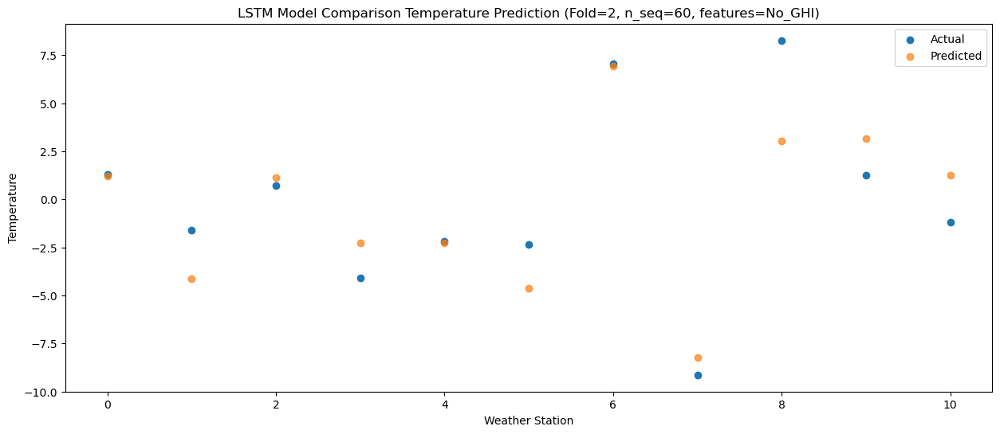

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02  -0.406718
1                 1   -1.69  -5.772876
2                 2    1.39  -0.469612
3                 3   -7.16  -3.894499
4                 4   -1.82  -3.888729
5                 5   -2.95  -6.241940
6                 6    6.34   5.303152
7                 7   -8.59  -9.847977
8                 8    8.21   1.433922
9                 9    0.83   1.556125
10               10   -0.87  -0.358928


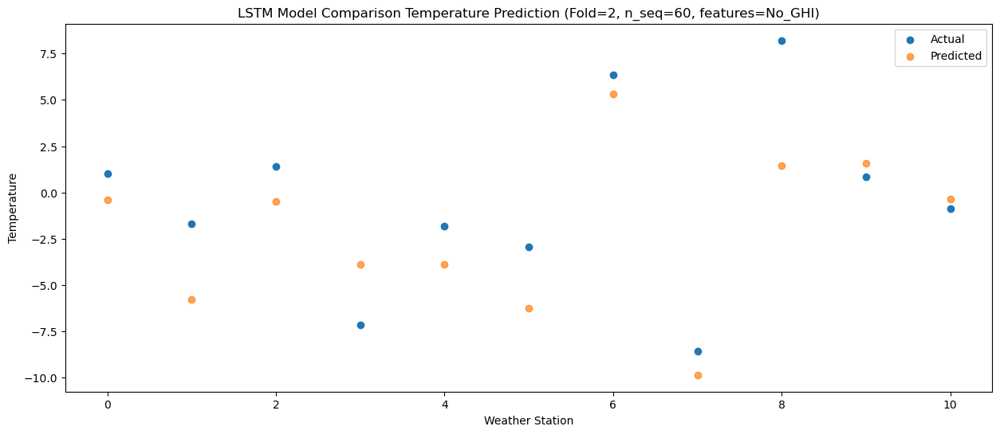

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38  -3.379923
1                 1   -5.73  -8.749069
2                 2    4.12  -3.435280
3                 3   -7.14  -6.863647
4                 4   -2.56  -6.852184
5                 5   -5.30  -9.211662
6                 6    3.23   2.331632
7                 7   -5.67 -12.821609
8                 8    7.29  -1.542020
9                 9    1.33  -1.411435
10               10    0.48  -3.323309


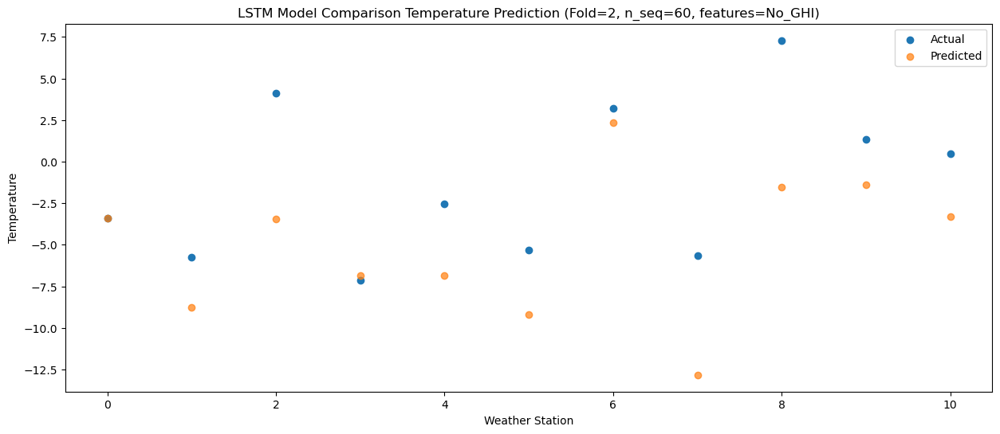

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04   7.756257
1                 1    4.46   2.381657
2                 2    5.93   7.687430
3                 3   -3.03   4.267038
4                 4    4.77   4.277148
5                 5    3.08   1.916316
6                 6   13.60  13.461335
7                 7   -2.57  -1.698158
8                 8    6.89   9.573797
9                 9    8.21   9.712211
10               10    6.69   7.806572


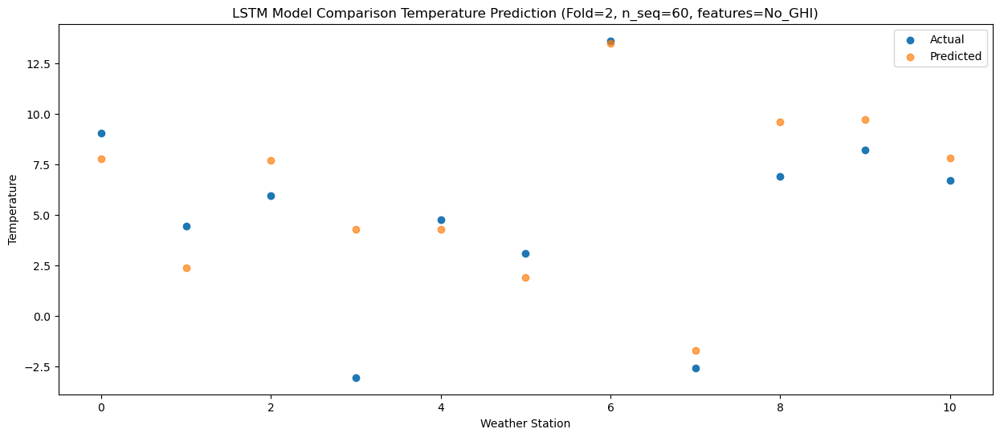

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91  11.405397
1                 1    8.22   6.031523
2                 2    7.74  11.337710
3                 3    1.47   7.919210
4                 4    5.64   7.929176
5                 5    5.20   5.566402
6                 6   15.30  17.113646
7                 7    4.09   1.954489
8                 8   10.75  13.230684
9                 9   11.00  13.366414
10               10    8.66  11.461240


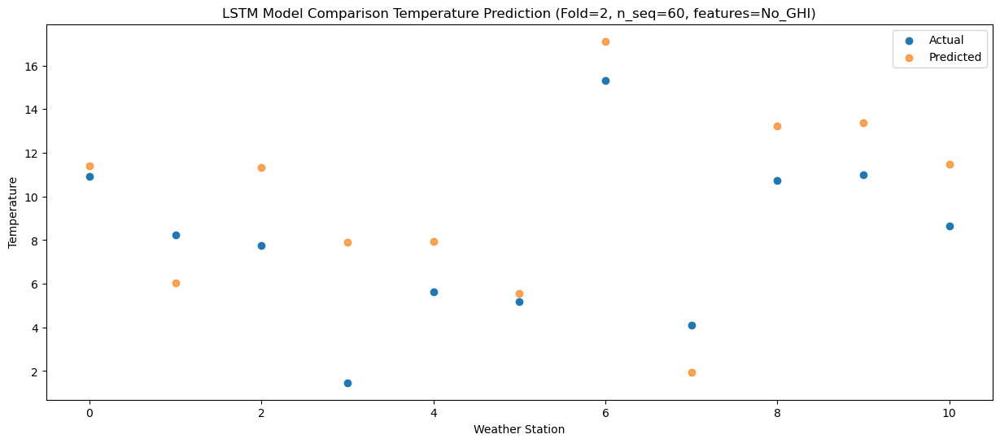

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  15.823046
1                 1   13.40  10.457141
2                 2   11.32  15.770512
3                 3    6.73  12.352127
4                 4   10.11  12.359631
5                 5    9.24   9.997869
6                 6   19.38  21.545421
7                 7    9.10   6.386174
8                 8   12.97  17.669283
9                 9   15.02  17.802808
10               10   13.57  15.891431


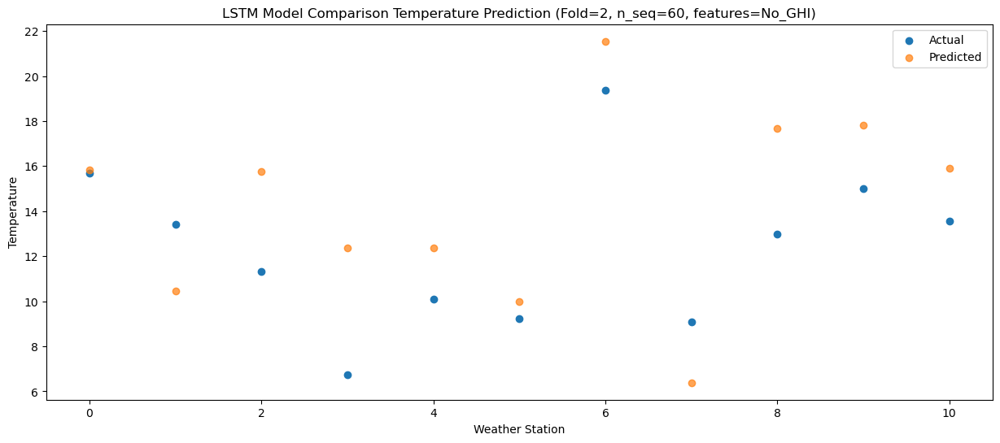

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  22.514779
1                 1   20.65  17.152259
2                 2   12.54  22.460966
3                 3   12.30  19.050987
4                 4   13.59  19.050124
5                 5   13.79  16.683635
6                 6   24.94  28.235495
7                 7   14.09  13.075325
8                 8   17.21  24.365308
9                 9   19.31  24.499349
10               10   18.98  22.587199


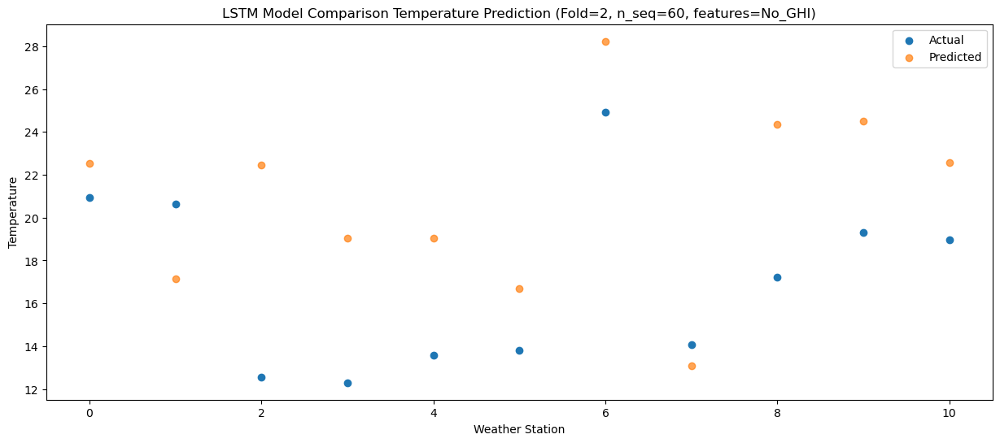

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  23.145049
1                 1   21.34  17.791541
2                 2   13.33  23.091343
3                 3   14.30  19.683307
4                 4   14.18  19.684634
5                 5   13.87  17.325123
6                 6   25.83  28.877889
7                 7   12.89  13.715812
8                 8   20.19  25.004806
9                 9   20.88  25.138330
10               10   20.29  23.224479


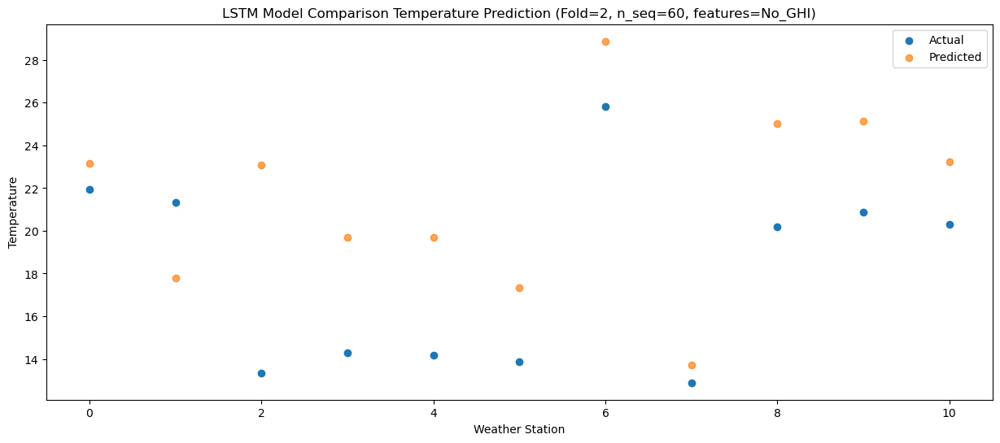

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  23.607234
1                 1   22.10  18.254597
2                 2   13.38  23.555306
3                 3   15.36  20.148675
4                 4   14.35  20.143962
5                 5   14.98  17.782561
6                 6   26.39  29.336583
7                 7   12.37  14.171688
8                 8   19.79  25.456715
9                 9   20.97  25.594440
10               10   20.37  23.681131


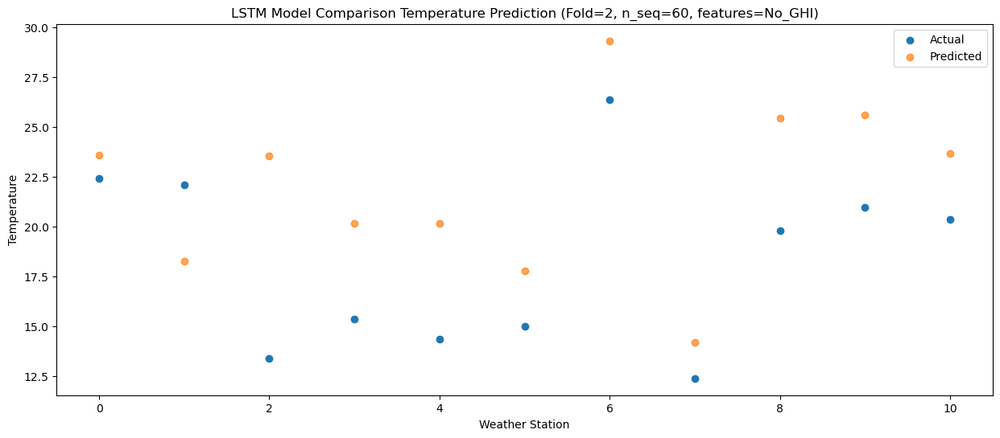

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  20.346822
1                 1   19.86  14.993900
2                 2   12.10  20.292548
3                 3   12.19  16.889408
4                 4   11.81  16.881474
5                 5   12.24  14.518067
6                 6   24.12  26.073162
7                 7   10.19  10.905179
8                 8   18.01  22.188358
9                 9   16.86  22.329647
10               10   15.88  20.416862


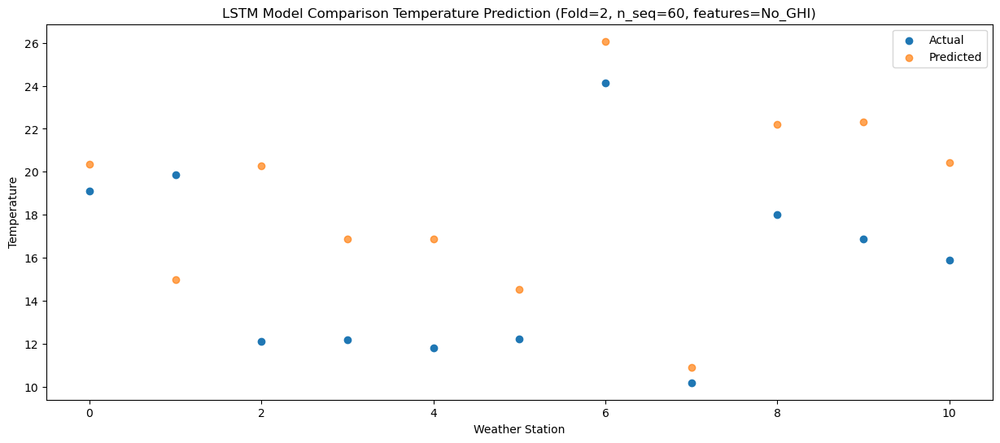

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  15.314684
1                 1   11.60   9.960134
2                 2   10.96  15.273217
3                 3    8.36  11.868095
4                 4    9.07  11.858616
5                 5    8.94   9.493943
6                 6   19.61  21.046518
7                 7    3.63   5.876316
8                 8   13.03  17.165903
9                 9   13.58  17.308242
10               10   12.12  15.395494


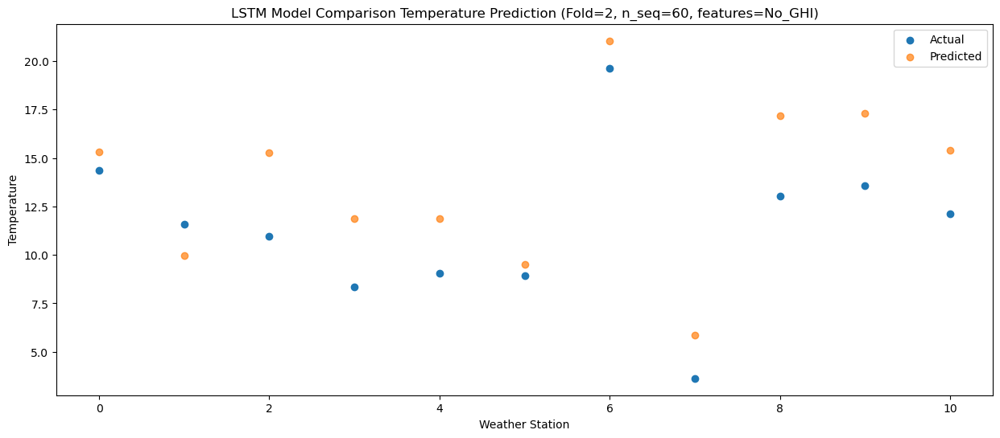

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73   5.527072
1                 1    4.89   0.173846
2                 2    4.11   5.487406
3                 3    0.28   2.079766
4                 4    0.80   2.074103
5                 5    1.30  -0.289437
6                 6   11.64  11.262522
7                 7   -1.77  -3.901674
8                 8   11.77   7.385304
9                 9    4.67   7.518294
10               10    1.90   5.607785


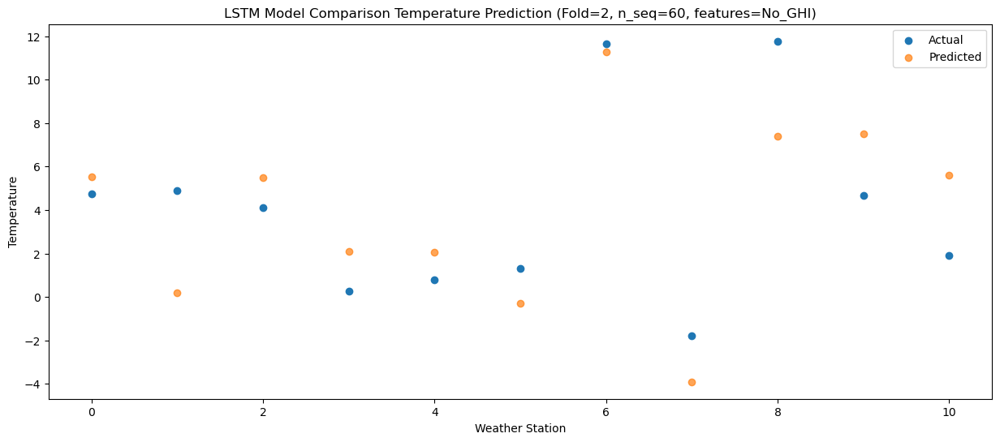

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    7.82   5.136765
1                 1    2.50  -0.226964
2                 2    5.01   5.090494
3                 3   -1.64   1.690103
4                 4    4.21   1.682416
5                 5    4.54  -0.680850
6                 6   13.93  10.868316
7                 7   -5.12  -4.299237
8                 8    5.26   6.991084
9                 9    6.59   7.127757
10               10    4.00   5.218476


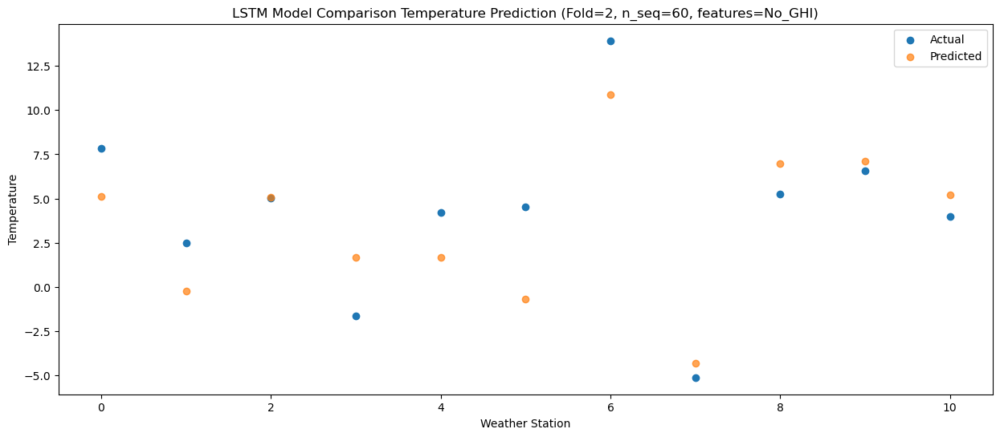

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.48  -3.315774
1                 1   -2.19  -8.677177
2                 2    0.75  -3.365189
3                 3   -7.79  -6.760156
4                 4   -3.52  -6.771486
5                 5   -3.89  -9.137277
6                 6    5.45   2.411776
7                 7   -8.12 -12.752856
8                 8    7.67  -1.454877
9                 9    0.11  -1.330993
10               10   -2.87  -3.242999


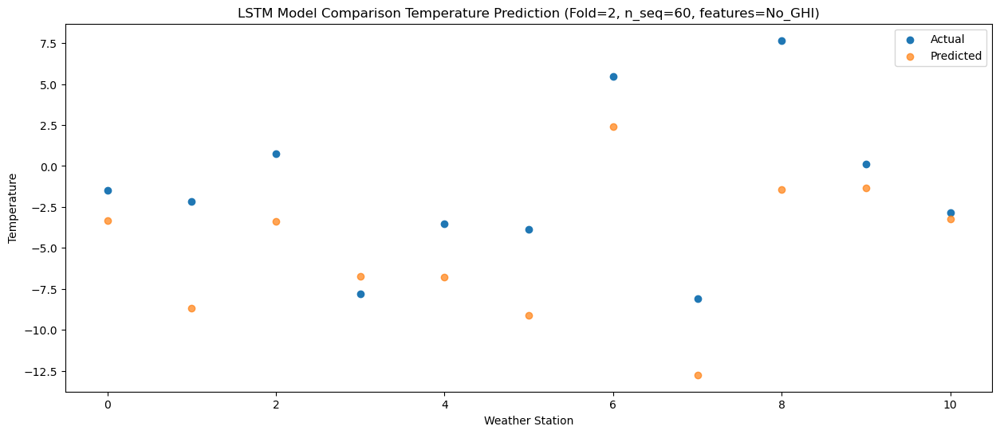

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.76  -0.583404
1                 1   -2.20  -5.953170
2                 2    3.08  -0.630641
3                 3   -5.47  -4.019156
4                 4   -0.38  -4.029741
5                 5   -4.27  -6.402221
6                 6    5.28   5.144001
7                 7   -7.15 -10.024524
8                 8    8.54   1.274672
9                 9    4.13   1.407618
10               10    1.72  -0.502223


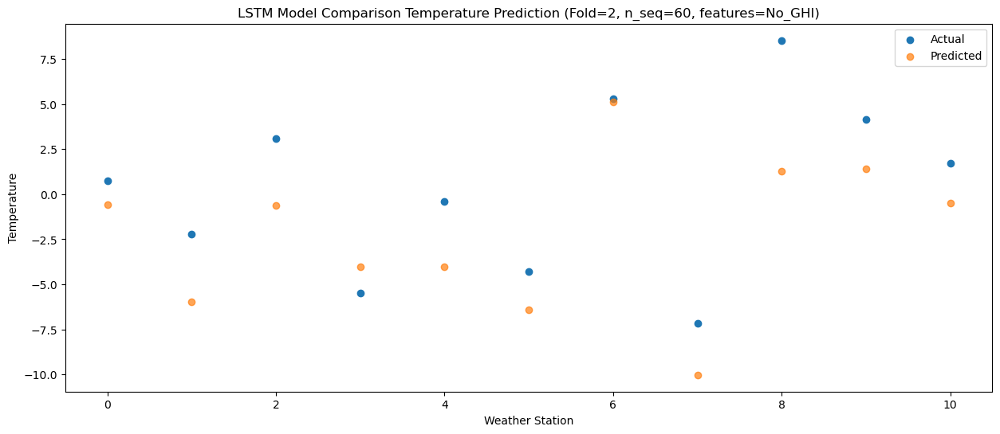

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    7.05   6.307432
1                 1    4.78   0.939136
2                 2    6.55   6.268111
3                 3   -1.61   2.878759
4                 4    3.38   2.865459
5                 5    1.85   0.488124
6                 6   11.86  12.035102
7                 7   -2.09  -3.135083
8                 8   10.33   8.158952
9                 9    8.24   8.297095
10               10    6.27   6.385766


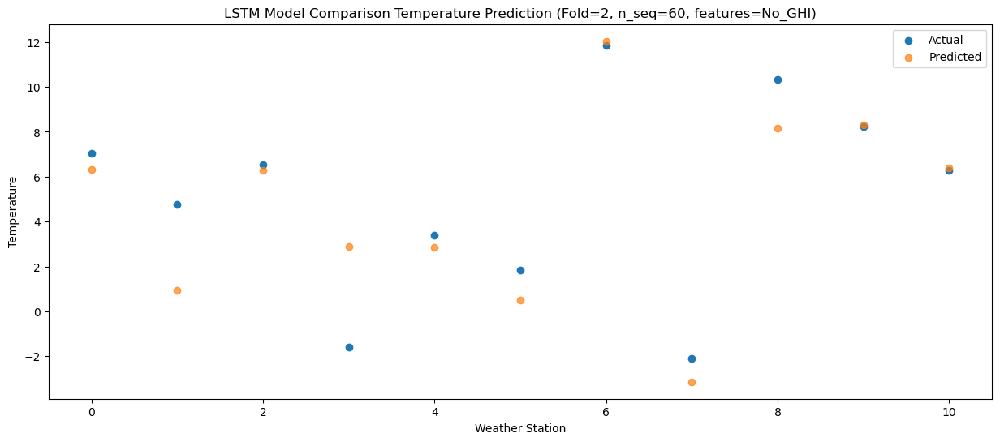

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   11.08  11.147346
1                 1   11.46   5.776889
2                 2    8.36  11.105095
3                 3    2.83   7.719285
4                 4    7.18   7.703736
5                 5    8.00   5.324750
6                 6   18.13  16.871823
7                 7    5.10   1.697655
8                 8   12.45  12.985331
9                 9   11.53  13.128879
10               10    9.43  11.218190


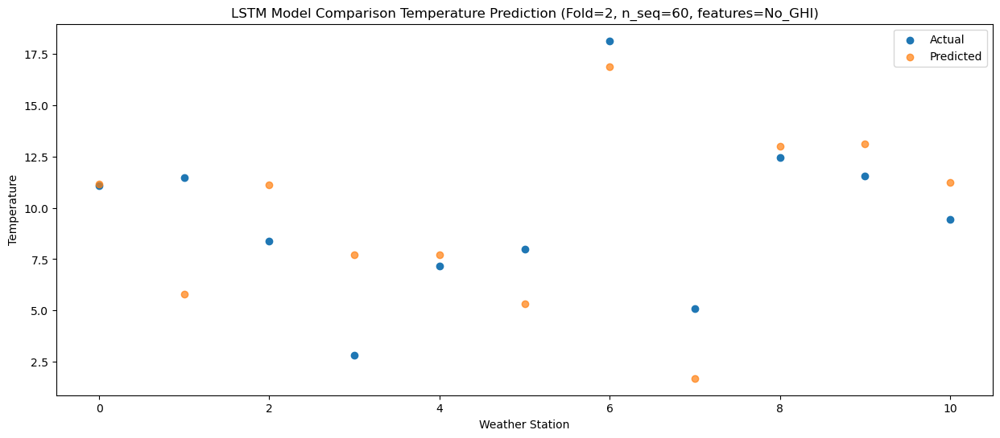

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   17.63  18.494449
1                 1   17.26  13.123044
2                 2   11.12  18.452157
3                 3    8.17  15.071162
4                 4   12.34  15.056251
5                 5   12.60  12.673736
6                 6   23.15  24.220584
7                 7    9.80   9.050574
8                 8   13.41  20.334186
9                 9   16.38  20.482834
10               10   15.67  18.572608


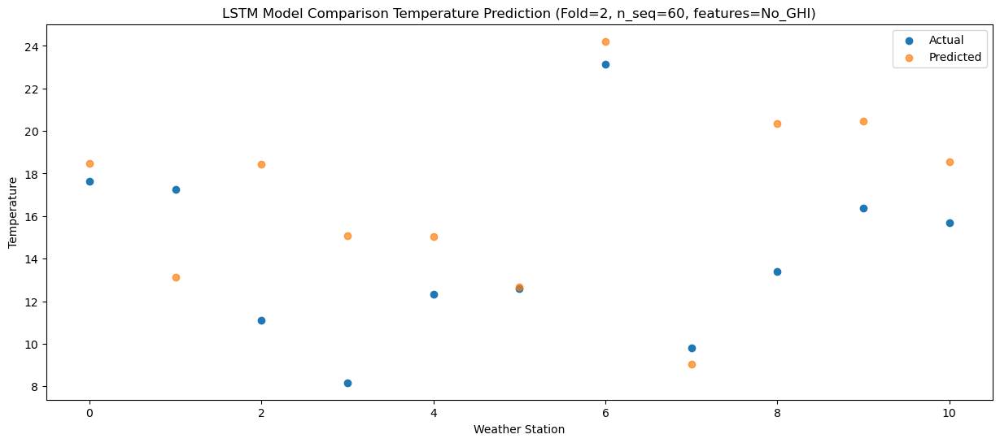

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   21.68  22.997918
1                 1   21.06  17.620939
2                 2   12.93  22.947656
3                 3   12.41  19.559034
4                 4   14.93  19.545751
5                 5   16.32  17.162803
6                 6   27.86  28.711798
7                 7   13.66  13.535426
8                 8   18.33  24.815022
9                 9   20.14  24.974735
10               10   19.32  23.064218


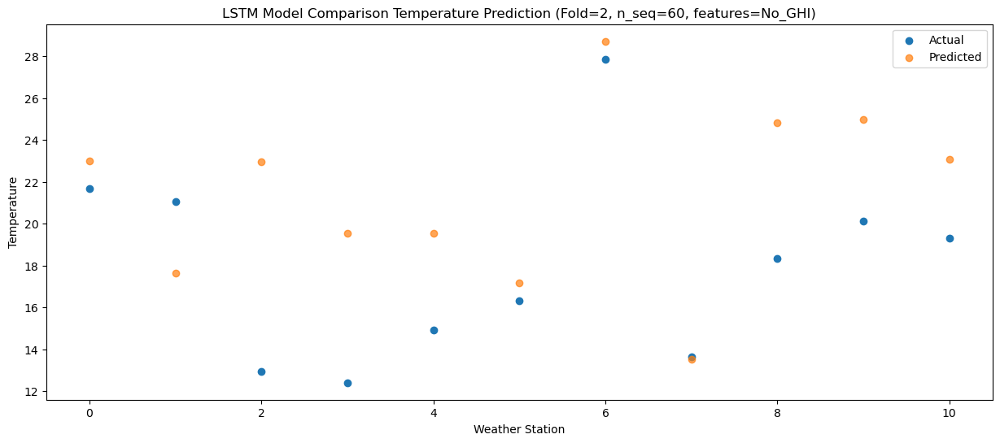

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.18  25.263219
1                 1   24.30  19.895873
2                 2   13.11  25.216752
3                 3   17.03  21.829824
4                 4   14.76  21.814602
5                 5   17.68  19.434407
6                 6   30.65  30.986484
7                 7   14.80  15.806337
8                 8   19.14  27.087828
9                 9   21.58  27.244414
10               10   20.67  25.328588


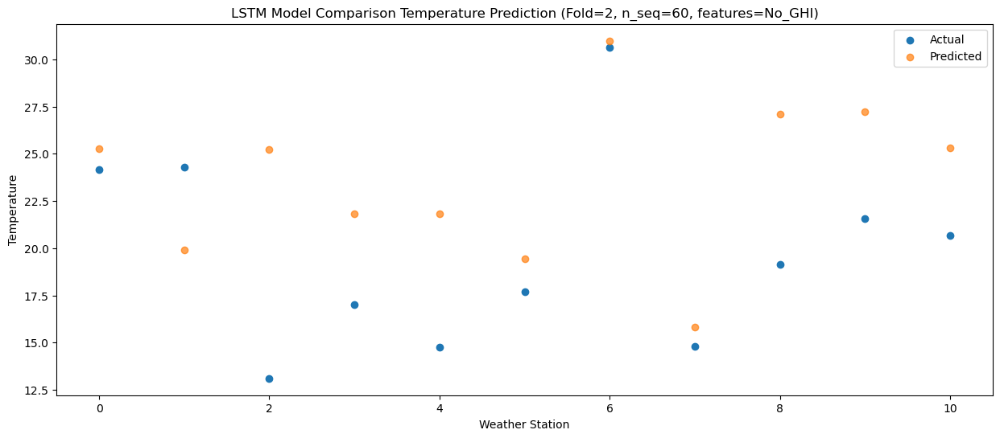

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   21.63  23.617639
1                 1   21.99  18.245085
2                 2   12.54  23.566498
3                 3   16.95  20.186885
4                 4   13.94  20.169729
5                 5   14.96  17.792147
6                 6   27.84  29.343393
7                 7   11.78  14.161584
8                 8   21.18  25.436864
9                 9   20.20  25.600582
10               10   19.42  23.686141


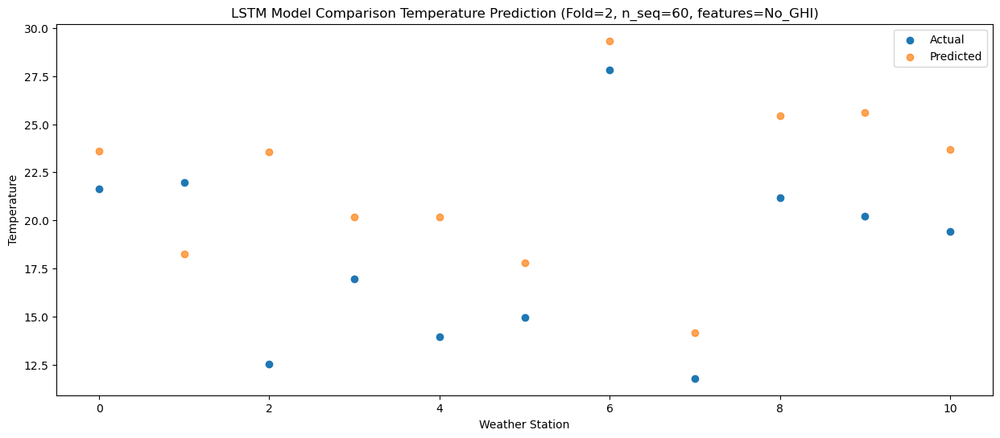

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.88  19.806463
1                 1   19.23  14.425741
2                 2   11.13  19.754767
3                 3   11.91  16.372718
4                 4   11.97  16.358427
5                 5   12.30  13.980553
6                 6   24.01  25.529618
7                 7   10.05  10.342932
8                 8   20.77  21.609662
9                 9   16.89  21.782806
10               10   15.27  19.869311


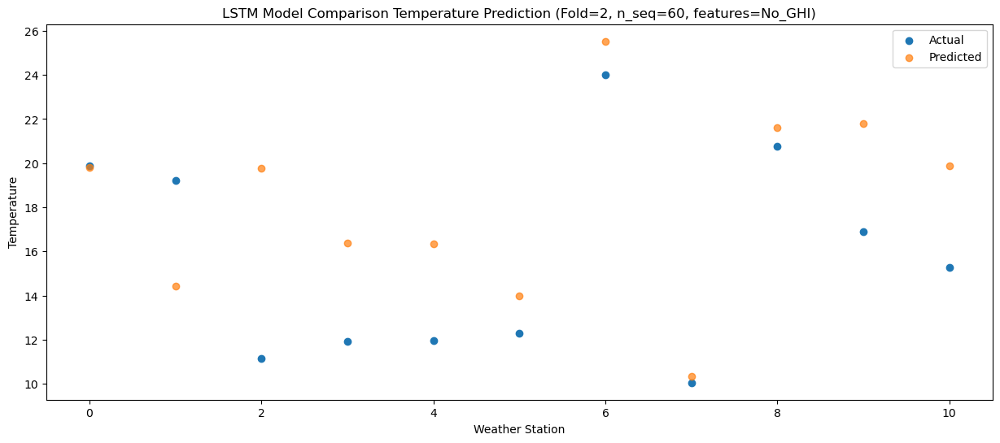

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.54  12.596111
1                 1   10.85   7.209479
2                 2    8.50  12.543775
3                 3    6.47   9.161875
4                 4    5.78   9.156431
5                 5    6.73   6.780587
6                 6   17.63  18.327963
7                 7    1.84   3.137998
8                 8   14.50  14.405485
9                 9    9.58  14.577347
10               10    7.99  12.663652


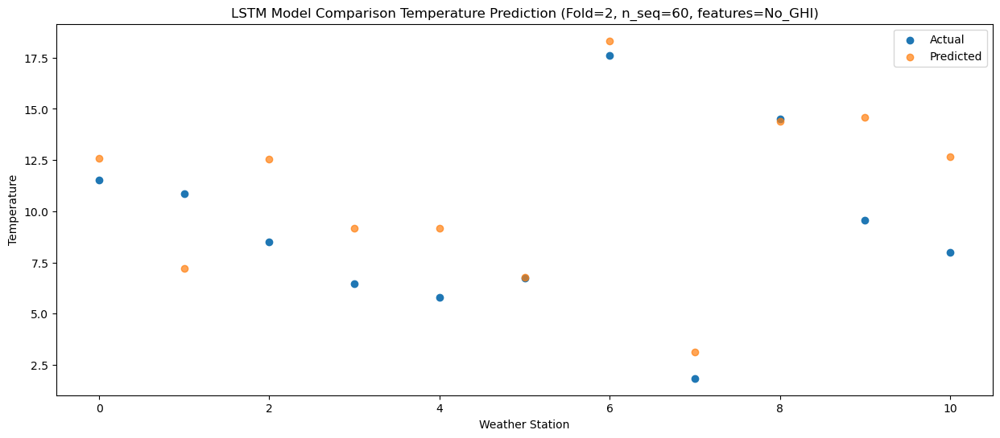

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    5.41   6.944411
1                 1    0.86   1.548940
2                 2    6.74   6.884397
3                 3    2.67   3.501236
4                 4    2.71   3.496586
5                 5    0.85   1.122936
6                 6   10.96  12.670645
7                 7   -5.05  -2.529305
8                 8    8.27   8.732503
9                 9    7.46   8.911682
10               10    5.54   6.998272


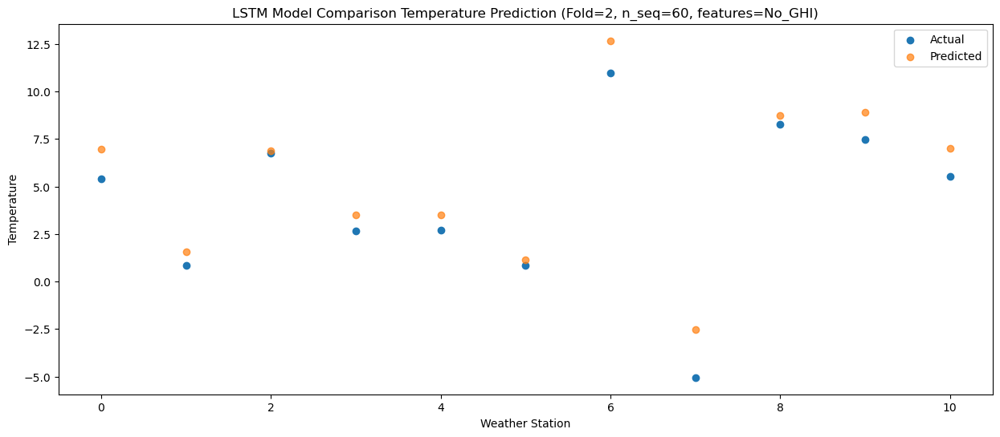

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.90   0.898182
1                 1   -1.85  -4.497645
2                 2    2.64   0.850699
3                 3   -3.50  -2.538250
4                 4    0.20  -2.535592
5                 5   -1.38  -4.902230
6                 6    8.34   6.646245
7                 7   -7.22  -8.555952
8                 8    5.57   2.712120
9                 9    0.93   2.884772
10               10    0.08   0.965816


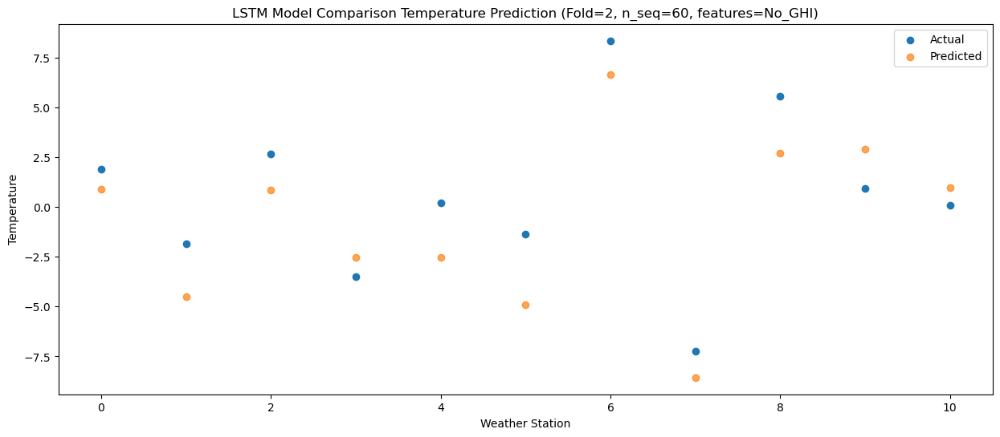

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    3.92   2.964722
1                 1   -2.10  -2.436751
2                 2    2.44   2.901706
3                 3   -2.21  -0.479100
4                 4    1.37  -0.484471
5                 5   -0.62  -2.854668
6                 6    9.22   8.693783
7                 7   -7.93  -6.509923
8                 8    5.23   4.752431
9                 9    4.13   4.931558
10               10    2.00   3.015679


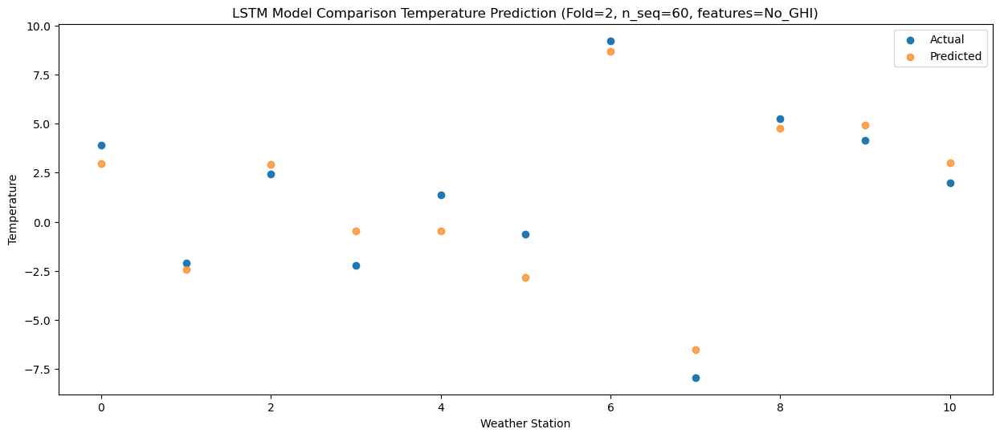

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    4.94   3.689796
1                 1   -0.50  -1.717043
2                 2    5.50   3.618214
3                 3   -4.09   0.243683
4                 4    3.50   0.232139
5                 5    0.57  -2.132716
6                 6    9.41   9.419311
7                 7   -6.72  -5.786489
8                 8    4.91   5.474968
9                 9    7.15   5.654971
10               10    4.79   3.737512


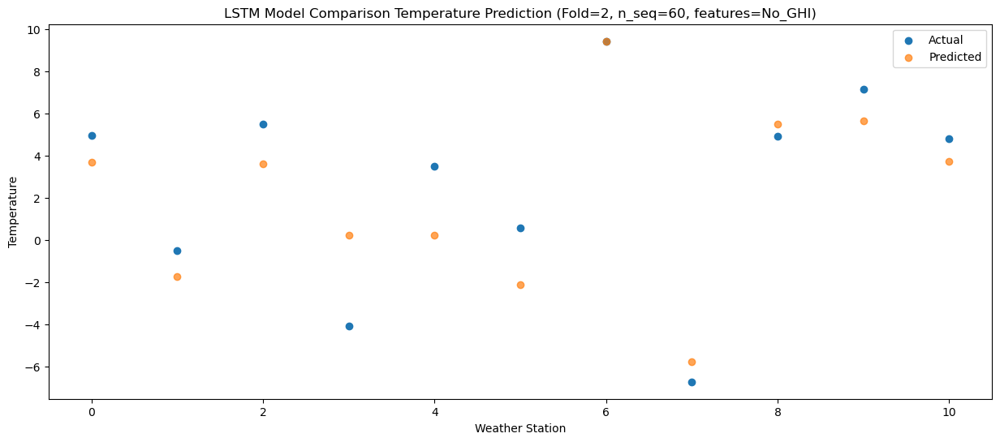

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    7.21   5.706218
1                 1    3.57   0.296600
2                 2    6.52   5.627833
3                 3   -1.65   2.251290
4                 4    5.33   2.239301
5                 5    4.37  -0.123740
6                 6   14.06  11.430665
7                 7   -2.02  -3.775581
8                 8    5.92   7.487338
9                 9    7.60   7.662439
10               10    5.32   5.745355


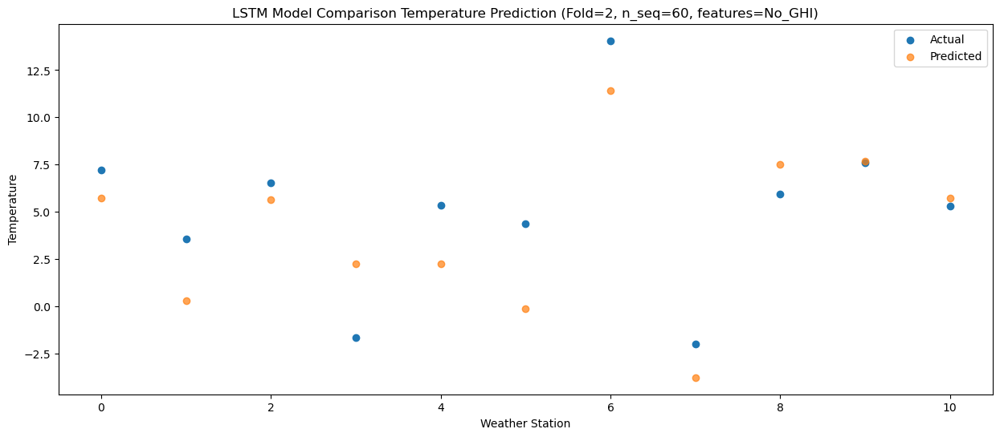

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   11.36  12.712425
1                 1    9.43   7.298277
2                 2    9.06  12.625296
3                 3    4.07   9.252645
4                 4    7.25   9.231039
5                 5    5.29   6.871504
6                 6   15.88  18.430047
7                 7    3.62   3.217495
8                 8    9.76  14.483001
9                 9   11.12  14.662450
10               10   10.21  12.746399


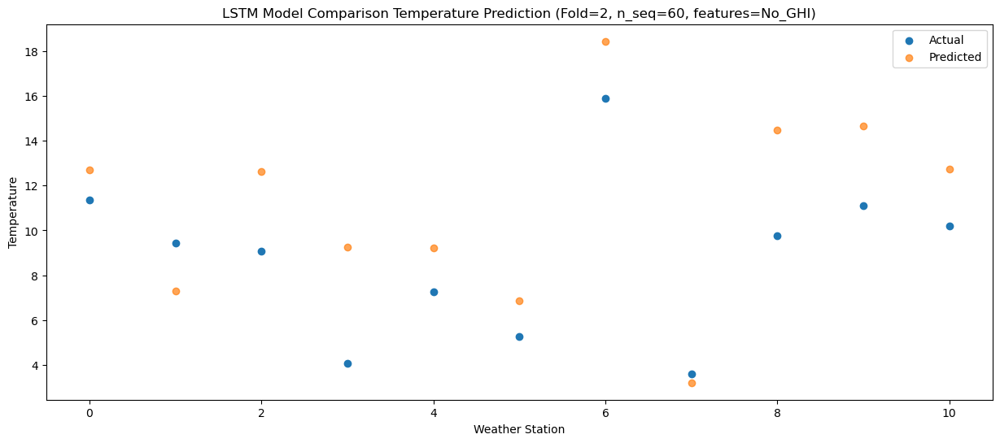

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   17.41  17.506886
1                 1   14.92  12.092750
2                 2   10.04  17.407743
3                 3    7.70  14.032704
4                 4   11.28  14.008523
5                 5   10.37  11.648276
6                 6   21.62  23.209723
7                 7    8.27   7.992474
8                 8   10.97  19.255233
9                 9   13.90  19.435276
10               10   13.56  17.521817


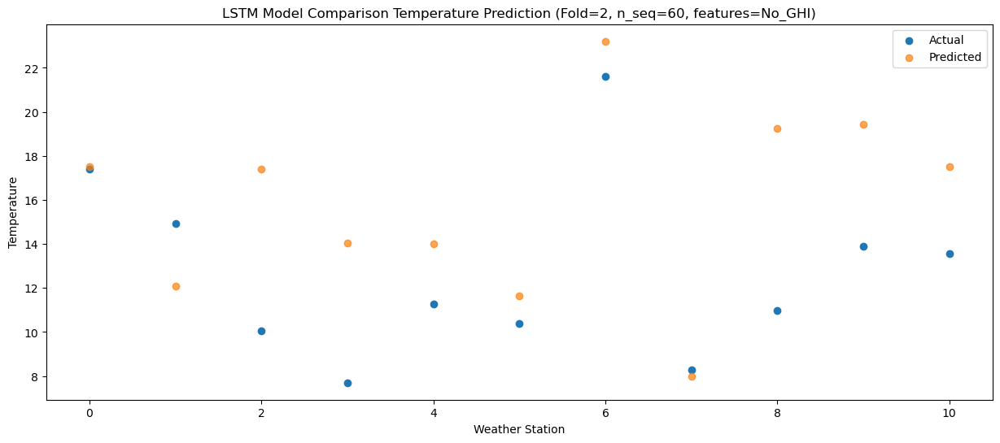

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   20.04  21.862097
1                 1   17.53  16.440708
2                 2   12.45  21.752650
3                 3   11.49  18.380154
4                 4   14.93  18.358575
5                 5   15.29  15.997663
6                 6   25.77  27.559120
7                 7   12.93  12.342950
8                 8   12.93  23.598236
9                 9   17.56  23.787877
10               10   16.47  21.879928


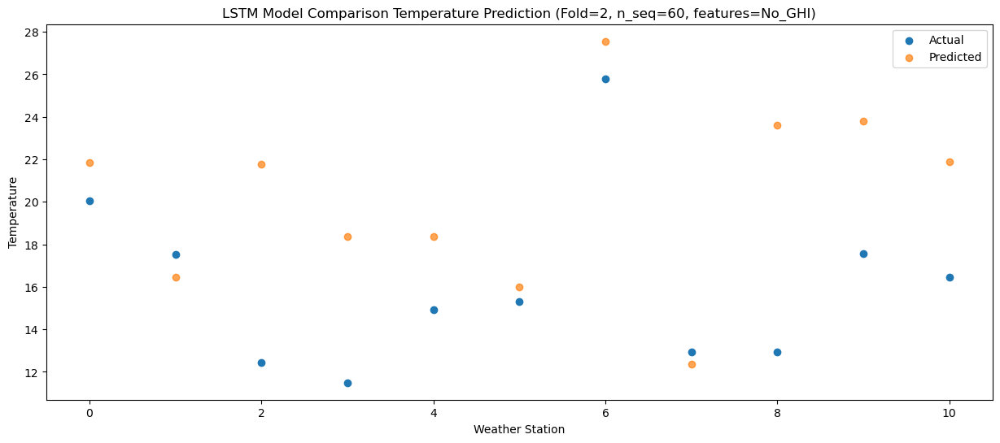

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   21.79  24.733256
1                 1   21.63  19.304935
2                 2   14.36  24.624353
3                 3   17.06  21.260549
4                 4   16.37  21.234165
5                 5   17.45  18.871891
6                 6   28.33  30.435475
7                 7   17.68  15.222087
8                 8   19.85  26.478292
9                 9   21.15  26.671147
10               10   20.02  24.760881


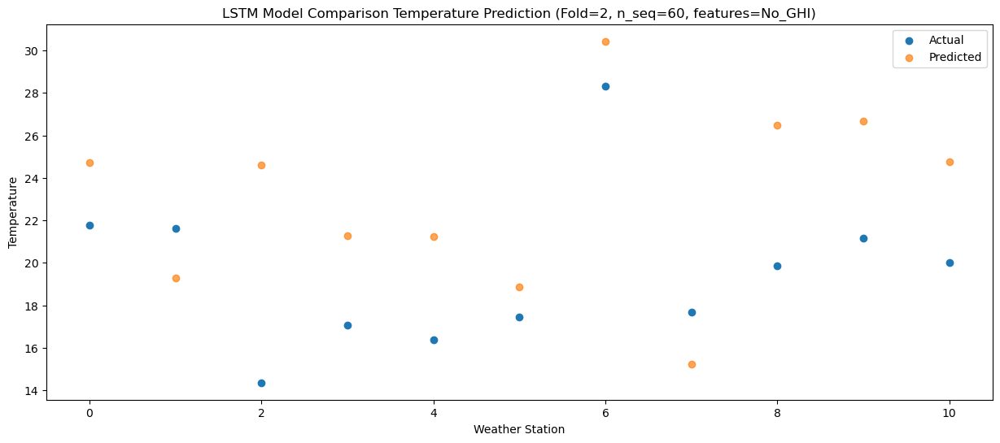

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   21.30  23.799637
1                 1   22.12  18.372532
2                 2   14.54  23.679749
3                 3   15.05  20.315285
4                 4   17.67  20.294544
5                 5   19.15  17.928527
6                 6   30.67  29.493748
7                 7   14.68  14.278472
8                 8   19.48  25.531847
9                 9   20.60  25.723668
10               10   19.31  23.819425


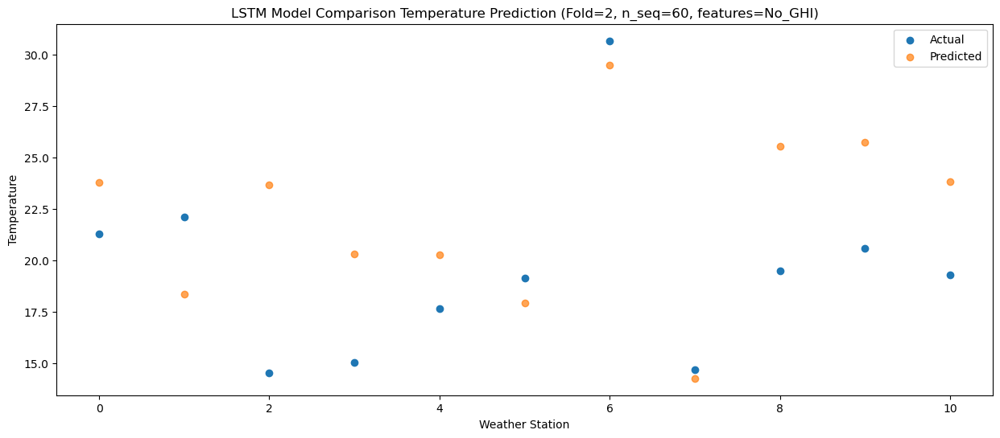

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   18.01  20.558182
1                 1   19.25  15.131806
2                 2   12.59  20.439004
3                 3   12.63  17.079541
4                 4   13.24  17.053356
5                 5   14.67  14.682977
6                 6   25.89  26.247768
7                 7   12.02  11.034812
8                 8   15.98  22.287107
9                 9   16.64  22.482030
10               10   16.53  20.579697


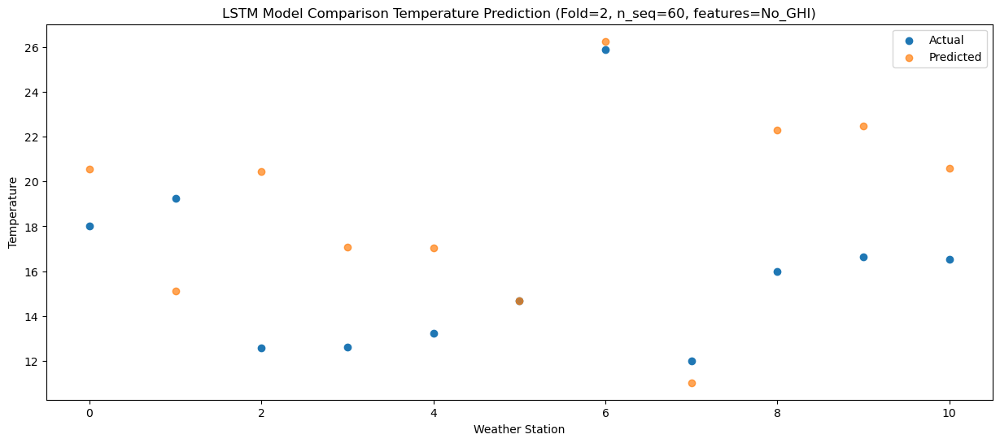

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.85  14.182922
1                 1   10.21   8.760428
2                 2    9.01  14.075960
3                 3    7.61  10.715782
4                 4    7.08  10.689401
5                 5    6.78   8.316930
6                 6   17.17  19.882987
7                 7    5.28   4.674842
8                 8   14.39  15.925633
9                 9   11.35  16.123426
10               10   10.48  14.220136


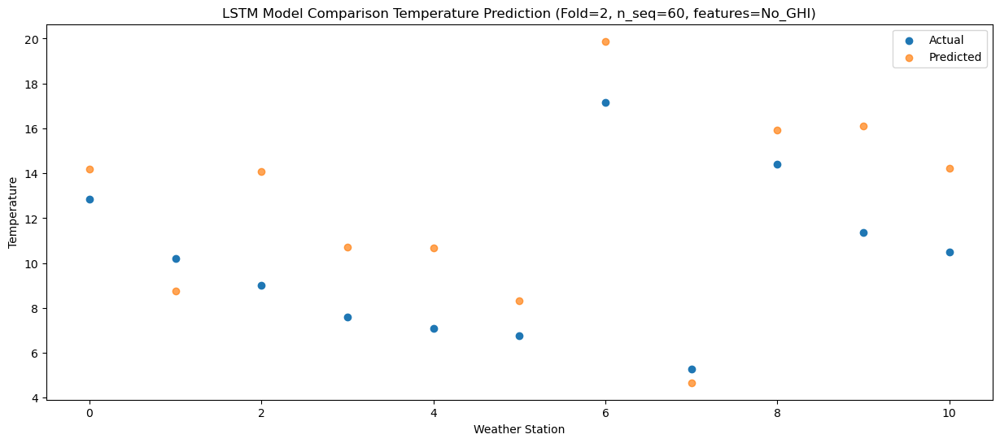

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    5.74   7.598125
1                 1    3.49   2.171067
2                 2    5.03   7.489301
3                 3   -0.37   4.129773
4                 4    1.97   4.104491
5                 5    0.50   1.727776
6                 6   11.83  13.290408
7                 7   -1.83  -1.911075
8                 8   10.00   9.340508
9                 9    5.45   9.537928
10               10    4.27   7.637181


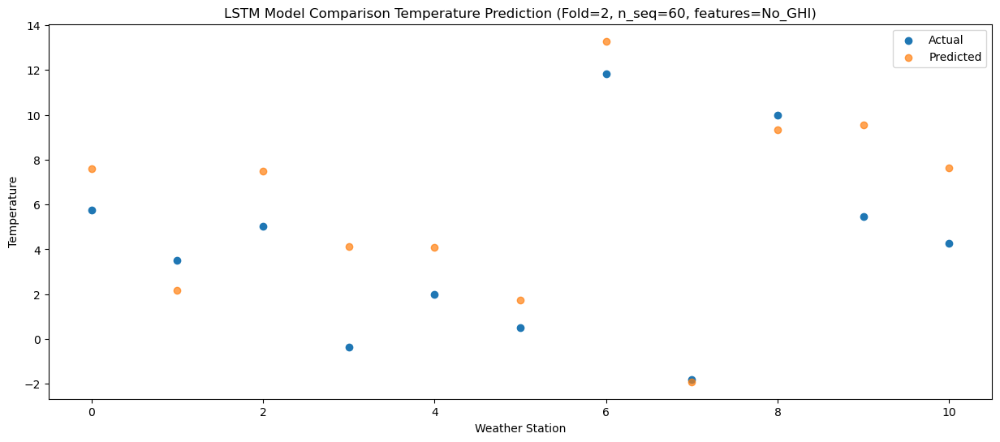

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    2.68   5.448783
1                 1   -0.18   0.023982
2                 2    3.10   5.348036
3                 3   -1.11   1.988355
4                 4   -0.63   1.962765
5                 5   -1.61  -0.411299
6                 6    8.85  11.151988
7                 7   -6.87  -4.050398
8                 8    7.67   7.201384
9                 9    2.98   7.400089
10               10    1.42   5.497519


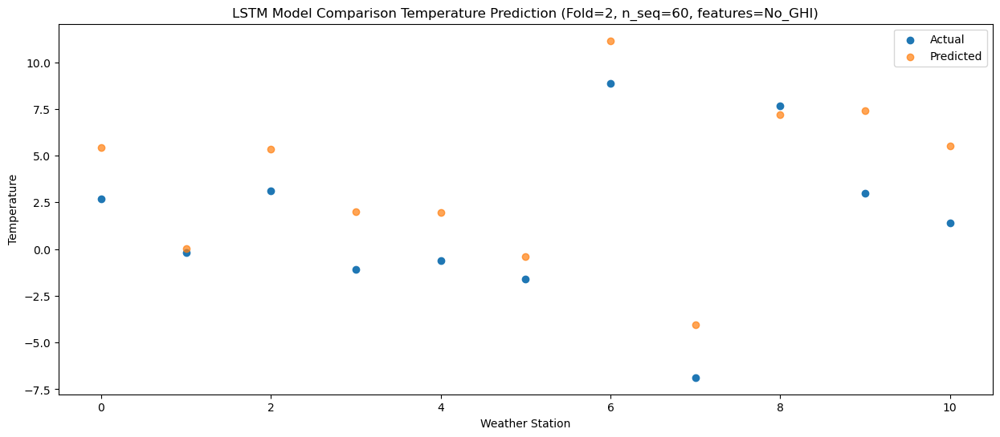

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.11  -0.392443
1                 1   -5.27  -5.814679
2                 2    1.10  -0.493697
3                 3   -5.28  -3.851276
4                 4   -2.71  -3.881125
5                 5   -5.76  -6.250994
6                 6    3.67   5.313961
7                 7   -7.20  -9.889705
8                 8    5.87   1.363880
9                 9    1.13   1.560247
10               10   -1.90  -0.345146


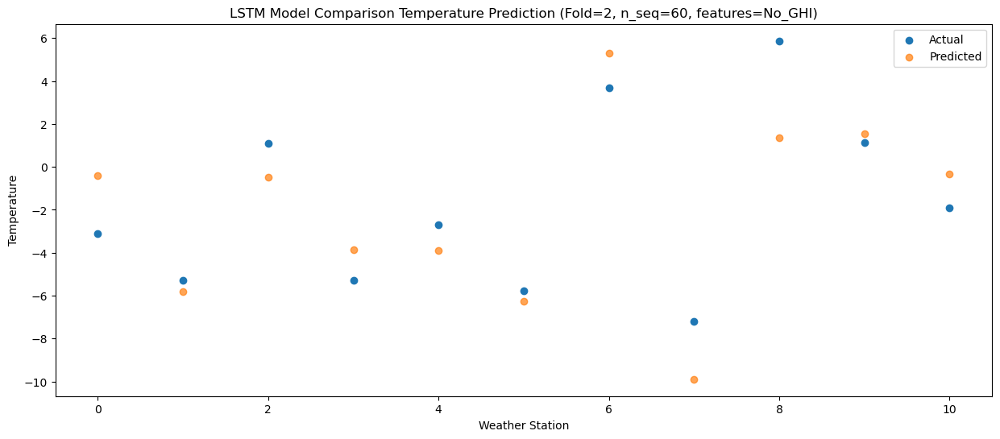

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.21   5.171968
1                 1    2.21  -0.246544
2                 2    1.58   5.057858
3                 3   -4.60   1.701309
4                 4    1.45   1.668709
5                 5    1.00  -0.695131
6                 6   11.93  10.873000
7                 7   -3.99  -4.332256
8                 8    6.40   6.917430
9                 9    4.35   7.110855
10               10    2.64   5.206551


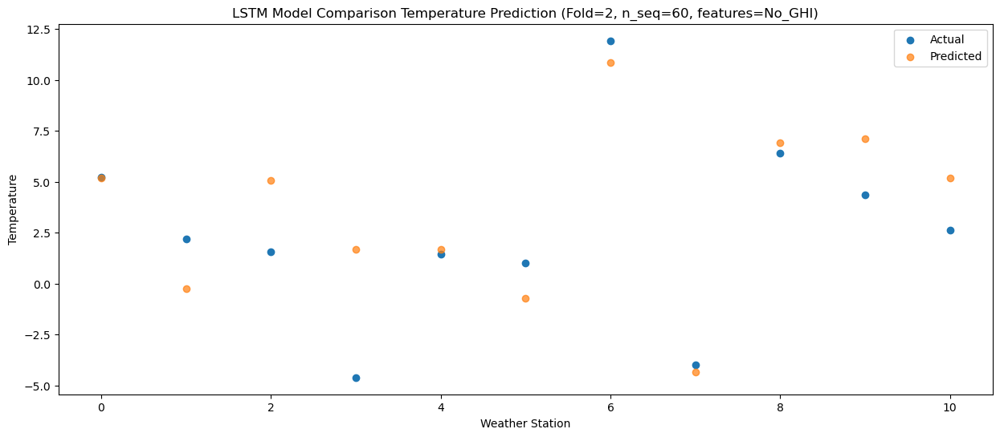

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.10   9.056849
1                 1    4.98   3.639422
2                 2    6.00   8.941249
3                 3   -0.20   5.586222
4                 4    4.12   5.552309
5                 5    3.37   3.185885
6                 6   14.28  14.756497
7                 7   -1.42  -0.450765
8                 8    7.34  10.793575
9                 9    7.91  10.990200
10               10    6.81   9.087656


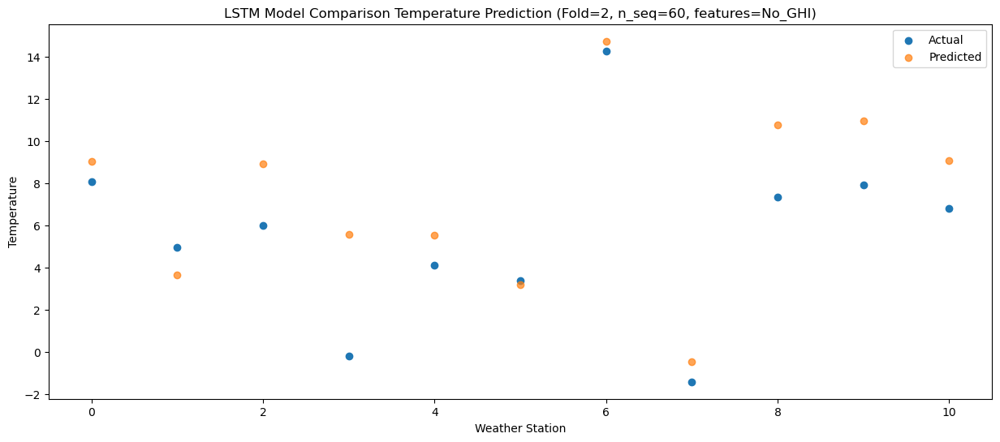

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.86  13.438691
1                 1   10.39   8.021879
2                 2    7.39  13.316806
3                 3    2.23   9.961747
4                 4    7.78   9.930638
5                 5    7.11   7.570501
6                 6   17.73  19.140028
7                 7    2.99   3.933335
8                 8    9.45  15.175426
9                 9   11.97  15.371152
10               10   10.79  13.471295


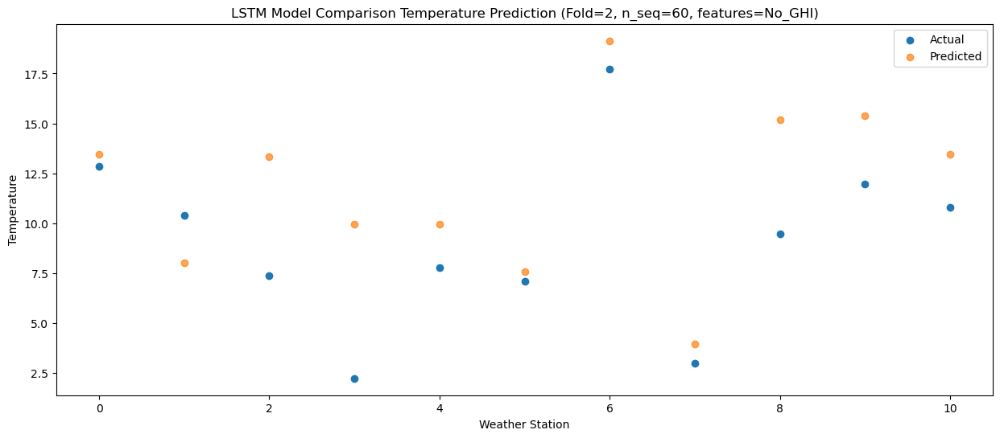

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.79  19.325436
1                 1   15.00  13.906810
2                 2   12.24  19.207240
3                 3    8.02  15.848588
4                 4   12.83  15.817334
5                 5   10.81  13.456559
6                 6   22.62  25.027876
7                 7    8.81   9.819962
8                 8   11.25  21.057645
9                 9   16.35  21.256591
10               10   15.25  19.354973


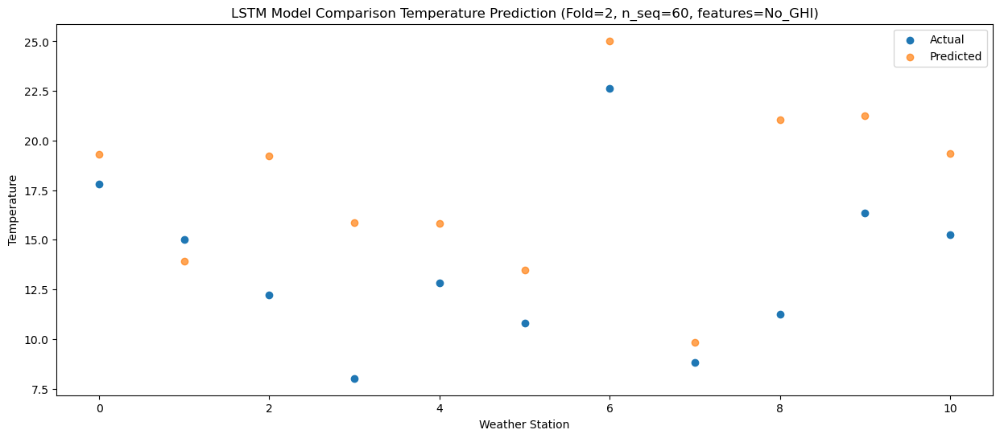

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   20.87  23.676785
1                 1   21.17  18.257915
2                 2   13.15  23.561132
3                 3   13.99  20.205451
4                 4   14.66  20.172860
5                 5   14.04  17.808710
6                 6   26.12  29.378385
7                 7   15.23  14.175215
8                 8   15.93  25.415119
9                 9   20.23  25.611085
10               10   19.60  23.709507


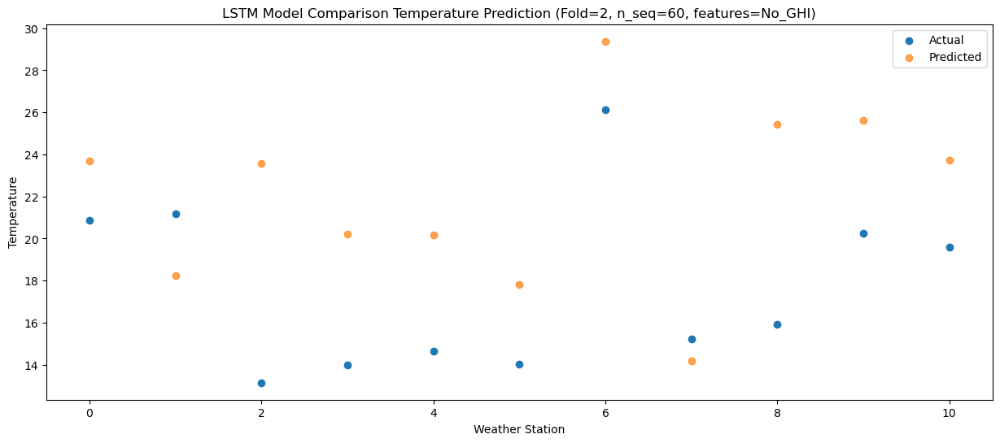

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   21.36  24.463150
1                 1   21.72  19.048244
2                 2   13.99  24.351675
3                 3   16.77  20.999196
4                 4   15.27  20.962430
5                 5   12.52  18.595525
6                 6   26.43  30.163777
7                 7   14.70  14.967416
8                 8   19.66  26.211564
9                 9   21.62  26.400529
10               10   20.83  24.497204


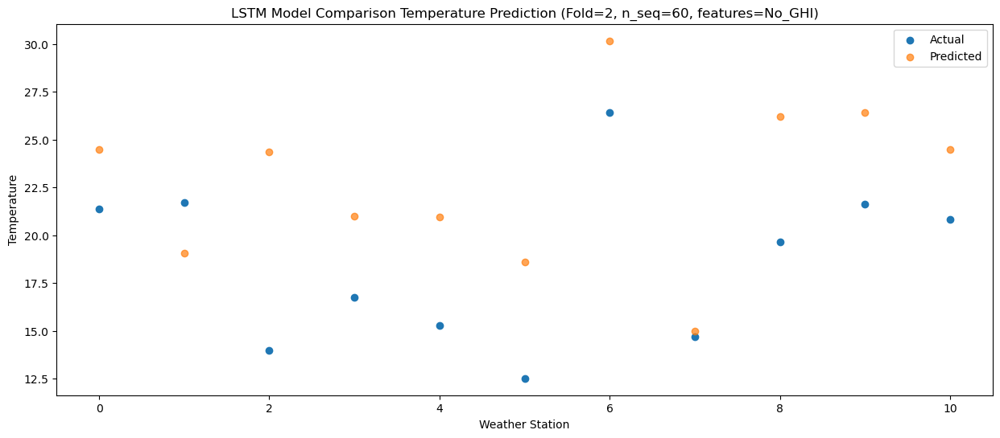

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   21.59  23.943340
1                 1   21.77  18.524494
2                 2   13.95  23.833761
3                 3   15.06  20.481976
4                 4   15.62  20.441871
5                 5   14.17  18.076557
6                 6   28.23  29.645666
7                 7   15.09  14.451888
8                 8   19.24  25.697238
9                 9   19.60  25.884114
10               10   19.21  23.980028


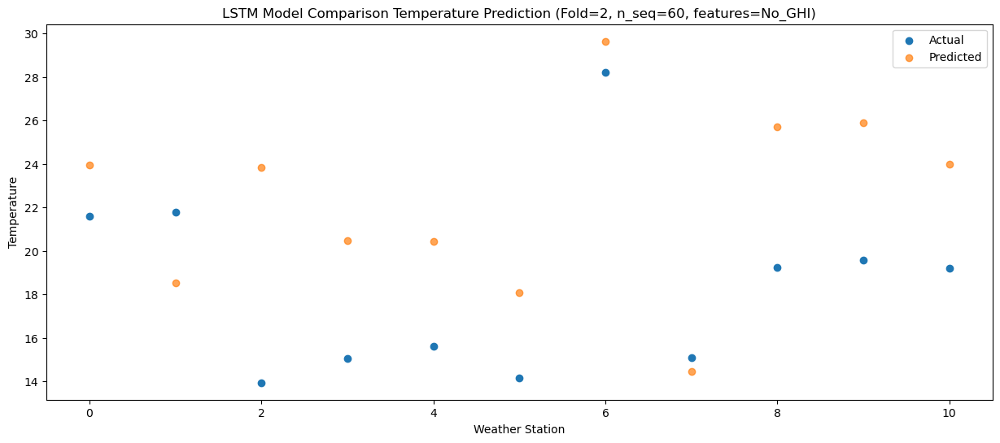

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   17.61  20.456287
1                 1   18.04  15.036735
2                 2   13.63  20.352724
3                 3   11.54  17.000466
4                 4   12.82  16.959314
5                 5   11.44  14.588374
6                 6   24.00  26.157362
7                 7   11.06  10.963088
8                 8   17.39  22.208055
9                 9   16.64  22.394464
10               10   16.62  20.489629


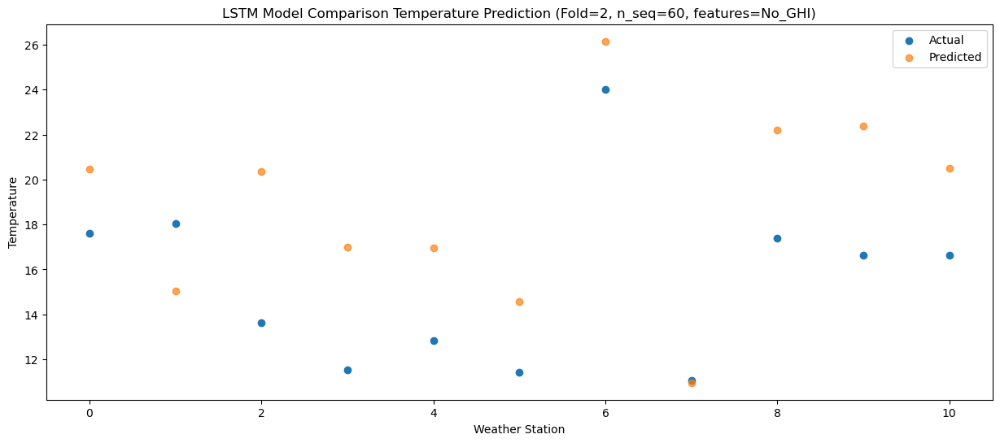

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   13.34  15.378414
1                 1   13.07   9.955241
2                 2   10.16  15.270962
3                 3    6.28  11.926767
4                 4    8.13  11.881058
5                 5    8.79   9.512194
6                 6   21.03  21.078852
7                 7    6.80   5.889957
8                 8   14.40  17.137350
9                 9   11.42  17.322049
10               10   10.20  15.415834


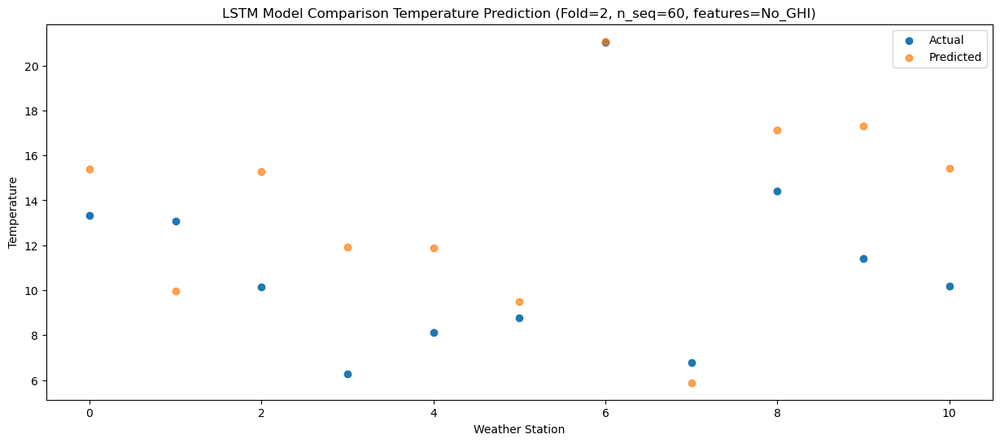

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_14 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_14 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_15 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_15 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_21 (Dense)            (1, 256)                  262400    
                                                                 
 dense_22 (Dense)            (1, 128)                  32896     
                                                                 
 dense_23 (Dense)            (1, 60)                  

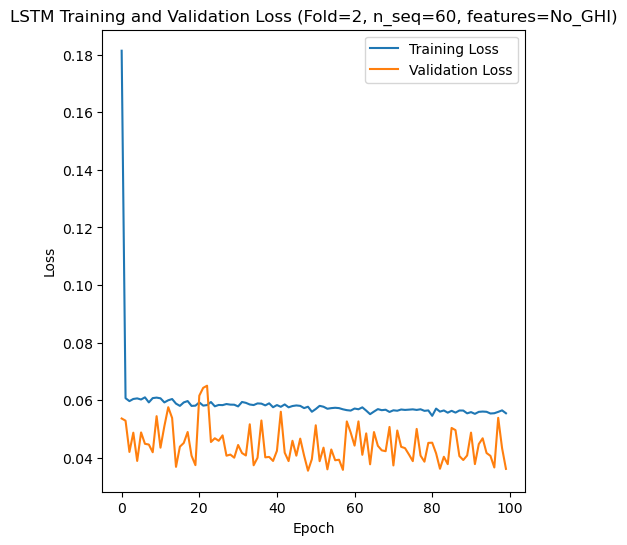

Epoch 1/100
84/84 [==============================] - 8s 50ms/step - loss: 0.1575 - accuracy: 0.3929 - mae: 0.1348 - rmse: 0.1575 - mape: 31.0149 - pearson: 0.6460 - val_loss: 0.0781 - val_accuracy: 0.5000 - val_mae: 0.0621 - val_rmse: 0.0781 - val_mape: 14.4623 - val_pearson: 0.7719
Epoch 2/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0601 - accuracy: 0.5952 - mae: 0.0475 - rmse: 0.0601 - mape: 11.2401 - pearson: 0.8505 - val_loss: 0.0794 - val_accuracy: 0.5000 - val_mae: 0.0619 - val_rmse: 0.0794 - val_mape: 13.8383 - val_pearson: 0.7465
Epoch 3/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0572 - accuracy: 0.5238 - mae: 0.0452 - rmse: 0.0572 - mape: 10.6663 - pearson: 0.8590 - val_loss: 0.0881 - val_accuracy: 0.5000 - val_mae: 0.0696 - val_rmse: 0.0881 - val_mape: 15.8440 - val_pearson: 0.7028
Epoch 4/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0592 - accuracy: 0.5119 - mae: 0.0469 - rmse: 0.0592 - mape: 11.0390 - p

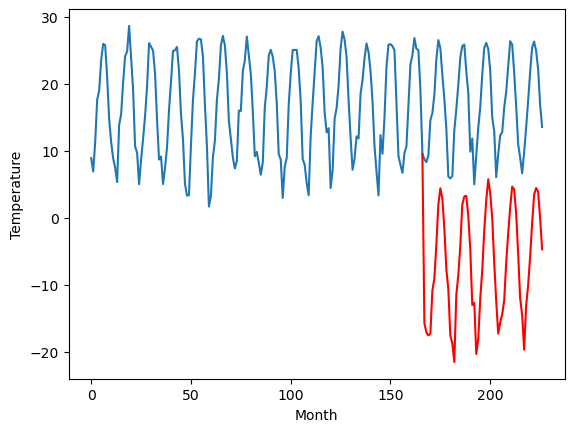

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.89		2.05		-0.84
1.54		0.69		-0.85
0.70		0.24		-0.46
0.85		0.53		-0.32
8.34		6.96		-1.38
9.26		8.75		-0.51
13.66		13.80		0.14
20.76		19.80		-0.96
22.62		22.22		-0.40
20.76		20.70		-0.06
17.09		16.21		-0.88
9.98		10.16		0.18
7.16		7.12		-0.04
0.61		0.24		-0.37
-0.54		-0.91		-0.37
-4.26		-3.71		0.55
7.71		6.34		-1.37
9.57		9.24		-0.33
13.79		13.60		-0.19
20.50		19.77		-0.73
21.81		21.00		-0.81
22.38		21.07		-1.31
19.65		18.08		-1.57
13.05		13.07		0.02
5.34		4.78		-0.56
6.65		5.14		-1.51
-2.18		-2.54		-0.36
-0.96		-0.29		0.67
5.82		5.75		-0.07
10.67		9.94		-0.73
16.10		15.91		-0.19
21.25		20.39		-0.86
25.29		23.53		-1.76
22.21		21.46		-0.75
18.35		17.75		-0.60
11.80		11.07		-0.73
4.57		5.32		0.75
0.52		0.50		-0.02
1.22		2.17		0.95
3.18		3.38		0.20
5.78		5.43		-0.35
10.83		11.03		0.20
16.14		15.46		-0.68
20.47		19.32		-1.15
22.73		22.42		-0.31
22.91		22.00		-0.91
18.86		18.38		-0.48
11.92		12.38

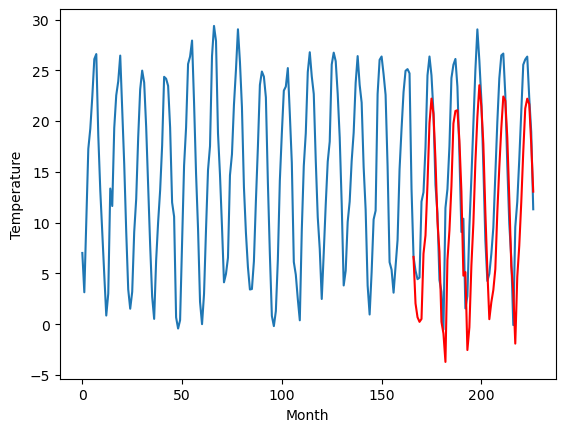

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.73		1.54		-3.19
2.20		0.18		-2.02
0.98		-0.27		-1.25
3.40		0.01		-3.39
5.19		6.44		1.25
9.85		8.24		-1.61
15.04		13.28		-1.76
18.39		19.28		0.89
21.17		21.69		0.52
21.70		20.19		-1.51
17.37		15.69		-1.68
11.88		9.64		-2.24
3.23		6.60		3.37
0.03		-0.28		-0.31
1.29		-1.42		-2.71
3.59		-4.21		-7.80
4.74		5.82		1.08
10.47		8.72		-1.75
15.27		13.07		-2.20
20.12		19.23		-0.89
23.25		20.46		-2.79
21.05		20.53		-0.52
17.74		17.54		-0.20
9.08		12.53		3.45
4.74		4.24		-0.50
0.82		4.59		3.77
0.49		-3.09		-3.58
2.19		-0.85		-3.04
6.90		5.18		-1.72
9.97		9.37		-0.60
14.21		15.35		1.14
19.60		19.83		0.23
22.17		22.98		0.81
22.35		20.91		-1.44
19.53		17.20		-2.33
12.35		10.51		-1.84
1.62		4.76		3.14
0.66		-0.05		-0.71
2.05		1.62		-0.43
1.20		2.83		1.63
4.07		4.89		0.82
9.70		10.48		0.78
14.14		14.91		0.77
16.94		18.76		1.82
22.60		21.88		-0.72
20.91		21.46		0.55
17.14		17.84		0.70
11.83		11.85		0.02
4.92	

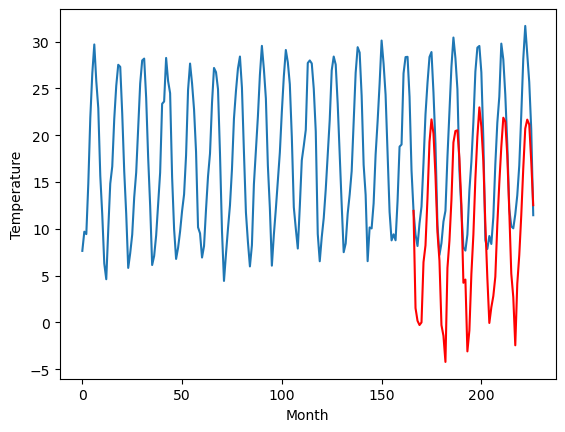

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-7.31		-4.31		3.00
-7.30		-5.67		1.63
-7.85		-6.13		1.72
-8.20		-5.84		2.36
-1.29		0.59		1.88
-0.65		2.38		3.03
3.92		7.43		3.51
9.74		13.43		3.69
13.54		15.85		2.31
11.12		14.33		3.21
7.06		9.84		2.78
1.64		3.79		2.15
-2.28		0.75		3.03
-9.48		-6.13		3.35
-10.94		-7.28		3.66
-12.26		-10.08		2.18
-2.05		-0.04		2.01
0.30		2.87		2.57
4.37		7.22		2.85
10.29		13.39		3.10
11.28		14.62		3.34
11.80		14.70		2.90
7.67		11.71		4.04
4.09		6.69		2.60
-5.57		-1.60		3.97
-4.08		-1.24		2.84
-13.03		-8.92		4.11
-8.51		-6.68		1.83
-2.76		-0.63		2.13
0.25		3.56		3.31
7.03		9.53		2.50
10.51		14.01		3.50
12.06		17.16		5.10
10.99		15.09		4.10
7.01		11.37		4.36
-0.26		4.68		4.94
-3.38		-1.06		2.32
-8.65		-5.88		2.77
-6.90		-4.21		2.69
-4.56		-3.00		1.56
-4.32		-0.94		3.38
1.92		4.65		2.73
4.61		9.08		4.47
8.35		12.93		4.58
11.97		16.04		4.07
10.86		15.62		4.76
8.13		12.00		3.87
2.69		6.00		3.31
-3.70		-0.63		3.07
-

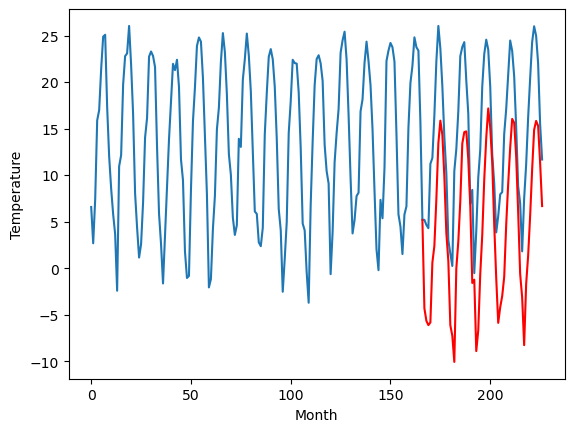

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.64		1.38		-4.26
2.38		0.03		-2.35
-0.49		-0.44		0.05
0.66		-0.15		-0.81
8.07		6.28		-1.79
11.10		8.07		-3.03
17.17		13.12		-4.05
24.22		19.13		-5.09
25.68		21.55		-4.13
23.12		20.03		-3.09
19.05		15.53		-3.52
11.32		9.48		-1.84
8.50		6.44		-2.06
1.33		-0.45		-1.78
-0.14		-1.60		-1.46
-4.01		-4.41		-0.40
9.07		5.63		-3.44
12.36		8.54		-3.82
16.93		12.89		-4.04
24.41		19.06		-5.35
24.41		20.29		-4.12
24.53		20.36		-4.17
21.17		17.37		-3.80
15.75		12.36		-3.39
6.01		4.06		-1.95
5.65		4.42		-1.23
-3.82		-3.26		0.56
-1.30		-1.02		0.28
7.16		5.04		-2.12
11.29		9.23		-2.06
18.86		15.20		-3.66
24.31		19.67		-4.64
25.43		22.82		-2.61
23.61		20.74		-2.87
19.29		17.03		-2.26
12.02		10.34		-1.68
6.13		4.60		-1.53
0.16		-0.22		-0.38
1.88		1.45		-0.43
8.40		2.65		-5.75
5.44		4.70		-0.74
12.65		10.29		-2.36
18.65		14.73		-3.92
22.75		18.59		-4.16
24.45		21.69		-2.76
23.16		21.27		-1.89
19.80		17.65		-2.15

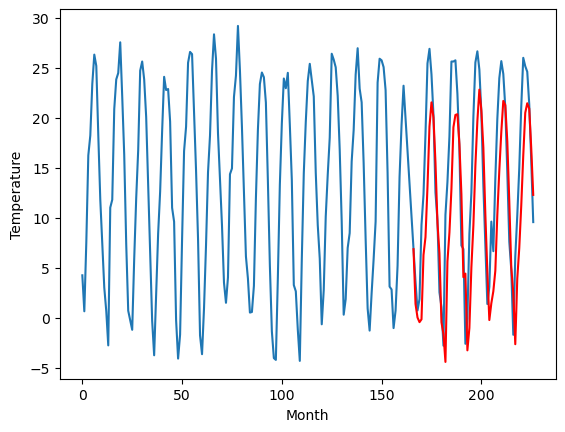

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.05		-0.50		2.55
-2.84		-1.86		0.98
-4.26		-2.32		1.94
-4.67		-2.04		2.63
2.19		4.39		2.20
4.46		6.18		1.72
9.87		11.23		1.36
16.86		17.24		0.38
18.75		19.66		0.91
16.24		18.15		1.91
12.61		13.65		1.04
6.61		7.58		0.97
2.67		4.55		1.88
-4.94		-2.34		2.60
-6.39		-3.49		2.90
-9.11		-6.31		2.80
2.22		3.74		1.52
5.67		6.65		0.98
9.95		11.00		1.05
16.66		17.17		0.51
17.04		18.40		1.36
17.36		18.47		1.11
14.10		15.48		1.38
9.52		10.47		0.95
-1.33		2.17		3.50
-0.28		2.53		2.81
-9.10		-5.15		3.95
-5.91		-2.90		3.01
1.05		3.15		2.10
4.90		7.34		2.44
12.70		13.31		0.61
16.64		17.79		1.15
18.63		20.93		2.30
16.98		18.85		1.87
13.03		15.14		2.11
6.99		8.45		1.46
0.44		2.71		2.27
-5.10		-2.12		2.98
-2.96		-0.44		2.52
-1.24		0.76		2.00
-0.34		2.81		3.15
5.89		8.40		2.51
11.30		12.83		1.53
14.76		16.69		1.93
18.02		19.79		1.77
16.47		19.37		2.90
13.01		15.74		2.73
7.36		9.74		2.38
0.88		3.11		2.23
-1.58		

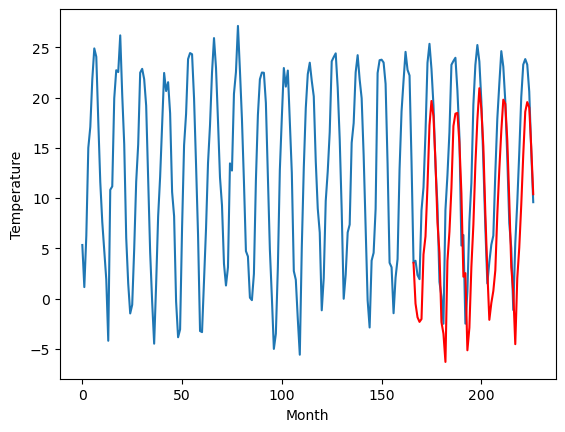

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.14		0.15		4.29
-9.81		-1.22		8.59
-9.90		-1.68		8.22
-9.71		-1.39		8.32
-4.78		5.04		9.82
-1.80		6.83		8.63
5.31		11.88		6.57
9.52		17.89		8.37
11.51		20.30		8.79
12.26		18.79		6.53
6.76		14.30		7.54
3.02		8.24		5.22
-4.17		5.20		9.37
-9.87		-1.68		8.19
-9.60		-2.83		6.77
-9.50		-5.63		3.87
-6.53		4.41		10.94
-1.75		7.31		9.06
3.30		11.67		8.37
10.69		17.83		7.14
12.53		19.05		6.52
10.61		19.12		8.51
8.74		16.13		7.39
0.77		11.12		10.35
-1.97		2.82		4.79
-6.73		3.17		9.90
-9.02		-4.50		4.52
-10.74		-2.26		8.48
-6.20		3.79		9.99
-1.88		7.98		9.86
4.03		13.96		9.93
9.80		18.43		8.63
11.72		21.58		9.86
10.96		19.51		8.55
8.80		15.79		6.99
0.54		9.10		8.56
-7.14		3.35		10.49
-9.31		-1.47		7.84
-10.04		0.21		10.25
-10.01		1.42		11.43
-8.22		3.47		11.69
-2.88		9.06		11.94
4.33		13.50		9.17
8.91		17.35		8.44
15.05		20.47		5.42
12.46		20.05		7.59
8.31		16.42		8.11
2.18		10.42		8.24
-3.68		3.79		7.

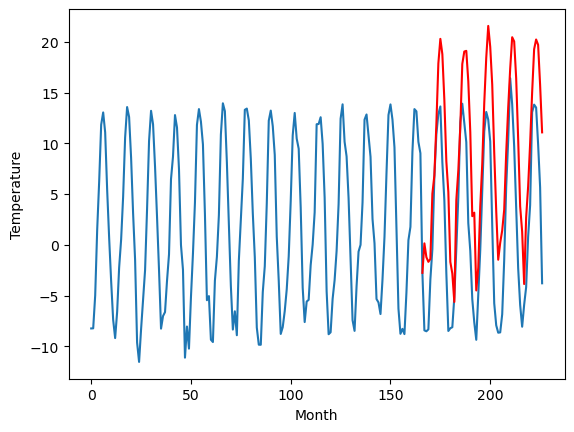

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		-0.92		-2.57
-3.08		-2.29		0.79
-1.92		-2.74		-0.82
-0.41		-2.47		-2.06
2.70		3.97		1.27
8.61		5.76		-2.85
15.88		10.81		-5.07
19.34		16.81		-2.53
23.57		19.22		-4.35
23.68		17.72		-5.96
18.87		13.23		-5.64
11.93		7.17		-4.76
3.12		4.13		1.01
-2.57		-2.75		-0.18
-2.02		-3.89		-1.87
0.83		-6.68		-7.51
2.43		3.37		0.94
10.40		6.26		-4.14
14.83		10.62		-4.21
22.47		16.79		-5.68
23.55		18.01		-5.54
22.32		18.08		-4.24
18.35		15.09		-3.26
8.00		10.07		2.07
5.48		1.78		-3.70
-1.79		2.12		3.91
-1.86		-5.55		-3.69
0.18		-3.31		-3.49
4.89		2.73		-2.16
9.52		6.92		-2.60
14.19		12.90		-1.29
20.67		17.38		-3.29
22.90		20.52		-2.38
21.31		18.45		-2.86
18.95		14.73		-4.22
11.06		8.03		-3.03
-0.36		2.28		2.64
-2.69		-2.53		0.16
-3.20		-0.85		2.35
-2.29		0.35		2.64
0.54		2.40		1.86
8.49		8.00		-0.49
14.29		12.44		-1.85
16.79		16.29		-0.50
25.15		19.40		-5.75
20.52		18.99		-1.53
15.82		15.36		-0.46
10.5

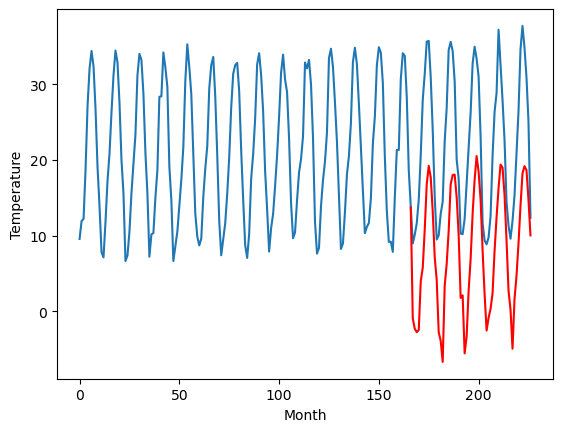

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.04		-3.23		-3.19
-1.29		-4.60		-3.31
-1.92		-5.06		-3.14
0.10		-4.78		-4.88
-0.46		1.66		2.12
3.16		3.45		0.29
5.56		8.50		2.94
8.10		14.49		6.39
7.29		16.91		9.62
9.17		15.40		6.23
8.59		10.91		2.32
6.37		4.85		-1.52
-0.79		1.81		2.60
-2.84		-5.07		-2.23
-1.62		-6.21		-4.59
-0.69		-8.99		-8.30
-0.91		1.05		1.96
1.28		3.95		2.67
5.57		8.30		2.73
7.27		14.46		7.19
6.45		15.69		9.24
7.00		15.76		8.76
6.45		12.78		6.33
3.69		7.76		4.07
0.87		-0.53		-1.40
-2.83		-0.18		2.65
-2.21		-7.84		-5.63
-1.25		-5.61		-4.36
0.98		0.43		-0.55
2.42		4.61		2.19
5.41		10.59		5.18
8.56		15.07		6.51
6.91		18.21		11.30
8.33		16.15		7.82
8.56		12.42		3.86
3.83		5.73		1.90
-1.90		-0.02		1.88
-3.10		-4.82		-1.72
-1.43		-3.15		-1.72
-3.23		-1.94		1.29
-1.77		0.11		1.88
2.31		5.71		3.40
3.34		10.15		6.81
5.24		14.00		8.76
8.25		17.12		8.87
9.28		16.70		7.42
6.67		13.09		6.42
5.21		7.09		1.88
1.17		0.46		-0.71
-0.67	

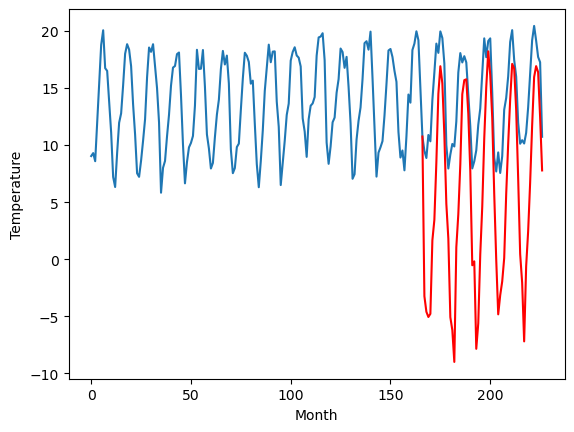

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.08		-2.18		0.90
-5.84		-3.54		2.30
-5.81		-4.00		1.81
-5.37		-3.72		1.65
-1.79		2.71		4.50
-0.35		4.51		4.86
5.21		9.56		4.35
12.19		15.56		3.37
16.14		17.97		1.83
14.96		16.46		1.50
10.62		11.97		1.35
5.30		5.91		0.61
1.23		2.86		1.63
-5.11		-4.02		1.09
-8.13		-5.16		2.97
-8.25		-7.95		0.30
-3.25		2.09		5.34
1.37		4.99		3.62
6.20		9.35		3.15
12.07		15.51		3.44
14.21		16.73		2.52
14.83		16.82		1.99
11.51		13.83		2.32
7.07		8.81		1.74
-1.85		0.52		2.37
-3.45		0.87		4.32
-10.00		-6.81		3.19
-7.24		-4.57		2.67
-3.28		1.47		4.75
1.01		5.66		4.65
6.80		11.63		4.83
11.12		16.11		4.99
15.67		19.27		3.60
15.59		17.19		1.60
10.68		13.47		2.79
4.42		6.77		2.35
0.46		1.03		0.57
-5.90		-3.78		2.12
-3.92		-2.10		1.82
-5.65		-0.91		4.74
-3.68		1.15		4.83
2.37		6.74		4.37
6.01		11.17		5.16
10.00		15.02		5.02
15.68		18.13		2.45
13.43		17.72		4.29
10.86		14.10		3.24
5.43		8.11		2.68
-2.42		1.47		3.89
-3.1

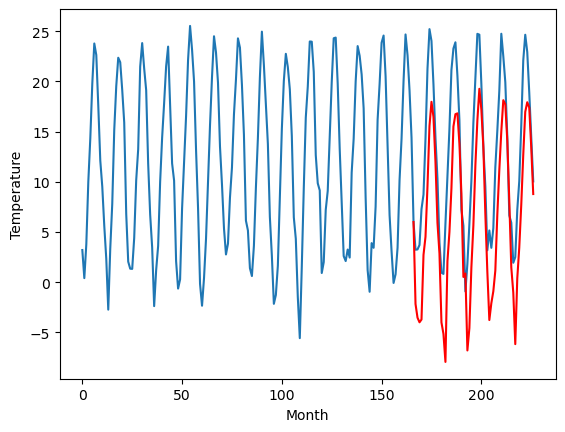

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-17.90		-15.75		2.15
-20.86		-17.12		3.74
-20.45		-17.58		2.87
-19.53		-17.30		2.23
-15.12		-10.86		4.26
-13.18		-9.06		4.12
-7.41		-4.02		3.39
-0.69		1.98		2.67
3.08		4.39		1.31
1.21		2.88		1.67
-3.76		-1.61		2.15
-9.25		-7.67		1.58
-13.53		-10.72		2.81
-20.35		-17.60		2.75
-21.91		-18.74		3.17
-22.71		-21.54		1.17
-15.52		-11.50		4.02
-10.65		-8.60		2.05
-6.39		-4.24		2.15
-0.22		1.92		2.14
1.42		3.15		1.73
1.15		3.23		2.08
-3.11		0.24		3.35
-7.23		-4.78		2.45
-17.45		-13.07		4.38
-17.86		-12.72		5.14
-24.84		-20.40		4.44
-21.03		-18.16		2.87
-15.85		-12.11		3.74
-12.03		-7.92		4.11
-5.25		-1.95		3.30
-1.26		2.53		3.79
2.52		5.69		3.17
1.65		3.62		1.97
-3.58		-0.11		3.47
-11.19		-6.80		4.39
-14.31		-12.54		1.77
-21.34		-17.35		3.99
-18.69		-15.68		3.01
-18.48		-14.49		3.99
-16.92		-12.43		4.49
-9.35		-6.84		2.51
-6.88		-2.42		4.46
-2.95		1.43		4.38
1.89		4.54		2.65
-0.08		4.13		4.21
-3.37	

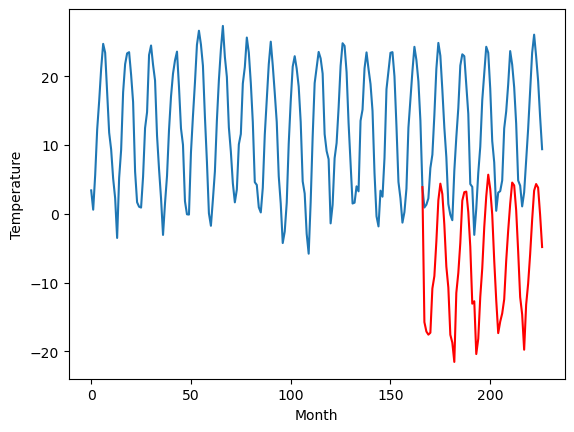

RangeIndex(start=1, stop=12, step=1)
[-17.9, 2.8899999999999997, 4.729999999999999, -7.31, 5.640000000000001, -3.0500000000000007, -4.139999999999999, 1.6500000000000012, -0.03999999999999826, -3.08, -17.9]
[-15.755185356140137, 2.053054637908936, 1.5424695396423331, -4.313306617736816, 1.3835295677185062, -0.5024509239196782, 0.14564933776855504, -0.9225341606140134, -3.234915256500244, -2.176014347076416, -15.753512134552002]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0  -17.90 -15.755185
1                 1    2.89   2.053055
2                 2    4.73   1.542470
3                 3   -7.31  -4.313307
4                 4    5.64   1.383530
5                 5   -3.05  -0.502451
6                 6   -4.14   0.145649
7                 7    1.65  -0.922534
8                 8   -0.04  -3.234915
9                 9   -3.08  -2.176014
10               10  -17.90 -15.753512


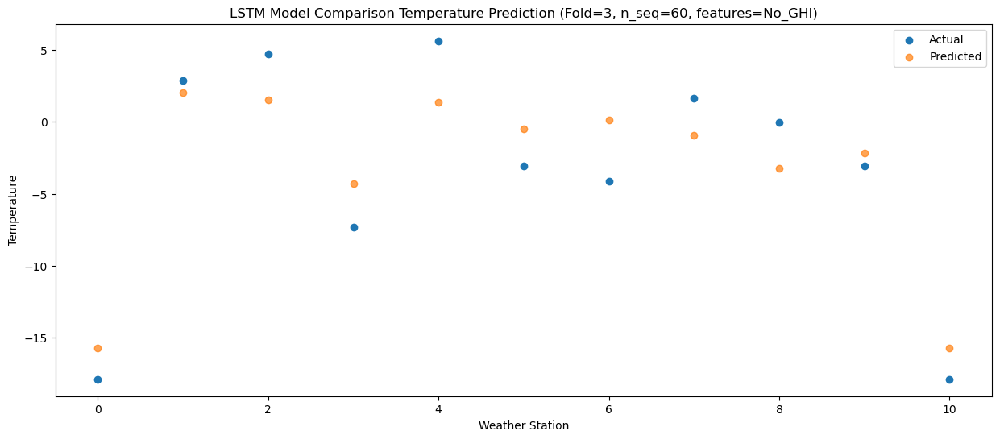

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0  -18.68 -17.115023
1                 1    1.54   0.694306
2                 2    2.20   0.181868
3                 3   -7.30  -5.669617
4                 4    2.38   0.025666
5                 5   -2.84  -1.860590
6                 6   -9.81  -1.215541
7                 7   -3.08  -2.290415
8                 8   -1.29  -4.600150
9                 9   -5.84  -3.542812
10               10  -20.86 -17.117928


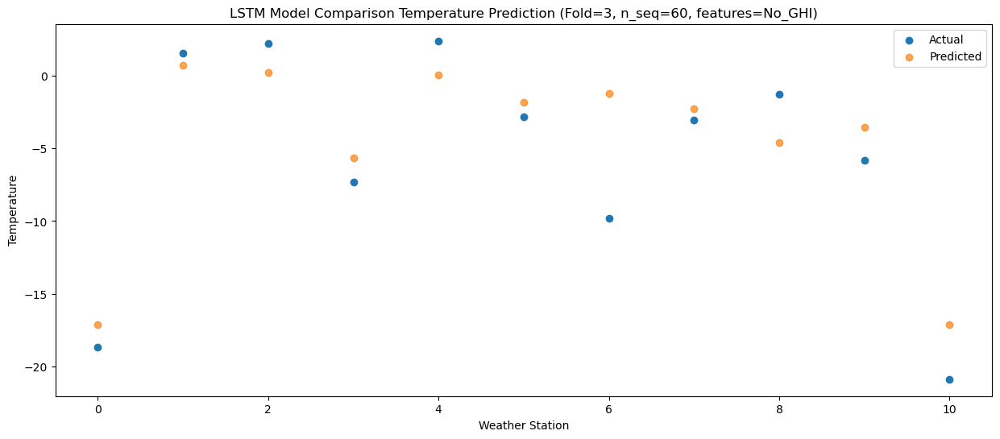

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0  -19.10 -17.573736
1                 1    0.70   0.237536
2                 2    0.98  -0.272107
3                 3   -7.85  -6.125877
4                 4   -0.49  -0.435272
5                 5   -4.26  -2.320986
6                 6   -9.90  -1.675343
7                 7   -1.92  -2.743630
8                 8   -1.92  -5.056071
9                 9   -5.81  -4.001016
10               10  -20.45 -17.575200


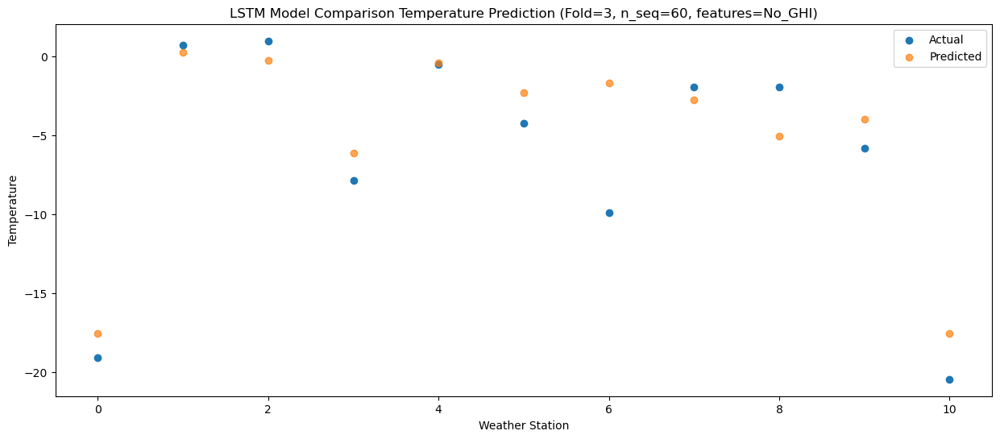

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0  -18.09 -17.287202
1                 1    0.85   0.525441
2                 2    3.40   0.008411
3                 3   -8.20  -5.838841
4                 4    0.66  -0.152054
5                 5   -4.67  -2.035424
6                 6   -9.71  -1.392283
7                 7   -0.41  -2.467732
8                 8    0.10  -4.779659
9                 9   -5.37  -3.724967
10               10  -19.53 -17.296569


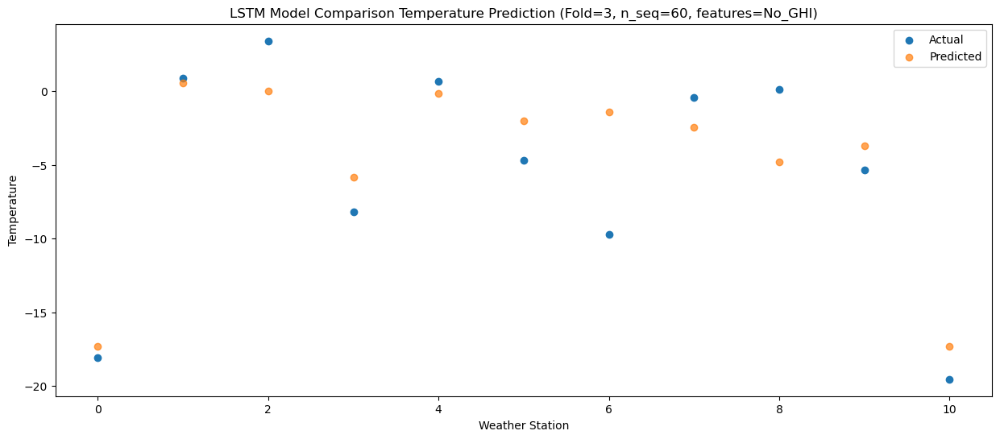

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0  -12.83 -10.863285
1                 1    8.34   6.955665
2                 2    5.19   6.440206
3                 3   -1.29   0.589180
4                 4    8.07   6.278992
5                 5    2.19   4.393736
6                 6   -4.78   5.041450
7                 7    2.70   3.970243
8                 8   -0.46   1.655421
9                 9   -1.79   2.709361
10               10  -15.12 -10.864617


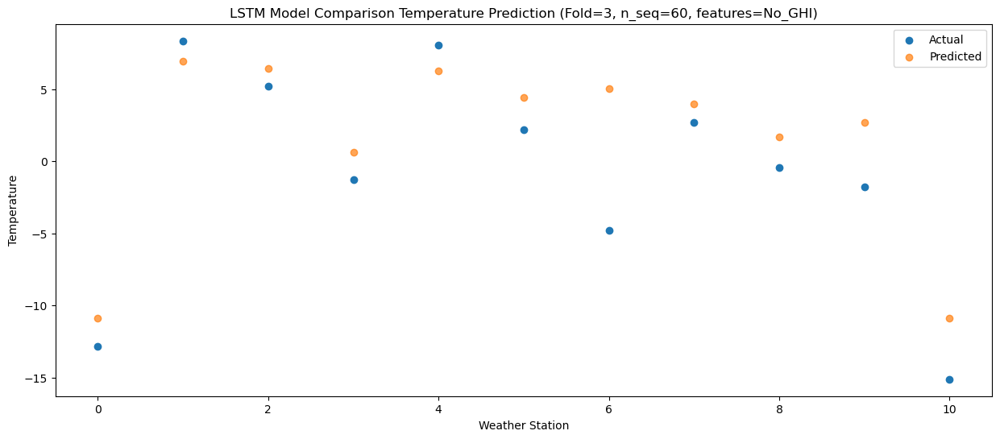

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0  -11.76  -9.069387
1                 1    9.26   8.749748
2                 2    9.85   8.238620
3                 3   -0.65   2.381304
4                 4   11.10   8.072060
5                 5    4.46   6.183709
6                 6   -1.80   6.833227
7                 7    8.61   5.764256
8                 8    3.16   3.452210
9                 9   -0.35   4.514314
10               10  -13.18  -9.058225


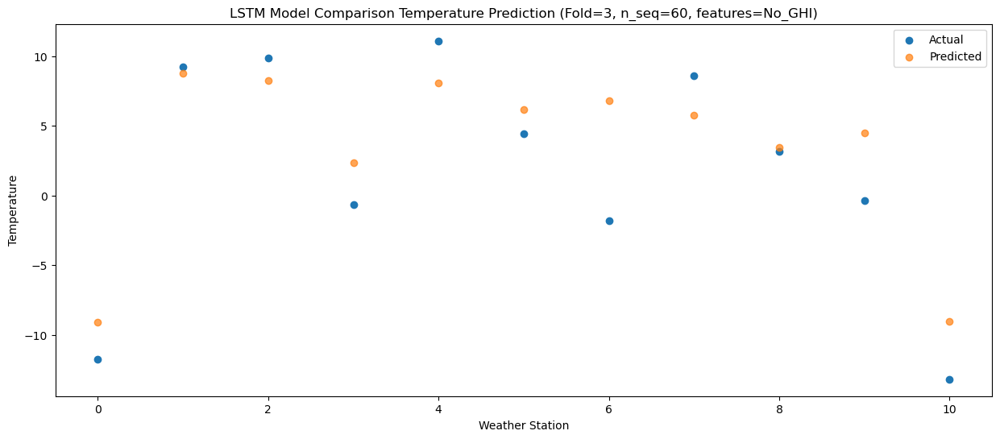

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   -9.07  -4.018456
1                 1   13.66  13.800347
2                 2   15.04  13.283898
3                 3    3.92   7.429763
4                 4   17.17  13.118761
5                 5    9.87  11.230738
6                 6    5.31  11.881858
7                 7   15.88  10.812965
8                 8    5.56   8.501668
9                 9    5.21   9.563033
10               10   -7.41  -4.016228


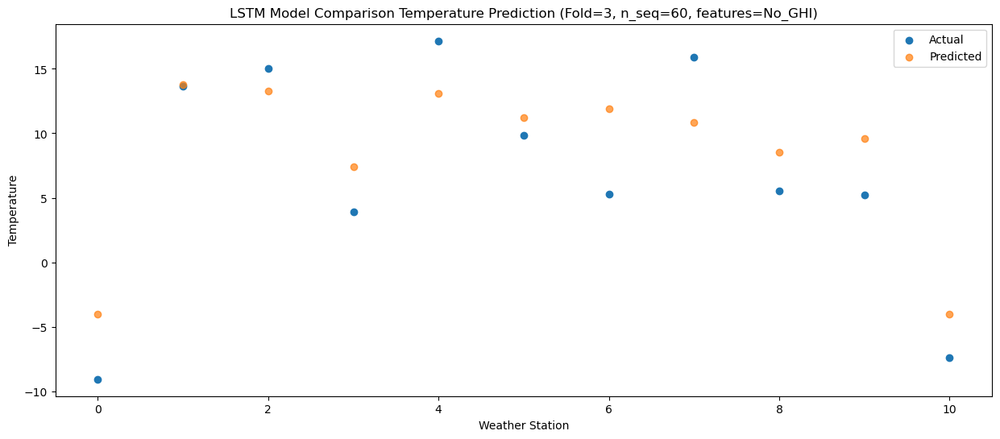

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75   1.977818
1                 1   20.76  19.802175
2                 2   18.39  19.276471
3                 3    9.74  13.430826
4                 4   24.22  19.128897
5                 5   16.86  17.240963
6                 6    9.52  17.886064
7                 7   19.34  16.808874
8                 8    8.10  14.493118
9                 9   12.19  15.557254
10               10   -0.69   1.981977


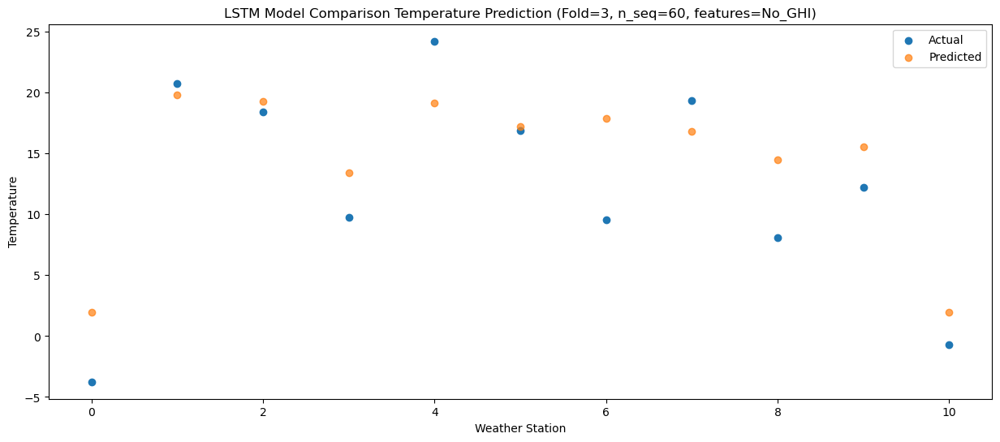

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89   4.390500
1                 1   22.62  22.216532
2                 2   21.17  21.694780
3                 3   13.54  15.847065
4                 4   25.68  21.545253
5                 5   18.75  19.660474
6                 6   11.51  20.302726
7                 7   23.57  19.224449
8                 8    7.29  16.909370
9                 9   16.14  17.967567
10               10    3.08   4.386083


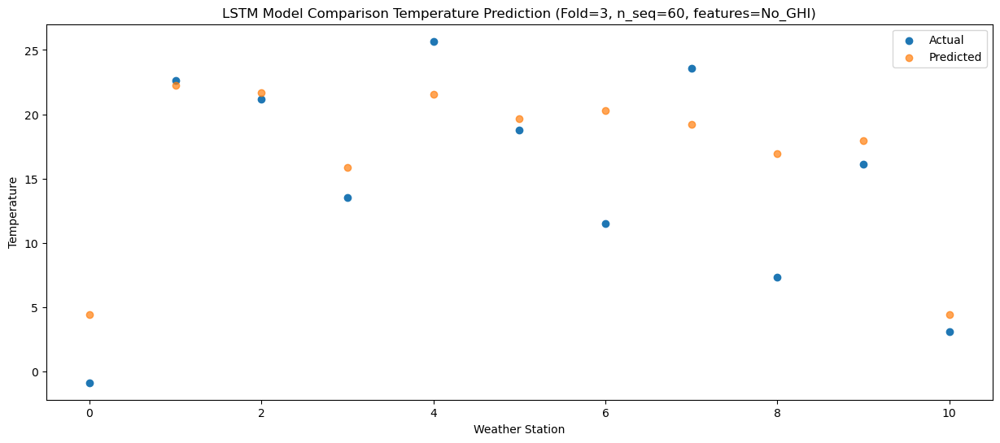

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12   2.873525
1                 1   20.76  20.704970
2                 2   21.70  20.186675
3                 3   11.12  14.334416
4                 4   23.12  20.033672
5                 5   16.24  18.146050
6                 6   12.26  18.792077
7                 7   23.68  17.719794
8                 8    9.17  15.404641
9                 9   14.96  16.459831
10               10    1.21   2.878041


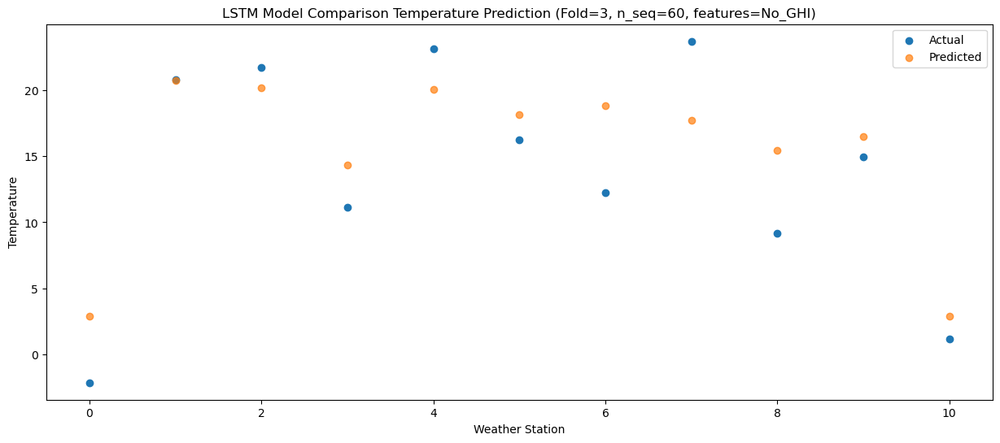

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09  -1.615447
1                 1   17.09  16.206891
2                 2   17.37  15.689915
3                 3    7.06   9.844187
4                 4   19.05  15.531758
5                 5   12.61  13.645333
6                 6    6.76  14.298785
7                 7   18.87  13.231011
8                 8    8.59  10.914320
9                 9   10.62  11.973590
10               10   -3.76  -1.607149


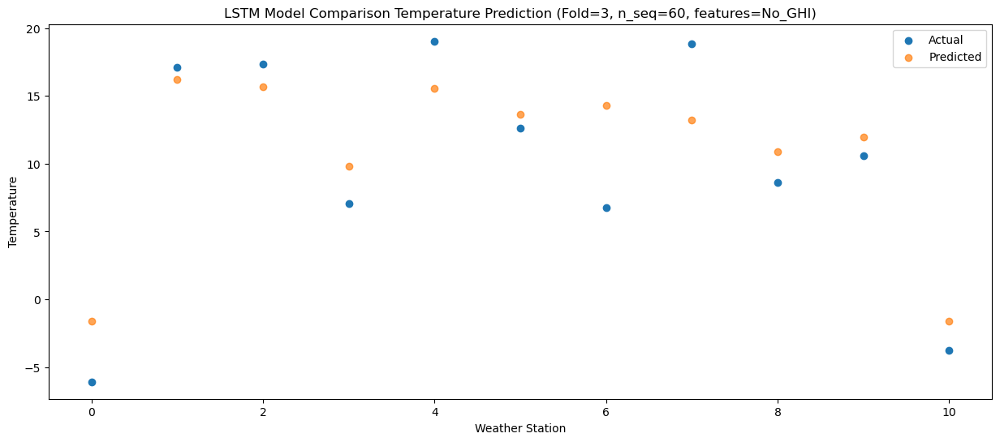

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66  -7.673721
1                 1    9.98  10.157873
2                 2   11.88   9.638436
3                 3    1.64   3.789282
4                 4   11.32   9.475975
5                 5    6.61   7.584392
6                 6    3.02   8.235850
7                 7   11.93   7.167370
8                 8    6.37   4.854799
9                 9    5.30   5.912102
10               10   -9.25  -7.668665


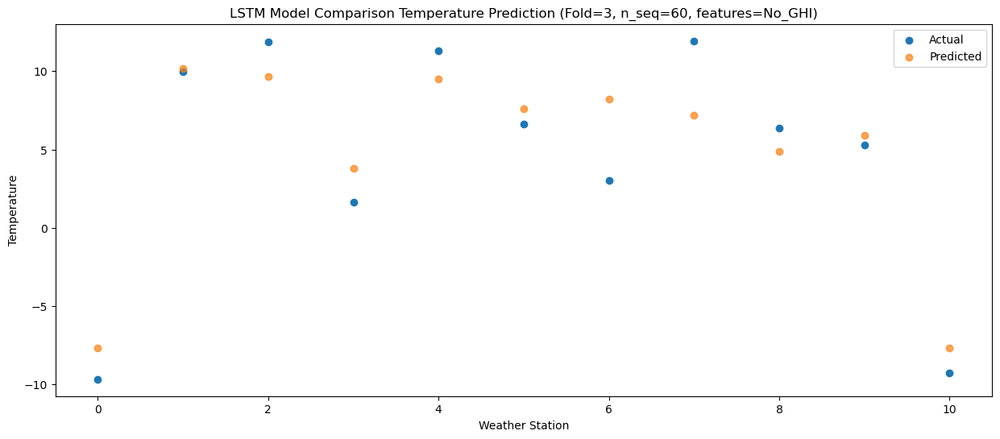

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -10.715860
1                 1    7.16   7.122516
2                 2    3.23   6.596769
3                 3   -2.28   0.749517
4                 4    8.50   6.437467
5                 5    2.67   4.547332
6                 6   -4.17   5.197725
7                 7    3.12   4.131375
8                 8   -0.79   1.809897
9                 9    1.23   2.864556
10               10  -13.53 -10.719043


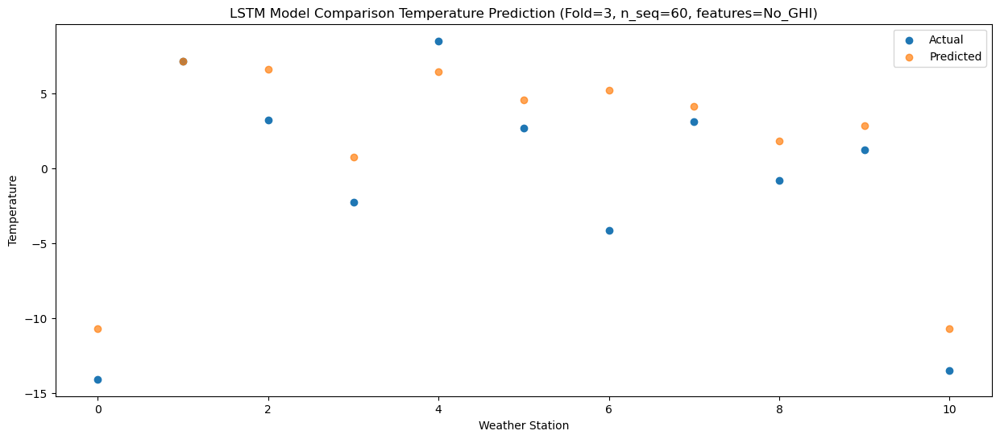

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -17.590873
1                 1    0.61   0.241111
2                 2    0.03  -0.281743
3                 3   -9.48  -6.133316
4                 4    1.33  -0.447948
5                 5   -4.94  -2.339850
6                 6   -9.87  -1.684103
7                 7   -2.57  -2.746637
8                 8   -2.84  -5.069724
9                 9   -5.11  -4.016010
10               10  -20.35 -17.596975


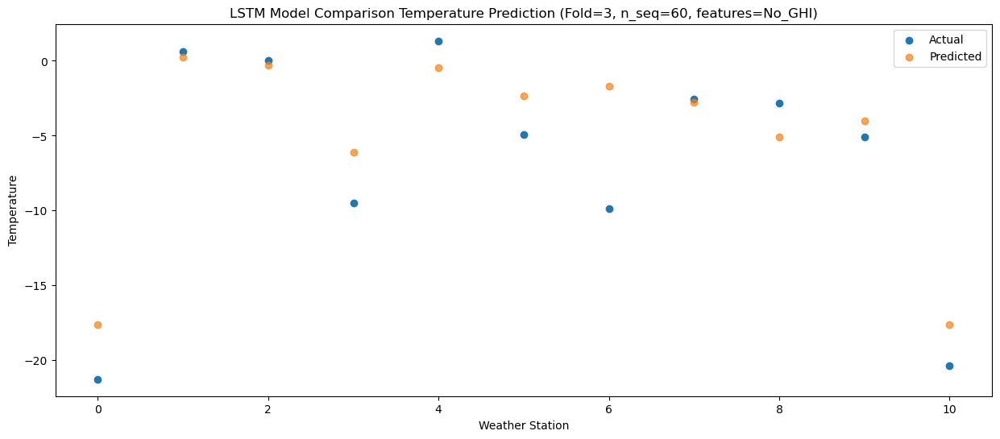

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -18.730614
1                 1   -0.54  -0.905923
2                 2    1.29  -1.422104
3                 3  -10.94  -7.280174
4                 4   -0.14  -1.601909
5                 5   -6.39  -3.492284
6                 6   -9.60  -2.828805
7                 7   -2.02  -3.888195
8                 8   -1.62  -6.207325
9                 9   -8.13  -5.155232
10               10  -21.91 -18.742827


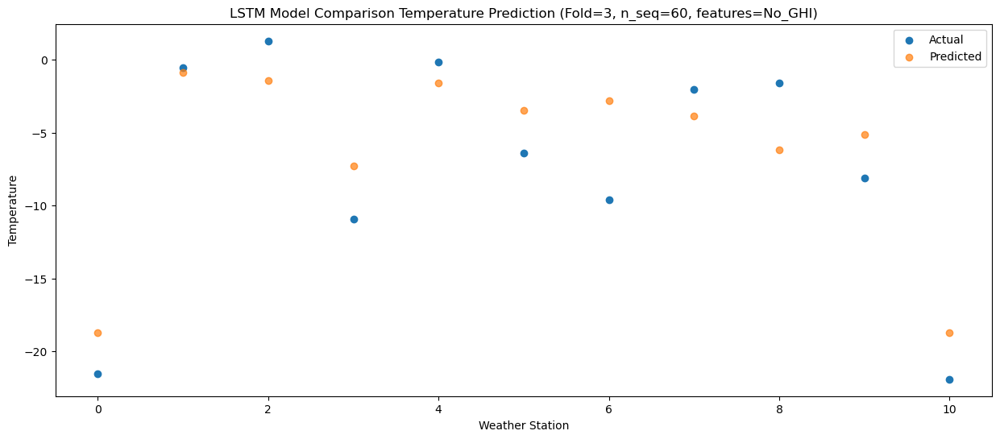

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -21.520619
1                 1   -4.26  -3.706794
2                 2    3.59  -4.212187
3                 3  -12.26 -10.080390
4                 4   -4.01  -4.412955
5                 5   -9.11  -6.305740
6                 6   -9.50  -5.632140
7                 7    0.83  -6.675621
8                 8   -0.69  -8.992363
9                 9   -8.25  -7.949550
10               10  -22.71 -21.541657


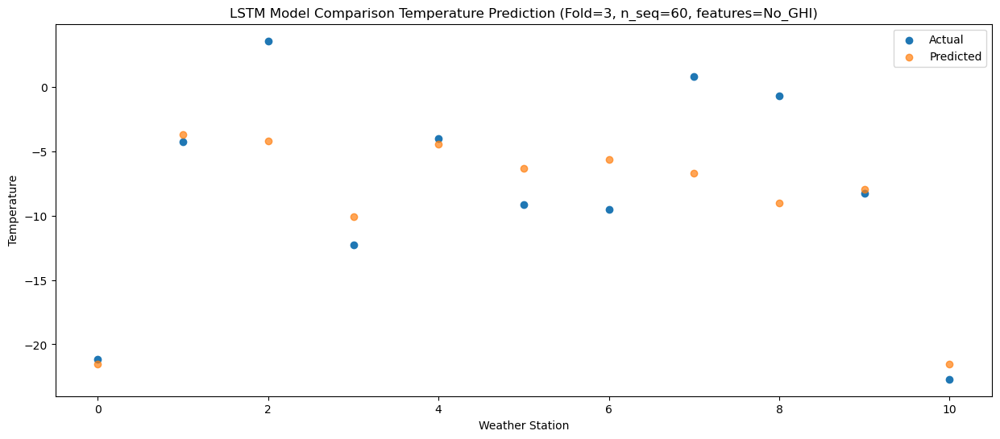

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -11.481491
1                 1    7.71   6.337785
2                 2    4.74   5.821811
3                 3   -2.05  -0.040016
4                 4    9.07   5.630802
5                 5    2.22   3.738812
6                 6   -6.53   4.406867
7                 7    2.43   3.365779
8                 8   -0.91   1.047914
9                 9   -3.25   2.086461
10               10  -15.52 -11.504614


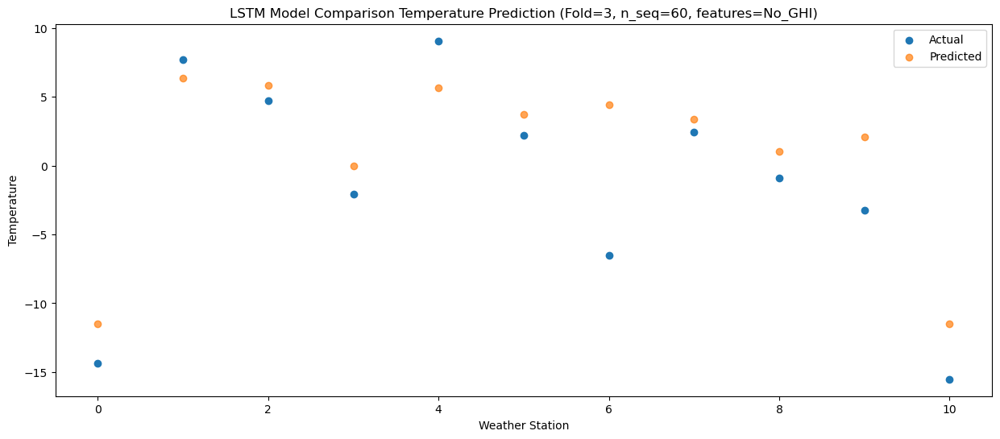

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21  -8.577535
1                 1    9.57   9.241369
2                 2   10.47   8.718943
3                 3    0.30   2.865224
4                 4   12.36   8.535460
5                 5    5.67   6.647083
6                 6   -1.75   7.309317
7                 7   10.40   6.264634
8                 8    1.28   3.947322
9                 9    1.37   4.991398
10               10  -10.65  -8.596028


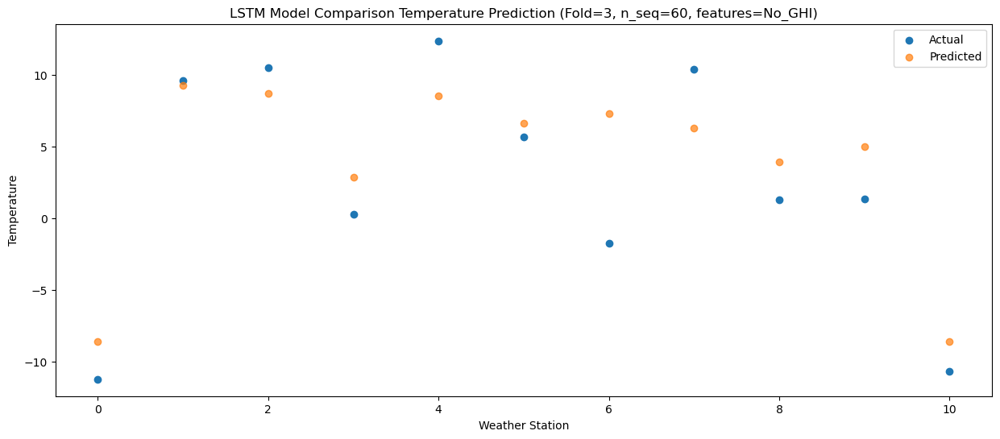

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55  -4.219575
1                 1   13.79  13.597586
2                 2   15.27  13.073254
3                 3    4.37   7.223834
4                 4   16.93  12.891058
5                 5    9.95  11.003284
6                 6    3.30  11.665842
7                 7   14.83  10.621485
8                 8    5.57   8.303513
9                 9    6.20   9.349229
10               10   -6.39  -4.239295


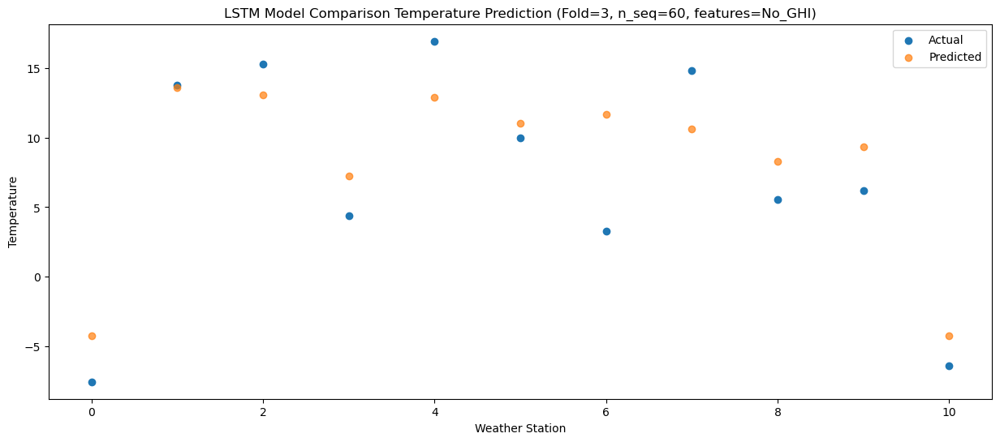

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49   1.947102
1                 1   20.50  19.769072
2                 2   20.12  19.231736
3                 3   10.29  13.388762
4                 4   24.41  19.060337
5                 5   16.66  17.171795
6                 6   10.69  17.831728
7                 7   22.47  16.785956
8                 8    7.27  14.463123
9                 9   12.07  15.510544
10               10   -0.22   1.922356


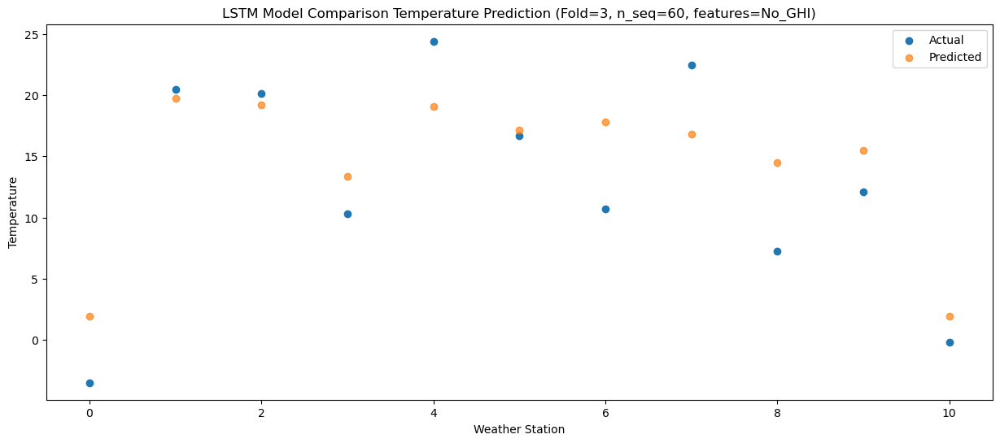

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78   3.173005
1                 1   21.81  20.997726
2                 2   23.25  20.455790
3                 3   11.28  14.617516
4                 4   24.41  20.289410
5                 5   17.04  18.399881
6                 6   12.53  19.053140
7                 7   23.55  18.010323
8                 8    6.45  15.688414
9                 9   14.21  16.734436
10               10    1.42   3.147221


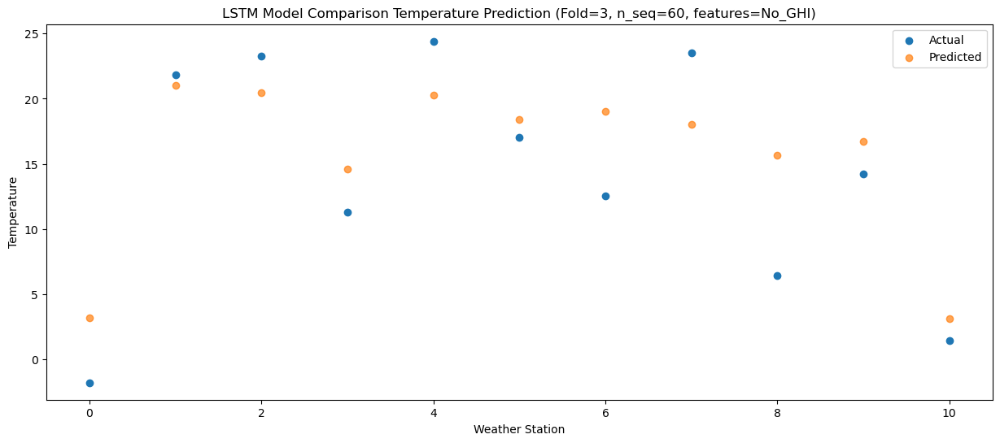

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56   3.257573
1                 1   22.38  21.071063
2                 2   21.05  20.531815
3                 3   11.80  14.696574
4                 4   24.53  20.361007
5                 5   17.36  18.470057
6                 6   10.61  19.122015
7                 7   22.32  18.076759
8                 8    7.00  15.763588
9                 9   14.83  16.817870
10               10    1.15   3.232887


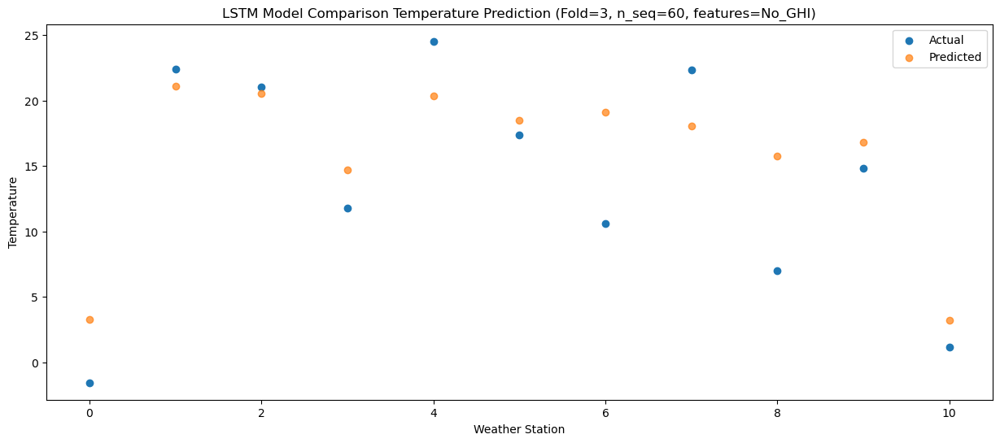

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55   0.265619
1                 1   19.65  18.084938
2                 2   17.74  17.543863
3                 3    7.67  11.705530
4                 4   21.17  17.374835
5                 5   14.10  15.482164
6                 6    8.74  16.134474
7                 7   18.35  15.088238
8                 8    6.45  12.775616
9                 9   11.51  13.827299
10               10   -3.11   0.242698


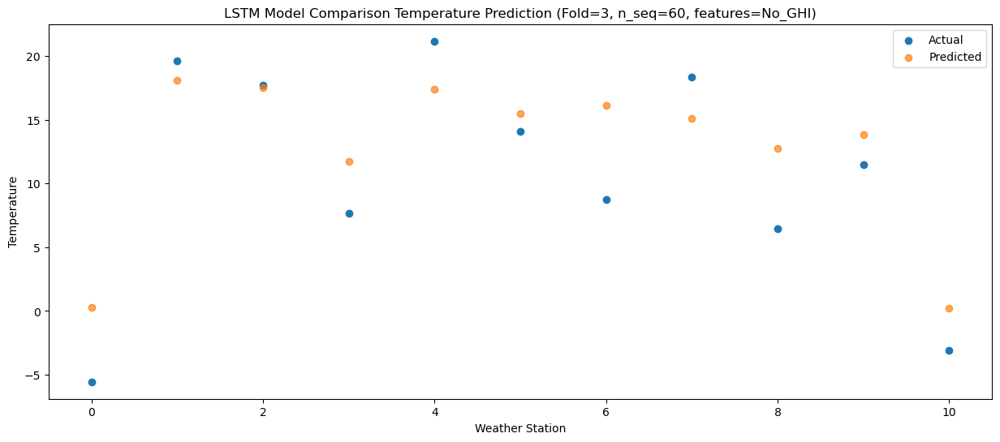

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78  -4.744835
1                 1   13.05  13.068569
2                 2    9.08  12.525178
3                 3    4.09   6.687614
4                 4   15.75  12.357997
5                 5    9.52  10.467415
6                 6    0.77  11.116411
7                 7    8.00  10.066442
8                 8    3.69   7.755692
9                 9    7.07   8.805527
10               10   -7.23  -4.779086


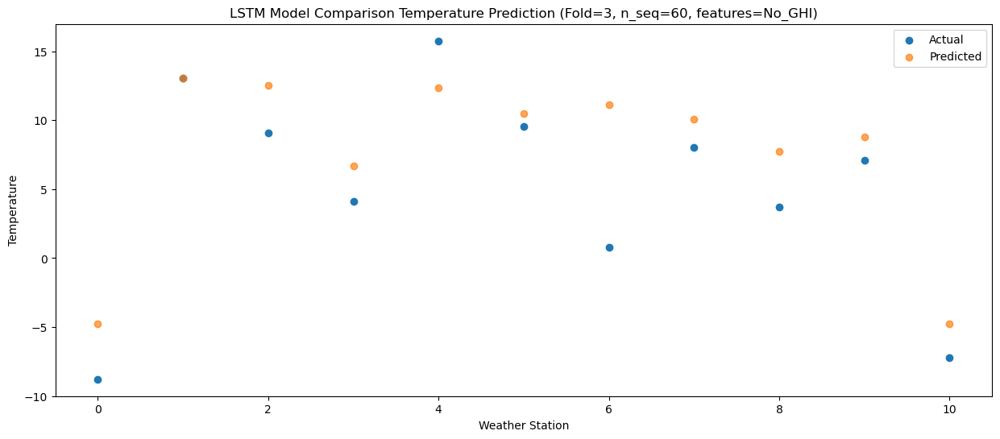

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -13.030052
1                 1    5.34   4.781445
2                 2    4.74   4.239306
3                 3   -5.57  -1.599895
4                 4    6.01   4.064125
5                 5   -1.33   2.171025
6                 6   -1.97   2.824215
7                 7    5.48   1.777047
8                 8    0.87  -0.528342
9                 9   -1.85   0.515394
10               10  -17.45 -13.071185


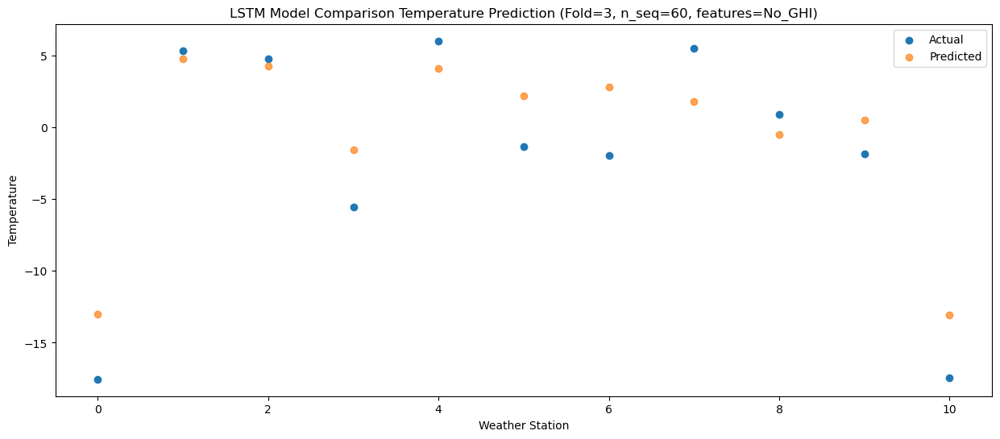

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -12.671593
1                 1    6.65   5.139185
2                 2    0.82   4.586674
3                 3   -4.08  -1.241504
4                 4    5.65   4.421360
5                 5   -0.28   2.531128
6                 6   -6.73   3.173268
7                 7   -1.79   2.116437
8                 8   -2.83  -0.181460
9                 9   -3.45   0.866106
10               10  -17.86 -12.717602


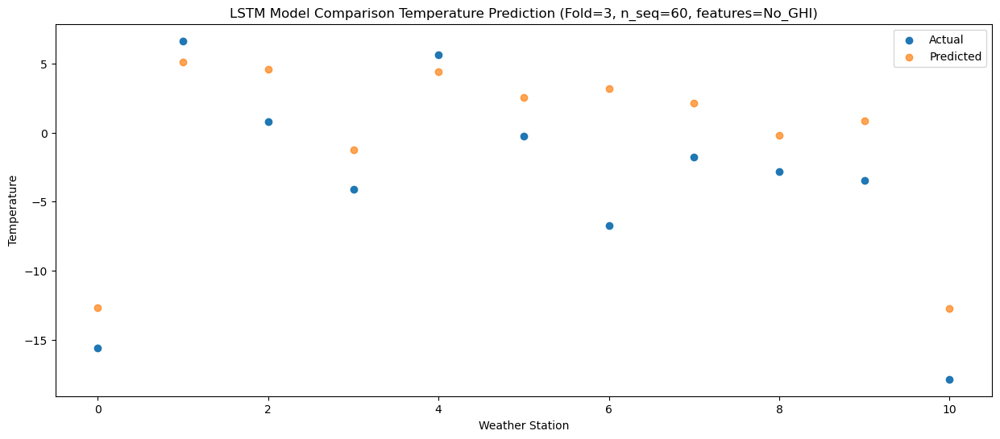

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -20.341869
1                 1   -2.18  -2.536420
2                 2    0.49  -3.086989
3                 3  -13.03  -8.916808
4                 4   -3.82  -3.255324
5                 5   -9.10  -5.147493
6                 6   -9.02  -4.496318
7                 7   -1.86  -5.547819
8                 8   -2.21  -7.844606
9                 9  -10.00  -6.806695
10               10  -24.84 -20.396415


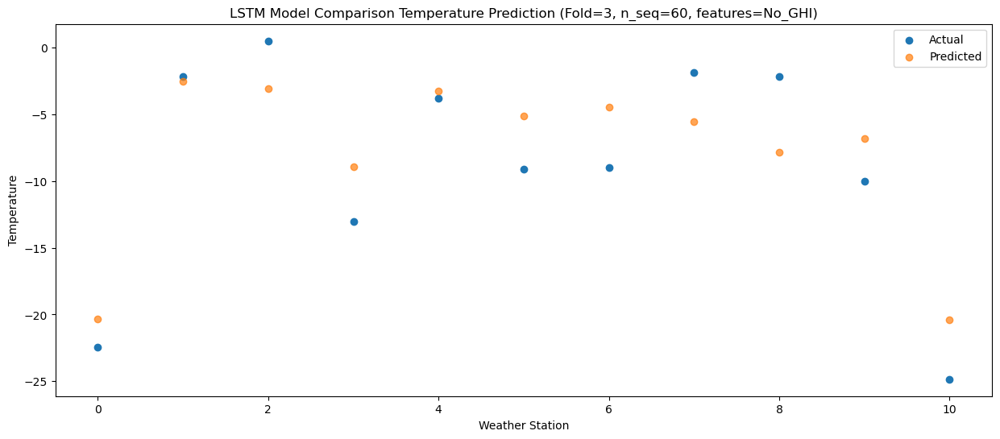

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -18.103499
1                 1   -0.96  -0.294056
2                 2    2.19  -0.848463
3                 3   -8.51  -6.676390
4                 4   -1.30  -1.015159
5                 5   -5.91  -2.902951
6                 6  -10.74  -2.259052
7                 7    0.18  -3.313677
8                 8   -1.25  -5.613078
9                 9   -7.24  -4.574824
10               10  -21.03 -18.163548


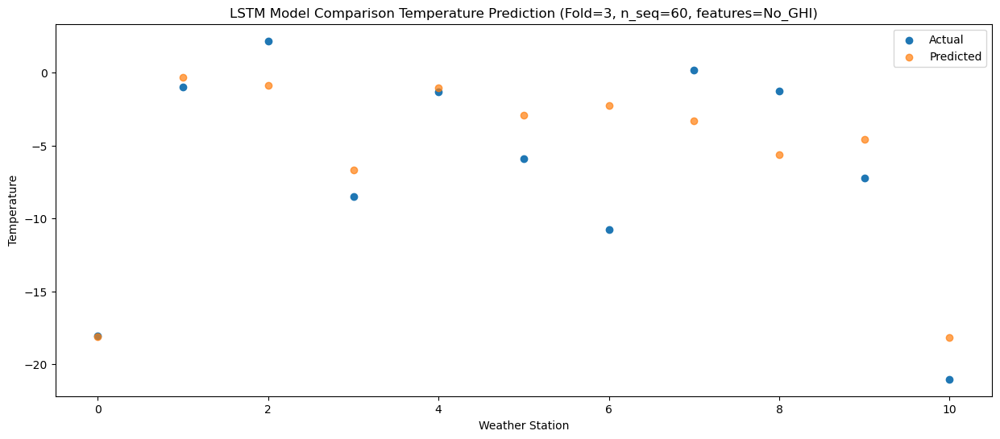

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -12.059895
1                 1    5.82   5.750606
2                 2    6.90   5.184534
3                 3   -2.76  -0.632264
4                 4    7.16   5.037270
5                 5    1.05   3.152449
6                 6   -6.20   3.788545
7                 7    4.89   2.726123
8                 8    0.98   0.426345
9                 9   -3.28   1.472751
10               10  -15.85 -12.109271


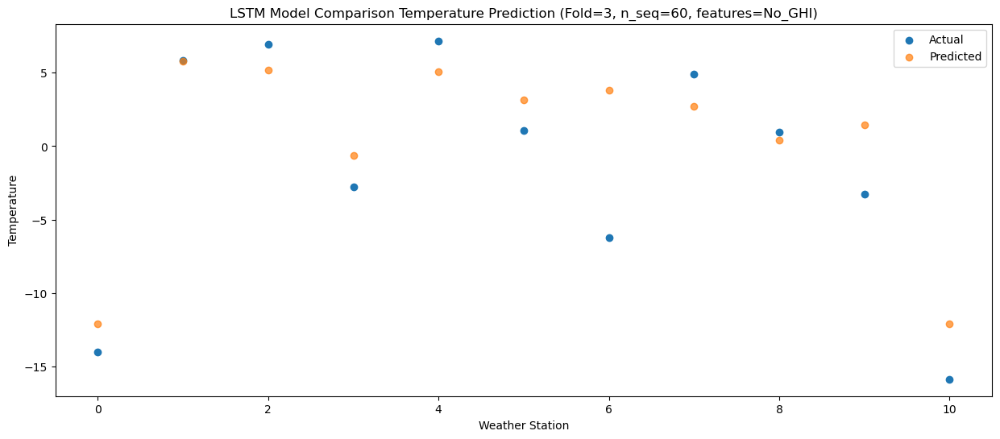

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88  -7.865705
1                 1   10.67   9.940095
2                 2    9.97   9.374931
3                 3    0.25   3.559712
4                 4   11.29   9.226290
5                 5    4.90   7.343106
6                 6   -1.88   7.979536
7                 7    9.52   6.918904
8                 8    2.42   4.614729
9                 9    1.01   5.660725
10               10  -12.03  -7.917845


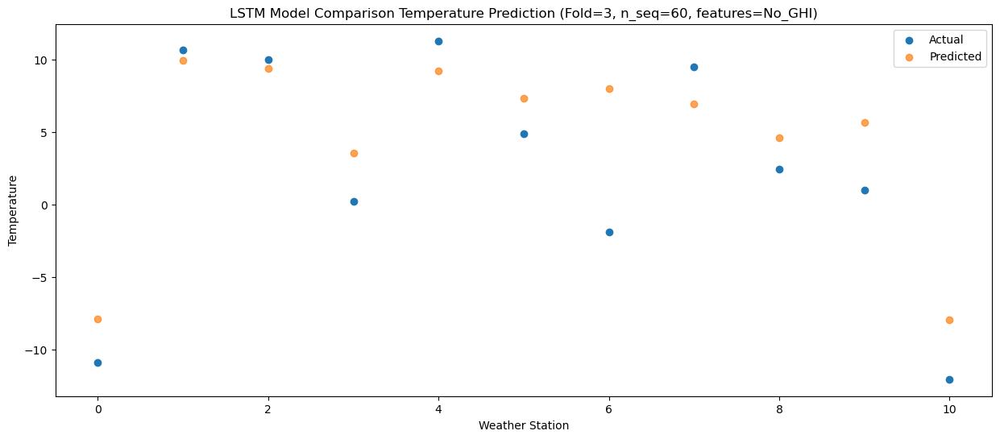

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04  -1.893096
1                 1   16.10  15.911178
2                 2   14.21  15.351190
3                 3    7.03   9.532822
4                 4   18.86  15.196571
5                 5   12.70  13.313104
6                 6    4.03  13.955550
7                 7   14.19  12.896393
8                 8    5.41  10.585295
9                 9    6.80  11.631142
10               10   -5.25  -1.948125


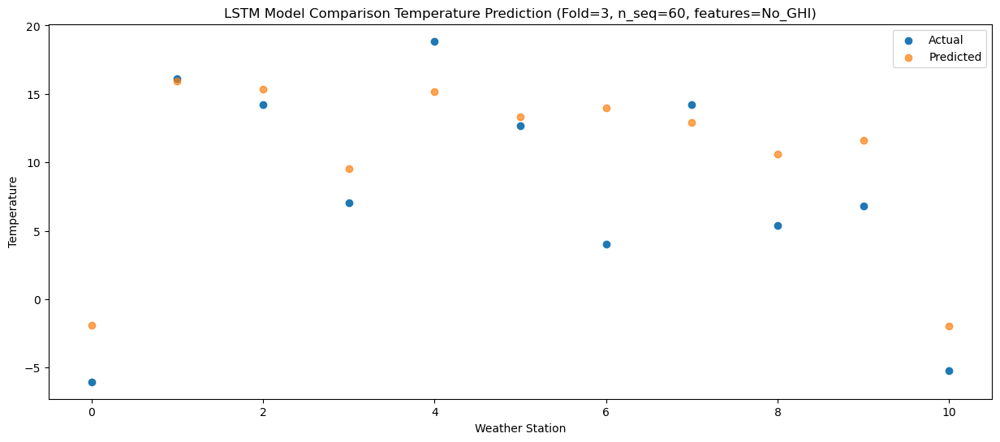

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08   2.582544
1                 1   21.25  20.388232
2                 2   19.60  19.830465
3                 3   10.51  14.010870
4                 4   24.31  19.674393
5                 5   16.64  17.787374
6                 6    9.80  18.433380
7                 7   20.67  17.376495
8                 8    8.56  15.066129
9                 9   11.12  16.108338
10               10   -1.26   2.527842


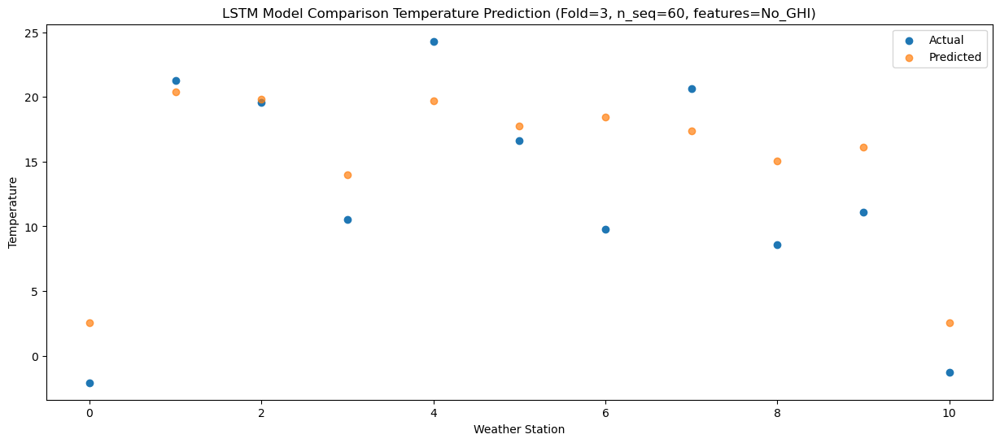

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31   5.732184
1                 1   25.29  23.533780
2                 2   22.17  22.978783
3                 3   12.06  17.161836
4                 4   25.43  22.819139
5                 5   18.63  20.931780
6                 6   11.72  21.577765
7                 7   22.90  20.522183
8                 8    6.91  18.214219
9                 9   15.67  19.265606
10               10    2.52   5.691776


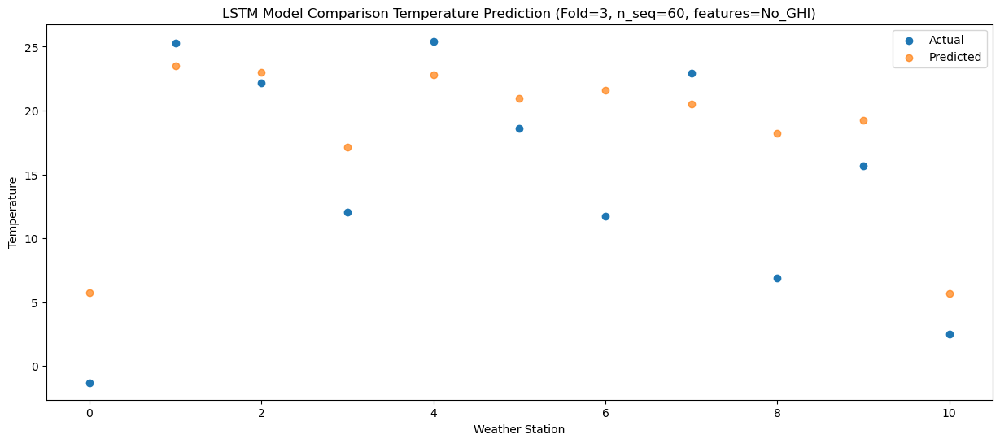

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22   3.658574
1                 1   22.21  21.460143
2                 2   22.35  20.909246
3                 3   10.99  15.087830
4                 4   23.61  20.743309
5                 5   16.98  18.853563
6                 6   10.96  19.506599
7                 7   21.31  18.454053
8                 8    8.33  16.146218
9                 9   15.59  17.192929
10               10    1.65   3.617228


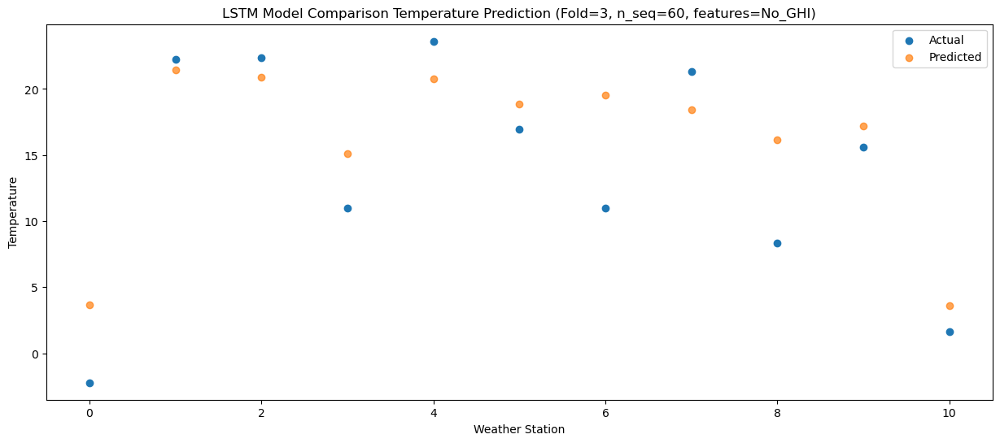

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43  -0.047926
1                 1   18.35  17.752062
2                 2   19.53  17.196996
3                 3    7.01  11.373528
4                 4   19.29  17.029558
5                 5   13.03  15.139584
6                 6    8.80  15.791006
7                 7   18.95  14.732650
8                 8    8.56  12.423676
9                 9   10.68  13.469423
10               10   -3.58  -0.107264


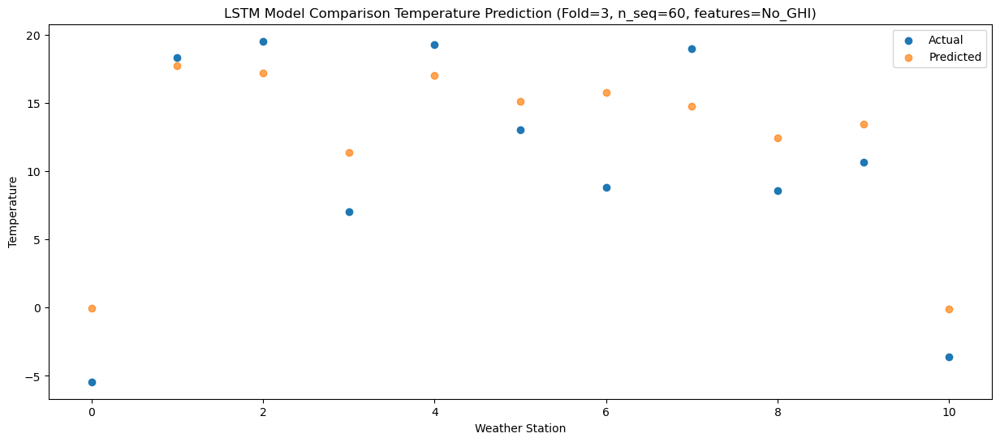

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44  -6.730753
1                 1   11.80  11.068529
2                 2   12.35  10.512962
3                 3   -0.26   4.682209
4                 4   12.02  10.342353
5                 5    6.99   8.448667
6                 6    0.54   9.098931
7                 7   11.06   8.034109
8                 8    3.83   5.734126
9                 9    4.42   6.774212
10               10  -11.19  -6.802097


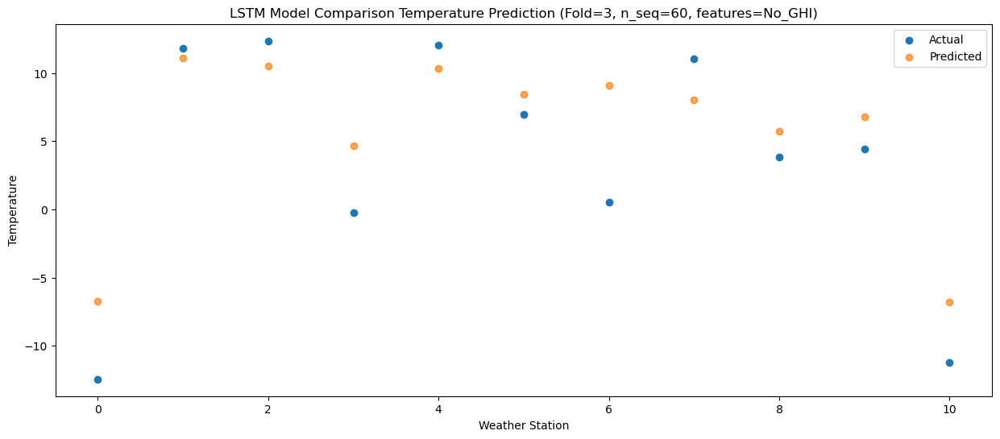

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -12.472330
1                 1    4.57   5.320010
2                 2    1.62   4.763563
3                 3   -3.38  -1.060921
4                 4    6.13   4.596263
5                 5    0.44   2.706230
6                 6   -7.14   3.351394
7                 7   -0.36   2.283727
8                 8   -1.90  -0.016769
9                 9    0.46   1.033355
10               10  -14.31 -12.538700


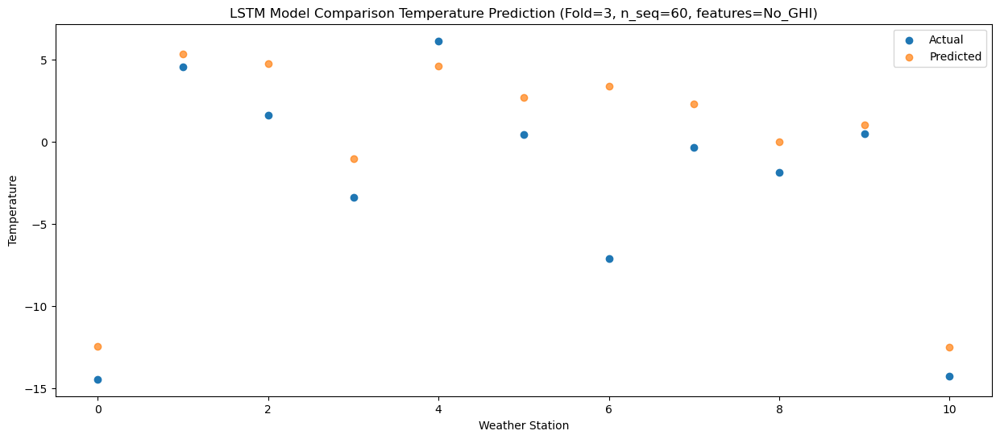

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -17.286908
1                 1    0.52   0.499510
2                 2    0.66  -0.050758
3                 3   -8.65  -5.882233
4                 4    0.16  -0.224954
5                 5   -5.10  -2.117013
6                 6   -9.31  -1.467245
7                 7   -2.69  -2.528868
8                 8   -3.10  -4.824532
9                 9   -5.90  -3.775887
10               10  -21.34 -17.351279


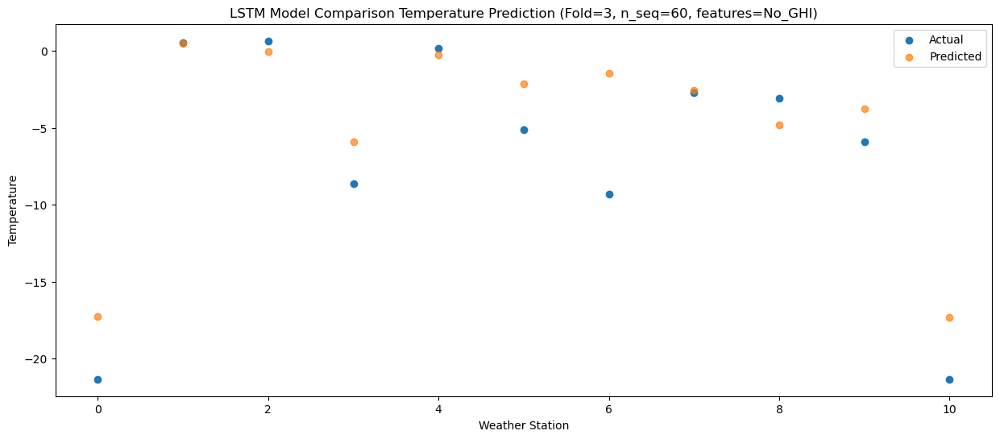

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -15.614468
1                 1    1.22   2.173080
2                 2    2.05   1.622486
3                 3   -6.90  -4.205207
4                 4    1.88   1.450348
5                 5   -2.96  -0.442924
6                 6  -10.04   0.208789
7                 7   -3.20  -0.853882
8                 8   -1.43  -3.148010
9                 9   -3.92  -2.103785
10               10  -18.69 -15.680075


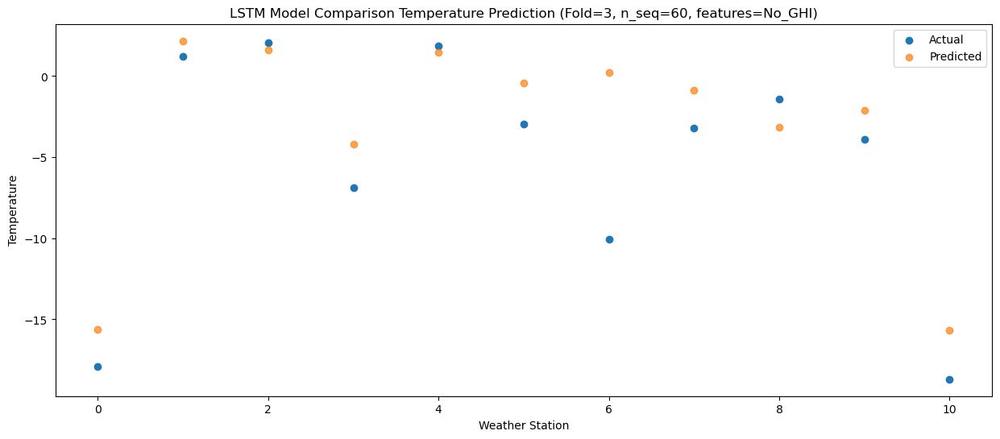

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -14.410782
1                 1    3.18   3.375592
2                 2    1.20   2.827841
3                 3   -4.56  -3.002117
4                 4    8.40   2.651312
5                 5   -1.24   0.758669
6                 6  -10.01   1.417173
7                 7   -2.29   0.349683
8                 8   -3.23  -1.944186
9                 9   -5.65  -0.906601
10               10  -18.48 -14.486743


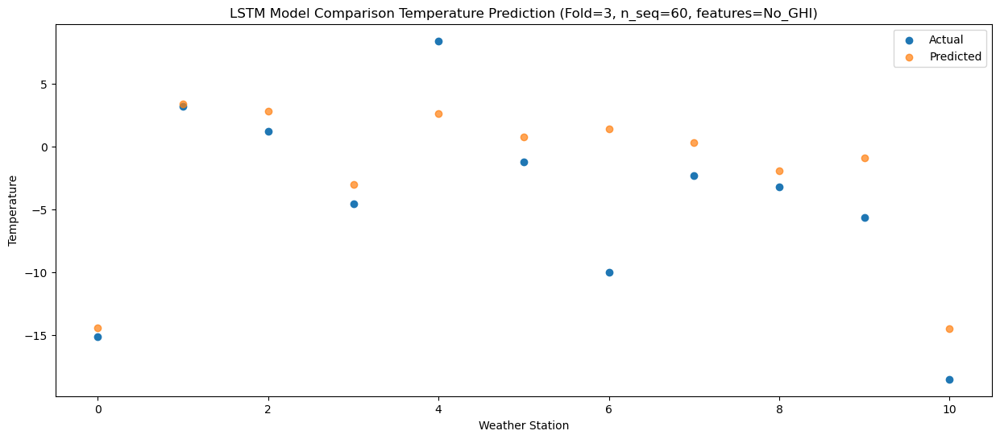

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -12.348997
1                 1    5.78   5.434131
2                 2    4.07   4.887495
3                 3   -4.32  -0.942265
4                 4    5.44   4.702278
5                 5   -0.34   2.808911
6                 6   -8.22   3.468303
7                 7    0.54   2.401198
8                 8   -1.77   0.110341
9                 9   -3.68   1.148413
10               10  -16.92 -12.433656


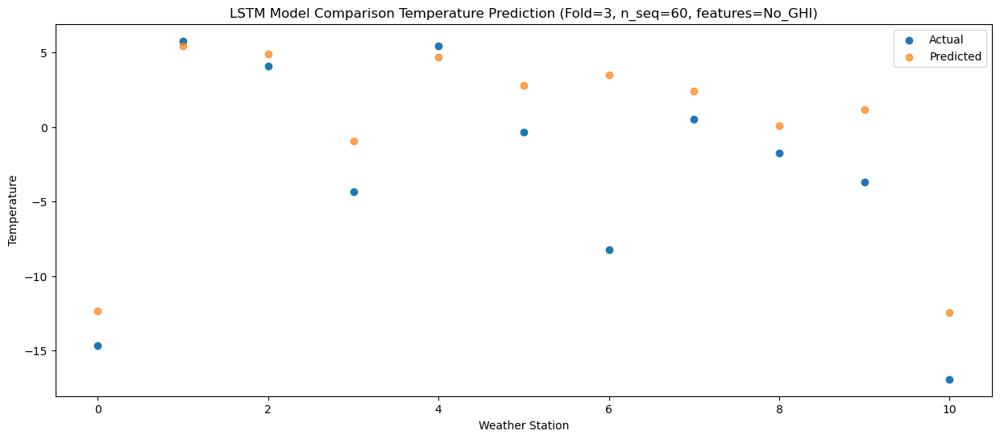

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97  -6.756135
1                 1   10.83  11.025653
2                 2    9.70  10.480778
3                 3    1.92   4.646498
4                 4   12.65  10.293000
5                 5    5.89   8.396757
6                 6   -2.88   9.060522
7                 7    8.49   7.995253
8                 8    2.31   5.709938
9                 9    2.37   6.741335
10               10   -9.35  -6.840768


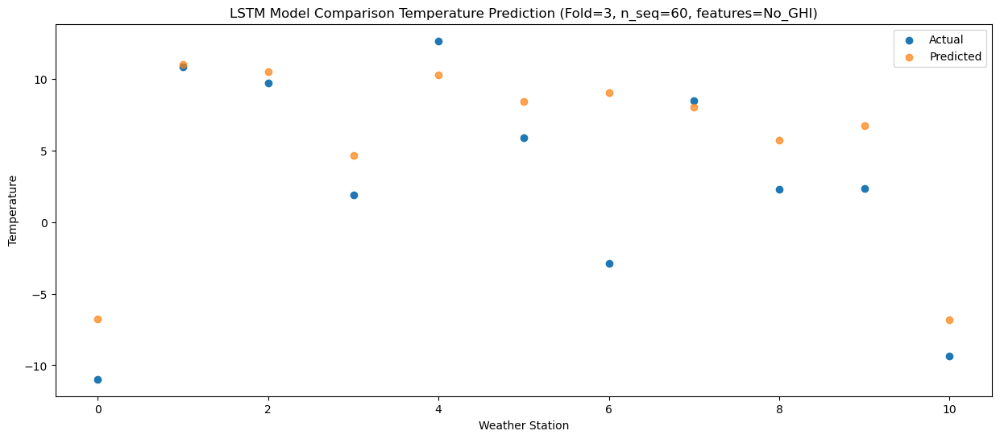

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61  -2.330400
1                 1   16.14  15.460169
2                 2   14.14  14.912973
3                 3    4.61   9.077329
4                 4   18.65  14.730629
5                 5   11.30  12.831699
6                 6    4.33  13.499834
7                 7   14.29  12.438534
8                 8    3.34  10.148192
9                 9    6.01  11.168550
10               10   -6.88  -2.421677


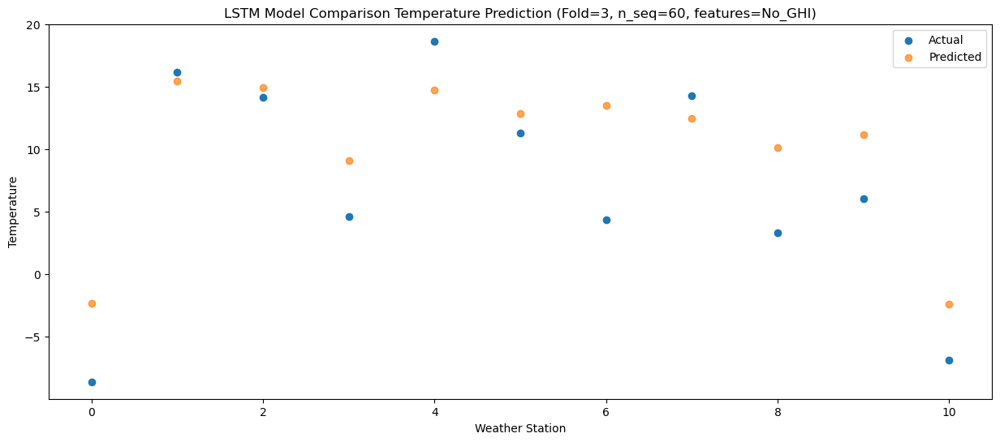

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84   1.524646
1                 1   20.47  19.315796
2                 2   16.94  18.761613
3                 3    8.35  12.931127
4                 4   22.75  18.585494
5                 5   14.76  16.688320
6                 6    8.91  17.352576
7                 7   16.79  16.287296
8                 8    5.24  14.001052
9                 9   10.00  15.022708
10               10   -2.95   1.434314


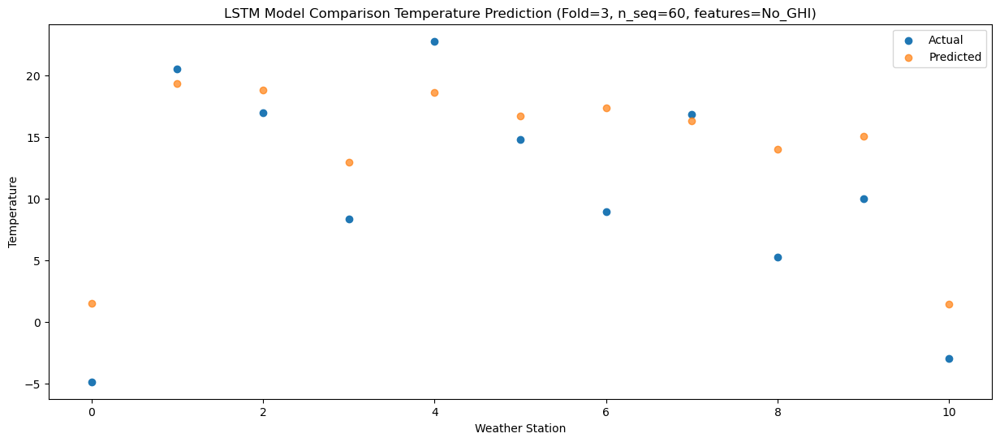

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06   4.637571
1                 1   22.73  22.422726
2                 2   22.60  21.875460
3                 3   11.97  16.038723
4                 4   24.45  21.691250
5                 5   18.02  19.792458
6                 6   15.05  20.465158
7                 7   25.15  19.400280
8                 8    8.25  17.115208
9                 9   15.68  18.131558
10               10    1.89   4.544309


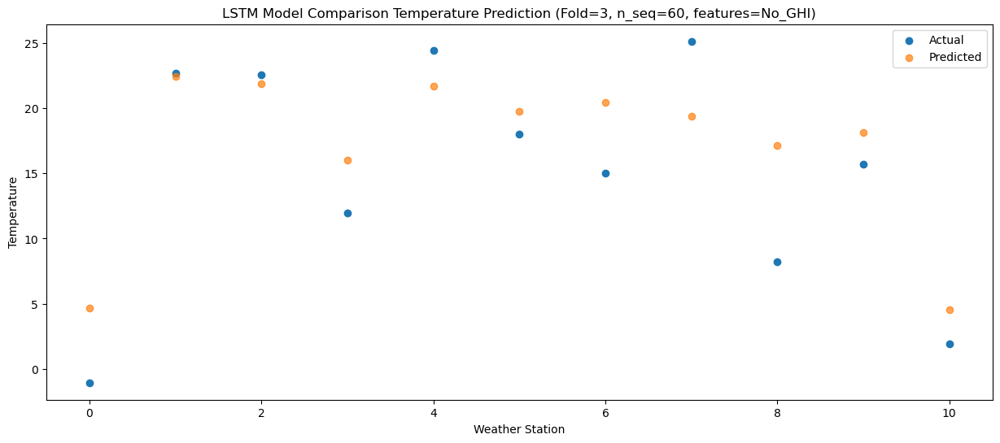

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57   4.215990
1                 1   22.91  22.004650
2                 2   20.91  21.463337
3                 3   10.86  15.623098
4                 4   23.16  21.272040
5                 5   16.47  19.371997
6                 6   12.46  20.049312
7                 7   20.52  18.986346
8                 8    9.28  16.703211
9                 9   13.43  17.720400
10               10   -0.08   4.131936


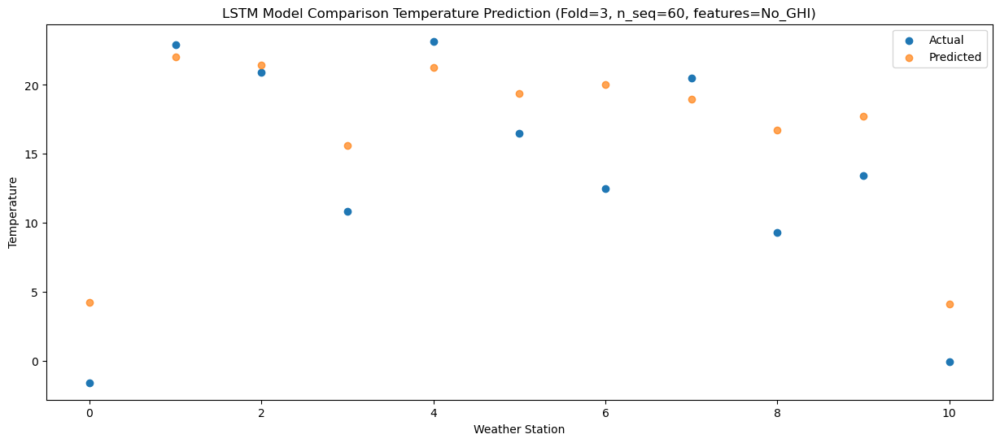

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71   0.595658
1                 1   18.86  18.379593
2                 2   17.14  17.844200
3                 3    8.13  12.001484
4                 4   19.80  17.646970
5                 5   13.01  15.743673
6                 6    8.31  16.422791
7                 7   15.82  15.361459
8                 8    6.67  13.087323
9                 9   10.86  14.101029
10               10   -3.37   0.514592


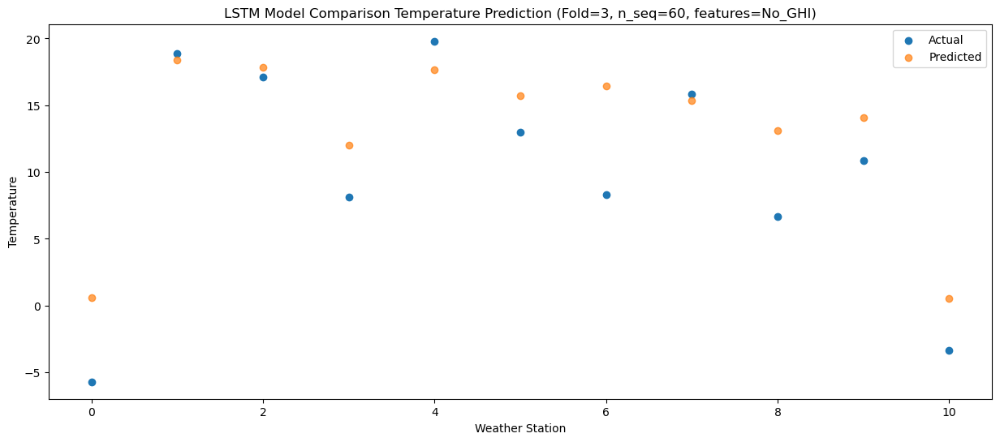

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74  -5.403413
1                 1   11.92  12.382832
2                 2   11.83  11.850163
3                 3    2.69   6.004789
4                 4   13.34  11.647777
5                 5    7.36   9.739014
6                 6    2.18  10.420135
7                 7   10.53   9.360859
8                 8    5.21   7.087929
9                 9    5.43   8.111813
10               10   -8.66  -5.473852


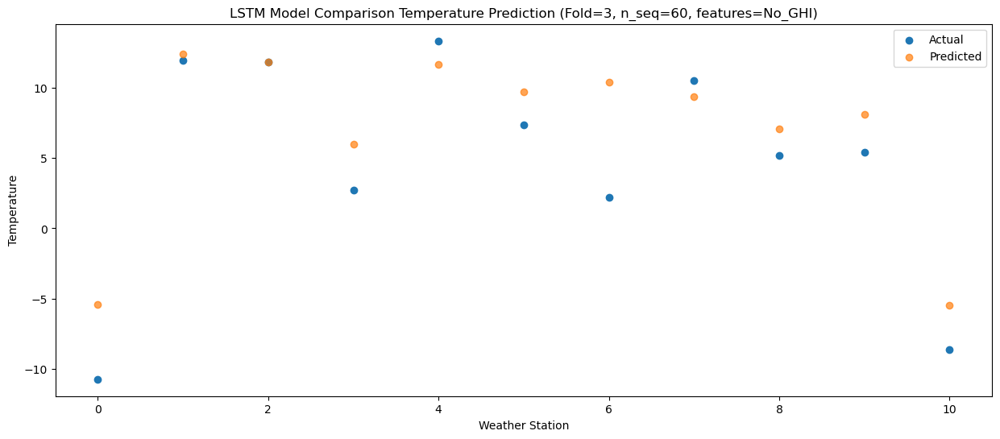

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -12.037368
1                 1    6.14   5.747313
2                 2    4.92   5.214190
3                 3   -3.70  -0.631147
4                 4    6.39   5.016050
5                 5    0.88   3.110234
6                 6   -3.68   3.790951
7                 7    2.39   2.728071
8                 8    1.17   0.457370
9                 9   -2.42   1.473961
10               10  -16.93 -12.113787


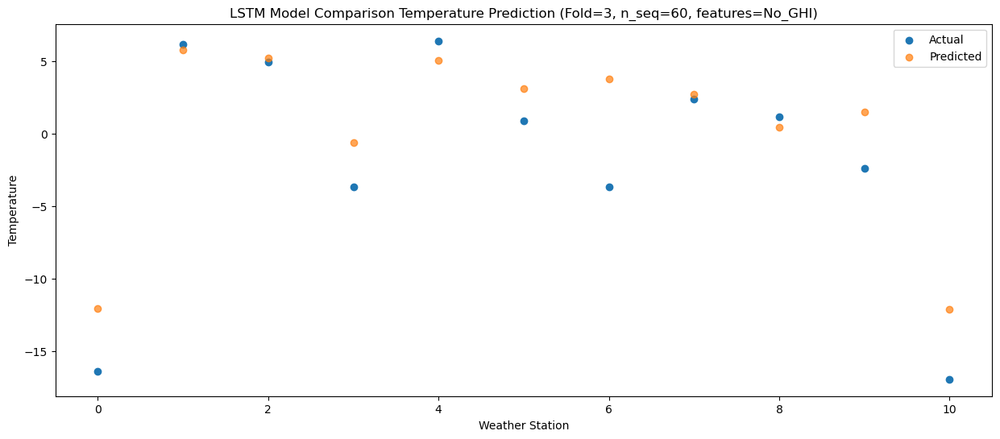

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -14.545869
1                 1    2.79   3.234443
2                 2    3.08   2.702612
3                 3   -5.53  -3.141951
4                 4    3.58   2.503783
5                 5   -1.58   0.604248
6                 6   -7.31   1.283472
7                 7   -0.74   0.221727
8                 8   -0.67  -2.054111
9                 9   -3.15  -1.035591
10               10  -17.68 -14.622865


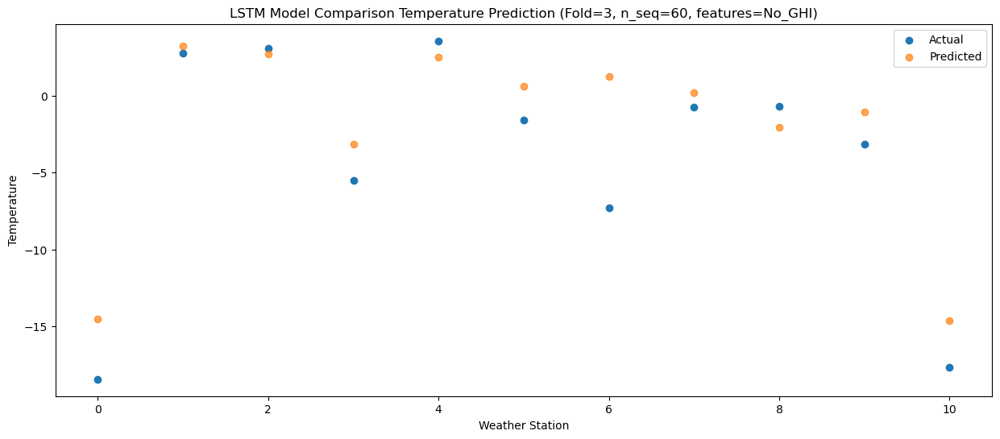

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -19.678316
1                 1   -3.82  -1.904139
2                 2    2.87  -2.437594
3                 3  -10.69  -8.280439
4                 4   -2.92  -2.642341
5                 5   -7.74  -4.539503
6                 6   -9.45  -3.863095
7                 7   -2.46  -4.926886
8                 8   -0.36  -7.194734
9                 9   -7.14  -6.177268
10               10  -20.70 -19.766220


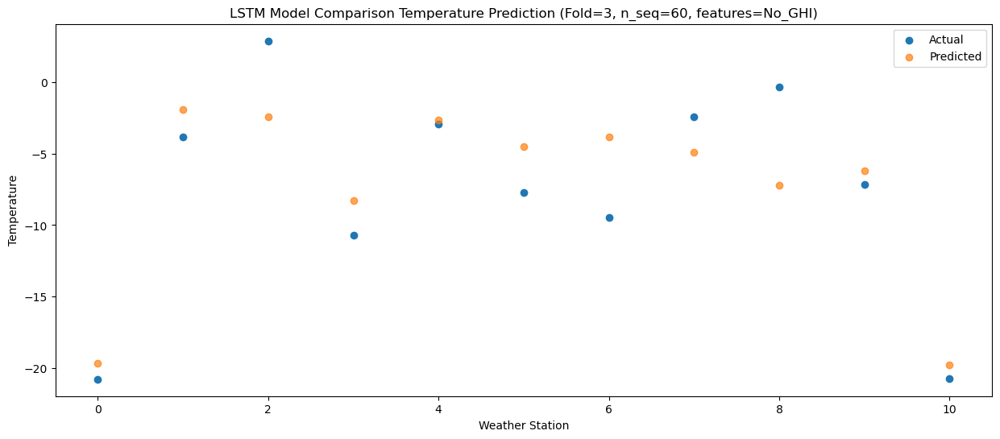

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -13.119741
1                 1    5.83   4.667425
2                 2    4.36   4.128641
3                 3   -5.01  -1.718522
4                 4    4.89   3.923990
5                 5   -1.11   2.022861
6                 6   -7.29   2.706720
7                 7   -0.10   1.650651
8                 8   -0.65  -0.624325
9                 9   -6.57   0.378453
10               10  -18.66 -13.217524


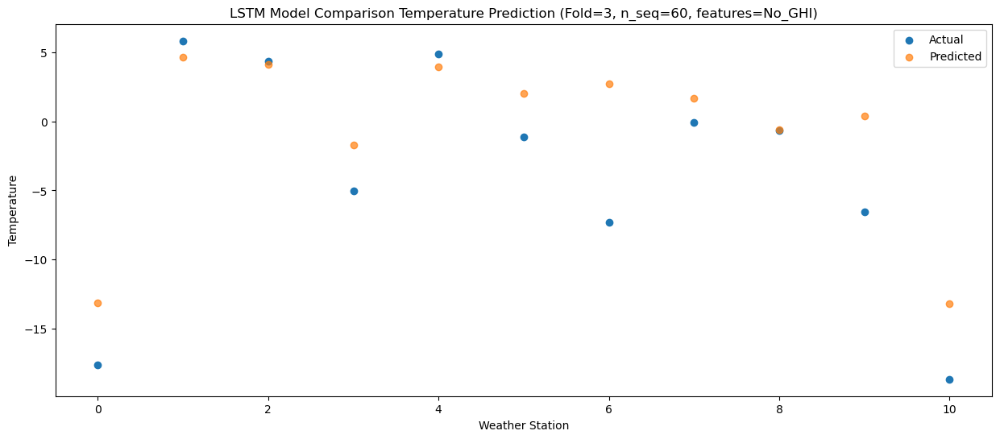

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -10.051651
1                 1    8.31   7.730760
2                 2    6.39   7.197346
3                 3   -1.36   1.342850
4                 4    9.00   6.983811
5                 5    2.96   5.077978
6                 6   -5.55   5.766196
7                 7    3.26   4.713422
8                 8    0.28   2.446886
9                 9   -1.87   3.449793
10               10  -14.00 -10.148692


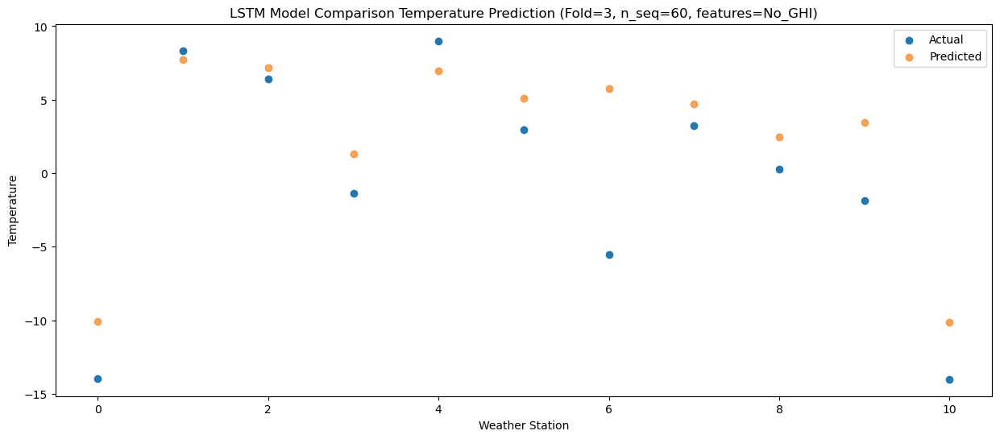

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93  -5.793041
1                 1   12.48  11.987467
2                 2    9.58  11.451128
3                 3    3.70   5.601122
4                 4   13.75  11.239952
5                 5    7.93   9.332566
6                 6   -0.57  10.019073
7                 7    8.76   8.967893
8                 8    2.51   6.700461
9                 9    1.00   7.710258
10               10   -9.42  -5.888171


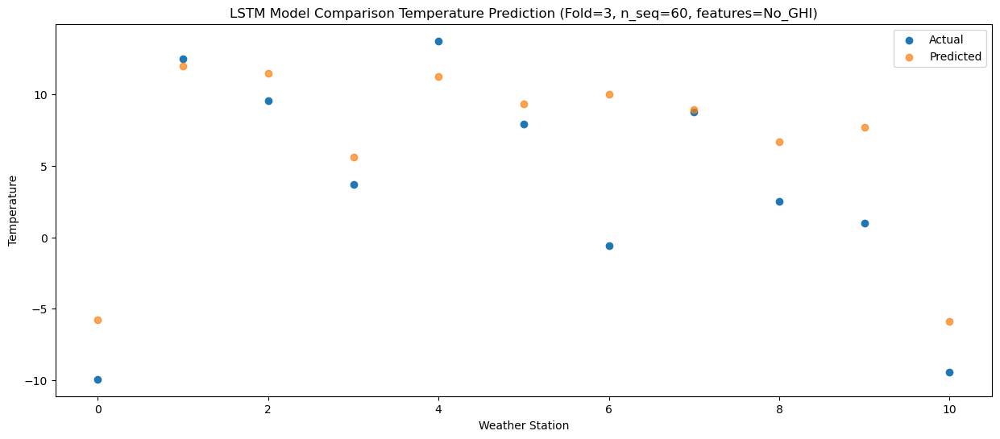

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66  -0.815654
1                 1   17.25  16.968541
2                 2   14.97  16.438105
3                 3    7.89  10.584513
4                 4   19.91  16.223336
5                 5   13.45  14.312928
6                 6    2.54  15.003879
7                 7   14.39  13.956475
8                 8    5.48  11.687139
9                 9    6.55  12.695997
10               10   -3.75  -0.902455


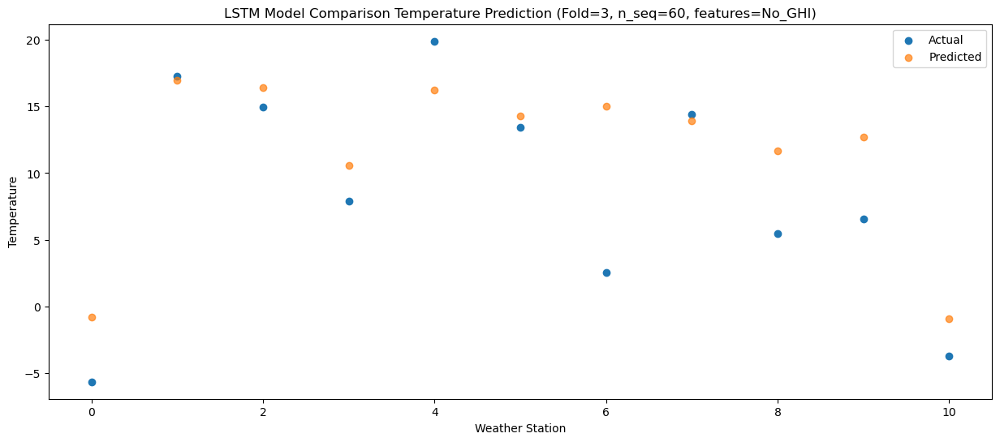

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00   3.460033
1                 1   21.81  21.245017
2                 2   20.92  20.713799
3                 3   11.79  14.858334
4                 4   24.78  20.495495
5                 5   16.68  18.585493
6                 6   11.69  19.282247
7                 7   22.57  18.233829
8                 8    8.39  15.959515
9                 9   13.02  16.969299
10               10    1.62   3.373089


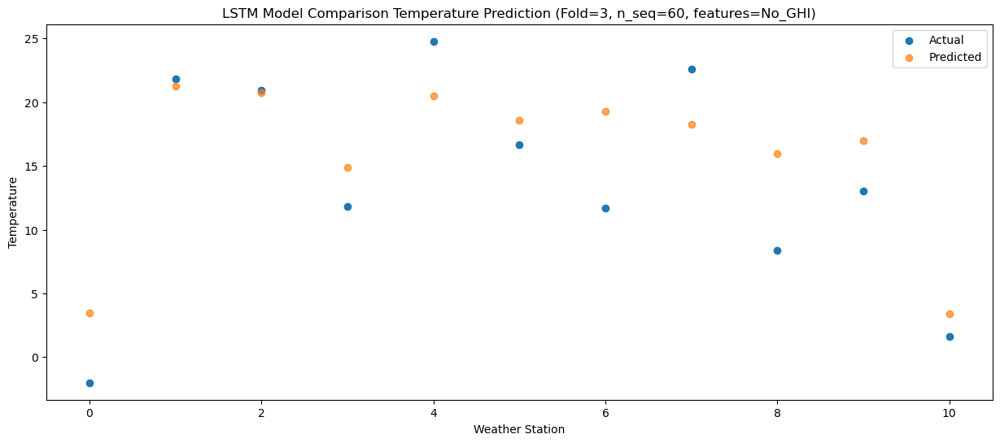

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11   4.426615
1                 1   22.33  22.209680
2                 2   24.49  21.672598
3                 3   13.50  15.821589
4                 4   23.94  21.457147
5                 5   17.23  19.550416
6                 6   12.44  20.240271
7                 7   25.65  19.189392
8                 8    9.65  16.917785
9                 9   15.58  17.927227
10               10    4.28   4.331904


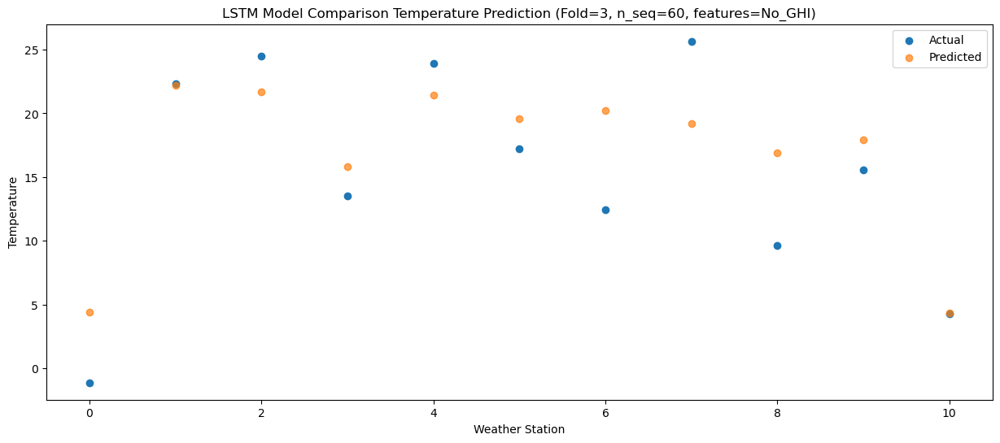

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51   3.895841
1                 1   22.61  21.679719
2                 2   21.52  21.146296
3                 3   12.48  15.291245
4                 4   23.39  20.927606
5                 5   16.68  19.021713
6                 6   12.15  19.714302
7                 7   22.79  18.665647
8                 8    8.37  16.394739
9                 9   13.86  17.401582
10               10    1.14   3.802784


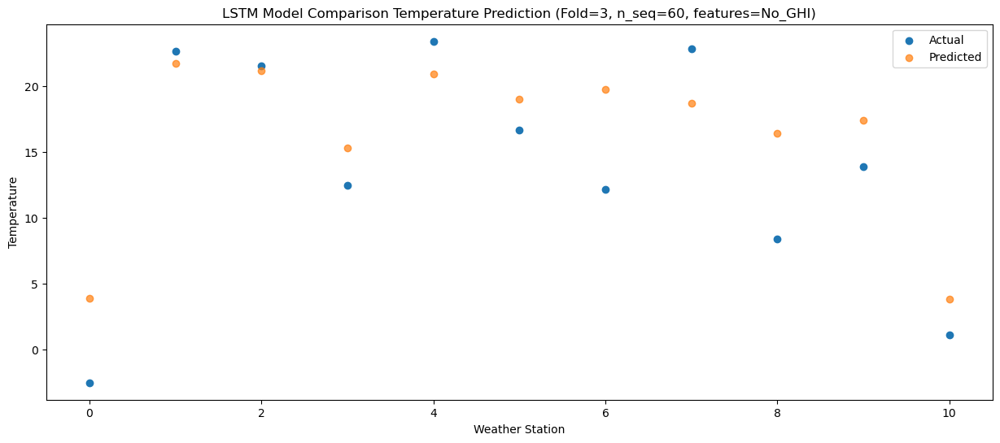

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20  -0.052984
1                 1   18.57  17.723295
2                 2   18.49  17.200750
3                 3    9.51  11.339250
4                 4   20.13  16.962420
5                 5   13.99  15.054897
6                 6    8.53  15.758516
7                 7   18.84  14.717024
8                 8    6.93  12.451202
9                 9    9.85  13.450416
10               10   -2.45  -0.151661


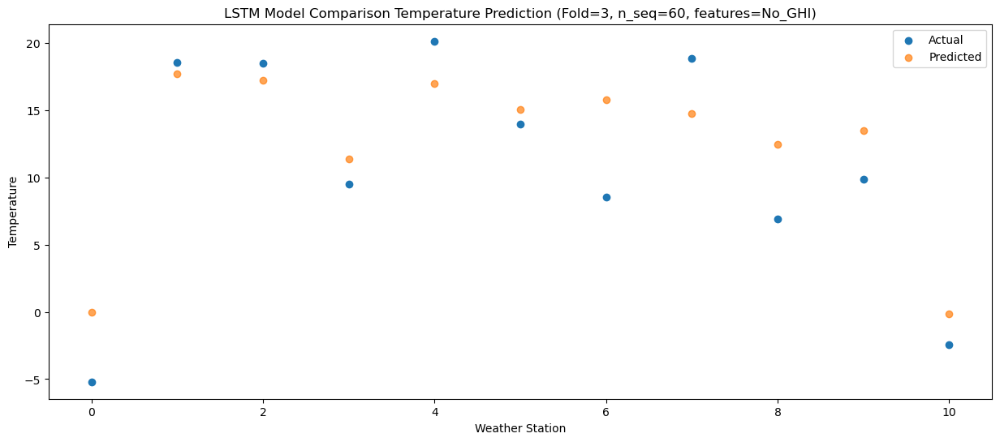

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51  -4.722711
1                 1   15.18  13.056441
2                 2   13.46  12.534306
3                 3    3.01   6.667987
4                 4   14.50  12.290486
5                 5    8.11  10.383727
6                 6    4.30  11.085504
7                 7   12.95  10.040776
8                 8    6.47   7.781023
9                 9    5.32   8.777716
10               10   -7.69  -4.831956


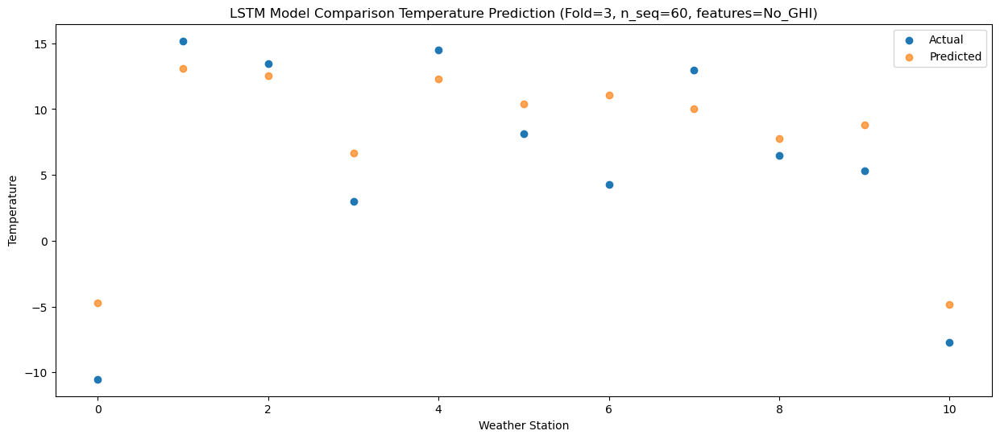

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_16 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_16 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_17 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_17 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_24 (Dense)            (1, 256)                  262400    
                                                                 
 dense_25 (Dense)            (1, 128)                  32896     
                                                                 
 dense_26 (Dense)            (1, 60)                  

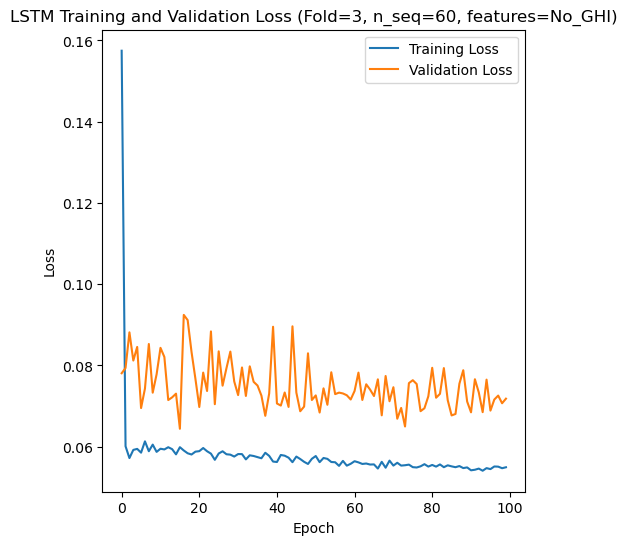

Epoch 1/100
84/84 [==============================] - 9s 64ms/step - loss: 0.1672 - accuracy: 0.3095 - mae: 0.1325 - rmse: 0.1672 - mape: inf - pearson: 0.6249 - val_loss: 0.0616 - val_accuracy: 0.6000 - val_mae: 0.0494 - val_rmse: 0.0616 - val_mape: 11.4450 - val_pearson: 0.8461
Epoch 2/100
84/84 [==============================] - 4s 43ms/step - loss: 0.0617 - accuracy: 0.4167 - mae: 0.0488 - rmse: 0.0617 - mape: inf - pearson: 0.8240 - val_loss: 0.0715 - val_accuracy: 0.6000 - val_mae: 0.0563 - val_rmse: 0.0715 - val_mape: 13.2108 - val_pearson: 0.8174
Epoch 3/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0609 - accuracy: 0.4643 - mae: 0.0482 - rmse: 0.0609 - mape: inf - pearson: 0.8275 - val_loss: 0.0796 - val_accuracy: 0.0000e+00 - val_mae: 0.0636 - val_rmse: 0.0796 - val_mape: 15.4552 - val_pearson: 0.8228
Epoch 4/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0607 - accuracy: 0.4048 - mae: 0.0481 - rmse: 0.0607 - mape: inf - pearson: 0.82

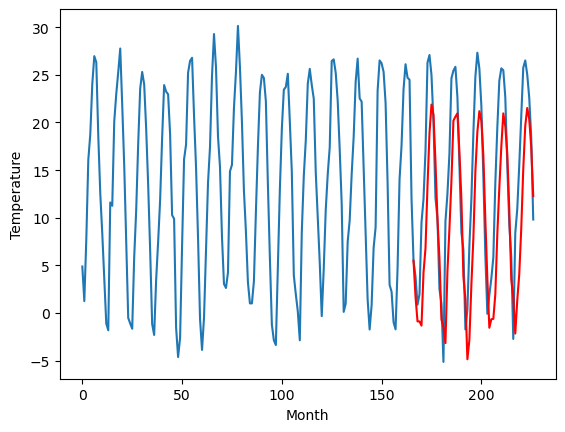

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.37		0.06		-0.31
0.19		-2.53		-2.72
-1.27		-2.55		-1.28
0.28		-3.00		-3.28
4.35		2.54		-1.81
6.03		5.12		-0.91
7.43		11.63		4.20
9.19		17.18		7.99
9.51		20.19		10.68
9.36		19.12		9.76
8.78		14.22		5.44
7.28		8.19		0.91
3.89		4.08		0.19
-3.86		-2.36		1.50
-3.16		-3.12		0.04
0.27		-4.84		-5.11
1.87		2.70		0.83
3.31		7.16		3.85
7.35		12.19		4.84
8.98		18.50		9.52
9.35		18.92		9.57
9.63		19.27		9.64
8.34		15.23		6.89
6.50		10.27		3.77
-0.66		2.14		2.80
1.14		-0.19		-1.33
-3.62		-6.50		-2.88
-0.19		-4.50		-4.31
2.63		1.30		-1.33
4.97		6.20		1.23
7.79		13.15		5.36
9.51		17.32		7.81
9.88		19.48		9.60
9.83		18.46		8.63
8.39		14.82		6.43
4.56		8.06		3.50
3.10		1.93		-1.17
-1.75		-3.23		-1.48
-1.90		-2.33		-0.43
1.40		-2.30		-3.70
3.12		0.28		-2.84
5.84		6.60		0.76
6.62		11.40		4.78
8.83		15.72		6.89
10.44		19.23		8.79
10.95		17.88		6.93
8.85		14.97		6.12
5.20		9.12		3.92
1.49		1.81		0.32
-0.63		-0.05

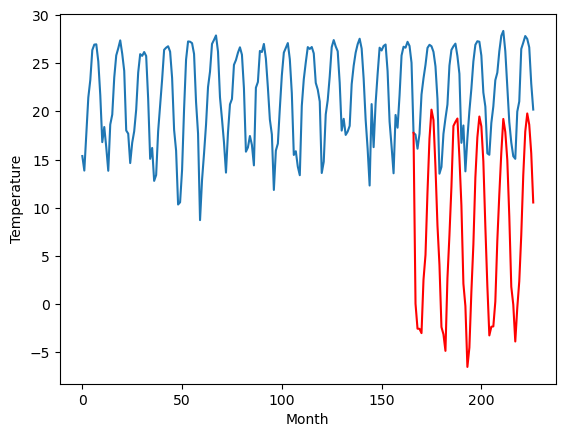

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.37		-3.33		1.04
-4.31		-5.92		-1.61
-4.50		-5.93		-1.43
-4.24		-6.37		-2.13
3.56		-0.83		-4.39
2.61		1.74		-0.87
6.49		8.24		1.75
10.58		13.79		3.21
12.15		16.80		4.65
11.32		15.72		4.40
9.22		10.83		1.61
3.88		4.79		0.91
-0.12		0.68		0.80
-6.37		-5.76		0.61
-6.34		-6.51		-0.17
-8.26		-8.22		0.04
1.07		-0.68		-1.75
2.14		3.78		1.64
6.61		8.81		2.20
10.87		15.12		4.25
11.53		15.54		4.01
12.18		15.89		3.71
9.06		11.86		2.80
5.67		6.89		1.22
-3.00		-1.23		1.77
0.51		-3.56		-4.07
-7.77		-9.87		-2.10
-5.41		-7.86		-2.45
-0.67		-2.05		-1.38
3.54		2.85		-0.69
9.34		9.80		0.46
12.63		13.97		1.34
12.83		16.12		3.29
11.29		15.11		3.82
9.22		11.47		2.25
3.09		4.71		1.62
-1.50		-1.42		0.08
-3.93		-6.58		-2.65
-3.52		-5.67		-2.15
-1.58		-5.63		-4.05
0.57		-3.05		-3.62
2.32		3.27		0.95
7.18		8.08		0.90
10.77		12.40		1.63
12.55		15.90		3.35
14.63		14.55		-0.08
10.88		11.65		0.77
4.77		5.80		1.03
-2.19		-

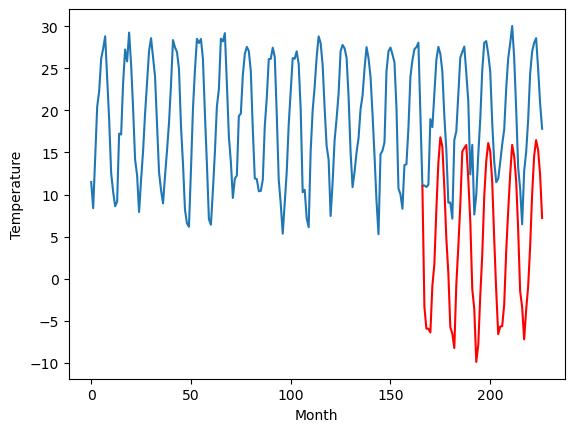

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.64		-3.97		-0.33
-5.29		-6.56		-1.27
-5.05		-6.56		-1.51
-5.38		-7.00		-1.62
2.08		-1.46		-3.54
2.74		1.11		-1.63
7.87		7.62		-0.25
12.83		13.17		0.34
14.69		16.17		1.48
14.44		15.10		0.66
8.66		10.20		1.54
2.93		4.17		1.24
0.32		0.07		-0.25
-5.96		-6.37		-0.41
-6.88		-7.13		-0.25
-10.34		-8.84		1.50
0.62		-1.30		-1.92
2.31		3.16		0.85
6.47		8.20		1.73
12.15		14.51		2.36
13.74		14.93		1.19
14.11		15.28		1.17
11.32		11.25		-0.07
6.67		6.28		-0.39
-1.33		-1.84		-0.51
0.67		-4.17		-4.84
-7.80		-10.48		-2.68
-7.54		-8.46		-0.92
-1.36		-2.65		-1.29
4.69		2.25		-2.44
9.40		9.20		-0.20
13.95		13.38		-0.57
17.25		15.53		-1.72
14.52		14.52		0.00
11.09		10.89		-0.20
4.22		4.13		-0.09
-2.83		-2.01		0.82
-5.52		-7.16		-1.64
-4.53		-6.26		-1.73
-4.47		-6.22		-1.75
0.06		-3.63		-3.69
2.66		2.69		0.03
8.34		7.51		-0.83
12.53		11.84		-0.69
15.08		15.33		0.25
17.63		13.98		-3.65
12.93		11.08		-1.85
4.80		5

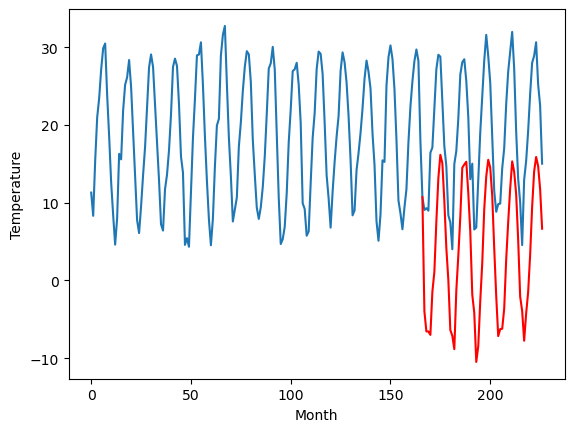

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.77		-2.69		0.08
-4.55		-5.29		-0.74
-3.93		-5.29		-1.36
-4.31		-5.73		-1.42
3.57		-0.19		-3.76
4.26		2.38		-1.88
9.91		8.89		-1.02
14.62		14.45		-0.17
17.06		17.44		0.38
16.38		16.37		-0.01
10.08		11.47		1.39
4.33		5.44		1.11
1.57		1.34		-0.23
-5.00		-5.10		-0.10
-5.60		-5.85		-0.25
-9.49		-7.57		1.92
1.43		-0.01		-1.44
3.61		4.45		0.84
7.14		9.49		2.35
13.99		15.80		1.81
15.48		16.21		0.73
15.85		16.57		0.72
12.42		12.54		0.12
7.55		7.57		0.02
-0.29		-0.54		-0.25
1.45		-2.88		-4.33
-7.45		-9.20		-1.75
-6.83		-7.16		-0.33
0.09		-1.36		-1.45
6.78		3.54		-3.24
11.61		10.49		-1.12
16.28		14.67		-1.61
19.70		16.83		-2.87
16.86		15.82		-1.04
12.77		12.19		-0.58
5.62		5.43		-0.19
-1.47		-0.71		0.76
-4.44		-5.86		-1.42
-3.67		-4.96		-1.29
-3.44		-4.92		-1.48
1.41		-2.33		-3.74
4.06		3.99		-0.07
10.22		8.81		-1.41
15.33		13.14		-2.19
18.41		16.63		-1.78
20.28		15.29		-4.99
15.19		12.39		-2.80
6.36

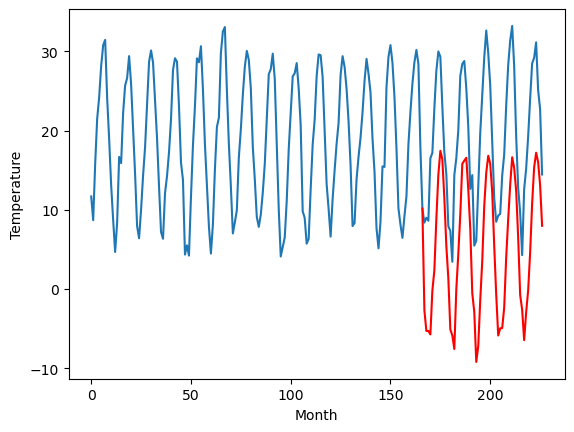

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.81		7.80		-1.01
7.17		5.20		-1.97
6.44		5.20		-1.24
5.68		4.77		-0.91
13.24		10.31		-2.93
16.21		12.87		-3.34
22.78		19.38		-3.40
26.11		24.94		-1.17
28.94		27.93		-1.01
28.32		26.87		-1.45
20.59		21.97		1.38
16.63		15.94		-0.69
12.75		11.84		-0.91
5.77		5.40		-0.37
4.67		4.64		-0.03
3.10		2.93		-0.17
12.35		10.47		-1.88
14.58		14.94		0.36
20.07		19.98		-0.09
25.03		26.29		1.26
24.77		26.70		1.93
25.09		27.06		1.97
24.40		23.02		-1.38
18.70		18.05		-0.65
11.76		9.94		-1.82
12.17		7.61		-4.56
4.80		1.29		-3.51
4.60		3.33		-1.27
11.92		9.13		-2.79
19.43		14.03		-5.40
25.12		20.98		-4.14
27.49		25.16		-2.33
29.39		27.32		-2.07
26.09		26.32		0.23
23.19		22.69		-0.50
16.38		15.93		-0.45
8.53		9.78		1.25
6.93		4.63		-2.30
7.30		5.53		-1.77
7.47		5.56		-1.91
12.54		8.15		-4.39
16.76		14.47		-2.29
21.68		19.29		-2.39
28.16		23.62		-4.54
29.62		27.11		-2.51
29.71		25.76		-3.95
26.23		22.86		-3.37
17

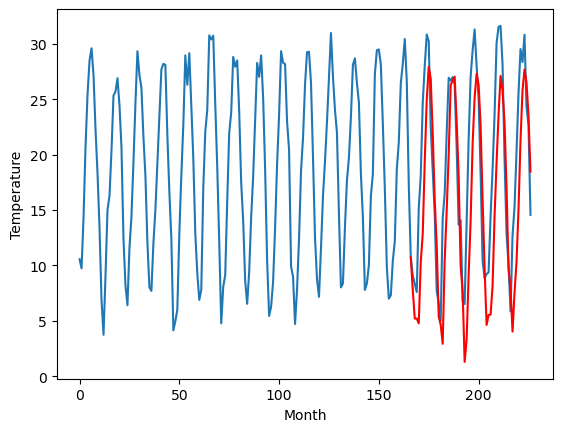

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.79		3.90		2.11
1.44		1.31		-0.13
1.27		1.31		0.04
1.74		0.86		-0.88
7.35		6.40		-0.95
8.62		8.97		0.35
11.41		15.47		4.06
16.00		21.03		5.03
19.04		24.04		5.00
17.84		22.97		5.13
14.04		18.07		4.03
10.22		12.03		1.81
5.91		7.94		2.03
-1.34		1.49		2.83
-1.11		0.73		1.84
-0.44		-0.97		-0.53
5.96		6.57		0.61
8.69		11.03		2.34
12.14		16.07		3.93
16.16		22.39		6.23
17.90		22.81		4.91
18.03		23.16		5.13
14.06		19.13		5.07
10.26		14.16		3.90
2.10		6.04		3.94
4.01		3.71		-0.30
-2.05		-2.60		-0.55
2.23		-0.57		-2.80
5.79		5.24		-0.55
8.45		10.13		1.68
14.43		17.09		2.66
17.64		21.25		3.61
18.91		23.40		4.49
17.39		22.40		5.01
14.30		18.76		4.46
7.43		12.00		4.57
4.73		5.86		1.13
-1.22		0.71		1.93
1.80		1.61		-0.19
5.22		1.64		-3.58
5.70		4.23		-1.47
8.81		10.54		1.73
11.43		15.36		3.93
15.07		19.68		4.61
18.94		23.18		4.24
18.38		21.83		3.45
14.54		18.93		4.39
9.10		13.09		3.99
3.37		5.79		2.42
1.16

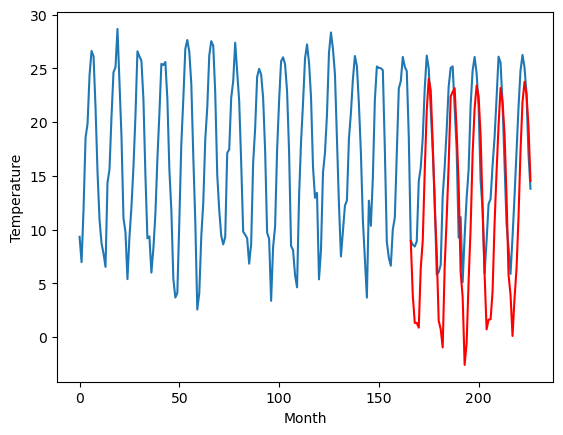

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.00		3.72		-0.28
3.19		1.13		-2.06
1.54		1.13		-0.41
2.11		0.68		-1.43
9.04		6.22		-2.82
10.62		8.79		-1.83
14.72		15.29		0.57
21.07		20.85		-0.22
23.61		23.85		0.24
21.62		22.78		1.16
18.04		17.88		-0.16
11.11		11.85		0.74
8.56		7.75		-0.81
2.03		1.30		-0.73
0.36		0.55		0.19
-3.25		-1.16		2.09
9.02		6.39		-2.63
10.92		10.85		-0.07
14.96		15.89		0.93
21.26		22.21		0.95
22.55		22.62		0.07
23.07		22.98		-0.09
20.03		18.95		-1.08
14.26		13.98		-0.28
6.32		5.86		-0.46
7.78		3.52		-4.26
-1.29		-2.79		-1.50
0.77		-0.75		-1.52
7.43		5.06		-2.37
11.29		9.96		-1.33
16.96		16.92		-0.04
22.28		21.09		-1.19
25.98		23.24		-2.74
22.46		22.23		-0.23
18.87		18.59		-0.28
12.50		11.84		-0.66
5.95		5.69		-0.26
1.10		0.54		-0.56
2.75		1.45		-1.30
4.89		1.49		-3.40
6.61		4.07		-2.54
12.23		10.39		-1.84
17.01		15.21		-1.80
21.09		19.54		-1.55
23.05		23.03		-0.02
22.86		21.69		-1.17
18.92		18.79		-0.13
13.02		12.9

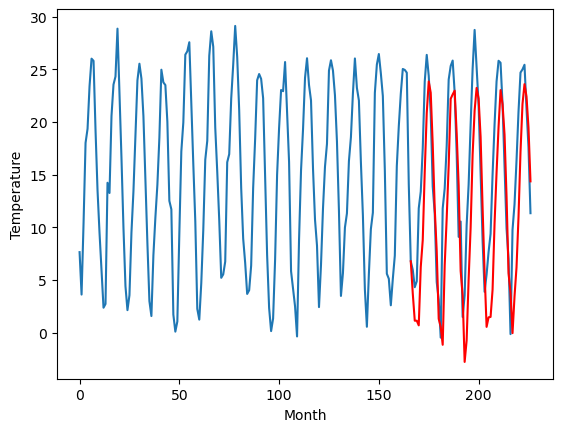

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.41		4.10		2.69
0.59		1.50		0.91
-0.34		1.50		1.84
-1.17		1.05		2.22
5.65		6.58		0.93
8.64		9.14		0.50
14.22		15.65		1.43
21.51		21.21		-0.30
23.55		24.21		0.66
21.35		23.14		1.79
17.59		18.24		0.65
10.75		12.20		1.45
6.91		8.11		1.20
-0.60		1.67		2.27
-2.18		0.91		3.09
-5.54		-0.80		4.74
6.43		6.75		0.32
10.08		11.21		1.13
14.49		16.24		1.75
21.73		22.56		0.83
22.30		22.97		0.67
23.16		23.33		0.17
19.67		19.30		-0.37
14.32		14.33		0.01
3.46		6.20		2.74
3.78		3.86		0.08
-5.06		-2.45		2.61
-2.04		-0.41		1.63
5.43		5.40		-0.03
9.21		10.30		1.09
17.71		17.26		-0.45
22.19		21.43		-0.76
24.13		23.58		-0.55
21.90		22.57		0.67
17.99		18.92		0.93
10.50		12.16		1.66
4.71		6.02		1.31
-1.07		0.86		1.93
0.89		1.76		0.87
2.48		1.80		-0.68
3.75		4.38		0.63
10.25		10.70		0.45
15.96		15.51		-0.45
19.84		19.84		0.00
22.57		23.34		0.77
21.41		21.99		0.58
18.32		19.10		0.78
12.18		13.24		1.06
5.11		5.94		0.83


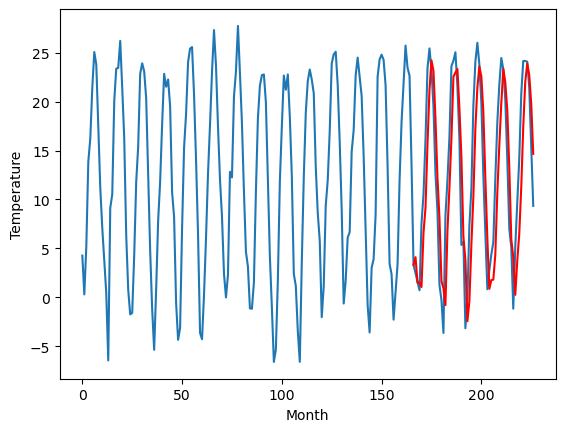

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.42		2.97		1.55
1.10		0.37		-0.73
-1.34		0.36		1.70
-1.59		-0.08		1.51
6.01		5.46		-0.55
9.12		8.01		-1.11
15.00		14.52		-0.48
22.73		20.09		-2.64
23.94		23.09		-0.85
21.34		22.01		0.67
17.44		17.11		-0.33
10.10		11.08		0.98
7.46		6.98		-0.48
-0.42		0.54		0.96
-2.45		-0.22		2.23
-6.89		-1.93		4.96
6.97		5.63		-1.34
10.68		10.09		-0.59
15.46		15.12		-0.34
22.85		21.44		-1.41
22.56		21.85		-0.71
22.84		22.22		-0.62
19.73		18.18		-1.55
14.27		13.21		-1.06
3.96		5.07		1.11
3.71		2.74		-0.97
-5.77		-3.58		2.19
-2.94		-1.54		1.40
5.27		4.27		-1.00
9.39		9.17		-0.22
17.92		16.14		-1.78
22.53		20.31		-2.22
23.35		22.46		-0.89
22.05		21.45		-0.60
17.91		17.81		-0.10
10.44		11.05		0.61
4.90		4.91		0.01
-1.83		-0.26		1.57
0.41		0.64		0.23
1.60		0.68		-0.92
4.14		3.26		-0.88
11.47		9.58		-1.89
17.23		14.40		-2.83
21.54		18.73		-2.81
23.07		22.23		-0.84
21.81		20.88		-0.93
18.77		17.98		-0.79
12.36		12.

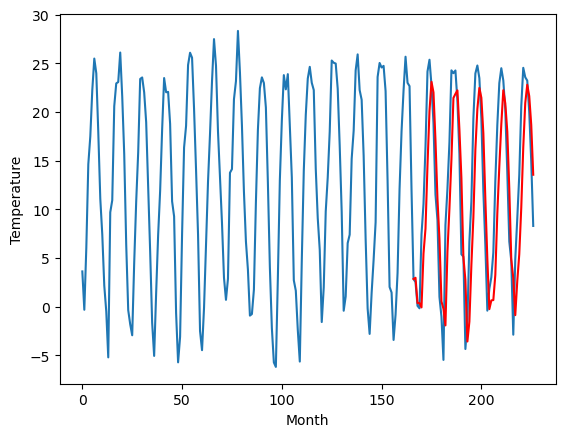

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.09		1.72		2.81
-1.87		-0.87		1.00
-3.07		-0.88		2.19
-3.88		-1.33		2.55
2.28		4.20		1.92
3.66		6.76		3.10
10.40		13.27		2.87
16.89		18.83		1.94
20.33		21.84		1.51
17.92		20.76		2.84
13.93		15.85		1.92
7.77		9.81		2.04
4.54		5.72		1.18
-3.02		-0.72		2.30
-4.94		-1.48		3.46
-7.18		-3.19		3.99
2.71		4.37		1.66
6.51		8.83		2.32
11.04		13.85		2.81
17.93		20.16		2.23
18.09		20.59		2.50
19.29		20.95		1.66
15.00		16.91		1.91
11.47		11.94		0.47
1.07		3.80		2.73
0.21		1.47		1.26
-8.62		-4.85		3.77
-5.06		-2.81		2.25
0.91		3.01		2.10
4.91		7.91		3.00
13.49		14.87		1.38
16.76		19.04		2.28
19.36		21.18		1.82
18.29		20.17		1.88
14.24		16.52		2.28
7.38		9.76		2.38
3.30		3.62		0.32
-3.41		-1.55		1.86
-1.78		-0.65		1.13
-1.64		-0.62		1.02
-0.76		1.97		2.73
7.71		8.28		0.57
11.40		13.09		1.69
15.71		17.42		1.71
18.80		20.93		2.13
17.47		19.57		2.10
15.13		16.67		1.54
9.87		10.82		0.95
2.48		3.51		1.03
1.82

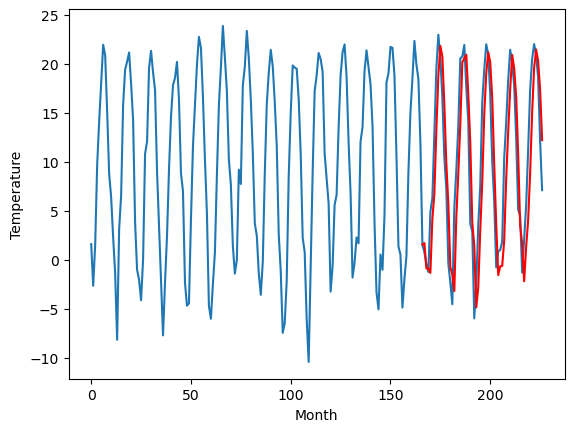

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[1.72838098526001, 0.05593742370605437, -3.3271992111206057, -3.9655607986450194, -2.6945580101013187, 7.7992967414855965, 3.9013311767578127, 3.7209396934509282, 4.0977711105346675, 2.9660616493225103, 1.722476787567139]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84   1.728381
1                 1    0.37   0.055937
2                 2   -4.37  -3.327199
3                 3   -3.64  -3.965561
4                 4   -2.77  -2.694558
5                 5    8.81   7.799297
6                 6    1.79   3.901331
7                 7    4.00   3.720940
8                 8    1.41   4.097771
9                 9    1.42   2.966062
10               10   -1.09   1.722477


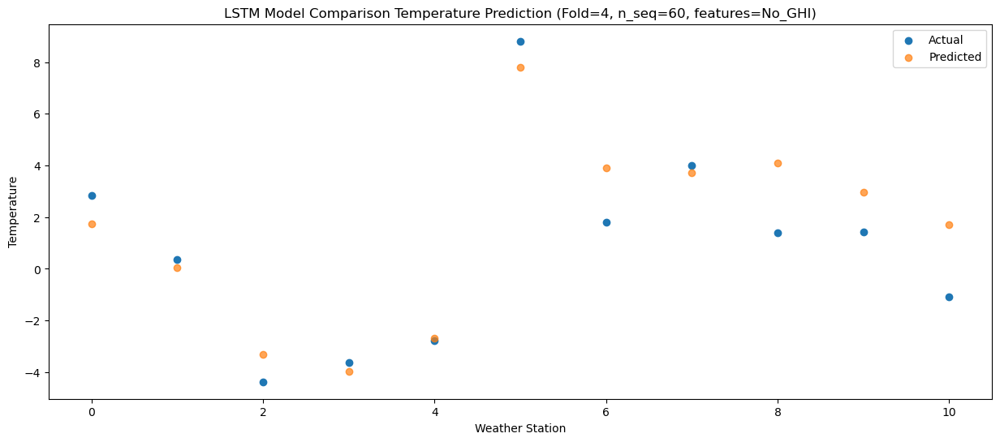

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.866484
1                 1    0.19  -2.533300
2                 2   -4.31  -5.918149
3                 3   -5.29  -6.557651
4                 4   -4.55  -5.289800
5                 5    7.17   5.203207
6                 6    1.44   1.308160
7                 7    3.19   1.128827
8                 8    0.59   1.503963
9                 9    1.10   0.371404
10               10   -1.87  -0.869949


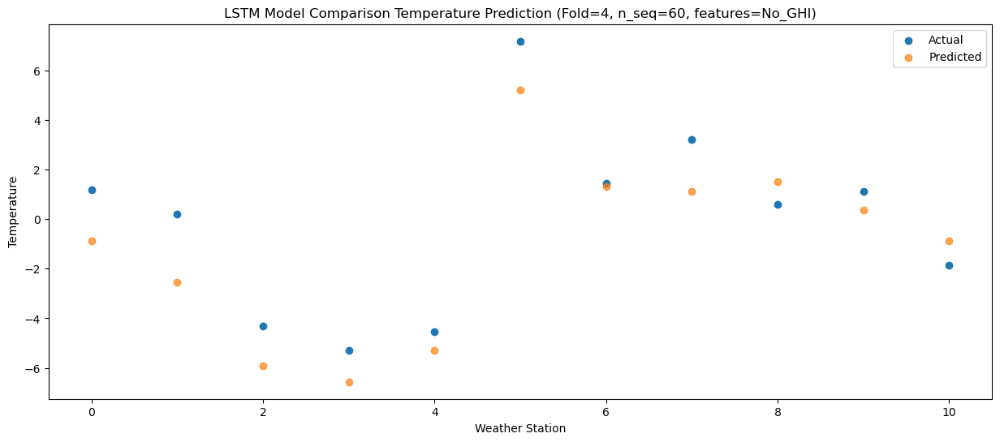

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -0.873787
1                 1   -1.27  -2.548450
2                 2   -4.50  -5.927914
3                 3   -5.05  -6.562029
4                 4   -3.93  -5.289584
5                 5    6.44   5.204732
6                 6    1.27   1.305595
7                 7    1.54   1.125744
8                 8   -0.34   1.499222
9                 9   -1.34   0.363239
10               10   -3.07  -0.879562


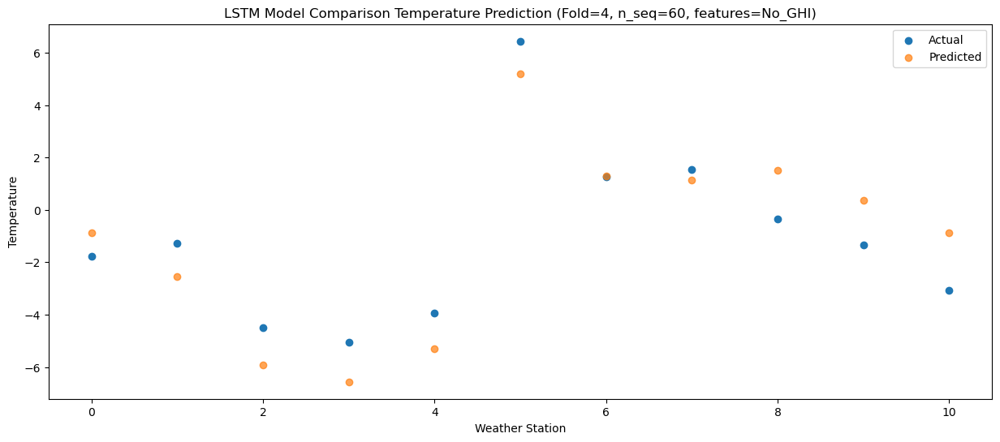

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -1.308891
1                 1    0.28  -2.995162
2                 2   -4.24  -6.373512
3                 3   -5.38  -7.003119
4                 4   -4.31  -5.728285
5                 5    5.68   4.768388
6                 6    1.74   0.861950
7                 7    2.11   0.682674
8                 8   -1.17   1.049005
9                 9   -1.59  -0.079777
10               10   -3.88  -1.327935


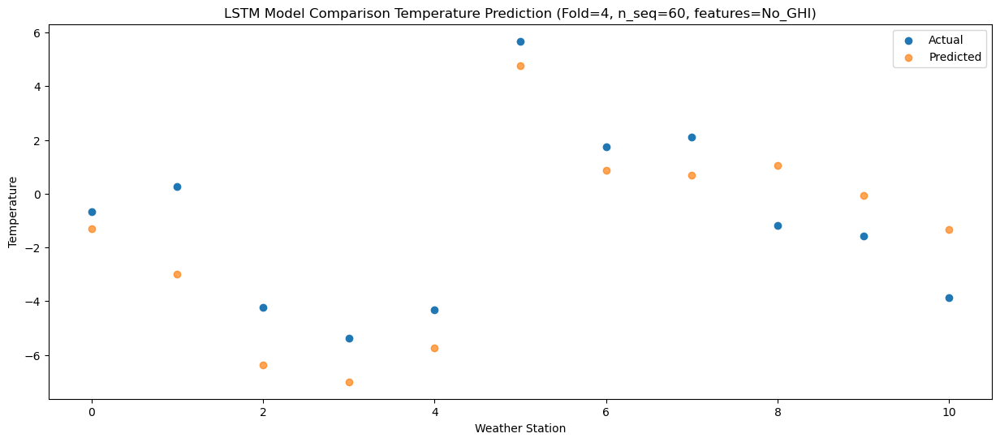

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   4.229494
1                 1    4.35   2.543553
2                 2    3.56  -0.831813
3                 3    2.08  -1.463131
4                 4    3.57  -0.189653
5                 5   13.24  10.305937
6                 6    7.35   6.401634
7                 7    9.04   6.220382
8                 8    5.65   6.581858
9                 9    6.01   5.456214
10               10    2.28   4.200798


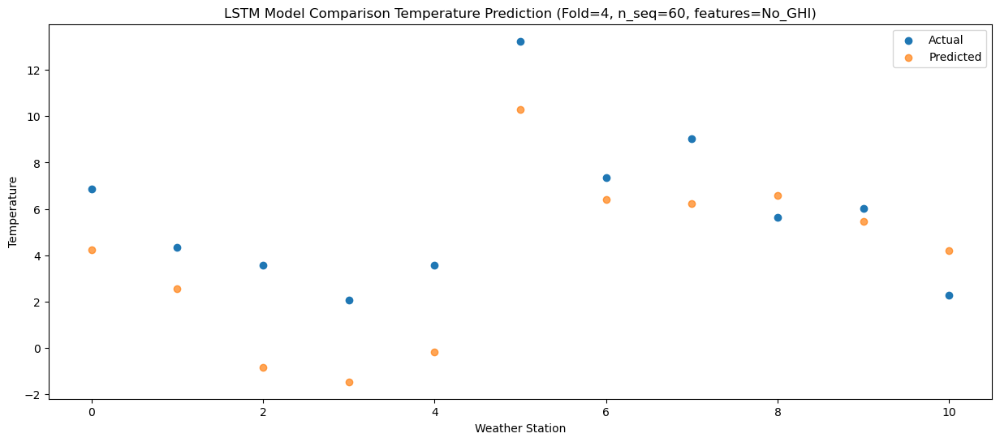

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   6.799725
1                 1    6.03   5.122986
2                 2    2.61   1.742968
3                 3    2.74   1.108494
4                 4    4.26   2.377459
5                 5   16.21  12.869084
6                 6    8.62   8.966319
7                 7   10.62   8.785947
8                 8    8.64   9.142760
9                 9    9.12   8.012330
10               10    3.66   6.758108


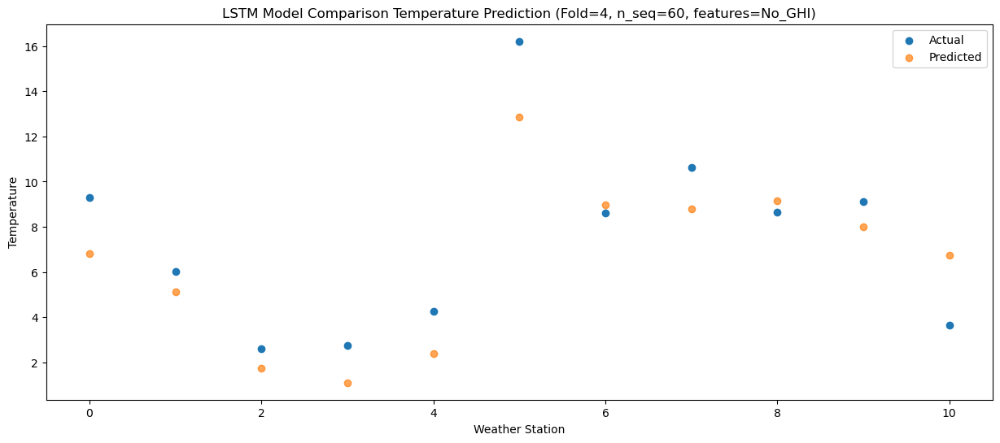

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36  13.312255
1                 1    7.43  11.628288
2                 2    6.49   8.242315
3                 3    7.87   7.615653
4                 4    9.91   8.887924
5                 5   22.78  19.381933
6                 6   11.41  15.473713
7                 7   14.72  15.293919
8                 8   14.22  15.649644
9                 9   15.00  14.523321
10               10   10.40  13.265869


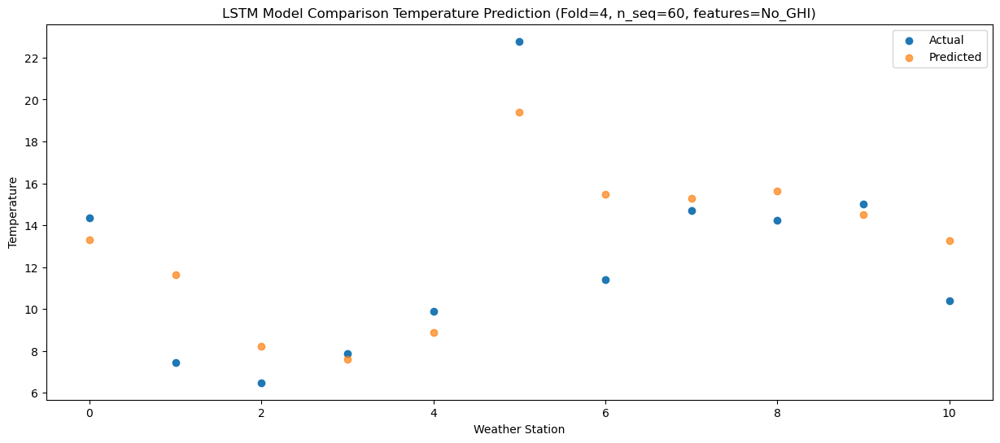

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  18.869194
1                 1    9.19  17.178682
2                 2   10.58  13.792503
3                 3   12.83  13.172254
4                 4   14.62  14.447532
5                 5   26.11  24.938392
6                 6   16.00  21.031859
7                 7   21.07  20.854633
8                 8   21.51  21.210861
9                 9   22.73  20.087852
10               10   16.89  18.827788


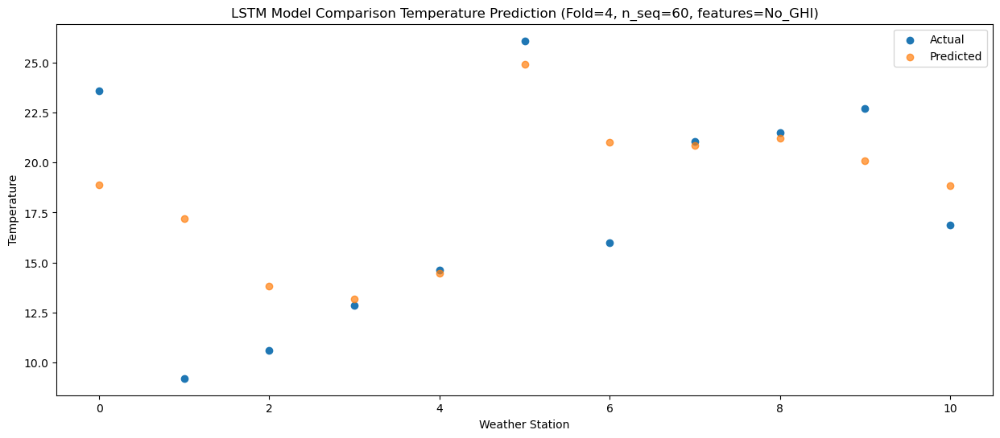

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  21.873374
1                 1    9.51  20.191742
2                 2   12.15  16.798252
3                 3   14.69  16.170836
4                 4   17.06  17.441302
5                 5   28.94  27.934404
6                 6   19.04  24.038217
7                 7   23.61  23.853662
8                 8   23.55  24.214636
9                 9   23.94  23.092030
10               10   20.33  21.838003


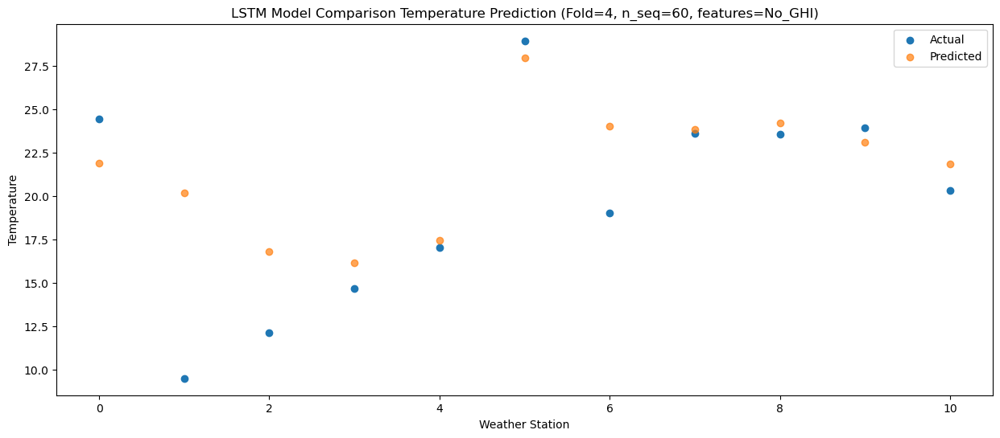

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  20.796903
1                 1    9.36  19.118470
2                 2   11.32  15.722499
3                 3   14.44  15.097810
4                 4   16.38  16.371388
5                 5   28.32  26.868567
6                 6   17.84  22.967301
7                 7   21.62  22.781318
8                 8   21.35  23.137320
9                 9   21.34  22.010611
10               10   17.92  20.755912


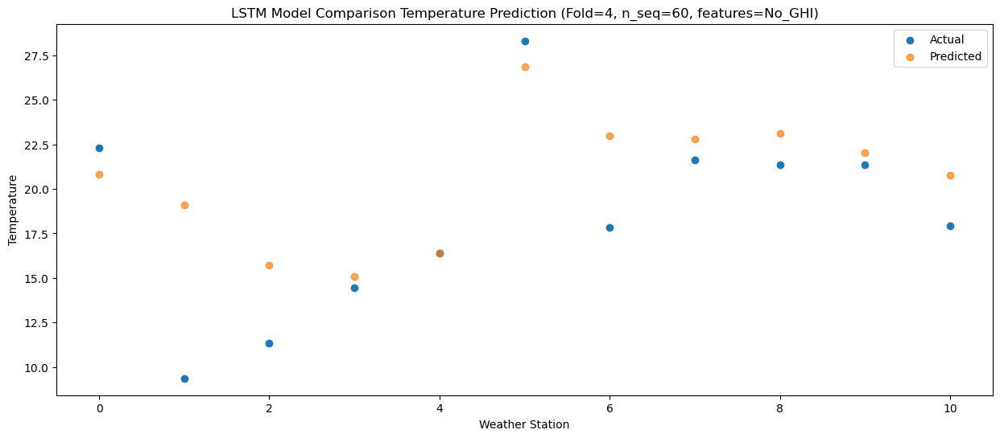

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  15.887294
1                 1    8.78  14.221860
2                 2    9.22  10.825082
3                 3    8.66  10.199678
4                 4   10.08  11.471039
5                 5   20.59  21.966655
6                 6   14.04  18.069964
7                 7   18.04  17.879881
8                 8   17.59  18.235423
9                 9   17.44  17.105808
10               10   13.93  15.847525


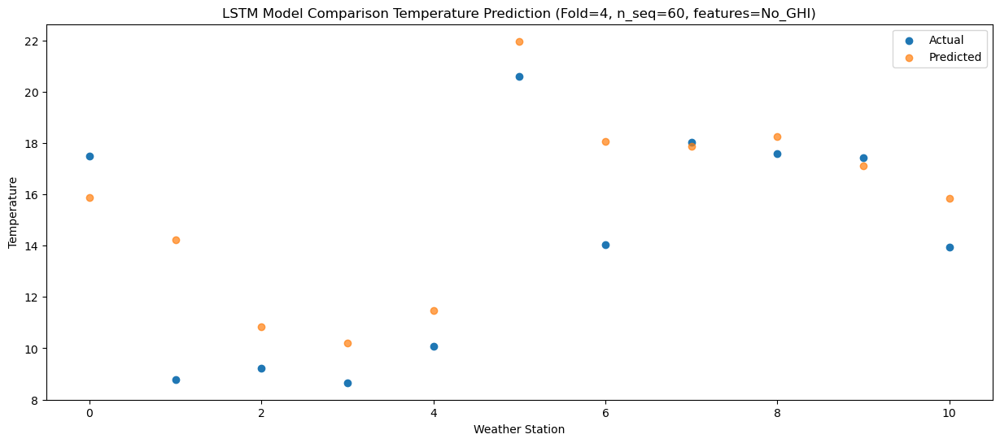

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   9.854154
1                 1    7.28   8.186040
2                 2    3.88   4.790094
3                 3    2.93   4.171316
4                 4    4.33   5.444913
5                 5   16.63  15.939298
6                 6   10.22  12.033771
7                 7   11.11  11.847888
8                 8   10.75  12.202909
9                 9   10.10  11.075564
10               10    7.77   9.808999


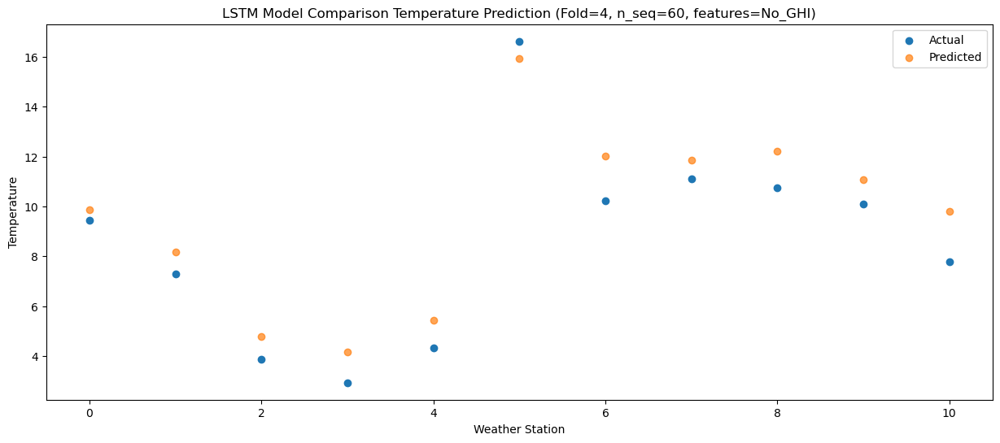

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   5.747129
1                 1    3.89   4.076511
2                 2   -0.12   0.684652
3                 3    0.32   0.068395
4                 4    1.57   1.343660
5                 5   12.75  11.837375
6                 6    5.91   7.939567
7                 7    8.56   7.748940
8                 8    6.91   8.109578
9                 9    7.46   6.978909
10               10    4.54   5.718635


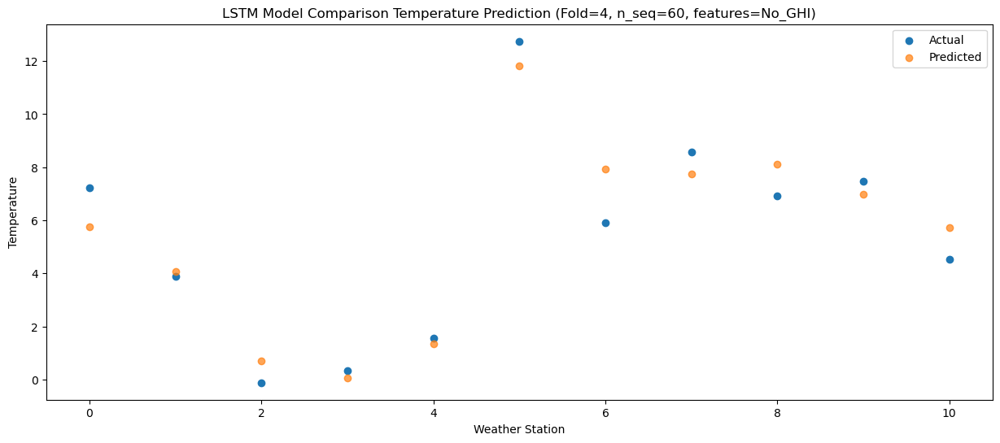

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -0.685859
1                 1   -3.86  -2.364902
2                 2   -6.37  -5.758562
3                 3   -5.96  -6.373769
4                 4   -5.00  -5.098051
5                 5    5.77   5.397201
6                 6   -1.34   1.493753
7                 7    2.03   1.304467
8                 8   -0.60   1.665238
9                 9   -0.42   0.538924
10               10   -3.02  -0.724361


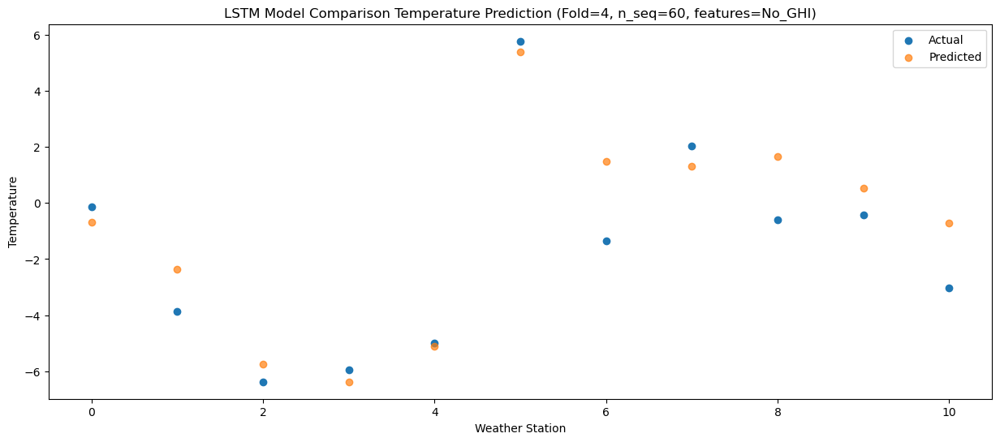

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -1.434455
1                 1   -3.16  -3.116535
2                 2   -6.34  -6.509959
3                 3   -6.88  -7.127722
4                 4   -5.60  -5.854006
5                 5    4.67   4.638010
6                 6   -1.11   0.732642
7                 7    0.36   0.548567
8                 8   -2.18   0.908361
9                 9   -2.45  -0.216673
10               10   -4.94  -1.481231


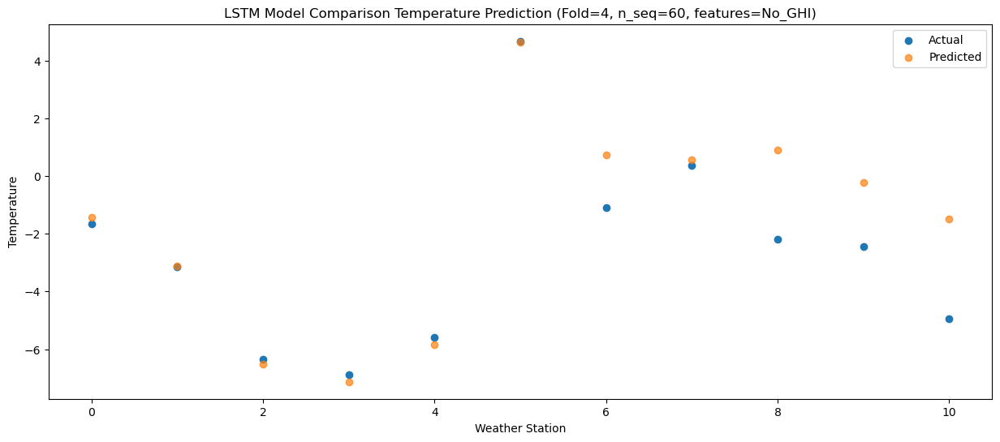

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78  -3.154306
1                 1    0.27  -4.835513
2                 2   -8.26  -8.222884
3                 3  -10.34  -8.840228
4                 4   -9.49  -7.565182
5                 5    3.10   2.925256
6                 6   -0.44  -0.974855
7                 7   -3.25  -1.161595
8                 8   -5.54  -0.801418
9                 9   -6.89  -1.926260
10               10   -7.18  -3.186288


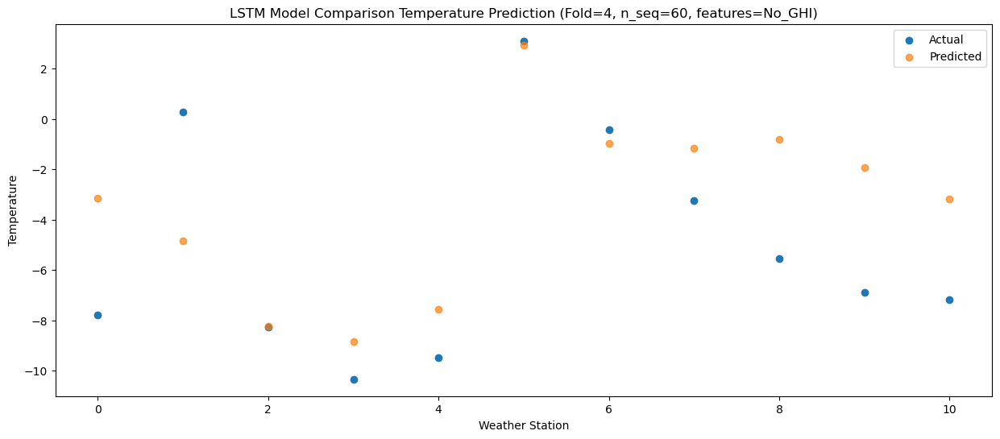

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   4.391426
1                 1    1.87   2.697825
2                 2    1.07  -0.682868
3                 3    0.62  -1.295564
4                 4    1.43  -0.014759
5                 5   12.35  10.474282
6                 6    5.96   6.573043
7                 7    9.02   6.392702
8                 8    6.43   6.753228
9                 9    6.97   5.632922
10               10    2.71   4.367302


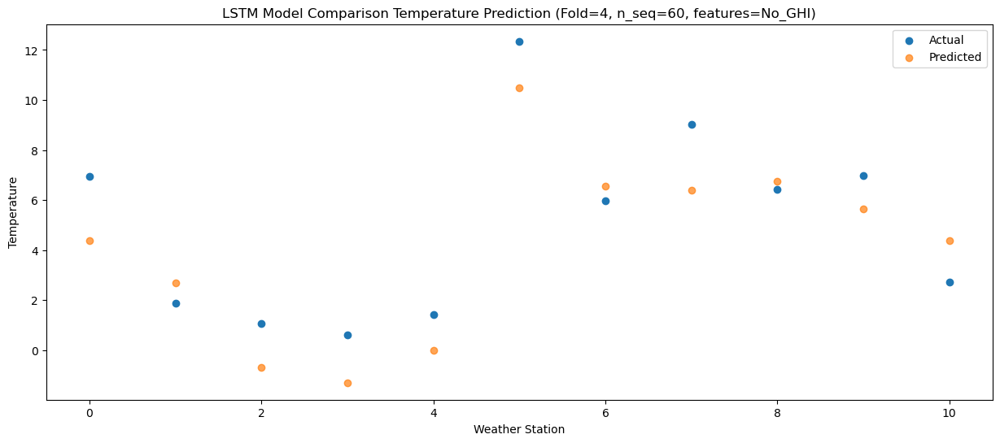

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   8.856347
1                 1    3.31   7.160682
2                 2    2.14   3.776432
3                 3    2.31   3.162771
4                 4    3.61   4.445115
5                 5   14.58  14.937985
6                 6    8.69  11.033532
7                 7   10.92  10.851658
8                 8   10.08  11.210594
9                 9   10.68  10.090484
10               10    6.51   8.825582


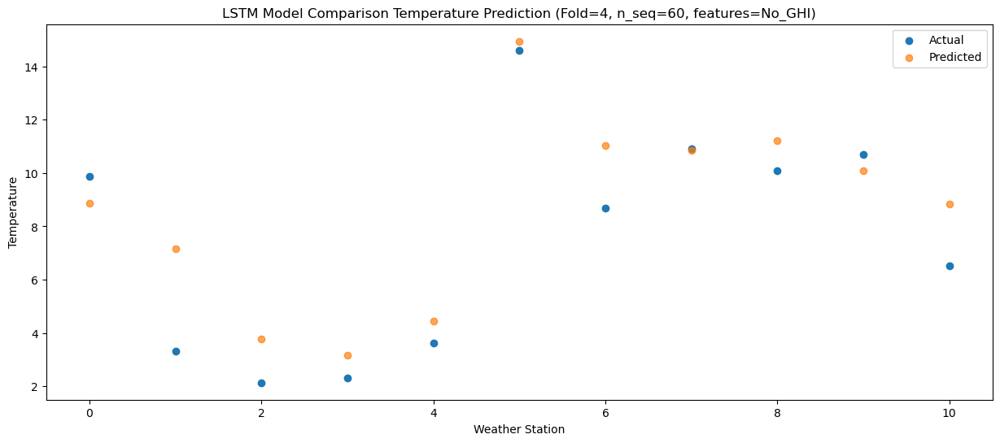

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07  13.883514
1                 1    7.35  12.189705
2                 2    6.61   8.811795
3                 3    6.47   8.203336
4                 4    7.14   9.488395
5                 5   20.07  19.978483
6                 6   12.14  16.072119
7                 7   14.96  15.891757
8                 8   14.49  16.244038
9                 9   15.46  15.122260
10               10   11.04  13.852570


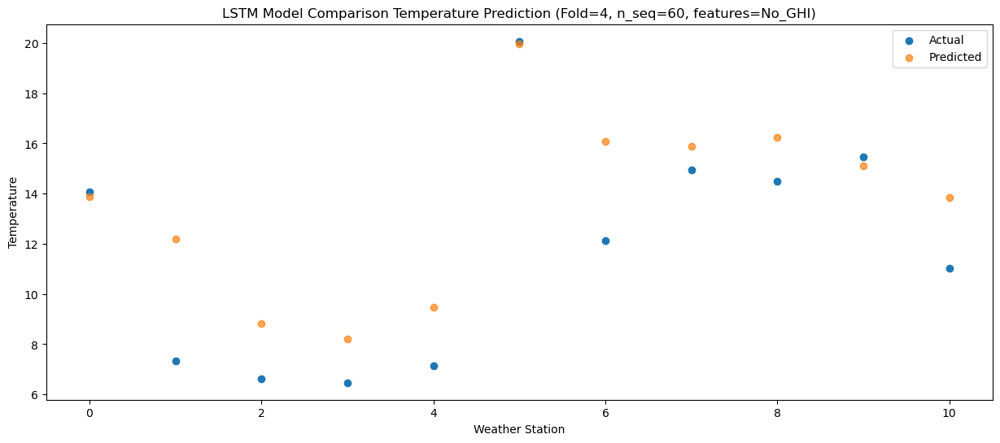

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  20.197642
1                 1    8.98  18.497448
2                 2   10.87  15.116517
3                 3   12.15  14.511513
4                 4   13.99  15.800406
5                 5   25.03  26.291166
6                 6   16.16  22.386081
7                 7   21.26  22.205876
8                 8   21.73  22.555814
9                 9   22.85  21.435052
10               10   17.93  20.163726


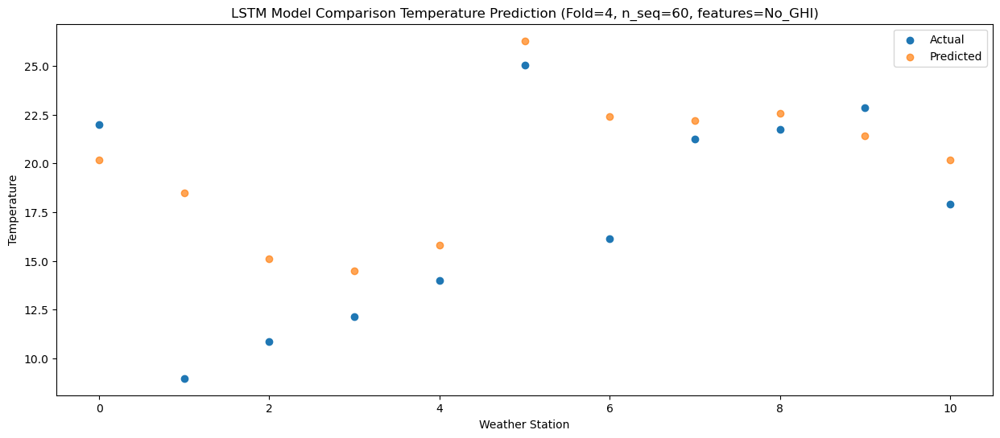

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  20.608881
1                 1    9.35  18.922108
2                 2   11.53  15.535206
3                 3   13.74  14.926035
4                 4   15.48  16.211971
5                 5   24.77  26.704987
6                 6   17.90  22.807415
7                 7   22.55  22.620390
8                 8   22.30  22.971428
9                 9   22.56  21.849299
10               10   18.09  20.587415


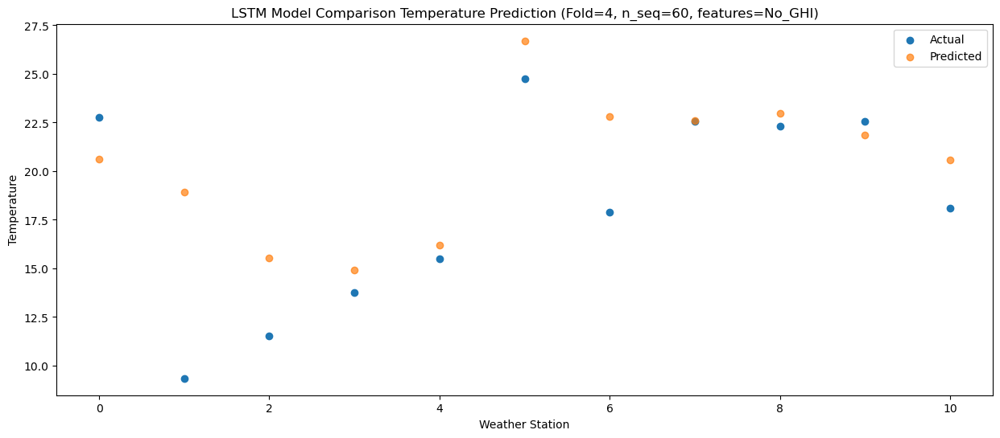

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  20.956998
1                 1    9.63  19.272156
2                 2   12.18  15.887045
3                 3   14.11  15.281504
4                 4   15.85  16.568994
5                 5   25.09  27.055637
6                 6   18.03  23.159645
7                 7   23.07  22.979207
8                 8   23.16  23.332093
9                 9   22.84  22.216275
10               10   19.29  20.948667


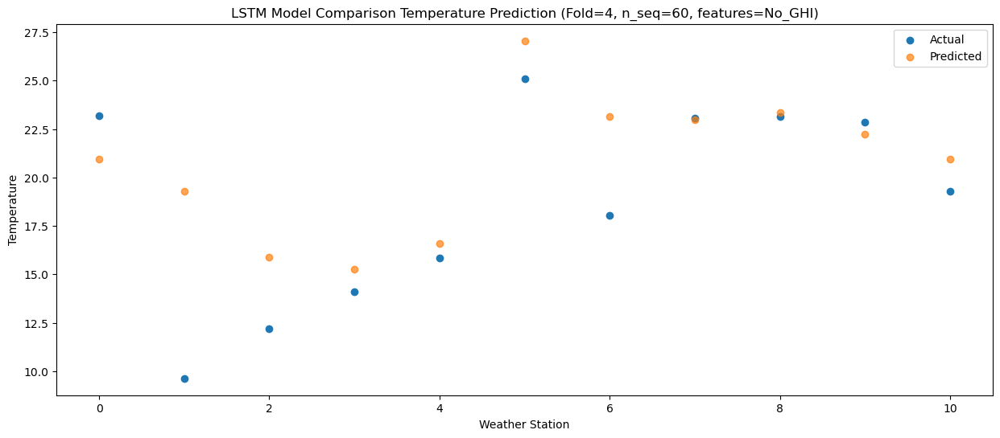

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  16.919745
1                 1    8.34  15.233910
2                 2    9.06  11.857434
3                 3   11.32  11.250541
4                 4   12.42  12.538795
5                 5   24.40  23.021436
6                 6   14.06  19.126013
7                 7   20.03  18.950377
8                 8   19.67  19.299052
9                 9   19.73  18.182564
10               10   15.00  16.911268


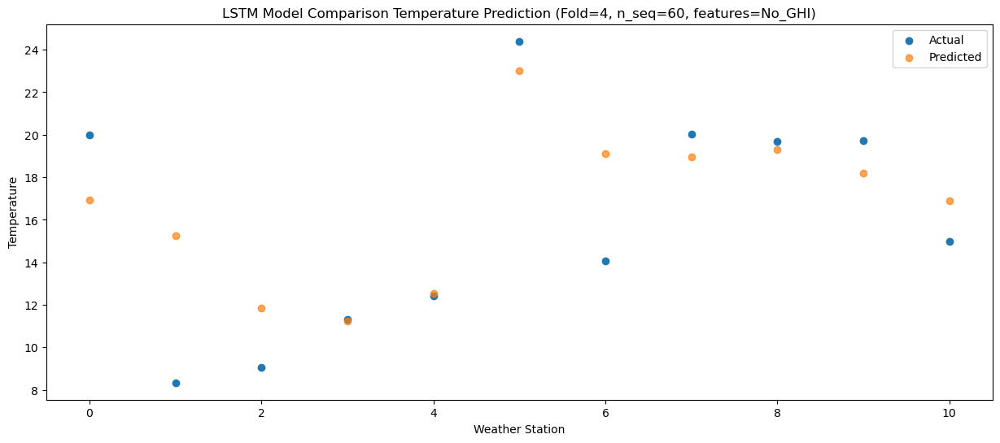

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86  11.944190
1                 1    6.50  10.265322
2                 2    5.67   6.891221
3                 3    6.67   6.281446
4                 4    7.55   7.569179
5                 5   18.70  18.052801
6                 6   10.26  14.157173
7                 7   14.26  13.980398
8                 8   14.32  14.328184
9                 9   14.27  13.208953
10               10   11.47  11.939315


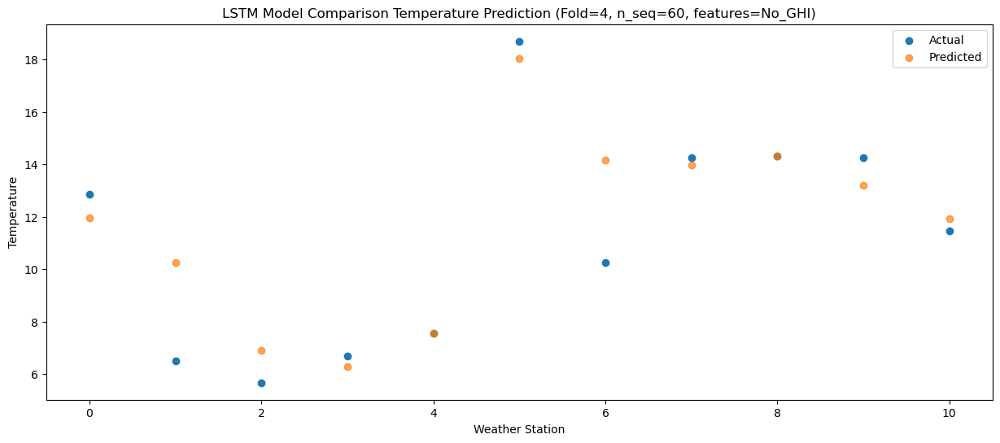

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80   3.809512
1                 1   -0.66   2.135815
2                 2   -3.00  -1.234196
3                 3   -1.33  -1.836014
4                 4   -0.29  -0.543855
5                 5   11.76   9.940546
6                 6    2.10   6.035378
7                 7    6.32   5.855865
8                 8    3.46   6.197304
9                 9    3.96   5.074238
10               10    1.07   3.797972


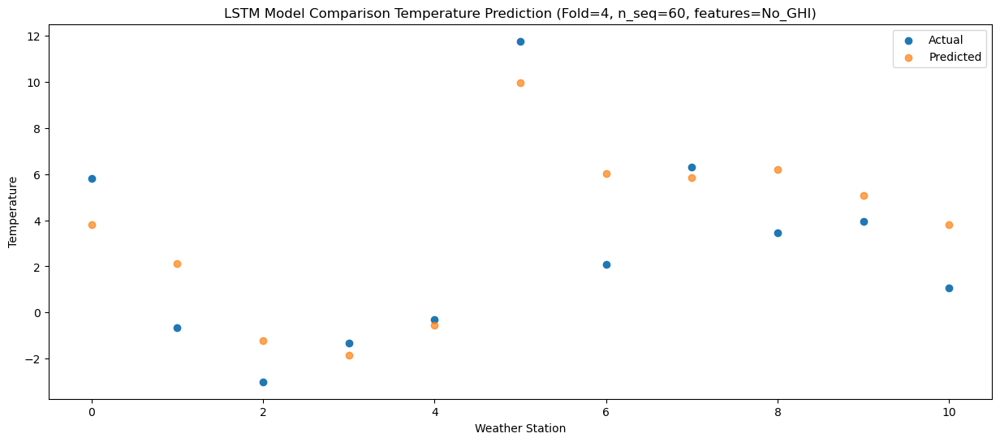

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01   1.474225
1                 1    1.14  -0.191183
2                 2    0.51  -3.561704
3                 3    0.67  -4.166715
4                 4    1.45  -2.876975
5                 5   12.17   7.607908
6                 6    4.01   3.706742
7                 7    7.78   3.523119
8                 8    3.78   3.864454
9                 9    3.71   2.739097
10               10    0.21   1.465442


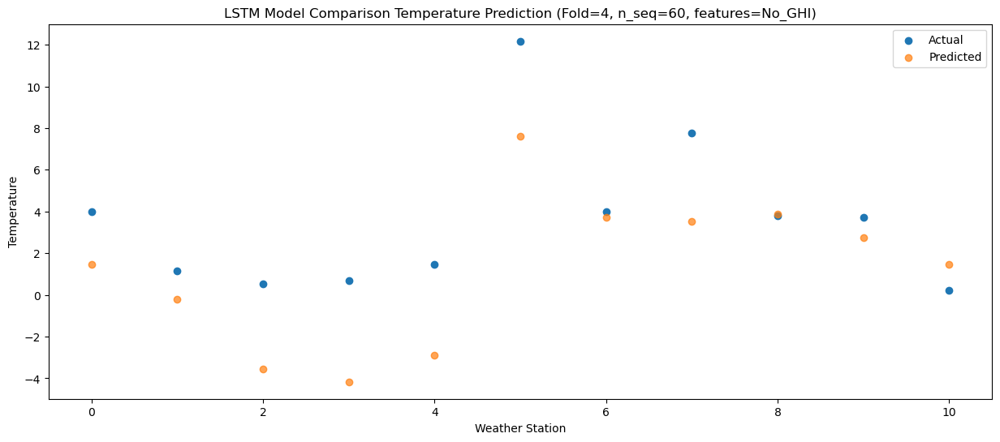

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -4.842861
1                 1   -3.62  -6.500840
2                 2   -7.77  -9.870982
3                 3   -7.80 -10.483167
4                 4   -7.45  -9.196898
5                 5    4.80   1.290251
6                 6   -2.05  -2.603543
7                 7   -1.29  -2.788929
8                 8   -5.06  -2.451538
9                 9   -5.77  -3.579845
10               10   -8.62  -4.851106


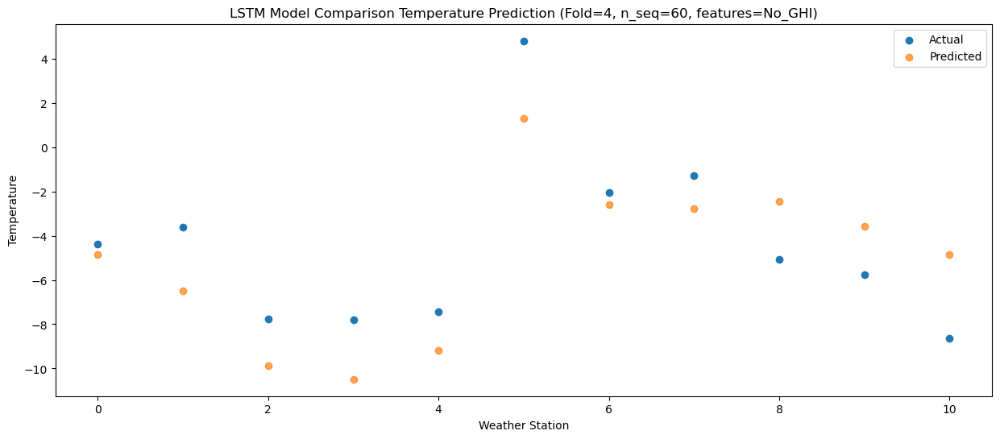

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -2.813077
1                 1   -0.19  -4.495104
2                 2   -5.41  -7.855563
3                 3   -7.54  -8.457046
4                 4   -6.83  -7.163386
5                 5    4.60   3.325384
6                 6    2.23  -0.571841
7                 7    0.77  -0.751369
8                 8   -2.04  -0.411019
9                 9   -2.94  -1.536502
10               10   -5.06  -2.805970


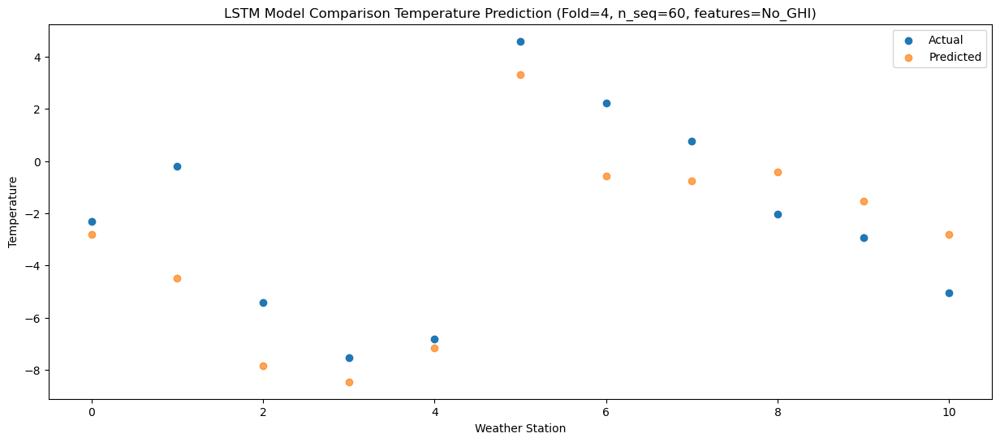

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41   2.978371
1                 1    2.63   1.300770
2                 2   -0.67  -2.047805
3                 3   -1.36  -2.649455
4                 4    0.09  -1.357971
5                 5   11.92   9.130518
6                 6    5.79   5.240392
7                 7    7.43   5.061649
8                 8    5.43   5.404544
9                 9    5.27   4.274179
10               10    0.91   3.008489


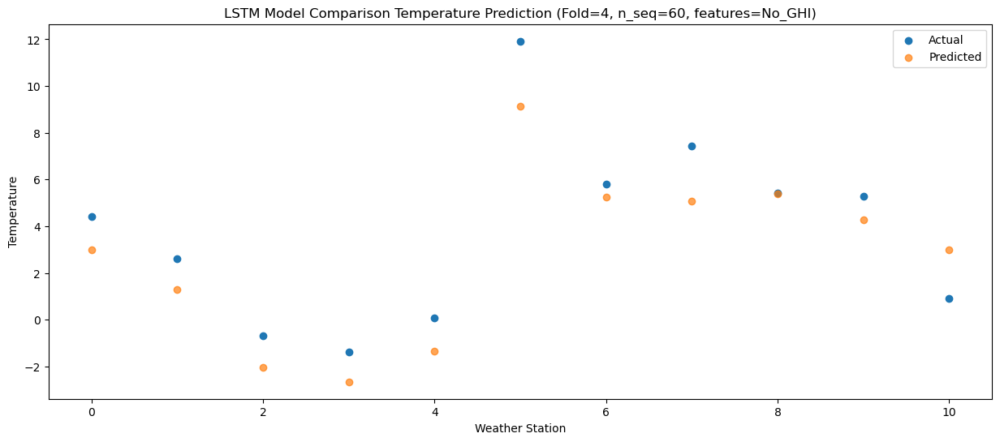

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   7.882664
1                 1    4.97   6.197194
2                 2    3.54   2.848637
3                 3    4.69   2.248784
4                 4    6.78   3.540584
5                 5   19.43  14.031271
6                 6    8.45  10.134220
7                 7   11.29   9.957191
8                 8    9.21  10.300862
9                 9    9.39   9.174287
10               10    4.91   7.906357


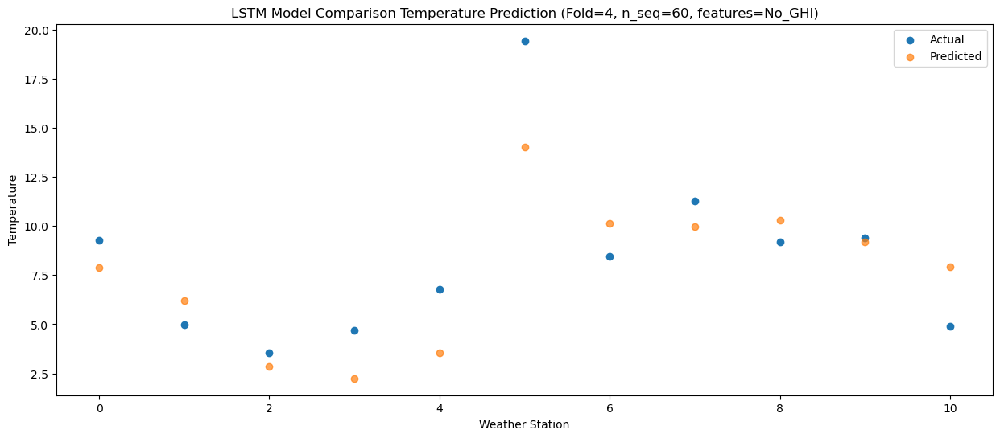

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23  14.844029
1                 1    7.79  13.151639
2                 2    9.34   9.804413
3                 3    9.40   9.203858
4                 4   11.61  10.494664
5                 5   25.12  20.984544
6                 6   14.43  17.088529
7                 7   16.96  16.916992
8                 8   17.71  17.262939
9                 9   17.92  16.137363
10               10   13.49  14.872102


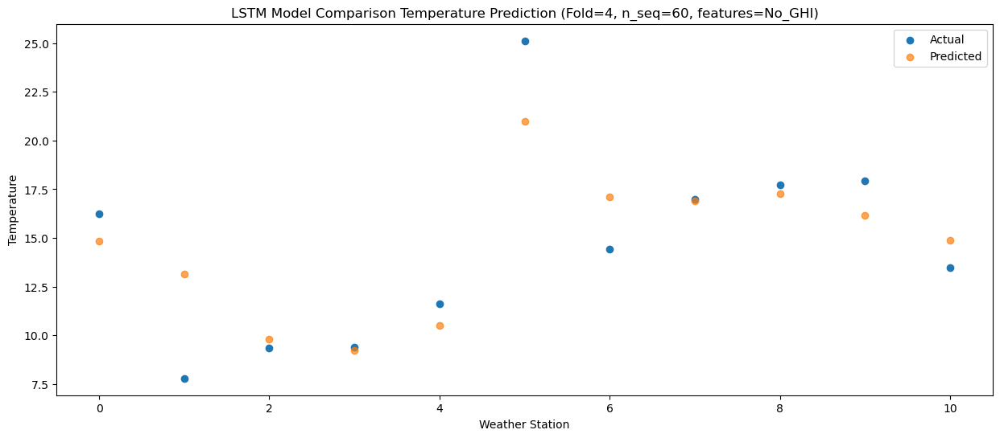

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  19.023241
1                 1    9.51  17.320695
2                 2   12.63  13.971464
3                 3   13.95  13.379610
4                 4   16.28  14.672924
5                 5   27.49  25.162991
6                 6   17.64  21.254569
7                 7   22.28  21.091490
8                 8   22.19  21.431572
9                 9   22.53  20.310489
10               10   16.76  19.035073


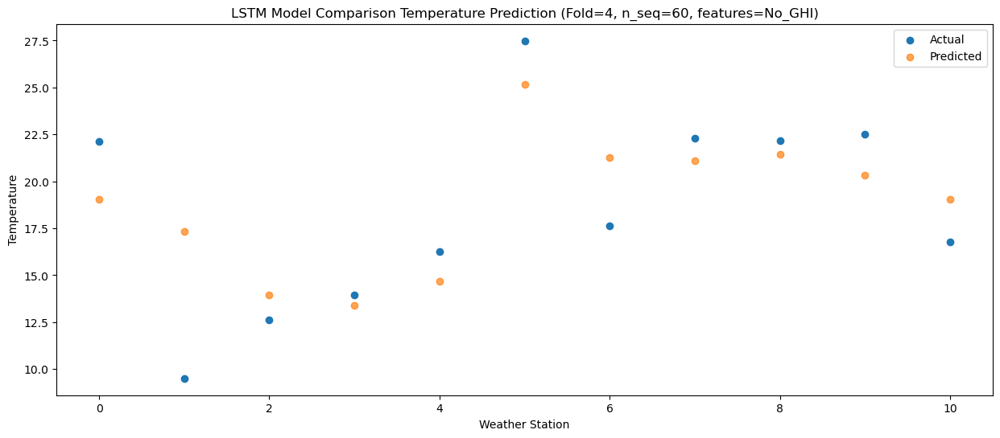

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  21.182836
1                 1    9.88  19.477578
2                 2   12.83  16.121925
3                 3   17.25  15.533218
4                 4   19.70  16.828174
5                 5   29.39  27.319525
6                 6   18.91  23.404896
7                 7   25.98  23.240659
8                 8   24.13  23.579735
9                 9   23.35  22.459933
10               10   19.36  21.182838


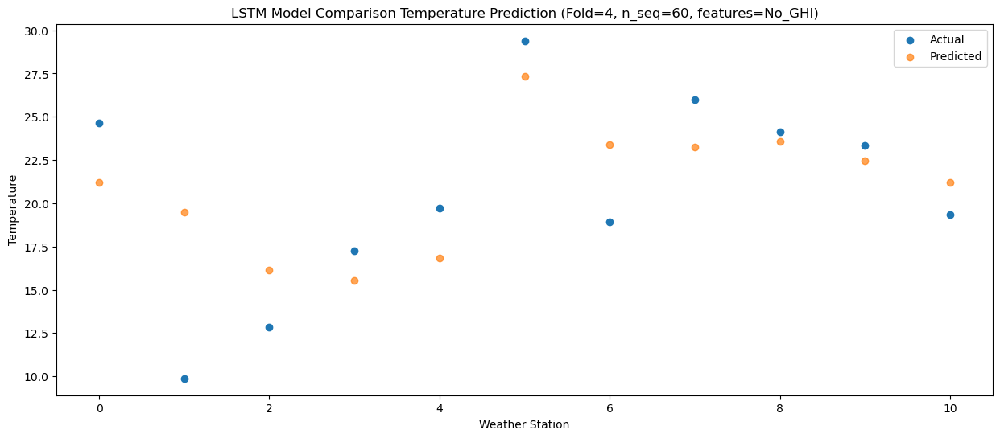

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  20.174783
1                 1    9.83  18.460523
2                 2   11.29  15.106805
3                 3   14.52  14.524051
4                 4   16.86  15.823537
5                 5   26.09  26.316011
6                 6   17.39  22.397806
7                 7   22.46  22.233153
8                 8   21.90  22.569427
9                 9   22.05  21.452005
10               10   18.29  20.171038


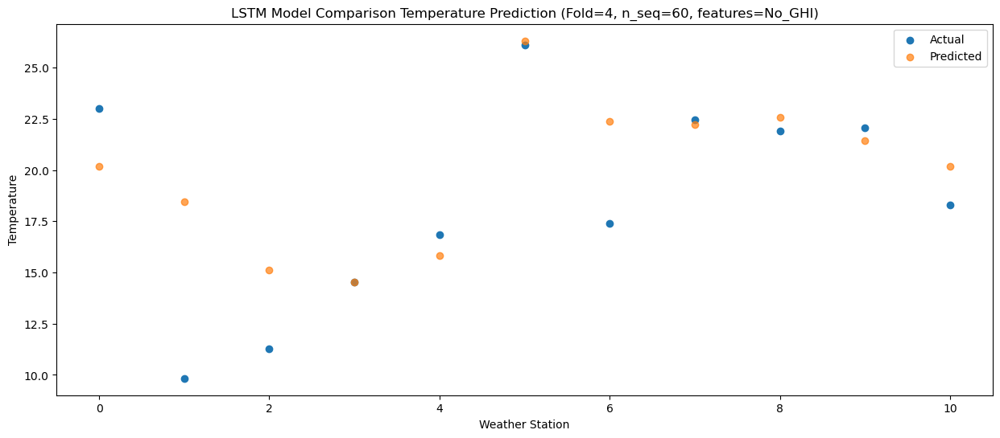

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09  16.533809
1                 1    8.39  14.818255
2                 2    9.22  11.467753
3                 3   11.09  10.889326
4                 4   12.77  12.191168
5                 5   23.19  22.687703
6                 6   14.30  18.760618
7                 7   18.87  18.593359
8                 8   17.99  18.924831
9                 9   17.91  17.805707
10               10   14.24  16.521086


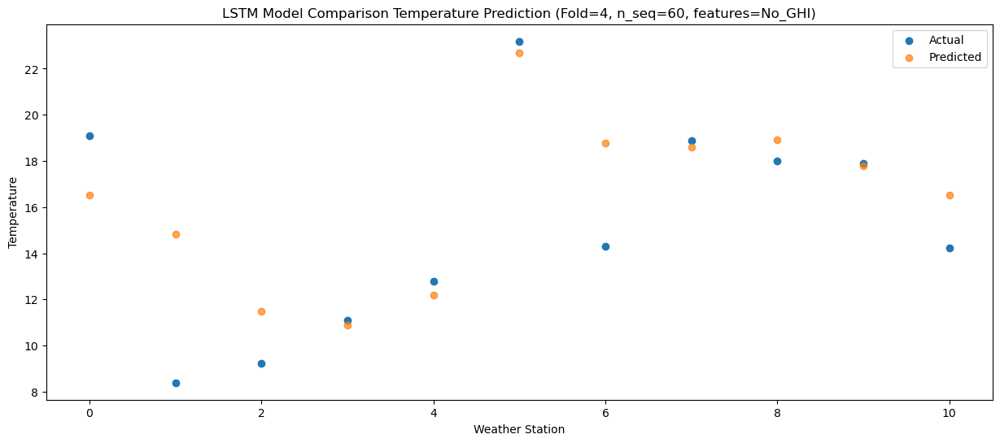

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   9.780979
1                 1    4.56   8.058226
2                 2    3.09   4.711590
3                 3    4.22   4.130908
4                 4    5.62   5.431798
5                 5   16.38  15.927673
6                 6    7.43  12.000162
7                 7   12.50  11.835219
8                 8   10.50  12.164799
9                 9   10.44  11.048689
10               10    7.38   9.760505


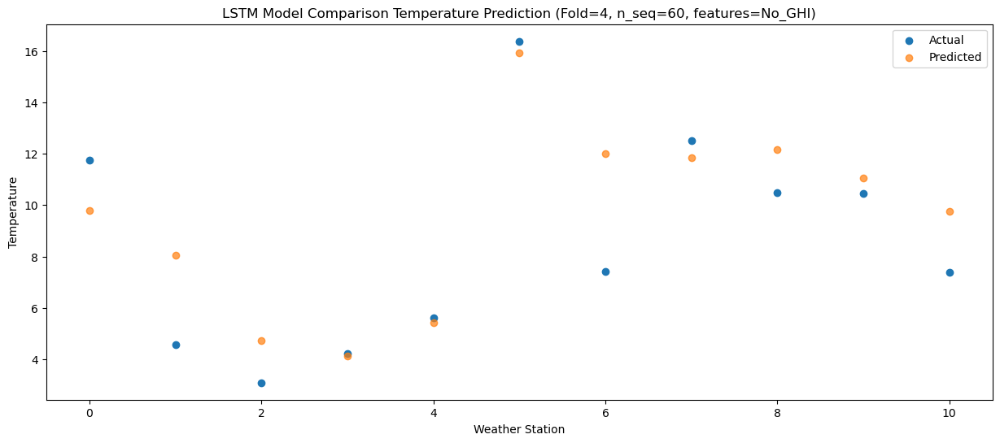

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41   3.634693
1                 1    3.10   1.925850
2                 2   -1.50  -1.423491
3                 3   -2.83  -2.007194
4                 4   -1.47  -0.707864
5                 5    8.53   9.784640
6                 6    4.73   5.860029
7                 7    5.95   5.693849
8                 8    4.71   6.019907
9                 9    4.90   4.906208
10               10    3.30   3.616314


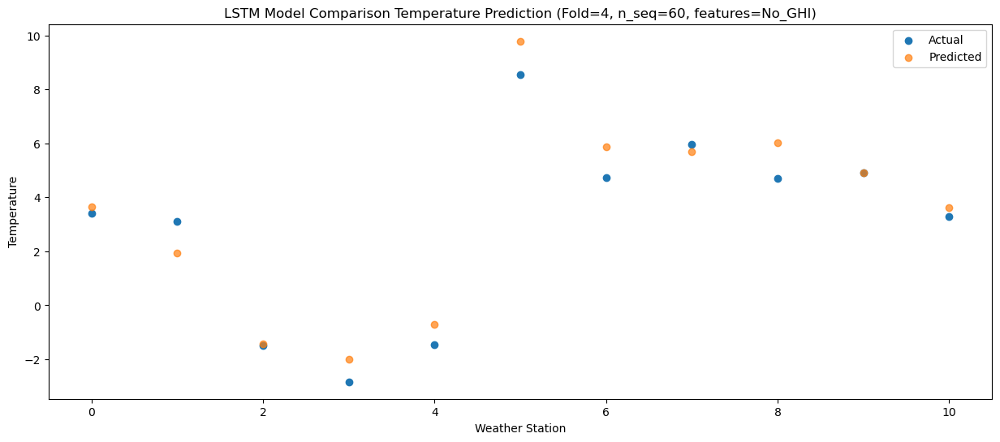

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -1.534408
1                 1   -1.75  -3.231762
2                 2   -3.93  -6.575845
3                 3   -5.52  -7.159789
4                 4   -4.44  -5.861136
5                 5    6.93   4.631032
6                 6   -1.22   0.706170
7                 7    1.10   0.541756
8                 8   -1.07   0.864004
9                 9   -1.83  -0.255443
10               10   -3.41  -1.545367


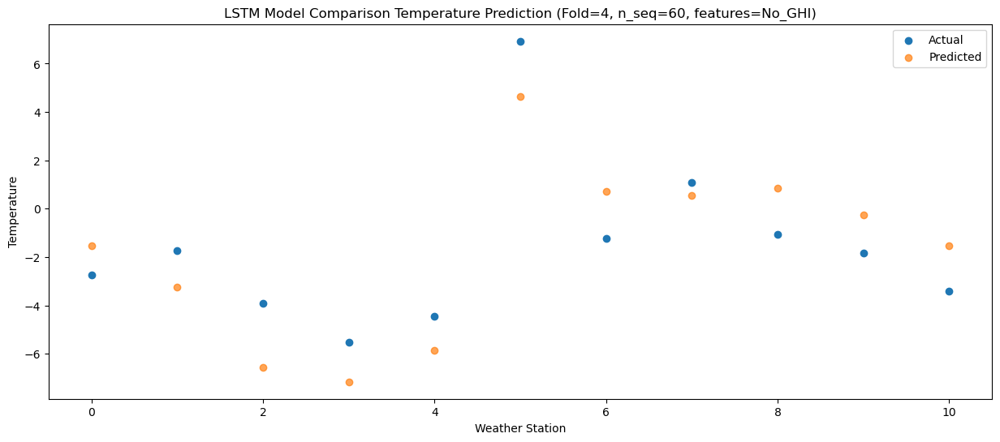

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77  -0.638074
1                 1   -1.90  -2.332281
2                 2   -3.52  -5.674729
3                 3   -4.53  -6.256350
4                 4   -3.67  -4.957071
5                 5    7.30   5.532002
6                 6    1.80   1.608375
7                 7    2.75   1.446935
8                 8    0.89   1.763097
9                 9    0.41   0.642590
10               10   -1.78  -0.649979


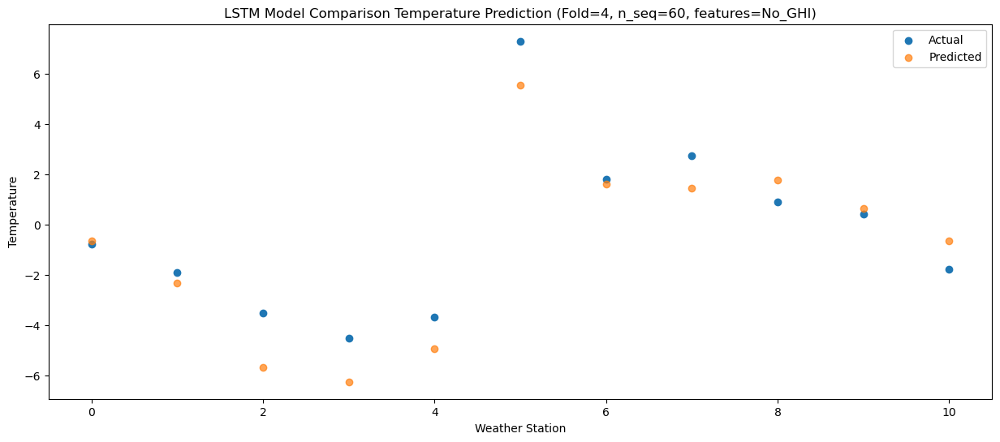

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98  -0.605346
1                 1    1.40  -2.295743
2                 2   -1.58  -5.629979
3                 3   -4.47  -6.217650
4                 4   -3.44  -4.920431
5                 5    7.47   5.560986
6                 6    5.22   1.644065
7                 7    4.89   1.485814
8                 8    2.48   1.800428
9                 9    1.60   0.675790
10               10   -1.64  -0.619202


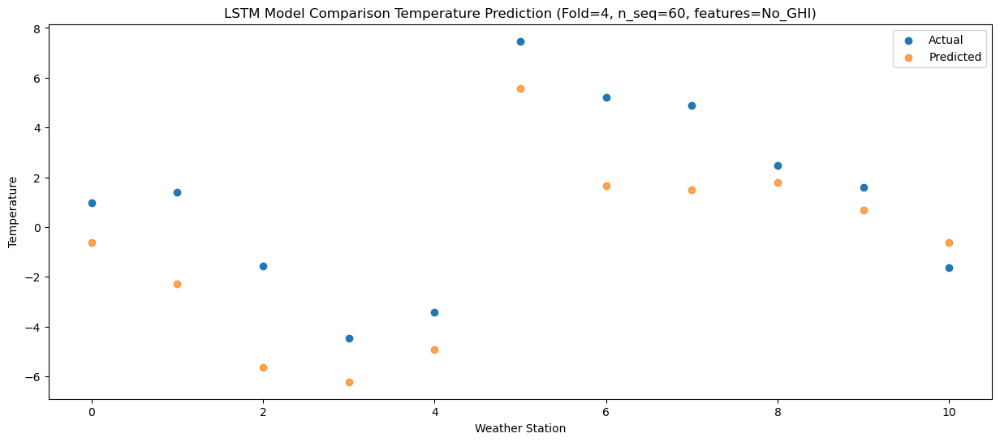

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16   1.983763
1                 1    3.12   0.280571
2                 2    0.57  -3.050436
3                 3    0.06  -3.631367
4                 4    1.41  -2.331948
5                 5   12.54   8.150024
6                 6    5.70   4.225483
7                 7    6.61   4.072076
8                 8    3.75   4.381264
9                 9    4.14   3.263506
10               10   -0.76   1.965105


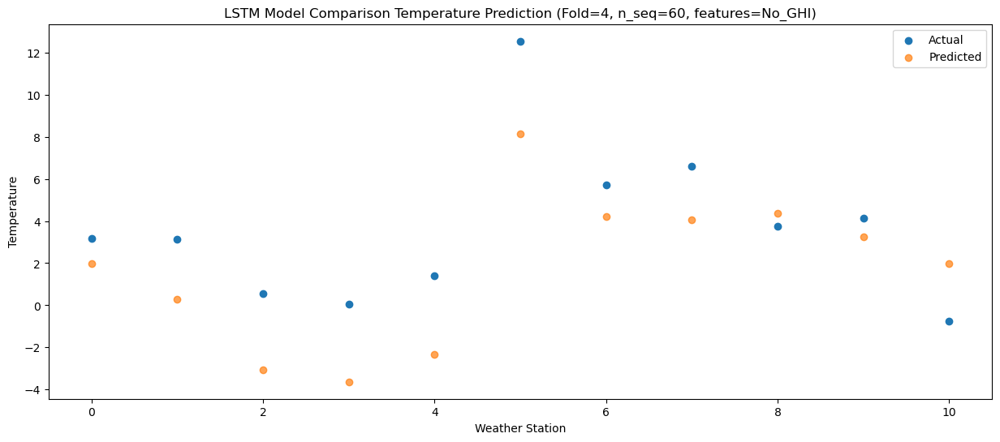

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   8.306507
1                 1    5.84   6.595845
2                 2    2.32   3.265103
3                 3    2.66   2.690306
4                 4    4.06   3.993020
5                 5   16.76  14.472001
6                 6    8.81  10.544108
7                 7   12.23  10.391889
8                 8   10.25  10.700226
9                 9   11.47   9.582783
10               10    7.71   8.280741


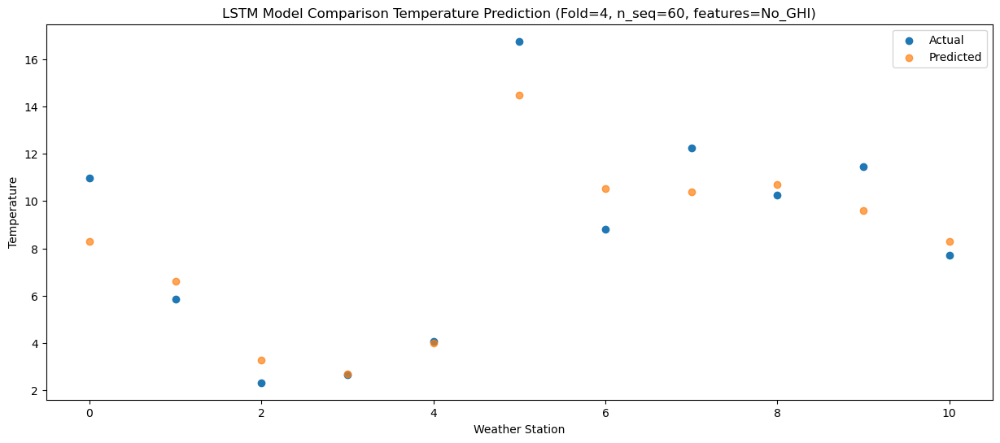

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80  13.123599
1                 1    6.62  11.404446
2                 2    7.18   8.076789
3                 3    8.34   7.509124
4                 4   10.22   8.813473
5                 5   21.68  19.291351
6                 6   11.43  15.356400
7                 7   17.01  15.208097
8                 8   15.96  15.513983
9                 9   17.23  14.400059
10               10   11.40  13.092464


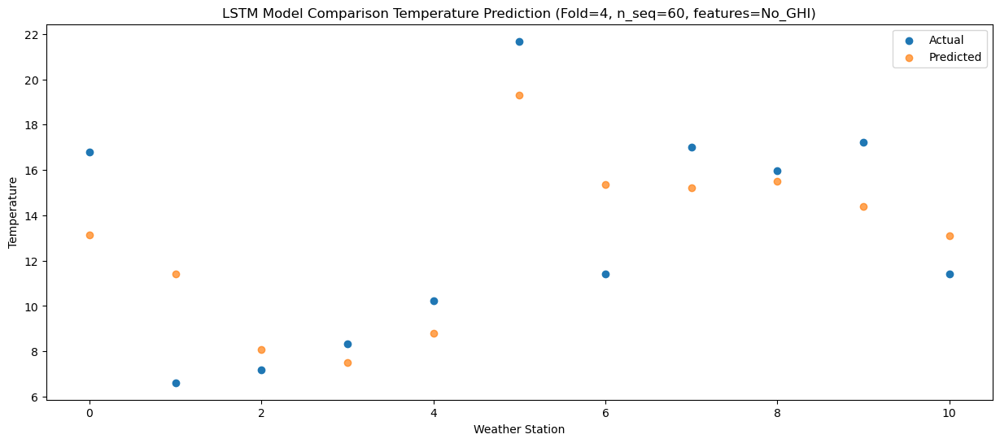

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71  17.454741
1                 1    8.83  15.722236
2                 2   10.77  12.396774
3                 3   12.53  11.835983
4                 4   15.33  13.143186
5                 5   28.16  23.618255
6                 6   15.07  19.677288
7                 7   21.09  19.538973
8                 8   19.84  19.842106
9                 9   21.54  18.733519
10               10   15.71  17.421558


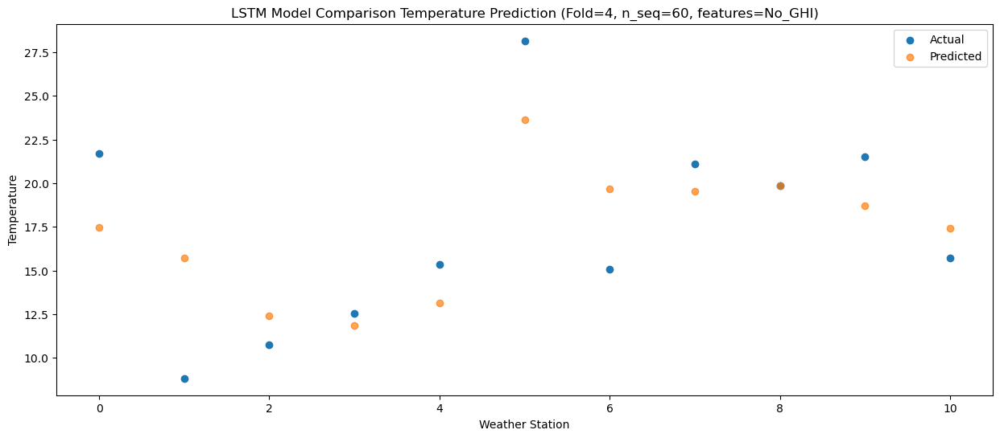

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  20.953888
1                 1   10.44  19.227781
2                 2   12.55  15.897556
3                 3   15.08  15.328943
4                 4   18.41  16.632726
5                 5   29.62  27.111533
6                 6   18.94  23.176254
7                 7   23.05  23.034227
8                 8   22.57  23.340534
9                 9   23.07  22.228908
10               10   18.80  20.926104


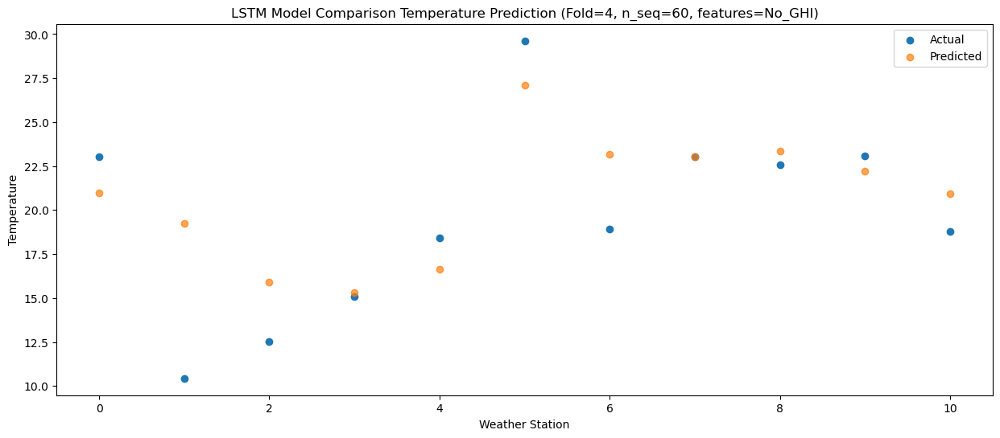

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  19.601108
1                 1   10.95  17.876493
2                 2   14.63  14.546271
3                 3   17.63  13.981535
4                 4   20.28  15.288145
5                 5   29.71  25.764637
6                 6   18.38  21.825691
7                 7   22.86  21.685801
8                 8   21.41  21.988110
9                 9   21.81  20.875588
10               10   17.47  19.565077


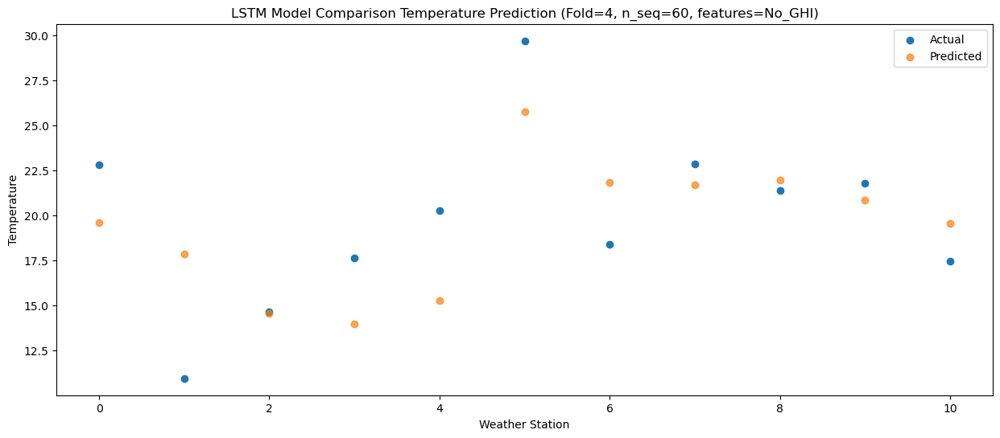

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99  16.693201
1                 1    8.85  14.974128
2                 2   10.88  11.648283
3                 3   12.93  11.079832
4                 4   15.19  12.386962
5                 5   26.23  22.859244
6                 6   14.54  18.934292
7                 7   18.92  18.792288
8                 8   18.32  19.096194
9                 9   18.77  17.976203
10               10   15.13  16.671512


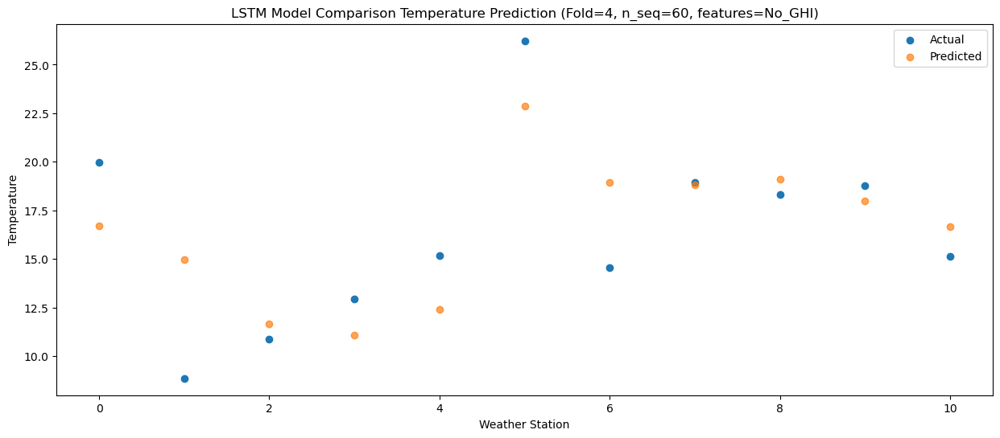

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87  10.838529
1                 1    5.20   9.122306
2                 2    4.77   5.801954
3                 3    4.80   5.231928
4                 4    6.36   6.540774
5                 5   17.70  17.013283
6                 6    9.10  13.087244
7                 7   13.02  12.936917
8                 8   12.18  13.242844
9                 9   12.36  12.120926
10               10    9.87  10.815918


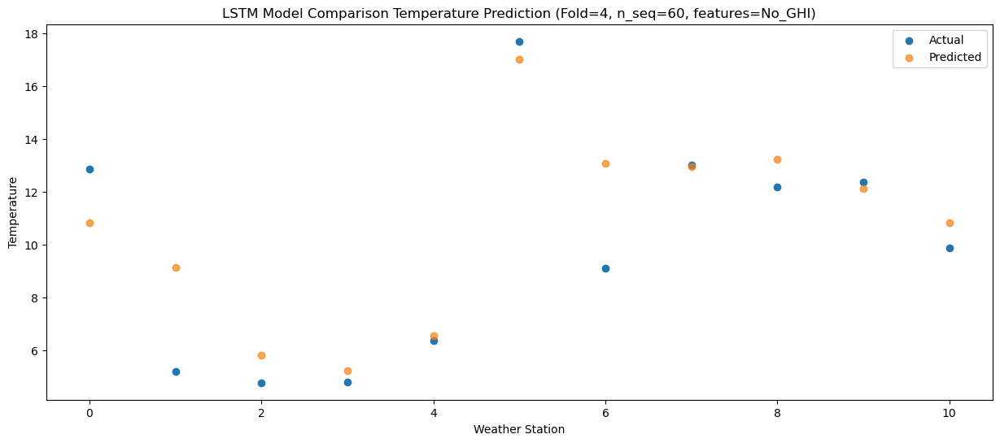

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62   3.526996
1                 1    1.49   1.813133
2                 2   -2.19  -1.502544
3                 3   -1.27  -2.067250
4                 4   -0.17  -0.755928
5                 5   10.99   9.716570
6                 6    3.37   5.787811
7                 7    7.12   5.639278
8                 8    5.11   5.941843
9                 9    5.27   4.817315
10               10    2.48   3.511233


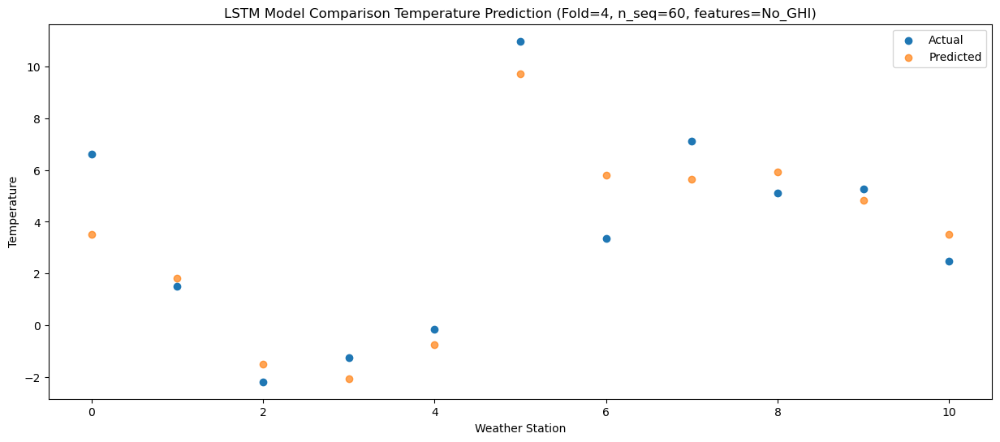

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22   1.673319
1                 1   -0.63  -0.045598
2                 2   -4.74  -3.362495
3                 3   -4.29  -3.924627
4                 4   -3.30  -2.612535
5                 5    8.19   7.862379
6                 6    1.16   3.926768
7                 7    4.24   3.778098
8                 8    3.22   4.080286
9                 9    3.28   2.956534
10               10    1.82   1.649603


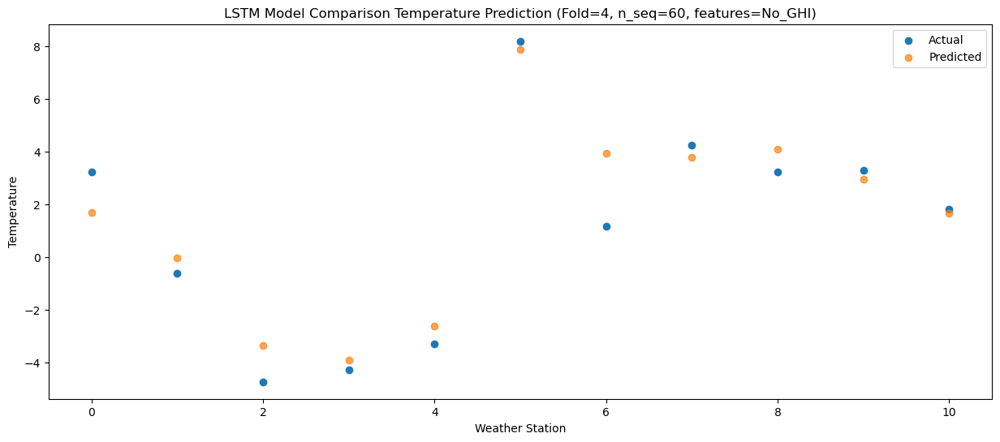

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37  -2.145683
1                 1   -2.05  -3.862169
2                 2   -8.93  -7.192388
3                 3   -9.81  -7.757326
4                 4   -8.65  -6.447037
5                 5    3.94   4.029505
6                 6   -1.28   0.091791
7                 7   -2.92  -0.055435
8                 8   -3.06   0.246705
9                 9   -4.30  -0.872758
10               10   -3.95  -2.182461


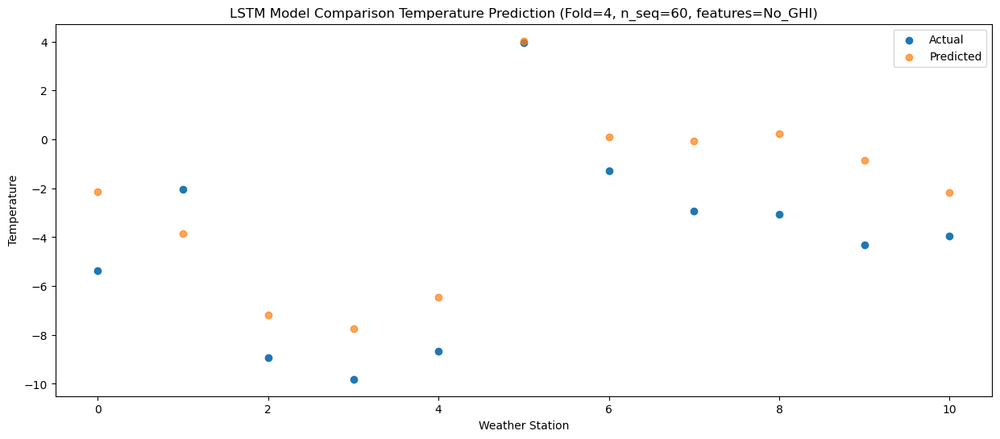

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74   1.350075
1                 1   -2.32  -0.375125
2                 2   -2.61  -3.703050
3                 3   -1.40  -4.262408
4                 4   -0.33  -2.950141
5                 5   10.76   7.528583
6                 6    2.13   3.581005
7                 7    6.99   3.434316
8                 8    3.28   3.735564
9                 9    3.47   2.624237
10               10   -0.47   1.309822


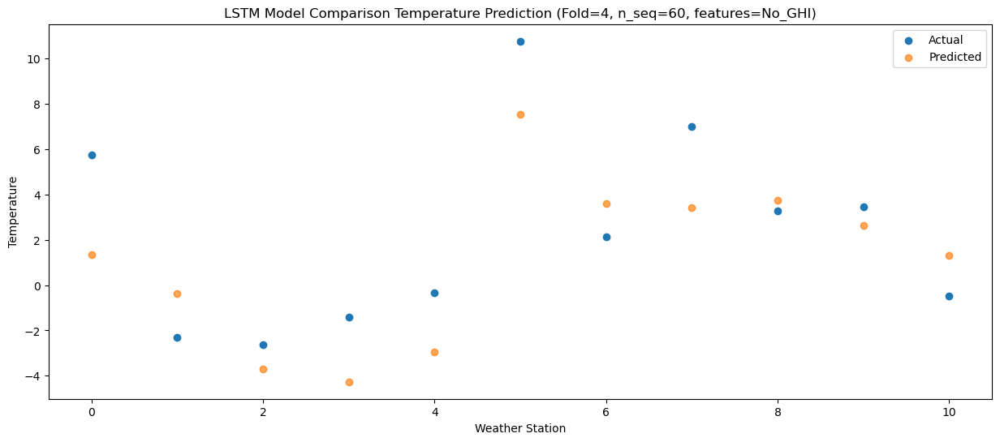

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27   4.108856
1                 1    2.58   2.380189
2                 2   -0.38  -0.942968
3                 3    1.01  -1.498780
4                 4    2.24  -0.186182
5                 5   13.36  10.289324
6                 6    5.92   6.342366
7                 7    9.42   6.197638
8                 8    7.72   6.495787
9                 9    7.62   5.384548
10               10    2.88   4.070456


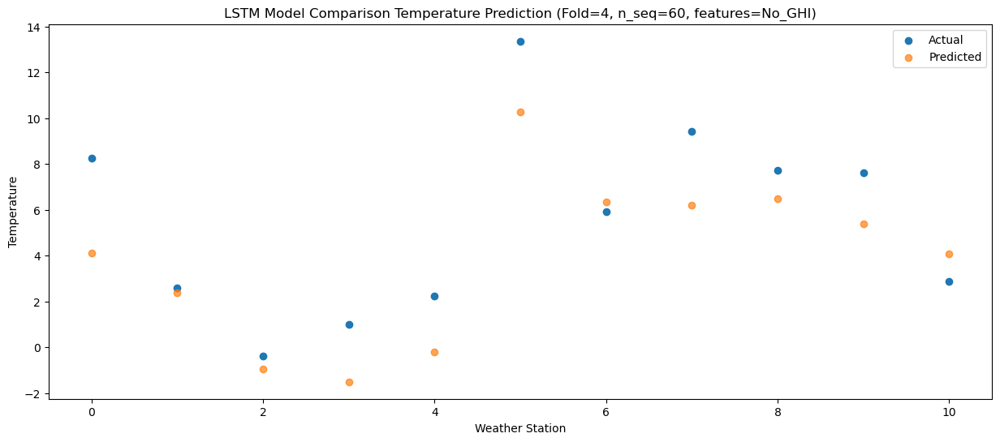

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89   8.905411
1                 1    3.63   7.178151
2                 2    3.44   3.843927
3                 3    4.86   3.284142
4                 4    6.29   4.595809
5                 5   18.32  15.074296
6                 6   10.15  11.126435
7                 7   13.56  10.977950
8                 8   12.30  11.273560
9                 9   12.11  10.165291
10               10    8.60   8.851831


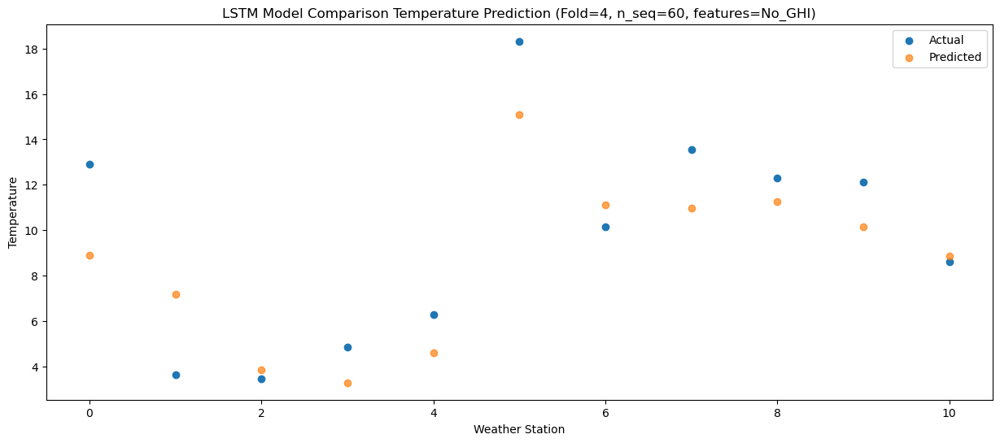

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90  15.094962
1                 1    9.08  13.373447
2                 2    8.96  10.035362
3                 3    9.62   9.469820
4                 4   11.09  10.780629
5                 5   23.61  21.260017
6                 6   14.22  17.318577
7                 7   18.21  17.168508
8                 8   18.90  17.464752
9                 9   19.14  16.357052
10               10   14.70  15.046561


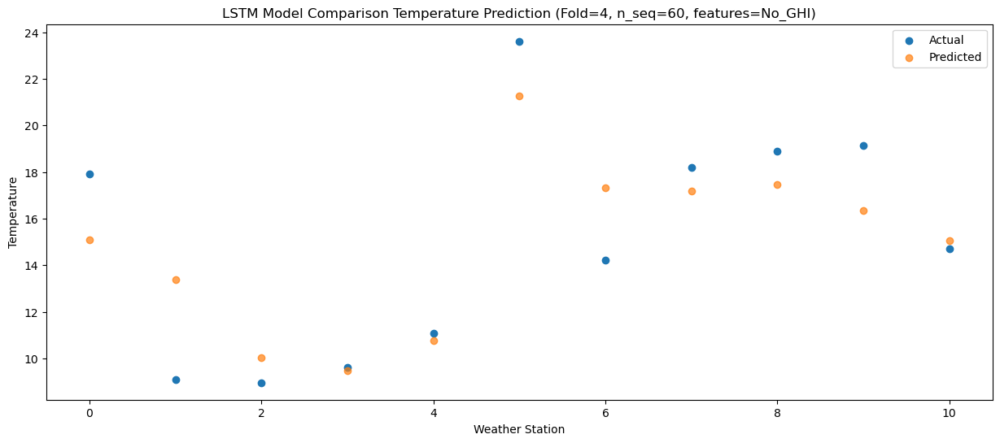

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09  19.634948
1                 1    9.73  17.905949
2                 2   11.59  14.577092
3                 3   13.65  14.014852
4                 4   15.54  15.329150
5                 5   27.62  25.809897
6                 6   17.64  21.865116
7                 7   21.93  21.717474
8                 8   22.26  22.012669
9                 9   23.11  20.905369
10               10   17.86  19.591405


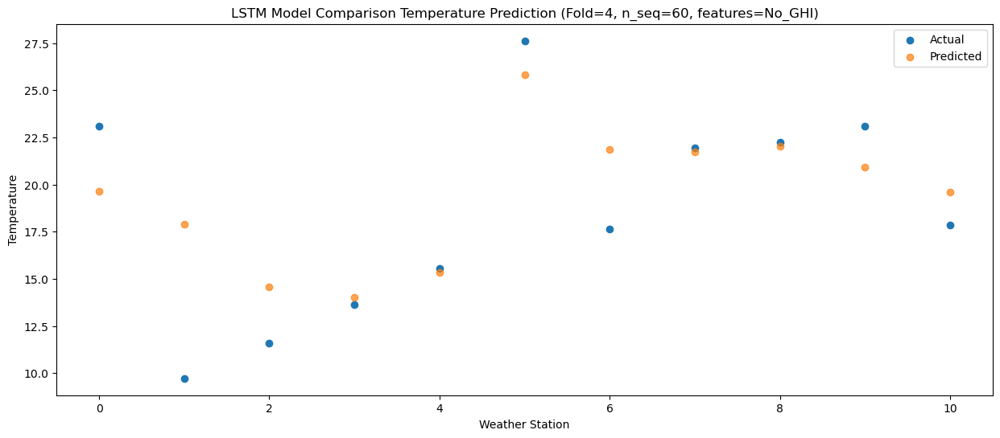

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85  21.520331
1                 1   10.42  19.795826
2                 2   12.61  16.458366
3                 3   14.55  15.895934
4                 4   16.25  17.210232
5                 5   26.45  27.693867
6                 6   19.10  23.750127
7                 7   22.23  23.599219
8                 8   22.27  23.894620
9                 9   22.14  22.787011
10               10   19.38  21.476747


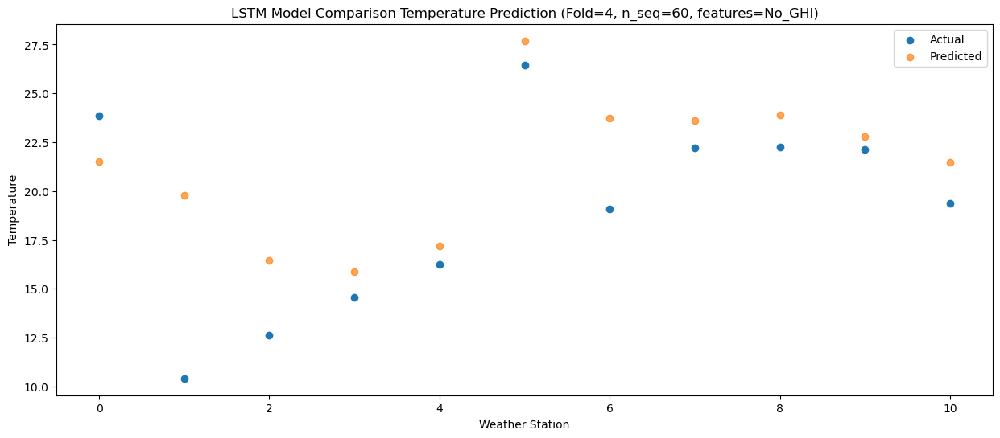

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36  20.351794
1                 1   10.12  18.624206
2                 2   13.18  15.286725
3                 3   16.30  14.729527
4                 4   18.21  16.047489
5                 5   28.91  26.535004
6                 6   17.94  22.585050
7                 7   22.67  22.433576
8                 8   22.19  22.733023
9                 9   21.80  21.623744
10               10   18.24  20.308067


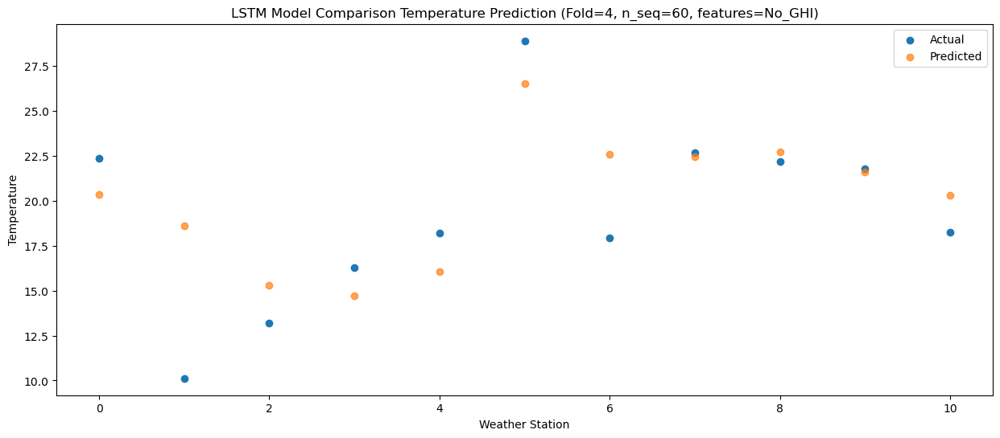

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93  17.392629
1                 1    9.25  15.676441
2                 2    9.57  12.338736
3                 3   10.91  11.775931
4                 4   12.20  13.091194
5                 5   22.46  23.581158
6                 6   15.50  19.630647
7                 7   18.53  19.480835
8                 8   19.58  19.779977
9                 9   18.57  18.670456
10               10   15.97  17.353425


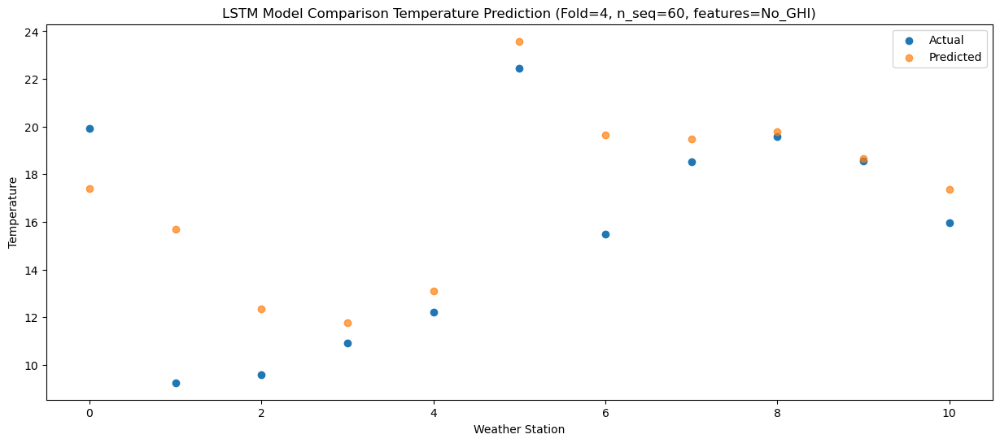

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80  12.280291
1                 1    5.48  10.559573
2                 2    5.43   7.221916
3                 3    8.16   6.661725
4                 4    9.78   7.979416
5                 5   20.75  18.467421
6                 6    9.88  14.516008
7                 7   14.85  14.364817
8                 8   13.65  14.656709
9                 9   13.50  13.548584
10               10    9.50  12.229132


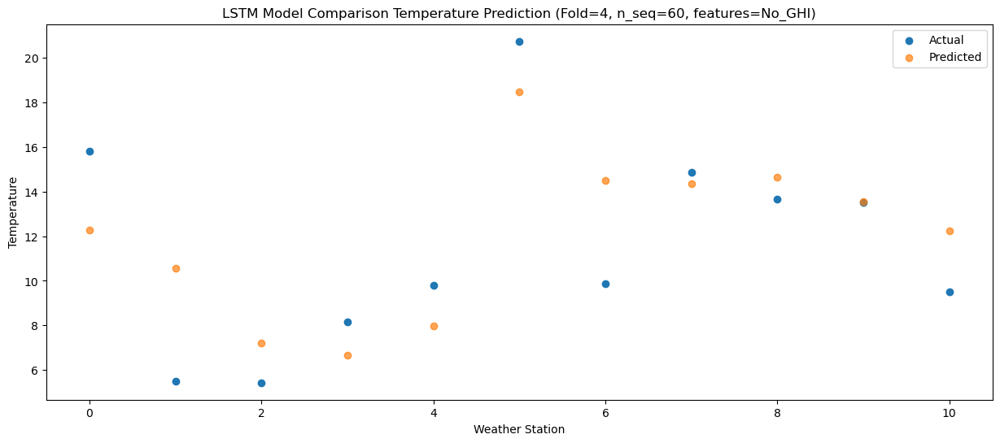

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_18 (LSTM)              (1, 1, 1024)              11632640  
                                                                 
 dropout_18 (Dropout)        (1, 1, 1024)              0         
                                                                 
 lstm_19 (LSTM)              (1, 1024)                 8392704   
                                                                 
 dropout_19 (Dropout)        (1, 1024)                 0         
                                                                 
 dense_27 (Dense)            (1, 256)                  262400    
                                                                 
 dense_28 (Dense)            (1, 128)                  32896     
                                                                 
 dense_29 (Dense)            (1, 60)                  

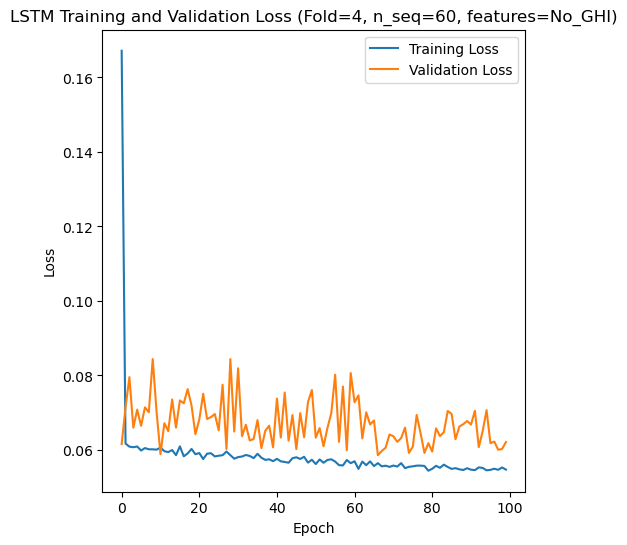

[[1.4490872110353734, 1.0665110421210586, 1.3779007769057967, 1.772638317492152, 2.0386313120476376, 1.6851276434368114, 2.946512116732444, 3.712398597820434, 3.7831363769250337, 3.342030628081048, 2.296044295655267, 0.7200144502920144, 1.3431105293235008, 1.5480974820320519, 1.6527052236813278, 2.221060676066198, 1.7437941238246686, 1.9811483894955642, 2.6077697964066844, 4.552388039328381, 3.778922637952913, 3.7139848474331263, 3.395504469538522, 2.6080479563347883, 2.717898701358448, 2.1211301311939015, 2.0978703851913205, 1.9260785070787514, 0.9574565246469086, 2.0312501838708523, 2.850482227541752, 3.3718070517387204, 4.28202920848195, 3.919111112110216, 3.134645344746822, 2.884185876070974, 1.031161980380456, 2.221361249639031, 1.7748438110976257, 1.860802453736774, 2.2269767386003023, 2.1230249268927808, 4.106812009561084, 4.692763906528751, 4.184850470376818, 4.681626108399268, 4.501493477111503, 3.3168031296232154, 2.609891950801806, 2.5599349801083506, 1.752823511777494, 2.95

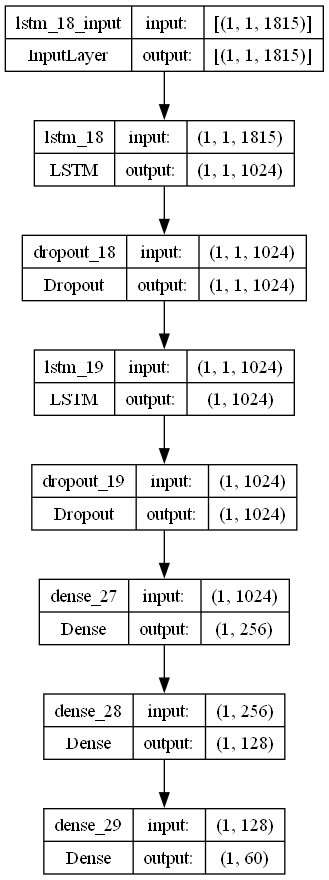

In [4]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    lr = 0.049784509261696225
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate = 0.1726097624786438

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperature)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_CV_S60_No_GHI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)